In [72]:
from pathlib import Path
import sys

sys.path.append(str(Path('').absolute().parent))


from stable_baselines3 import DQN, A2C
from stable_baselines3.a2c import MlpPolicy
from stable_baselines3.common.env_util import make_vec_env

from gym_snake.envs.SnakeEnv import SnakeEnv

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

import random
random.seed(42)

In [73]:
def plot_metrics(metrics, filepath=None):
    formatted_dict = {'episodes': [],
                      'metrics': [],
                      'results': []}

    n = len(metrics['score'])
    for i in range(n):        
        score = metrics['score'][i]
        reward = metrics['reward'][i]

        formatted_dict['episodes'].append(i)
        formatted_dict['metrics'].append('score')
        formatted_dict['results'].append(score)

        formatted_dict['episodes'].append(i)
        formatted_dict['metrics'].append('reward')
        formatted_dict['results'].append(reward)

    df_metrics = pd.DataFrame(formatted_dict)
    sns.lineplot(data=df_metrics, x='episodes', y='results', hue='metrics')
    if filepath is None:
        plt.show()
    else:
        plt.savefig(filepath)
        
def evaluate(model):
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)
    obs = env.reset()

    for _ in range(10000):
        action, _states = model.predict(obs)
        obs, rewards, dones, info = env.step(action)
        env.render()

    return snake_env.record, np.mean(np.array(snake_env.results['score']))

def plot_max_results(results, p_string):
    formatted_dict = { p_string: [],
                      'metrics': [],
                      'results': []}
    for parameter, result in results.items():
        _, max_train_score, max_test_score, meand_train_score, mean_test_score = result
        
        formatted_dict[p_string].append(parameter)
        formatted_dict['metrics'].append('Max Train Score')
        formatted_dict['results'].append(max_train_score)
        
        formatted_dict[p_string].append(parameter)
        formatted_dict['metrics'].append('Max Test Score')
        formatted_dict['results'].append(max_test_score)
        
        formatted_dict[p_string].append(parameter)
        formatted_dict['metrics'].append('Mean Train Score')
        formatted_dict['results'].append(mean_train_score)
        
        formatted_dict[p_string].append(parameter)
        formatted_dict['metrics'].append('Mean Test Score')
        formatted_dict['results'].append(mean_test_score)
        
    df_metrics = pd.DataFrame(formatted_dict)
    sns.lineplot(data=df_metrics, x=p_string, y='results', hue='metrics')  
    
    plt.show()
        
           

# Testando Learning Rate

In [74]:
#this is a try. My learning rate was always the same using random.uniform. 
#the problem seemed the seed=42 in the A2C constructor
for _ in range(10):
    learning_rate=random.uniform(0.001,0.1)
    print("lr: ", learning_rate)
    

lr:  0.06430325304733049
lr:  0.003476064767044027
lr:  0.02822790251854281
lr:  0.023097863076733453
lr:  0.07391065020223724
lr:  0.06799324925486823
lr:  0.0893257772027797
lr:  0.009606944430312198
lr:  0.04277026014884178
lr:  0.003949924724368965


## Deafult Example

In [75]:
results = {}

# enable_render=True turns on the display
snake_env = SnakeEnv(440, 440, enable_render=False)
env = make_vec_env(lambda: snake_env, n_envs=1)

#gamma = random.uniform(0.95, 1)
learning_rate=1e-3#random.uniform(0.001,0.1)
#print("lr: ", learning_rate)

model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
model.learn(total_timesteps=20000, log_interval=1000)

# Print rewards and scores for each episode
max_train_score = snake_env.record
mean_train_score = np.mean(np.array(snake_env.results['score']))
max_test_score, mean_test_score = evaluate(model)

results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.6     |
|    ep_rew_mean        | -26.6    |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0897  |
|    explained_variance | -51.2    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0344   |
|    value_loss         | 68.1     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 62.5     |
|    ep_rew_mean        | -5.5     |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/             

Learning Rate 0.001


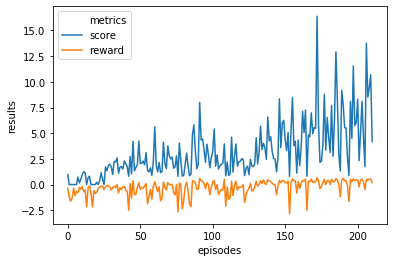

Max Train Score 31 Max Test Score 27
Mean Train Score 3.1806518916359434 Mean Test Score 6.458243129728509
----------------------------------------------------------------------------------------------------


In [76]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

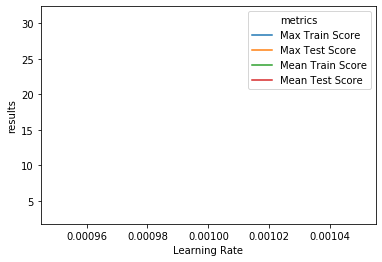

In [77]:
plot_max_results(results,'Learning Rate')

## Learning rate range (0.001, 0.1)

In [78]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.001,0.1)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 523       |
|    ep_rew_mean        | -30       |
| time/                 |           |
|    fps                | 454       |
|    iterations         | 1000      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.000497 |
|    explained_variance | 0.00564   |
|    learning_rate      | 0.00777   |
|    n_updates          | 999       |
|    policy_loss        | 1.22e-12  |
|    value_loss         | 2.37e-15  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 707       |
|    ep_rew_mean        | -22.3     |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 2000      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10000  

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 12        |
|    ep_rew_mean        | -50       |
| time/                 |           |
|    fps                | 303       |
|    iterations         | 2000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -2.89e-05 |
|    explained_variance | -0.485    |
|    learning_rate      | 0.0172    |
|    n_updates          | 1999      |
|    policy_loss        | -7.46e-05 |
|    value_loss         | 950       |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 12        |
|    ep_rew_mean        | -50       |
| time/                 |           |
|    fps                | 304       |
|    iterations         | 3000      |
|    time_elapsed       | 49        |
|    total_timesteps    | 15000     |
| train/    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 1e+03     |
|    ep_rew_mean        | -9.29     |
| time/                 |           |
|    fps                | 463       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -1.29e-10 |
|    explained_variance | -2.97e+06 |
|    learning_rate      | 0.062     |
|    n_updates          | 2999      |
|    policy_loss        | -0        |
|    value_loss         | 0.00431   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 1e+03     |
|    ep_rew_mean        | -9.47     |
| time/                 |           |
|    fps                | 460       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 12        |
|    ep_rew_mean        | -50       |
| time/                 |           |
|    fps                | 302       |
|    iterations         | 4000      |
|    time_elapsed       | 66        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -6.42e-08 |
|    explained_variance | -0.445    |
|    learning_rate      | 0.0755    |
|    n_updates          | 3999      |
|    policy_loss        | -0        |
|    value_loss         | 1.3e+03   |
-------------------------------------


Learning Rate 0.007772749144735323


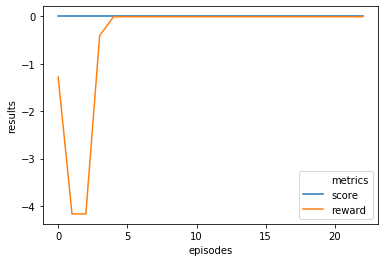

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.056765830232493576


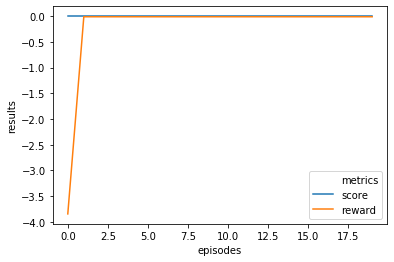

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.06142160468810798


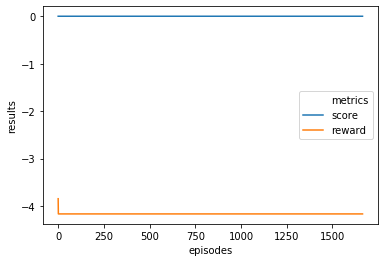

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.017247538429273984


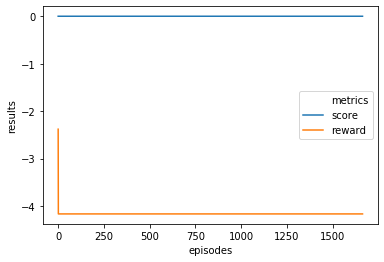

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.03576758416385032


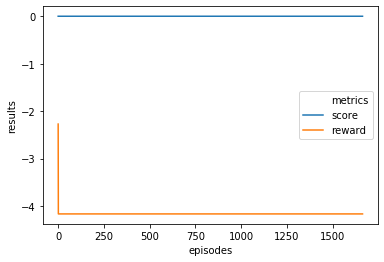

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.022092489690929074


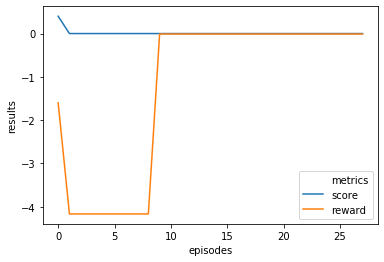

Max Train Score 1 Max Test Score 0
Mean Train Score 0.014285714285714287 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.06199152524746992


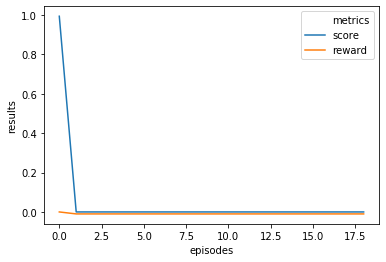

Max Train Score 1 Max Test Score 0
Mean Train Score 0.05226608187134503 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.009582115313132866


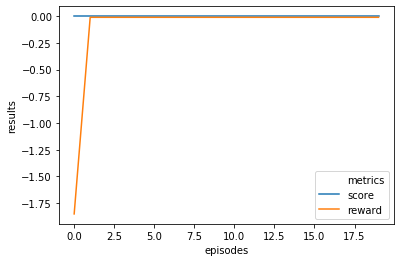

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.010946046135286241


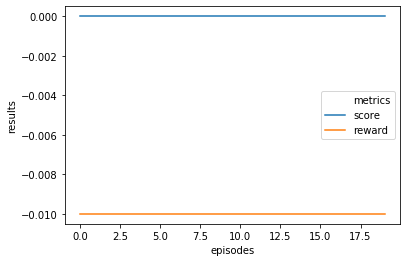

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.07549211900824729


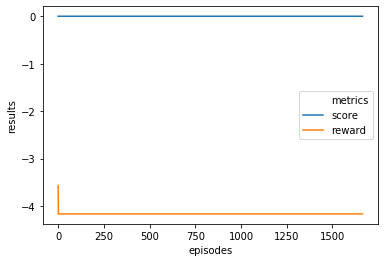

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------


In [79]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

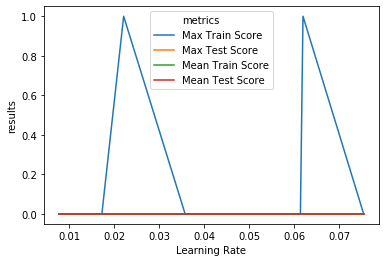

In [80]:
plot_max_results(results,'Learning Rate')

#### Result: value above 0.01 are bad, the score is always 0


## Learning rate range (0.001, 0.01)

In [81]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.001,0.01)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 1e+03    |
|    ep_rew_mean        | -10      |
| time/                 |          |
|    fps                | 462      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.00502 |
|    explained_variance | -0.0306  |
|    learning_rate      | 0.00631  |
|    n_updates          | 999      |
|    policy_loss        | 7.22e-12 |
|    value_loss         | 2.47e-15 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 1e+03     |
|    ep_rew_mean        | -10       |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 2000      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 511      |
|    ep_rew_mean        | -30.6    |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -2.3e-05 |
|    explained_variance | -0.00408 |
|    learning_rate      | 0.00383  |
|    n_updates          | 1999     |
|    policy_loss        | 3.35e-14 |
|    value_loss         | 1.19e-15 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 617       |
|    ep_rew_mean        | -26.1     |
| time/                 |           |
|    fps                | 438       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 703       |
|    ep_rew_mean        | -23       |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -4.53e-06 |
|    explained_variance | -0.599    |
|    learning_rate      | 0.00647   |
|    n_updates          | 2999      |
|    policy_loss        | -8.94e-13 |
|    value_loss         | 1.19e-10  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 763      |
|    ep_rew_mean        | -20.4    |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 4000     |
|    time_elapsed       | 44       |
|    total_timesteps    | 20000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 912       |
|    ep_rew_mean        | -13.8     |
| time/                 |           |
|    fps                | 459       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -4.99e-05 |
|    explained_variance | 0.0288    |
|    learning_rate      | 0.00422   |
|    n_updates          | 3999      |
|    policy_loss        | -2.21e-13 |
|    value_loss         | 8.15e-15  |
-------------------------------------


Learning Rate 0.0063061652598536185


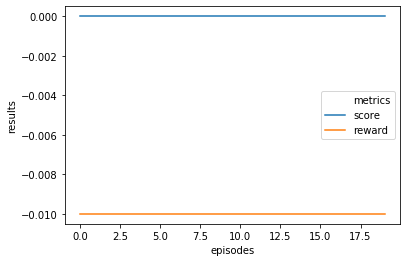

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0044562871840880865


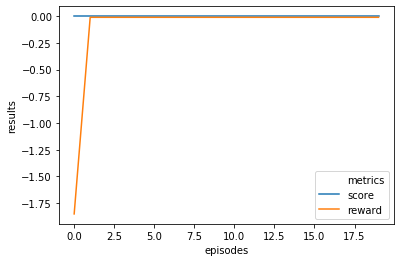

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00966923839497938


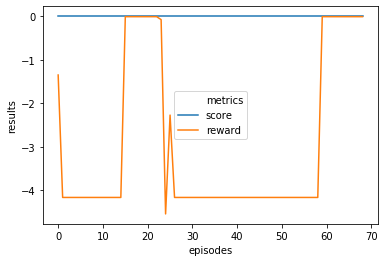

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0038305330136395245


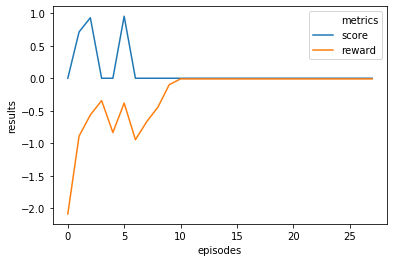

Max Train Score 1 Max Test Score 0
Mean Train Score 0.09260962601002842 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.005980569686062571


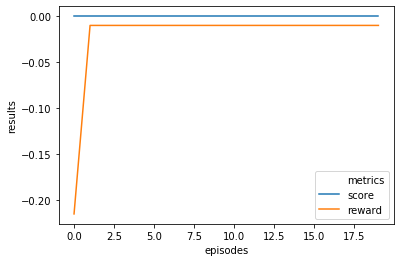

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.006400070805032677


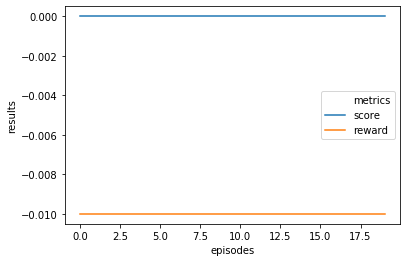

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00646833789023971


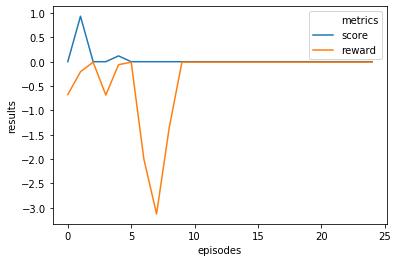

Max Train Score 1 Max Test Score 0
Mean Train Score 0.042072674048619065 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0028490114633719778


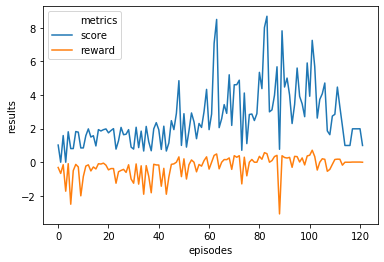

Max Train Score 18 Max Test Score 3
Mean Train Score 2.6700281359345386 Mean Test Score 1.398201409787309
----------------------------------------------------------------------------------------------------
Learning Rate 0.006970195247417596


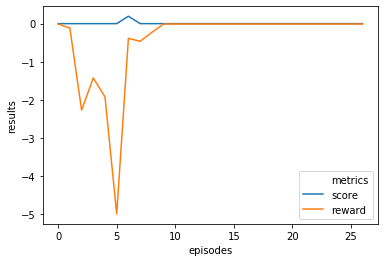

Max Train Score 1 Max Test Score 0
Mean Train Score 0.00719165767709457 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.004217746638139699


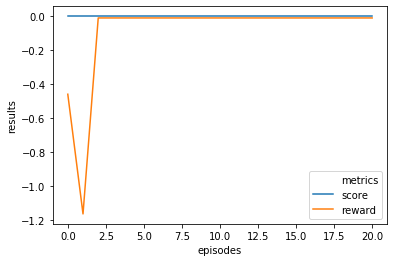

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------


In [82]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

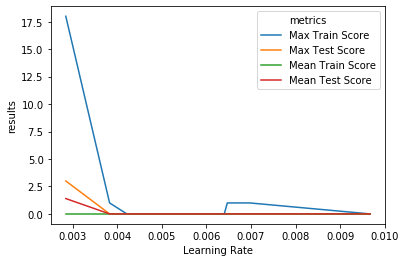

In [83]:
plot_max_results(results,'Learning Rate')

#### Result:  continue to be ruim, value above 0.003 are low

## Learning rate range (0.0005, 0.005)

In [84]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.0005,0.005)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 735       |
|    ep_rew_mean        | -23.3     |
| time/                 |           |
|    fps                | 459       |
|    iterations         | 1000      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.000882 |
|    explained_variance | -0.965    |
|    learning_rate      | 0.00247   |
|    n_updates          | 999       |
|    policy_loss        | 2.1e-11   |
|    value_loss         | 7.11e-14  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 855       |
|    ep_rew_mean        | -17.3     |
| time/                 |           |
|    fps                | 462       |
|    iterations         | 2000      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10000  

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 783       |
|    ep_rew_mean        | -19.2     |
| time/                 |           |
|    fps                | 440       |
|    iterations         | 2000      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.000183 |
|    explained_variance | -0.424    |
|    learning_rate      | 0.00289   |
|    n_updates          | 1999      |
|    policy_loss        | 5.88e-11  |
|    value_loss         | 3.93e-11  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 847       |
|    ep_rew_mean        | -16.5     |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 791      |
|    ep_rew_mean        | -18.9    |
| time/                 |          |
|    fps                | 458      |
|    iterations         | 3000     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.00176 |
|    explained_variance | -0.825   |
|    learning_rate      | 0.00233  |
|    n_updates          | 2999     |
|    policy_loss        | 4.94e-09 |
|    value_loss         | 1.39e-08 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 836      |
|    ep_rew_mean        | -17      |
| time/                 |          |
|    fps                | 458      |
|    iterations         | 4000     |
|    time_elapsed       | 43       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 120      |
|    ep_rew_mean        | 35       |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.105   |
|    explained_variance | -1.1e+04 |
|    learning_rate      | 0.00249  |
|    n_updates          | 3999     |
|    policy_loss        | -0.498   |
|    value_loss         | 0.417    |
------------------------------------


Learning Rate 0.0024697153255187065


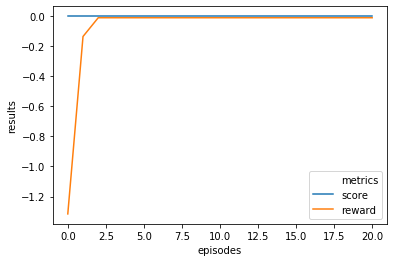

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0032981316499962826


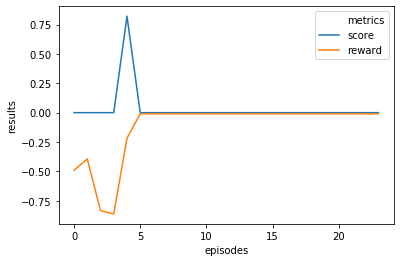

Max Train Score 1 Max Test Score 0
Mean Train Score 0.034193840579710144 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00217679968973502


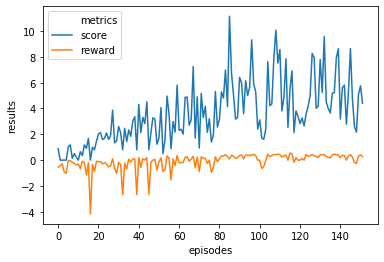

Max Train Score 18 Max Test Score 18
Mean Train Score 3.604206441750168 Mean Test Score 4.311070275839919
----------------------------------------------------------------------------------------------------
Learning Rate 0.002890047768312996


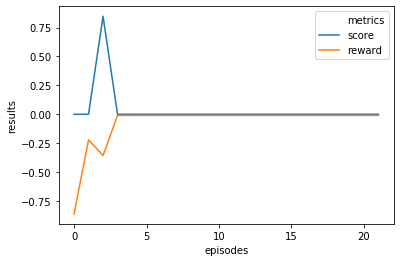

Max Train Score 1 Max Test Score 0
Mean Train Score 0.03855519480519481 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.004195810943402324


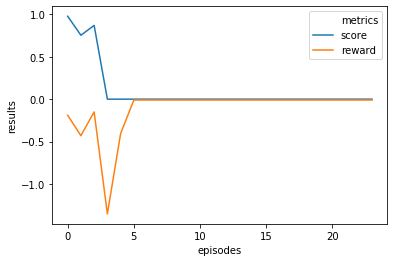

Max Train Score 1 Max Test Score 0
Mean Train Score 0.10822552259208895 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0036192192755120866


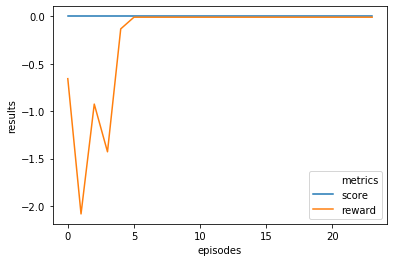

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002329781362970937


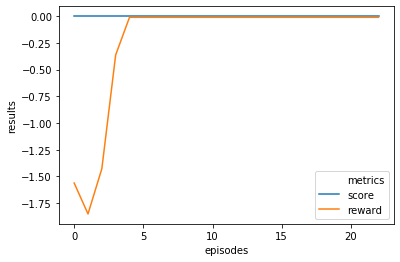

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0014810291833967267


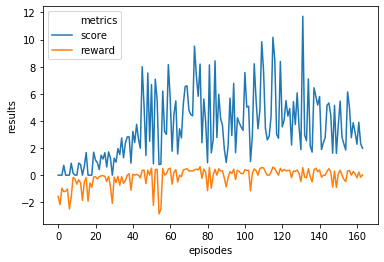

Max Train Score 22 Max Test Score 15
Mean Train Score 3.499772360714392 Mean Test Score 3.625928766186477
----------------------------------------------------------------------------------------------------
Learning Rate 0.004948481200310918


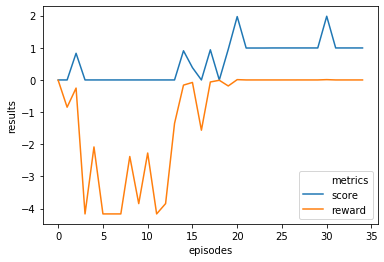

Max Train Score 3 Max Test Score 2
Mean Train Score 0.5969435396139068 Mean Test Score 1.3079294153379761
----------------------------------------------------------------------------------------------------
Learning Rate 0.0024861923188130384


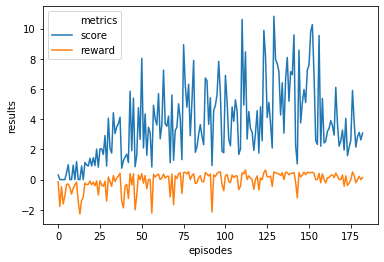

Max Train Score 21 Max Test Score 20
Mean Train Score 3.6998943662725985 Mean Test Score 3.364312017681897
----------------------------------------------------------------------------------------------------


In [85]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

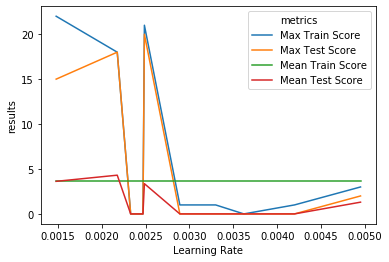

In [86]:
plot_max_results(results,'Learning Rate')

#### Result: values above 0.002 are bad (not always)

## Learning Rate range (0.0002,0.002)

In [87]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.0002,0.002)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.6     |
|    ep_rew_mean        | -30      |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.372   |
|    explained_variance | -63.1    |
|    learning_rate      | 0.00105  |
|    n_updates          | 999      |
|    policy_loss        | 0.00995  |
|    value_loss         | 15.3     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 83.3     |
|    ep_rew_mean        | -10.1    |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 94.9      |
|    ep_rew_mean        | -11.7     |
| time/                 |           |
|    fps                | 434       |
|    iterations         | 2000      |
|    time_elapsed       | 23        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.000673 |
|    explained_variance | nan       |
|    learning_rate      | 0.00113   |
|    n_updates          | 1999      |
|    policy_loss        | -3.74e-05 |
|    value_loss         | 0.436     |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.1     |
|    ep_rew_mean        | 18.1     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.9     |
|    ep_rew_mean        | 5.9      |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0825  |
|    explained_variance | 0.415    |
|    learning_rate      | 0.00151  |
|    n_updates          | 2999     |
|    policy_loss        | -0.00774 |
|    value_loss         | 0.741    |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 108       |
|    ep_rew_mean        | 22.5      |
| time/                 |           |
|    fps                | 417       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 63.5     |
|    ep_rew_mean        | -16.8    |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.744   |
|    explained_variance | -0.188   |
|    learning_rate      | 0.000302 |
|    n_updates          | 3999     |
|    policy_loss        | -0.173   |
|    value_loss         | 0.0189   |
------------------------------------


Learning Rate 0.0010485206356484092


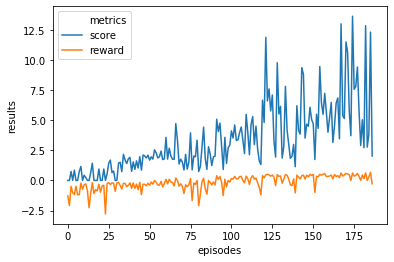

Max Train Score 28 Max Test Score 29
Mean Train Score 3.3121499838475574 Mean Test Score 6.832304596845016
----------------------------------------------------------------------------------------------------
Learning Rate 0.0007324113295818563


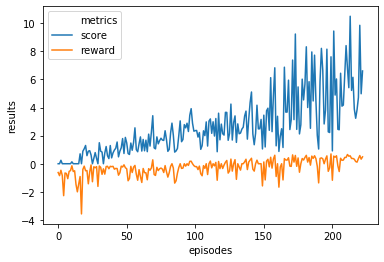

Max Train Score 21 Max Test Score 25
Mean Train Score 2.6343583002562236 Mean Test Score 5.2671039086874725
----------------------------------------------------------------------------------------------------
Learning Rate 0.0005751234335084797


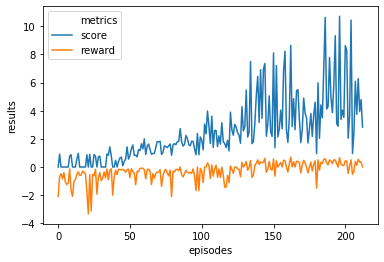

Max Train Score 22 Max Test Score 28
Mean Train Score 2.4927857334470933 Mean Test Score 5.4216762292395195
----------------------------------------------------------------------------------------------------
Learning Rate 0.0011258697051459707


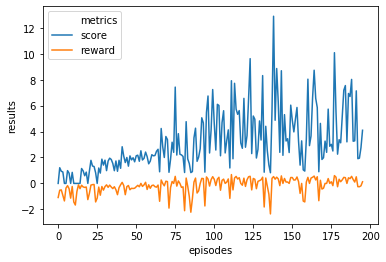

Max Train Score 24 Max Test Score 28
Mean Train Score 3.1567151514371194 Mean Test Score 5.617946013053851
----------------------------------------------------------------------------------------------------
Learning Rate 0.0006475592301496779


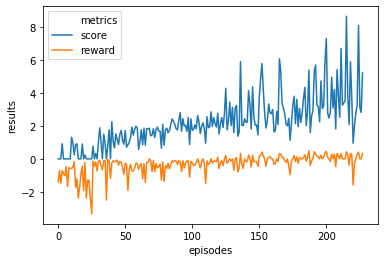

Max Train Score 14 Max Test Score 20
Mean Train Score 2.1989122471114624 Mean Test Score 4.143110619281836
----------------------------------------------------------------------------------------------------
Learning Rate 0.0014561709343096653


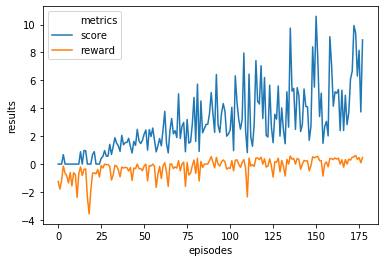

Max Train Score 23 Max Test Score 21
Mean Train Score 2.9283444371017344 Mean Test Score 5.554171242857847
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015139909977083294


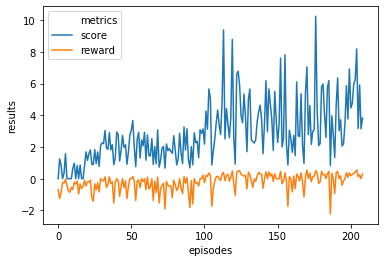

Max Train Score 18 Max Test Score 20
Mean Train Score 2.839293719558158 Mean Test Score 4.849172673309573
----------------------------------------------------------------------------------------------------
Learning Rate 0.0016336688282038616


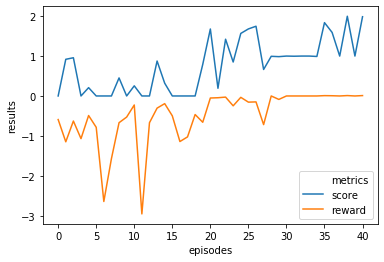

Max Train Score 2 Max Test Score 1
Mean Train Score 0.7514081175139035 Mean Test Score 0.9950298210735586
----------------------------------------------------------------------------------------------------
Learning Rate 0.0002857815237578513


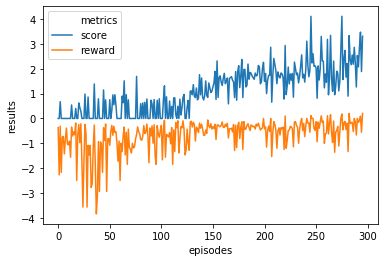

Max Train Score 7 Max Test Score 12
Mean Train Score 1.1184828616397815 Mean Test Score 2.4076667804691128
----------------------------------------------------------------------------------------------------
Learning Rate 0.00030171098145664584


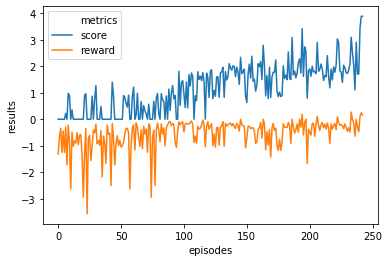

Max Train Score 8 Max Test Score 10
Mean Train Score 1.1599928625980755 Mean Test Score 2.527704975455553
----------------------------------------------------------------------------------------------------


In [88]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

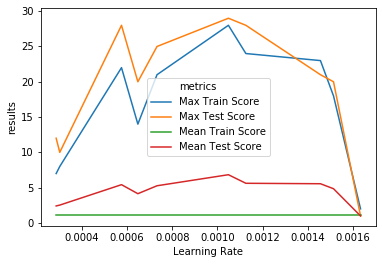

In [89]:
plot_max_results(results,'Learning Rate')

#### Result: the range (0.0005,0.002) seems good

## Learning Rate range (0.0005,0.0014)

In [90]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.0005,0.0014)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 65.7      |
|    ep_rew_mean        | -30.8     |
| time/                 |           |
|    fps                | 417       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.451    |
|    explained_variance | -1.66e+03 |
|    learning_rate      | 0.000896  |
|    n_updates          | 999       |
|    policy_loss        | -12.9     |
|    value_loss         | 1.62e+03  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 68.2     |
|    ep_rew_mean        | -12      |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| tr

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 83.5     |
|    ep_rew_mean        | -36      |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.531   |
|    explained_variance | -8.07    |
|    learning_rate      | 0.000539 |
|    n_updates          | 1999     |
|    policy_loss        | 0.106    |
|    value_loss         | 22.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70.5     |
|    ep_rew_mean        | -9.2     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 66.4     |
|    ep_rew_mean        | -6.2     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.263   |
|    explained_variance | 0.618    |
|    learning_rate      | 0.000703 |
|    n_updates          | 2999     |
|    policy_loss        | 0.0162   |
|    value_loss         | 2.53     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85.2     |
|    ep_rew_mean        | 13.2     |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 94.3      |
|    ep_rew_mean        | 16.7      |
| time/                 |           |
|    fps                | 423       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -6.31e-05 |
|    explained_variance | nan       |
|    learning_rate      | 0.00102   |
|    n_updates          | 3999      |
|    policy_loss        | -3.81e-06 |
|    value_loss         | 0.778     |
-------------------------------------


Learning Rate 0.0008961501988583647


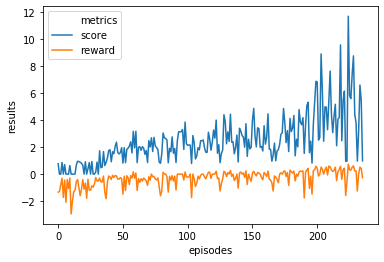

Max Train Score 23 Max Test Score 17
Mean Train Score 2.4544116781136194 Mean Test Score 3.576126472981282
----------------------------------------------------------------------------------------------------
Learning Rate 0.00104674599210108


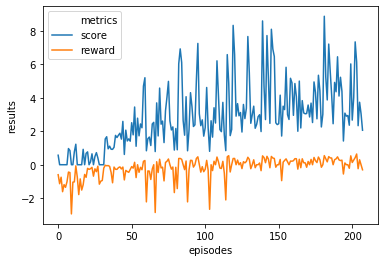

Max Train Score 16 Max Test Score 24
Mean Train Score 2.8550474182783763 Mean Test Score 4.298887911914875
----------------------------------------------------------------------------------------------------
Learning Rate 0.0005537143101696532


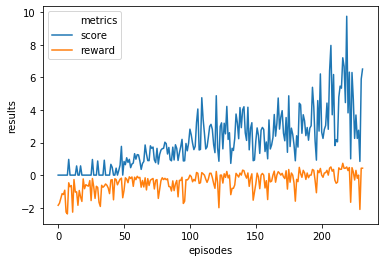

Max Train Score 16 Max Test Score 22
Mean Train Score 2.06641066694255 Mean Test Score 4.5836680387607895
----------------------------------------------------------------------------------------------------
Learning Rate 0.0005388008688384392


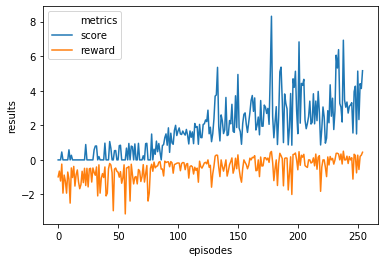

Max Train Score 17 Max Test Score 18
Mean Train Score 1.7928600767867109 Mean Test Score 3.918316051425061
----------------------------------------------------------------------------------------------------
Learning Rate 0.0010642069468577895


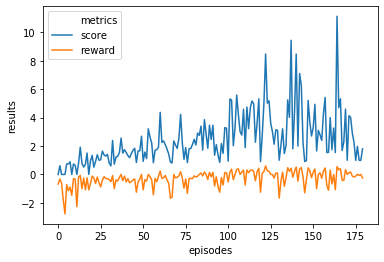

Max Train Score 20 Max Test Score 2
Mean Train Score 2.4604194372627766 Mean Test Score 1.388186038662839
----------------------------------------------------------------------------------------------------
Learning Rate 0.0006188421256312186


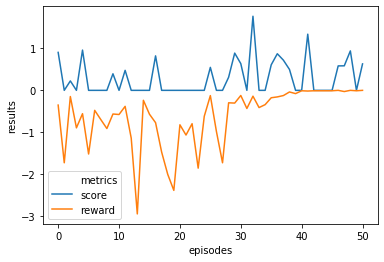

Max Train Score 2 Max Test Score 0
Mean Train Score 0.2879813648219667 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0007027590065810225


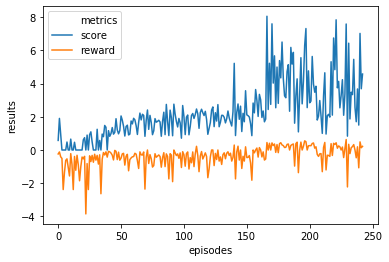

Max Train Score 15 Max Test Score 17
Mean Train Score 2.255345928444662 Mean Test Score 3.6729345012796197
----------------------------------------------------------------------------------------------------
Learning Rate 0.0007397078218237594


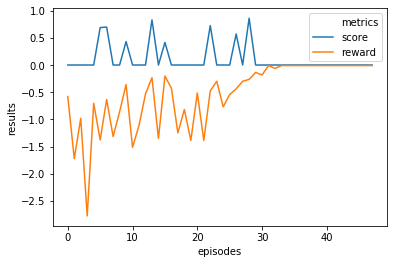

Max Train Score 1 Max Test Score 0
Mean Train Score 0.10886873989048612 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0010061679565551709


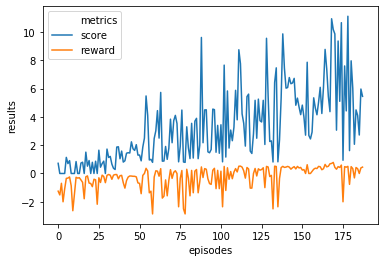

Max Train Score 24 Max Test Score 31
Mean Train Score 3.2579725287970382 Mean Test Score 7.460738420268158
----------------------------------------------------------------------------------------------------
Learning Rate 0.0010163623754524688


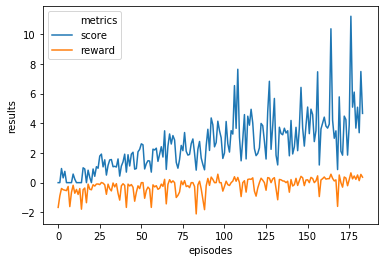

Max Train Score 22 Max Test Score 22
Mean Train Score 2.588030859837514 Mean Test Score 4.5475397222545535
----------------------------------------------------------------------------------------------------


In [91]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

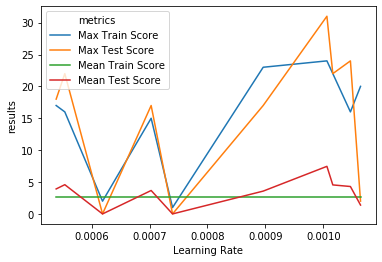

In [92]:
plot_max_results(results,'Learning Rate')

#### Result: value between 0.001 and 0.0012 seems good

## Learning Rate with fixed value

In [93]:
#those values seemed good during the tests
learning_rates=[0.0009610612889534735,0.0013779226379577784,0.0013197979371411934,0.001,0.0015,0.0018,0.002,0.00095,0.00092,0.0009,0.00085,0.00082,0.0008]

results = {}
for learning_rate in learning_rates:
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    #learning_rate=random.uniform(0.0005,0.0014)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.8     |
|    ep_rew_mean        | -32.1    |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.357   |
|    explained_variance | -6.38    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.357    |
|    value_loss         | 29.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 67.4     |
|    ep_rew_mean        | -4.8     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.8     |
|    ep_rew_mean        | -21.2    |
| time/                 |          |
|    fps                | 408      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.17    |
|    explained_variance | -0.052   |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.0088   |
|    value_loss         | 0.0322   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82.8     |
|    ep_rew_mean        | -12.2    |
| time/                 |          |
|    fps                | 406      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 92.1      |
|    ep_rew_mean        | 12.8      |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0101   |
|    explained_variance | -5.19e+10 |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -0.000615 |
|    value_loss         | 0.264     |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 106      |
|    ep_rew_mean        | 21.1     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.8     |
|    ep_rew_mean        | -7.2     |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 4000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0179  |
|    explained_variance | -4.39    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -0.00157 |
|    value_loss         | 0.181    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 131       |
|    ep_rew_mean        | -45.4     |
| time/                 |           |
|    fps                | 405       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


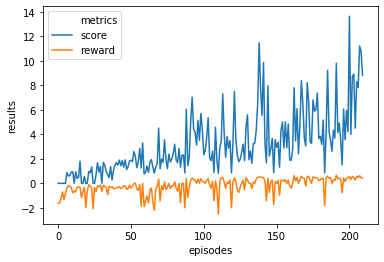

Max Train Score 27 Max Test Score 30
Mean Train Score 3.1450003332966348 Mean Test Score 7.980717028678105
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


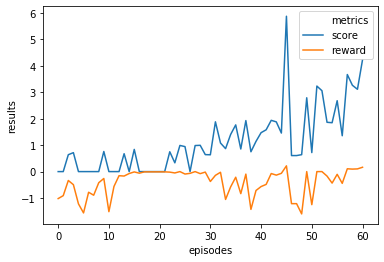

Max Train Score 10 Max Test Score 11
Mean Train Score 1.1386953170166034 Mean Test Score 2.9356534173153364
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


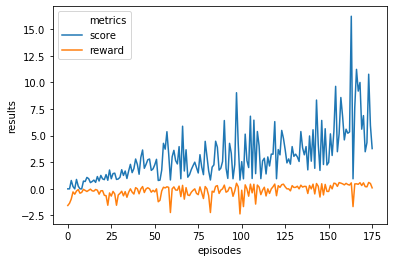

Max Train Score 31 Max Test Score 33
Mean Train Score 3.065887042756423 Mean Test Score 6.65638952506762
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


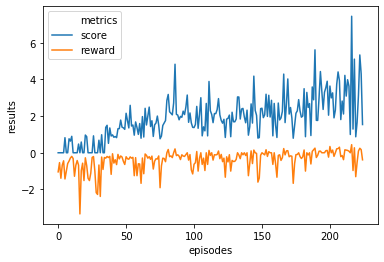

Max Train Score 15 Max Test Score 15
Mean Train Score 1.875353493333443 Mean Test Score 3.6543156767010694
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


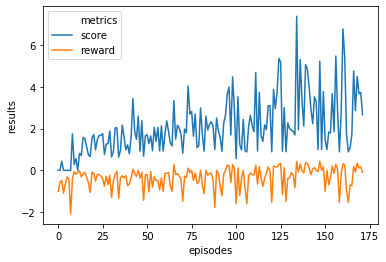

Max Train Score 14 Max Test Score 10
Mean Train Score 2.0714517400547403 Mean Test Score 2.3506823976326126
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


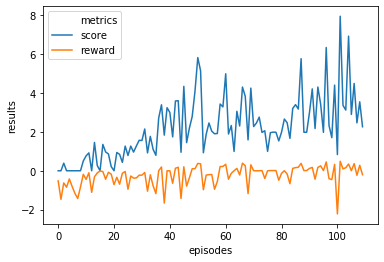

Max Train Score 16 Max Test Score 15
Mean Train Score 2.207157656797512 Mean Test Score 4.294160470530515
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


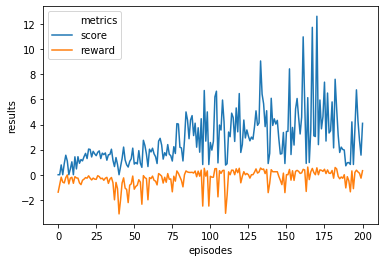

Max Train Score 23 Max Test Score 14
Mean Train Score 2.8421161411388525 Mean Test Score 2.971344659125783
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


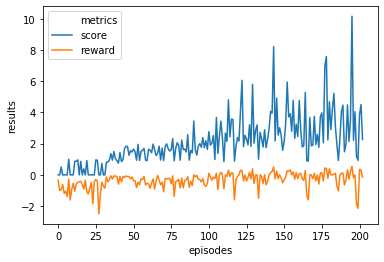

Max Train Score 20 Max Test Score 20
Mean Train Score 2.0948986818431927 Mean Test Score 4.350658443860332
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


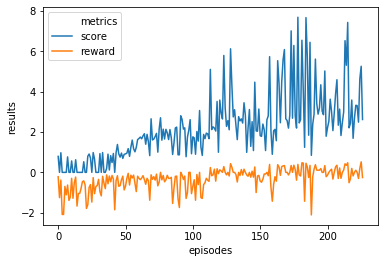

Max Train Score 15 Max Test Score 21
Mean Train Score 2.1687251541209585 Mean Test Score 4.124829808000654
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


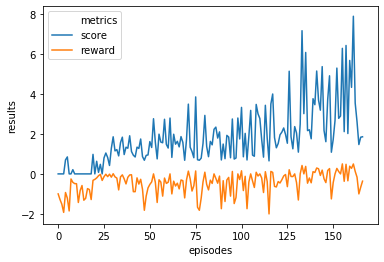

Max Train Score 16 Max Test Score 16
Mean Train Score 1.833452239337325 Mean Test Score 3.817576217192027
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


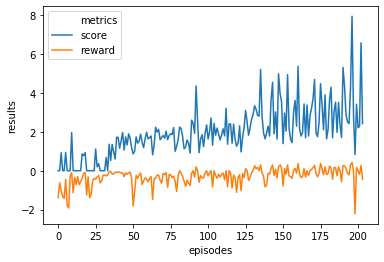

Max Train Score 16 Max Test Score 22
Mean Train Score 1.9537436588498067 Mean Test Score 3.674736966158811
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


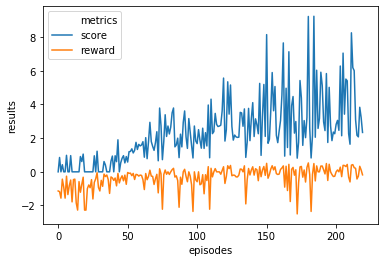

Max Train Score 20 Max Test Score 18
Mean Train Score 2.327946432387875 Mean Test Score 4.456038138014246
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


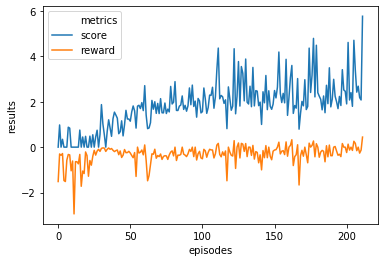

Max Train Score 12 Max Test Score 16
Mean Train Score 1.8356549911629723 Mean Test Score 2.6804185092284607
----------------------------------------------------------------------------------------------------


In [94]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

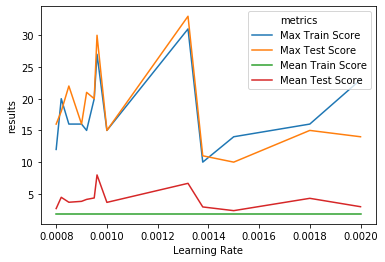

In [95]:
plot_max_results(results,'Learning Rate')

#### Result: 0.001 seems a good value

## Learning Rate with fixed value and gamma=0.97

In [96]:
learning_rates=[0.0009610612889534735,0.0013779226379577784,0.0013197979371411934,0.001,0.0015,0.0018,0.002,0.00095,0.00092,0.0009,0.00085,0.00082,0.0008]

results = {}
for learning_rate in learning_rates:
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    #learning_rate=random.uniform(0.0005,0.0014)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate,gamma=0.97)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.5     |
|    ep_rew_mean        | -34.6    |
| time/                 |          |
|    fps                | 407      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.441   |
|    explained_variance | -18.8    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | -0.0413  |
|    value_loss         | 35.8     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.6     |
|    ep_rew_mean        | -5       |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.3     |
|    ep_rew_mean        | -14.9    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.224   |
|    explained_variance | -53.7    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.0363  |
|    value_loss         | 30.8     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 93.6      |
|    ep_rew_mean        | 20.5      |
| time/                 |           |
|    fps                | 430       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 91.1      |
|    ep_rew_mean        | 17        |
| time/                 |           |
|    fps                | 425       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.000875 |
|    explained_variance | 0.776     |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -2.37e-05 |
|    value_loss         | 0.378     |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 111       |
|    ep_rew_mean        | 34.3      |
| time/                 |           |
|    fps                | 428       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.9     |
|    ep_rew_mean        | 12.8     |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00874 |
|    explained_variance | -1.32    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -0.001   |
|    value_loss         | 1.17     |
------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 114      |
|    ep_rew_mean        | -41.9    |
| time/                 |          |
|    fps                | 409      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/             

Learning Rate 0.0009610612889534735


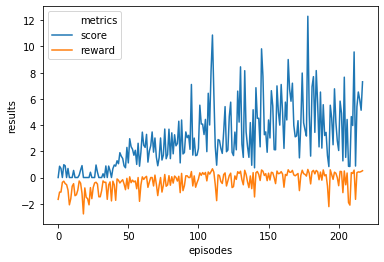

Max Train Score 22 Max Test Score 22
Mean Train Score 3.0278897829748828 Mean Test Score 5.076773522098743
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


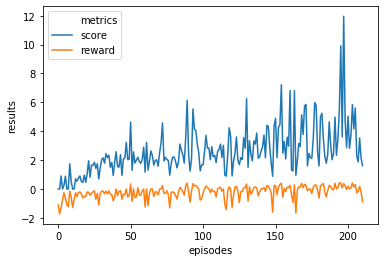

Max Train Score 24 Max Test Score 20
Mean Train Score 2.606984288211742 Mean Test Score 3.956629330917982
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


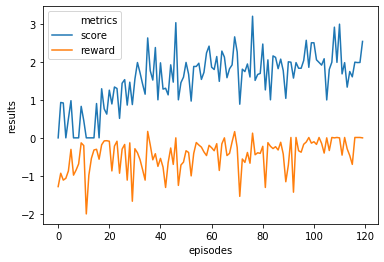

Max Train Score 6 Max Test Score 5
Mean Train Score 1.558373743051216 Mean Test Score 1.999159145204466
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


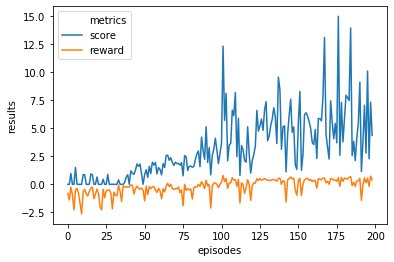

Max Train Score 27 Max Test Score 30
Mean Train Score 3.1765791921828423 Mean Test Score 5.581266073132615
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


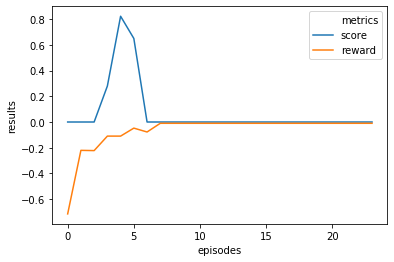

Max Train Score 1 Max Test Score 0
Mean Train Score 0.0729415405665141 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


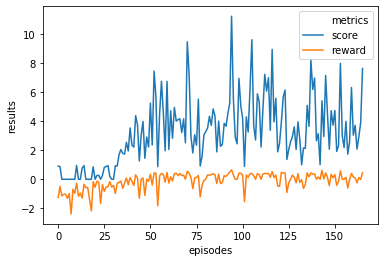

Max Train Score 20 Max Test Score 28
Mean Train Score 3.1859204233701677 Mean Test Score 5.842670956444549
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


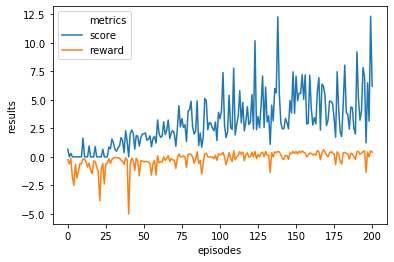

Max Train Score 23 Max Test Score 26
Mean Train Score 3.0339012287622933 Mean Test Score 5.1284479271197885
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


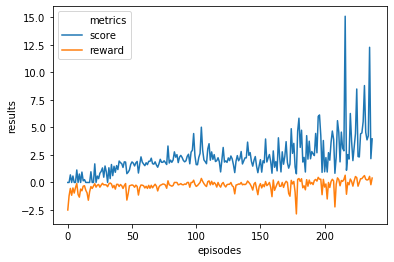

Max Train Score 28 Max Test Score 29
Mean Train Score 2.2632113279101405 Mean Test Score 5.280135781889476
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


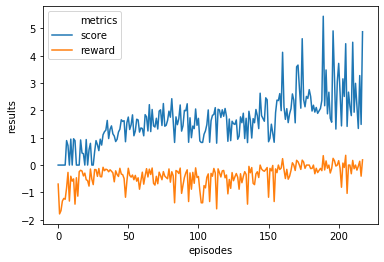

Max Train Score 10 Max Test Score 14
Mean Train Score 1.653264404269905 Mean Test Score 2.8173548123981393
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


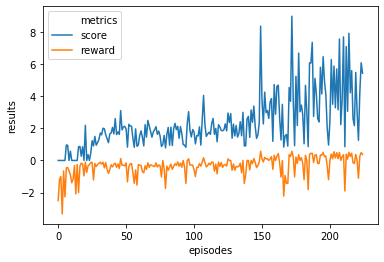

Max Train Score 16 Max Test Score 21
Mean Train Score 2.346632649466135 Mean Test Score 4.3086811502028945
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


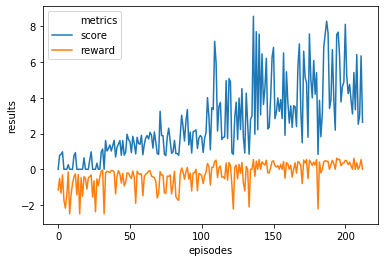

Max Train Score 16 Max Test Score 25
Mean Train Score 2.6628957926918435 Mean Test Score 5.8222901262877
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


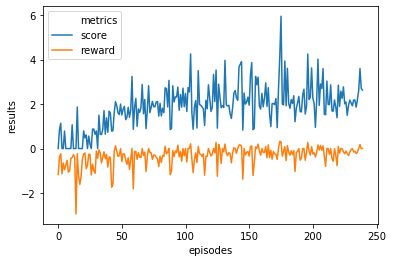

Max Train Score 12 Max Test Score 13
Mean Train Score 1.8831569160708241 Mean Test Score 2.829978969042862
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


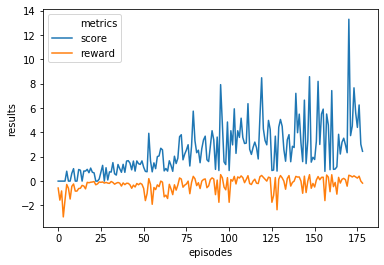

Max Train Score 26 Max Test Score 20
Mean Train Score 2.532724788832816 Mean Test Score 5.0232734090189695
----------------------------------------------------------------------------------------------------


In [97]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

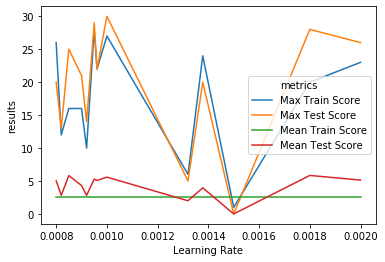

In [98]:
plot_max_results(results,'Learning Rate')

#### 0.0015 seems a good value

## Learning Rate with fixed value and gamma=0.97 observed for 10 times

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 71.2     |
|    ep_rew_mean        | -30.1    |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.215   |
|    explained_variance | -4.32    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.0563   |
|    value_loss         | 35.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.5     |
|    ep_rew_mean        | -3.2     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85.2     |
|    ep_rew_mean        | 1        |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.162   |
|    explained_variance | 0.396    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.00474  |
|    value_loss         | 11.5     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 109      |
|    ep_rew_mean        | 34.4     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 875       |
|    ep_rew_mean        | -17.1     |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -9.59e-05 |
|    explained_variance | -0.717    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | 2.22e-10  |
|    value_loss         | 1.98e-05  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 904       |
|    ep_rew_mean        | -15.5     |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 4000      |
|    time_elapsed       | 44        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 1.7      |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.232   |
|    explained_variance | -1.7e+03 |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -55.1    |
|    value_loss         | 1.01e+03 |
------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | -42      |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/             

Learning Rate 0.0009610612889534735


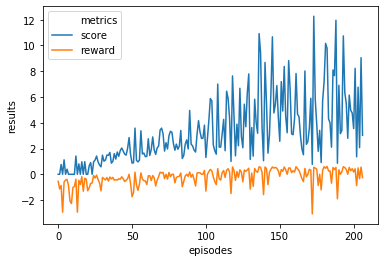

Max Train Score 24 Max Test Score 27
Mean Train Score 3.2567403901509606 Mean Test Score 7.533071438580753
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


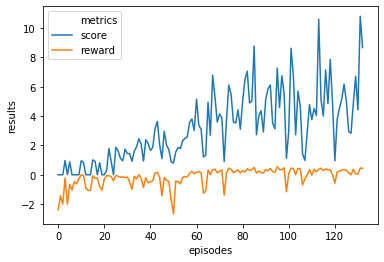

Max Train Score 20 Max Test Score 19
Mean Train Score 3.1590620167965877 Mean Test Score 5.014294314608481
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


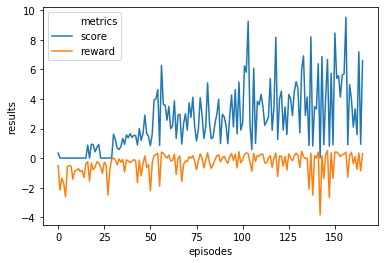

Max Train Score 18 Max Test Score 25
Mean Train Score 2.6153739406831047 Mean Test Score 4.247837686623141
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


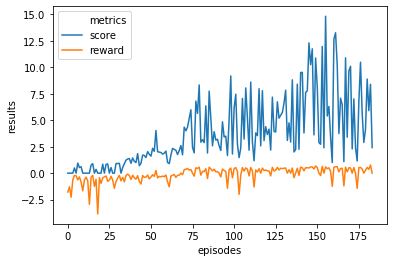

Max Train Score 30 Max Test Score 30
Mean Train Score 3.7504140910815376 Mean Test Score 6.4574066743014535
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


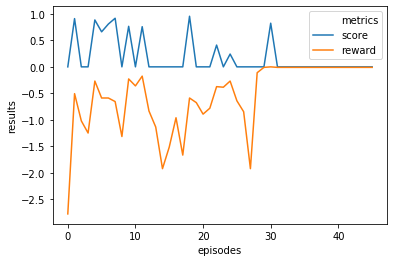

Max Train Score 1 Max Test Score 0
Mean Train Score 0.1770361017335054 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


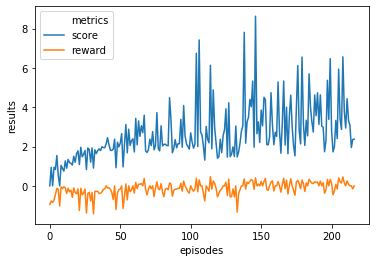

Max Train Score 16 Max Test Score 5
Mean Train Score 2.6299797827765143 Mean Test Score 1.6413905796914745
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


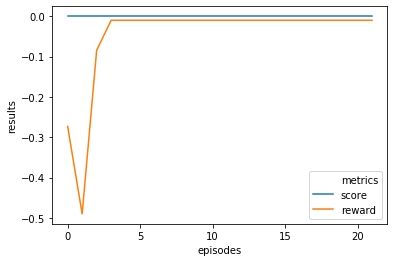

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


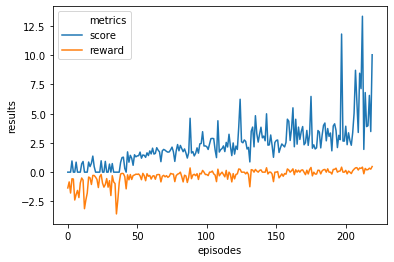

Max Train Score 24 Max Test Score 15
Mean Train Score 2.3527658370689246 Mean Test Score 3.631883970185461
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


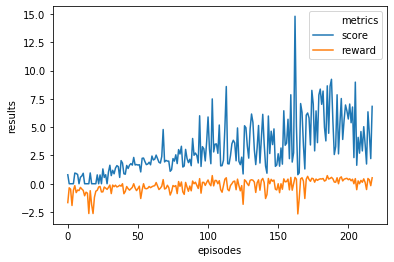

Max Train Score 26 Max Test Score 29
Mean Train Score 3.0871904126037952 Mean Test Score 5.726839470336932
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


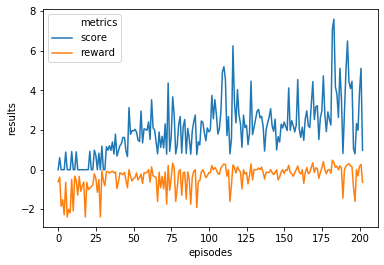

Max Train Score 13 Max Test Score 16
Mean Train Score 2.0518267033307613 Mean Test Score 3.51346209466926
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


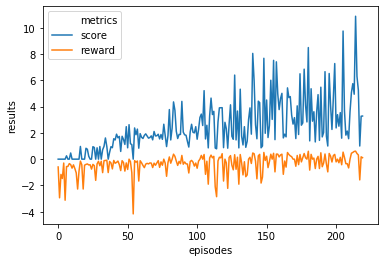

Max Train Score 19 Max Test Score 25
Mean Train Score 2.4672985947325277 Mean Test Score 4.878005007212284
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


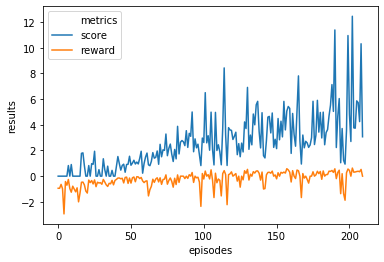

Max Train Score 24 Max Test Score 21
Mean Train Score 2.5871618358571347 Mean Test Score 3.6716109337877105
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


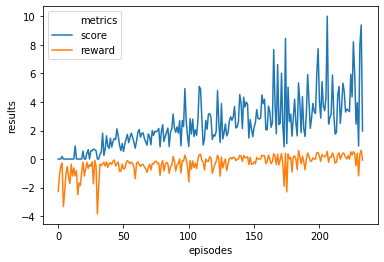

Max Train Score 19 Max Test Score 18
Mean Train Score 2.407847841206259 Mean Test Score 4.279553029426395
----------------------------------------------------------------------------------------------------
Learning rate max results  1


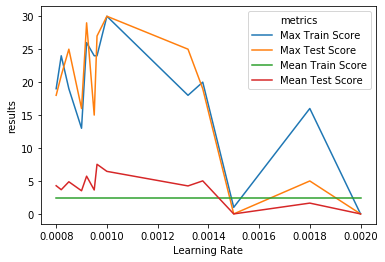

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99.2     |
|    ep_rew_mean        | -34      |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.426   |
|    explained_variance | 0.241    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.0418   |
|    value_loss         | 0.183    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70.7     |
|    ep_rew_mean        | -13      |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.6     |
|    ep_rew_mean        | -19.3    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.316   |
|    explained_variance | -7.86    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 10.3     |
|    value_loss         | 144      |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 78.3      |
|    ep_rew_mean        | 4.5       |
| time/                 |           |
|    fps                | 427       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 508      |
|    ep_rew_mean        | -25.4    |
| time/                 |          |
|    fps                | 452      |
|    iterations         | 3000     |
|    time_elapsed       | 33       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0023  |
|    explained_variance | nan      |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | -6.7e-07 |
|    value_loss         | 9.06e-06 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 567       |
|    ep_rew_mean        | -20.9     |
| time/                 |           |
|    fps                | 451       |
|    iterations         | 4000      |
|    time_elapsed       | 44        |
|    total_timesteps    | 20000     |
| train/                |    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 111       |
|    ep_rew_mean        | 30        |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.000653 |
|    explained_variance | -5.07     |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -5.45e-05 |
|    value_loss         | 1.17      |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 113      |
|    ep_rew_mean        | -38      |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


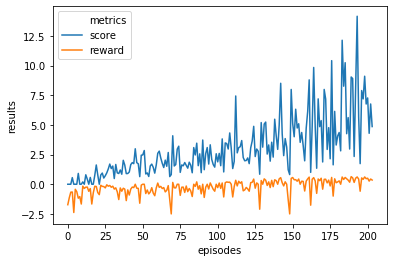

Max Train Score 28 Max Test Score 30
Mean Train Score 2.991751748920027 Mean Test Score 6.298558812090226
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


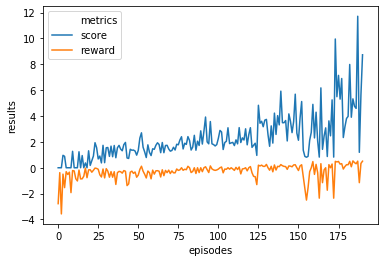

Max Train Score 23 Max Test Score 24
Mean Train Score 2.2924380072562167 Mean Test Score 5.475742291390256
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


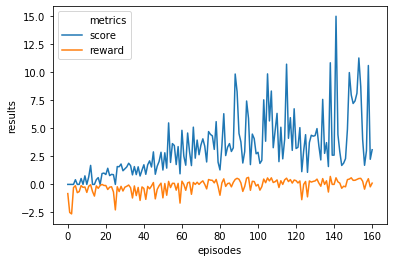

Max Train Score 28 Max Test Score 30
Mean Train Score 3.286666756463878 Mean Test Score 6.08440283018494
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


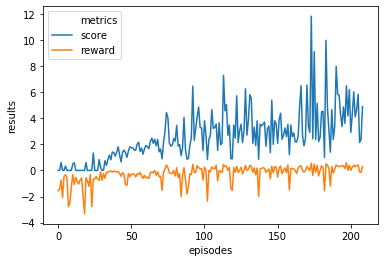

Max Train Score 22 Max Test Score 20
Mean Train Score 2.587366535476908 Mean Test Score 4.123814600236514
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


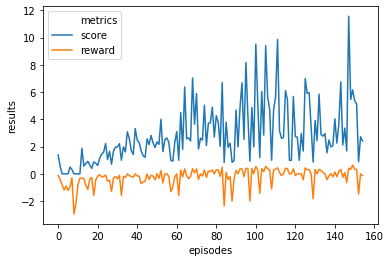

Max Train Score 22 Max Test Score 17
Mean Train Score 2.8754568612636318 Mean Test Score 3.670736703747948
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


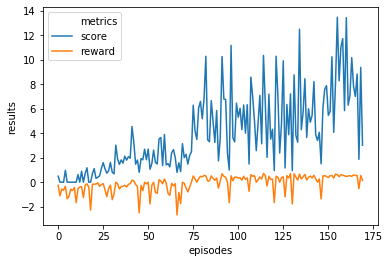

Max Train Score 26 Max Test Score 35
Mean Train Score 3.9276368263094676 Mean Test Score 7.847868049901267
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


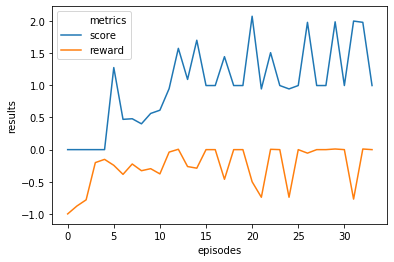

Max Train Score 3 Max Test Score 4
Mean Train Score 0.9988736668694987 Mean Test Score 1.246671415185829
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


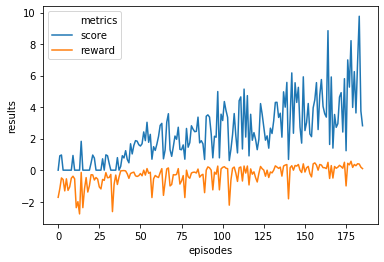

Max Train Score 18 Max Test Score 22
Mean Train Score 2.370902405892587 Mean Test Score 5.292627932546864
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


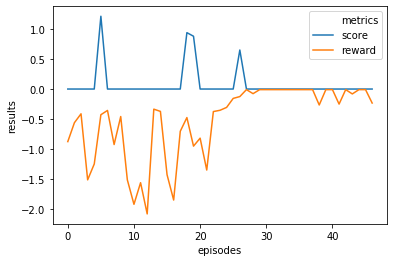

Max Train Score 2 Max Test Score 1
Mean Train Score 0.07843952514767448 Mean Test Score 0.08842756183745583
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


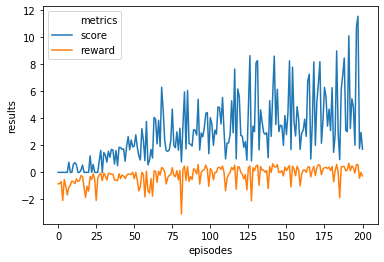

Max Train Score 23 Max Test Score 21
Mean Train Score 2.9929047646913904 Mean Test Score 5.16080890768723
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


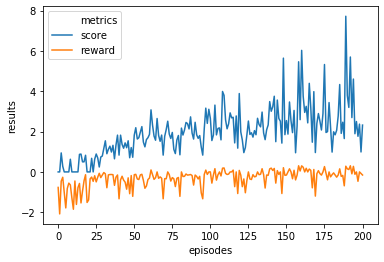

Max Train Score 15 Max Test Score 8
Mean Train Score 1.9683274136160742 Mean Test Score 2.119793168057467
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


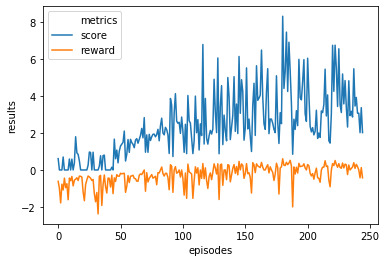

Max Train Score 18 Max Test Score 18
Mean Train Score 2.424398192433956 Mean Test Score 3.7556076051772727
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


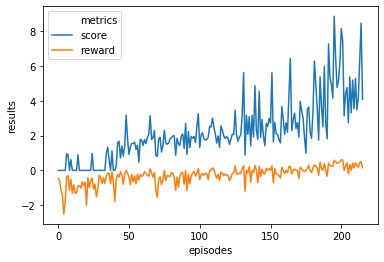

Max Train Score 17 Max Test Score 34
Mean Train Score 2.227268718939405 Mean Test Score 4.974040647764808
----------------------------------------------------------------------------------------------------
Learning rate max results  2


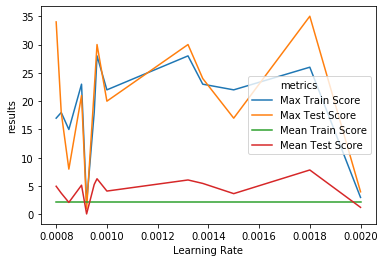

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 217      |
|    ep_rew_mean        | -45.2    |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0253  |
|    explained_variance | -0.584   |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 1.16e-09 |
|    value_loss         | 6.22e-13 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 368      |
|    ep_rew_mean        | -38.5    |
| time/                 |          |
|    fps                | 451      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.9     |
|    ep_rew_mean        | -22.1    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.024   |
|    explained_variance | 0.0356   |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 2.42e-05 |
|    value_loss         | 0.0017   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99.2     |
|    ep_rew_mean        | -2.4     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 560       |
|    ep_rew_mean        | -29.6     |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.49e-05 |
|    explained_variance | nan       |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -0        |
|    value_loss         | 0         |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 633       |
|    ep_rew_mean        | -26.3     |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 121       |
|    ep_rew_mean        | 41.4      |
| time/                 |           |
|    fps                | 413       |
|    iterations         | 4000      |
|    time_elapsed       | 48        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.0113   |
|    explained_variance | -8.03     |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -0.000972 |
|    value_loss         | 14.3      |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74       |
|    ep_rew_mean        | -33.9    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


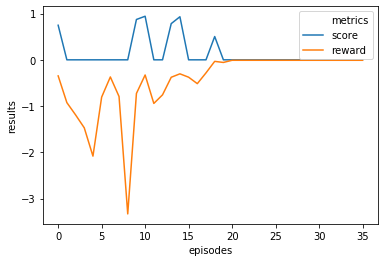

Max Train Score 1 Max Test Score 0
Mean Train Score 0.13282684688479207 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


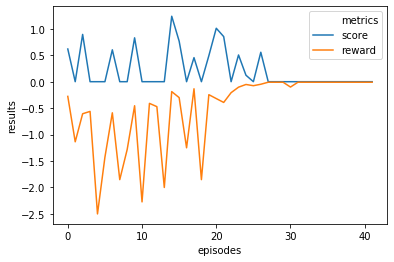

Max Train Score 2 Max Test Score 0
Mean Train Score 0.21291520108700185 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


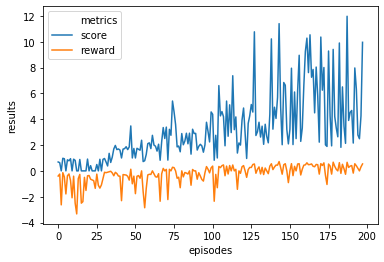

Max Train Score 23 Max Test Score 26
Mean Train Score 3.193486202064681 Mean Test Score 5.655055456401922
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


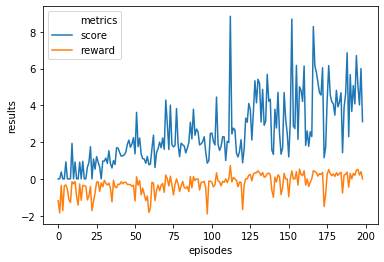

Max Train Score 17 Max Test Score 19
Mean Train Score 2.502111297555148 Mean Test Score 4.554872344454342
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


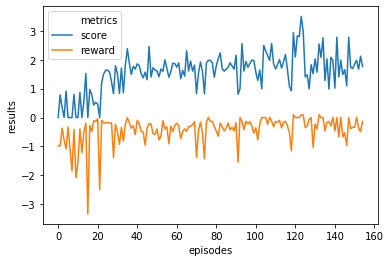

Max Train Score 6 Max Test Score 5
Mean Train Score 1.5691562475633665 Mean Test Score 1.7387698672281169
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


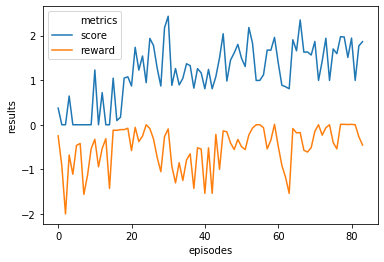

Max Train Score 4 Max Test Score 4
Mean Train Score 1.1782594691024575 Mean Test Score 1.531284214462898
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


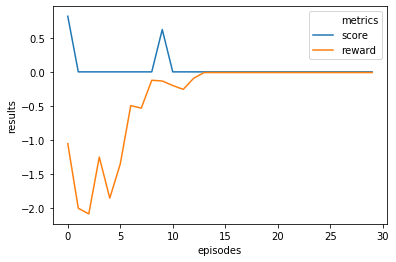

Max Train Score 2 Max Test Score 0
Mean Train Score 0.04787750626566416 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


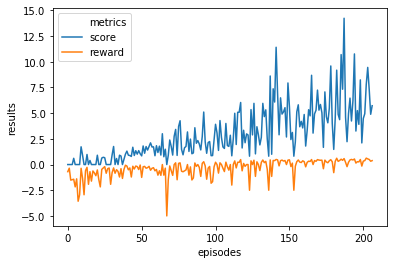

Max Train Score 26 Max Test Score 23
Mean Train Score 2.9579791121609182 Mean Test Score 4.33114645248929
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


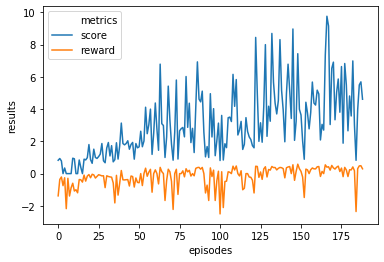

Max Train Score 20 Max Test Score 17
Mean Train Score 3.0471660521914403 Mean Test Score 4.130064317430133
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


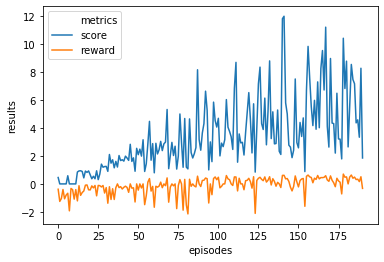

Max Train Score 26 Max Test Score 26
Mean Train Score 3.3710597909281543 Mean Test Score 5.849357055392177
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


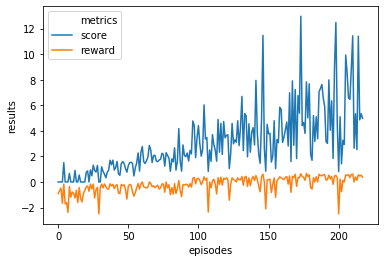

Max Train Score 25 Max Test Score 20
Mean Train Score 3.0238795268792873 Mean Test Score 5.037774564797584
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


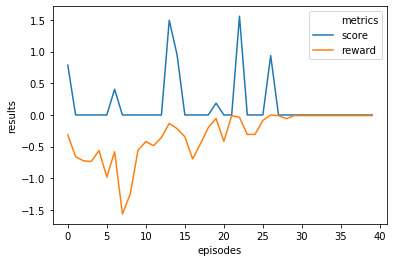

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15809492923153745 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


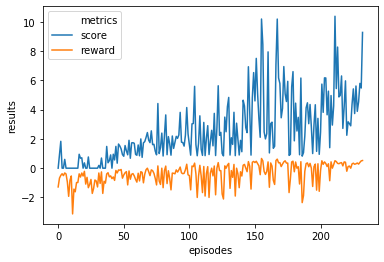

Max Train Score 21 Max Test Score 20
Mean Train Score 2.5511607694872254 Mean Test Score 4.142677564265893
----------------------------------------------------------------------------------------------------
Learning rate max results  3


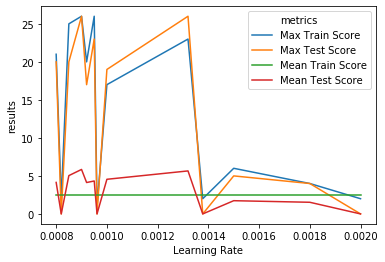

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 202      |
|    ep_rew_mean        | -41.7    |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.509   |
|    explained_variance | -0.175   |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.000303 |
|    value_loss         | 3.61e-06 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 139      |
|    ep_rew_mean        | -25.4    |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 71.2     |
|    ep_rew_mean        | -18.3    |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0887  |
|    explained_variance | -0.187   |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.0442   |
|    value_loss         | 3.63     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 78.8      |
|    ep_rew_mean        | -14.2     |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 124      |
|    ep_rew_mean        | -1.7     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0498  |
|    explained_variance | 0.0282   |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00207 |
|    value_loss         | 0.0168   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 126      |
|    ep_rew_mean        | 10.3     |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.9     |
|    ep_rew_mean        | -1       |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0386  |
|    explained_variance | -0.588   |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -0.003   |
|    value_loss         | 0.238    |
------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.9     |
|    ep_rew_mean        | -40.7    |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/             

Learning Rate 0.0009610612889534735


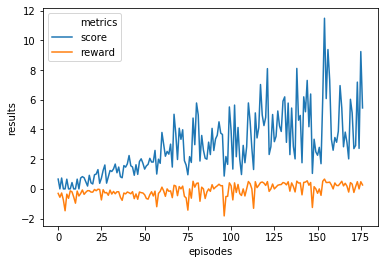

Max Train Score 21 Max Test Score 25
Mean Train Score 2.9138016620145253 Mean Test Score 5.402765383337639
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


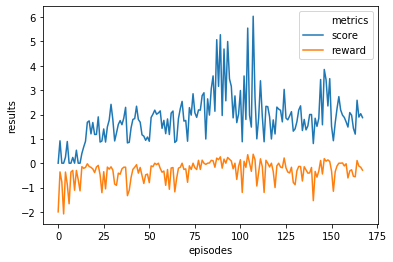

Max Train Score 12 Max Test Score 11
Mean Train Score 1.8627112477167231 Mean Test Score 2.495763071455971
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


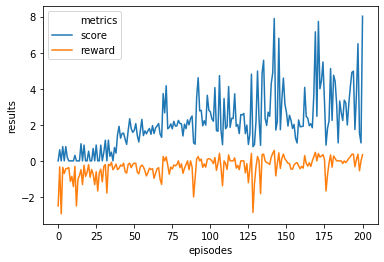

Max Train Score 15 Max Test Score 11
Mean Train Score 2.153099160324193 Mean Test Score 3.0629632804863665
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


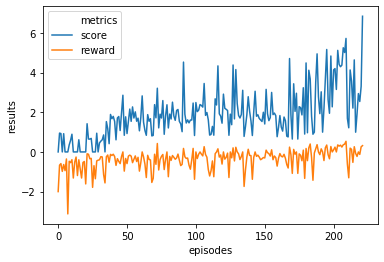

Max Train Score 11 Max Test Score 22
Mean Train Score 1.8890634251164427 Mean Test Score 4.193206831200224
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


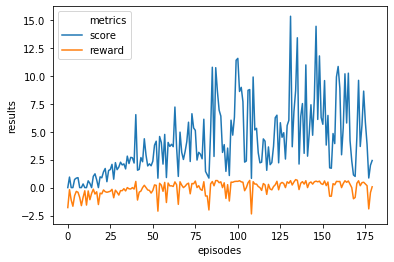

Max Train Score 30 Max Test Score 27
Mean Train Score 4.110784300195346 Mean Test Score 6.197403375924497
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


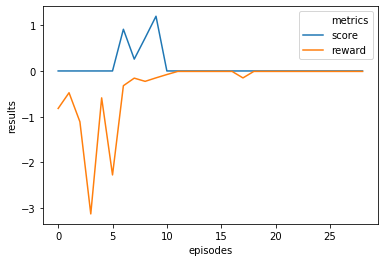

Max Train Score 2 Max Test Score 0
Mean Train Score 0.10647188484761401 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


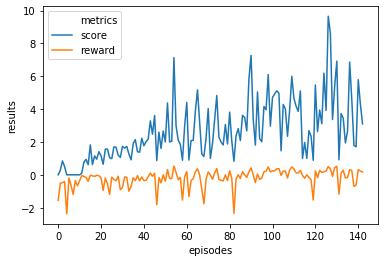

Max Train Score 18 Max Test Score 20
Mean Train Score 2.6636972008208075 Mean Test Score 3.3735021058826447
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


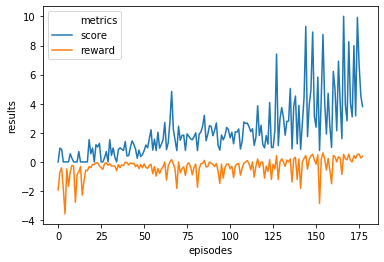

Max Train Score 18 Max Test Score 18
Mean Train Score 2.1542021000122262 Mean Test Score 4.753264737840944
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


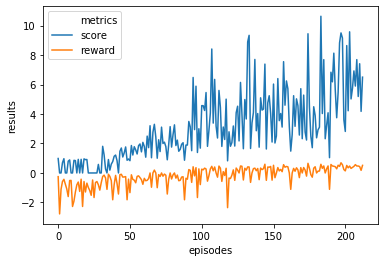

Max Train Score 20 Max Test Score 22
Mean Train Score 3.0529545647870897 Mean Test Score 5.360143264134977
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


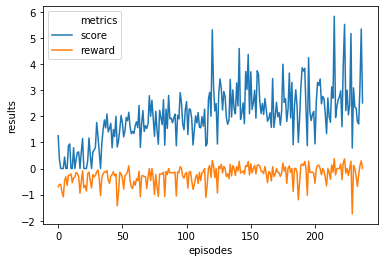

Max Train Score 11 Max Test Score 13
Mean Train Score 2.0039993501842823 Mean Test Score 3.07868877155106
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


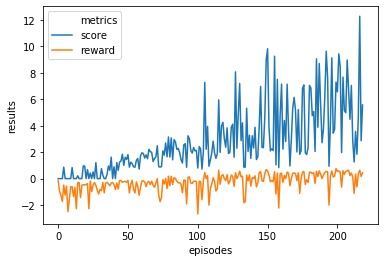

Max Train Score 23 Max Test Score 29
Mean Train Score 2.798648312778901 Mean Test Score 6.317608789967586
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


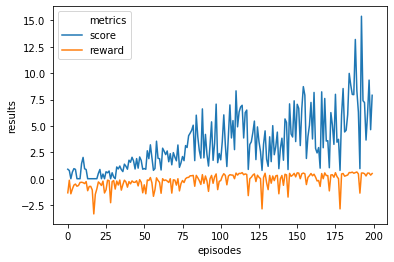

Max Train Score 31 Max Test Score 27
Mean Train Score 3.3126703183413935 Mean Test Score 5.854027369337702
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


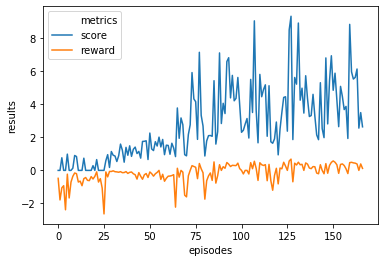

Max Train Score 18 Max Test Score 24
Mean Train Score 2.74021955805057 Mean Test Score 4.5722123873980305
----------------------------------------------------------------------------------------------------
Learning rate max results  4


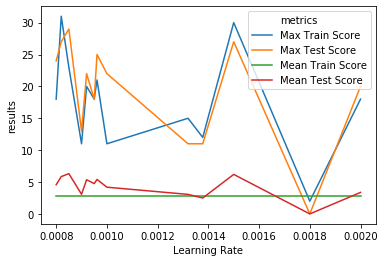

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.1     |
|    ep_rew_mean        | -31.1    |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.537   |
|    explained_variance | -132     |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.0379   |
|    value_loss         | 16.4     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.3     |
|    ep_rew_mean        | -8.4     |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.8     |
|    ep_rew_mean        | -22.3    |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.202   |
|    explained_variance | 0.237    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00365 |
|    value_loss         | 0.558    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.8     |
|    ep_rew_mean        | 2.7      |
| time/                 |          |
|    fps                | 417      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 809       |
|    ep_rew_mean        | -19.4     |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.000549 |
|    explained_variance | -0.314    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | 2.01e-11  |
|    value_loss         | 5.38e-12  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 850       |
|    ep_rew_mean        | -17.4     |
| time/                 |           |
|    fps                | 443       |
|    iterations         | 4000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 118      |
|    ep_rew_mean        | 21.4     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0103  |
|    explained_variance | 0.0148   |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 2.25e-06 |
|    value_loss         | 6.07e-05 |
------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 77.4     |
|    ep_rew_mean        | -33.9    |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/             

Learning Rate 0.0009610612889534735


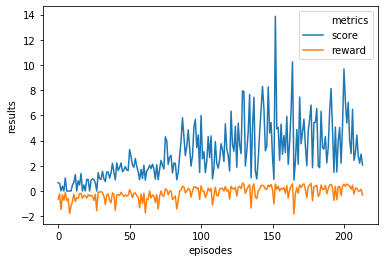

Max Train Score 28 Max Test Score 25
Mean Train Score 3.044689441783158 Mean Test Score 5.714808020499193
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


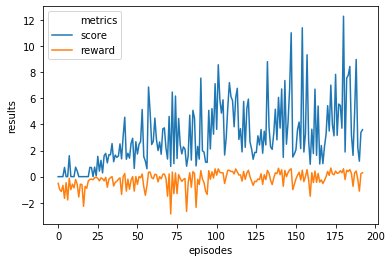

Max Train Score 25 Max Test Score 36
Mean Train Score 3.090171144781726 Mean Test Score 6.6266242887364015
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


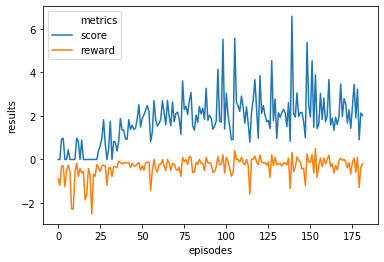

Max Train Score 13 Max Test Score 17
Mean Train Score 1.816725713687303 Mean Test Score 2.993463013827202
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


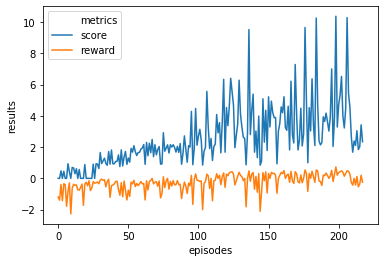

Max Train Score 19 Max Test Score 26
Mean Train Score 2.5791730519382803 Mean Test Score 4.6503107213041615
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


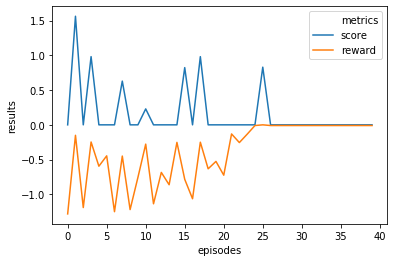

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15093679242896516 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


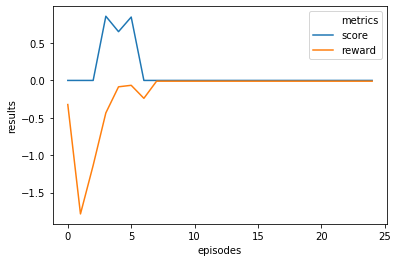

Max Train Score 2 Max Test Score 0
Mean Train Score 0.09435895058867155 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


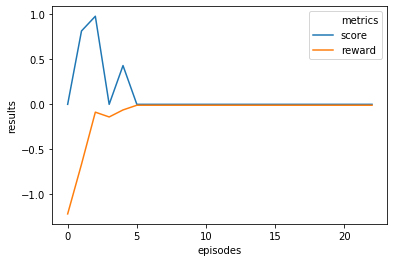

Max Train Score 1 Max Test Score 0
Mean Train Score 0.09689230426018434 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


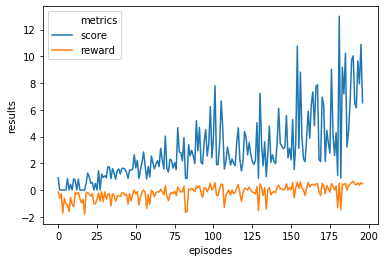

Max Train Score 23 Max Test Score 24
Mean Train Score 2.983663952332685 Mean Test Score 5.753151152869797
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


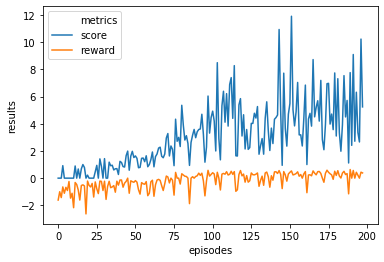

Max Train Score 23 Max Test Score 21
Mean Train Score 3.032214501684276 Mean Test Score 5.391132087440228
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


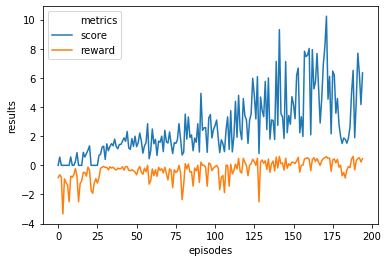

Max Train Score 19 Max Test Score 21
Mean Train Score 2.649491994273536 Mean Test Score 4.487710308141482
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


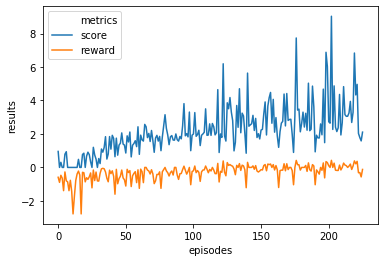

Max Train Score 19 Max Test Score 20
Mean Train Score 2.1890387113225933 Mean Test Score 3.22320417442035
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


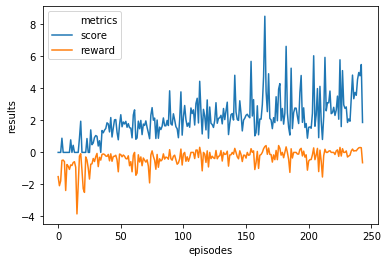

Max Train Score 16 Max Test Score 15
Mean Train Score 2.1045469453333214 Mean Test Score 3.6374248937561653
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


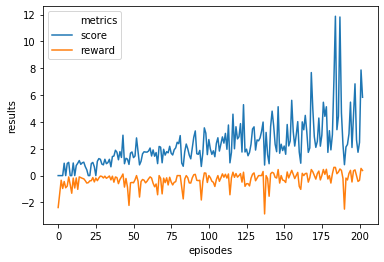

Max Train Score 23 Max Test Score 20
Mean Train Score 2.298563827698839 Mean Test Score 3.966033321339885
----------------------------------------------------------------------------------------------------
Learning rate max results  5


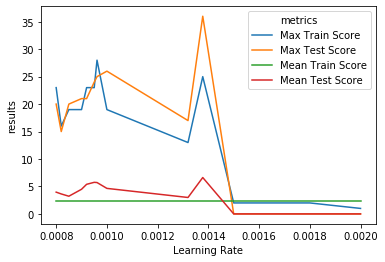

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.4     |
|    ep_rew_mean        | -31.5    |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.588   |
|    explained_variance | -361     |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.219    |
|    value_loss         | 17.6     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95       |
|    ep_rew_mean        | -3.7     |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.9     |
|    ep_rew_mean        | -4.8     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0302  |
|    explained_variance | -2.03    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00749 |
|    value_loss         | 0.792    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 98.3     |
|    ep_rew_mean        | 20.9     |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 643       |
|    ep_rew_mean        | -25.5     |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0217   |
|    explained_variance | 0         |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -9.04e-12 |
|    value_loss         | 7.77e-17  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 709       |
|    ep_rew_mean        | -22.6     |
| time/                 |           |
|    fps                | 459       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 118      |
|    ep_rew_mean        | 35.8     |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0282  |
|    explained_variance | nan      |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -0.00105 |
|    value_loss         | 0.0733   |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 110       |
|    ep_rew_mean        | -44.1     |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


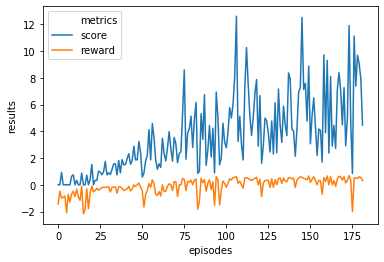

Max Train Score 25 Max Test Score 31
Mean Train Score 3.6195868694596935 Mean Test Score 7.346462281879054
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


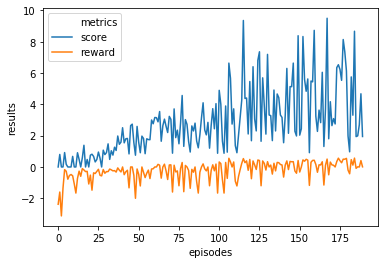

Max Train Score 18 Max Test Score 15
Mean Train Score 2.806586990311726 Mean Test Score 3.048832233665978
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


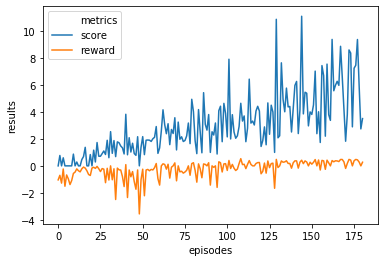

Max Train Score 20 Max Test Score 22
Mean Train Score 2.988992397497774 Mean Test Score 5.523384750359633
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


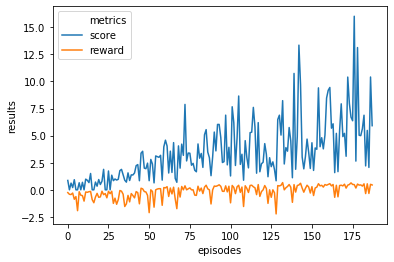

Max Train Score 27 Max Test Score 37
Mean Train Score 3.468195364779507 Mean Test Score 7.331781758987611
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


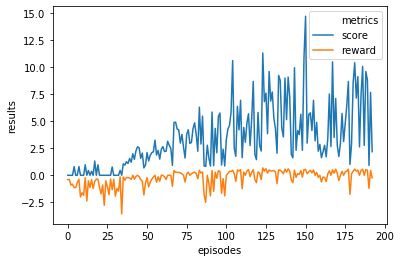

Max Train Score 28 Max Test Score 27
Mean Train Score 3.4444336485398486 Mean Test Score 5.945770802069423
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


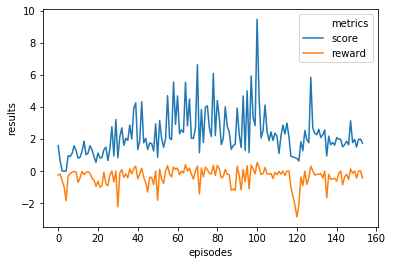

Max Train Score 19 Max Test Score 6
Mean Train Score 2.270012540514793 Mean Test Score 1.8797805074591232
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


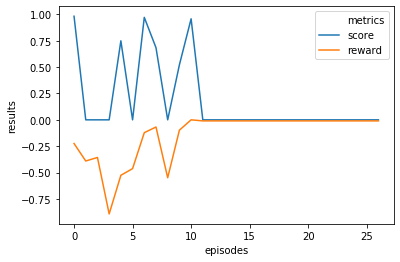

Max Train Score 1 Max Test Score 0
Mean Train Score 0.18042282545287341 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


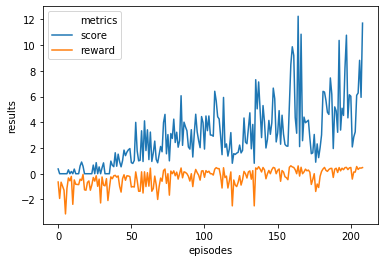

Max Train Score 26 Max Test Score 21
Mean Train Score 2.9231338790855252 Mean Test Score 5.81506510854856
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


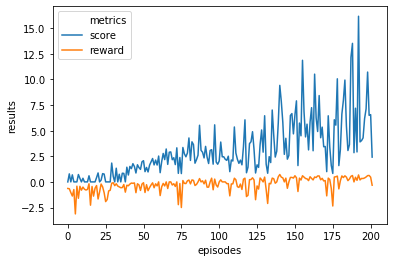

Max Train Score 31 Max Test Score 28
Mean Train Score 3.0922325755002995 Mean Test Score 5.646373513696857
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


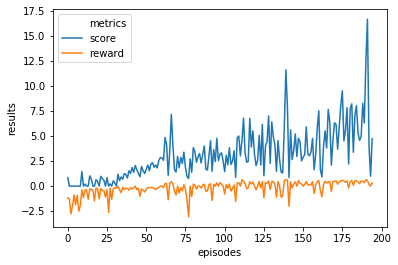

Max Train Score 29 Max Test Score 27
Mean Train Score 3.104603848278467 Mean Test Score 5.543704136951853
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


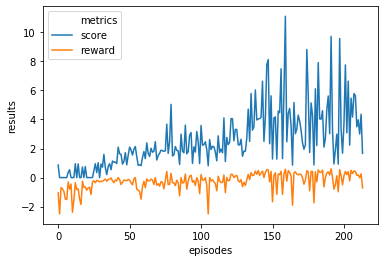

Max Train Score 21 Max Test Score 20
Mean Train Score 2.5447469538524596 Mean Test Score 3.828834968325301
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


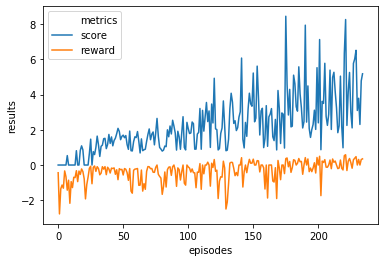

Max Train Score 16 Max Test Score 24
Mean Train Score 2.234542402906577 Mean Test Score 4.686902921090883
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


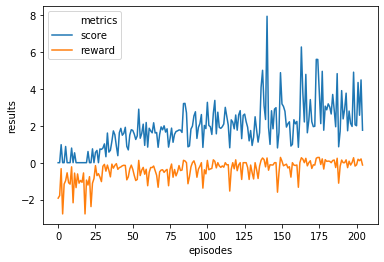

Max Train Score 15 Max Test Score 15
Mean Train Score 1.9161666121726326 Mean Test Score 3.7322791776699478
----------------------------------------------------------------------------------------------------
Learning rate max results  6


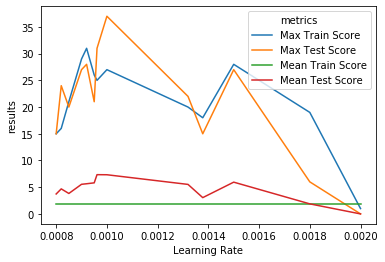

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 171       |
|    ep_rew_mean        | -42.6     |
| time/                 |           |
|    fps                | 411       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.385    |
|    explained_variance | 0.12      |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -0.000156 |
|    value_loss         | 2.2e-06   |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 114      |
|    ep_rew_mean        | -27.7    |
| time/                 |          |
|    fps                | 407      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.8     |
|    ep_rew_mean        | -2.1     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0481  |
|    explained_variance | 0.746    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.00269  |
|    value_loss         | 0.185    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 102      |
|    ep_rew_mean        | 29.2     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 102       |
|    ep_rew_mean        | 17.7      |
| time/                 |           |
|    fps                | 428       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.000697 |
|    explained_variance | 0.414     |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | 0.000174  |
|    value_loss         | 2.96      |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 130      |
|    ep_rew_mean        | 40       |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 106       |
|    ep_rew_mean        | 22.2      |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.000528 |
|    explained_variance | 0.516     |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -2.98e-05 |
|    value_loss         | 0.8       |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.8     |
|    ep_rew_mean        | -42.3    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


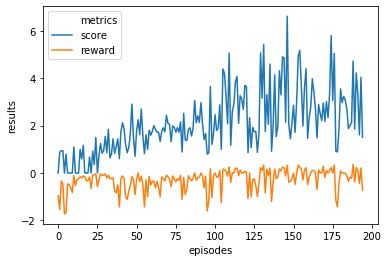

Max Train Score 14 Max Test Score 16
Mean Train Score 2.082295492880281 Mean Test Score 3.375206498564407
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


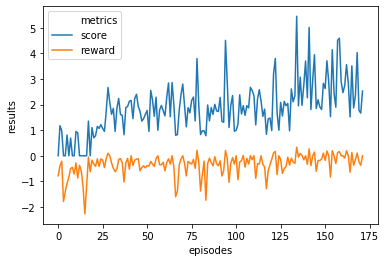

Max Train Score 11 Max Test Score 11
Mean Train Score 1.866164549634027 Mean Test Score 2.3864510028059716
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


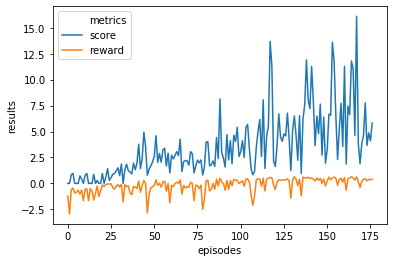

Max Train Score 30 Max Test Score 28
Mean Train Score 3.5005100644558227 Mean Test Score 7.240775476486697
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


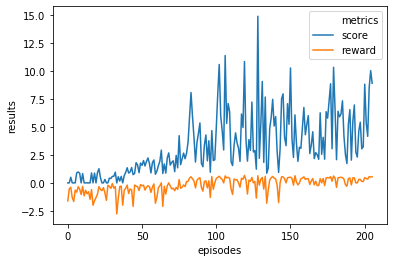

Max Train Score 31 Max Test Score 30
Mean Train Score 3.299852252909541 Mean Test Score 6.177131984524411
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


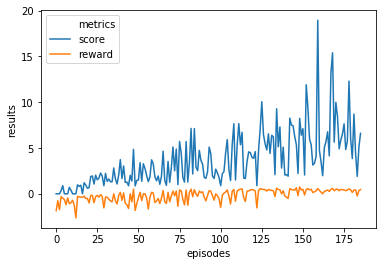

Max Train Score 38 Max Test Score 32
Mean Train Score 3.6867705801650166 Mean Test Score 7.66364965187578
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


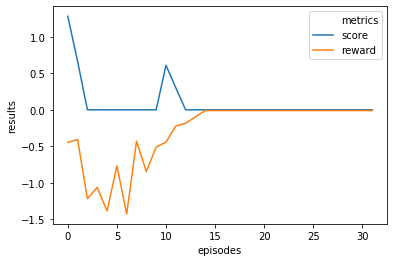

Max Train Score 2 Max Test Score 0
Mean Train Score 0.08936357763873219 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


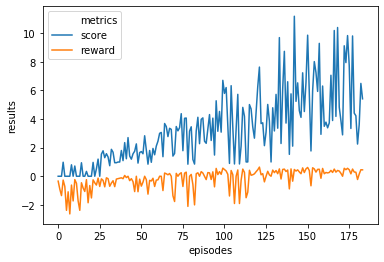

Max Train Score 21 Max Test Score 21
Mean Train Score 3.274500927626723 Mean Test Score 5.975671246101876
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


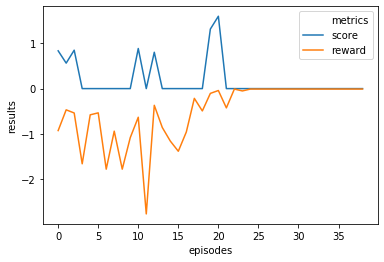

Max Train Score 3 Max Test Score 0
Mean Train Score 0.1761711147683735 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


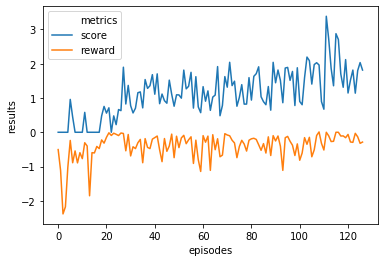

Max Train Score 5 Max Test Score 6
Mean Train Score 1.1345499793290097 Mean Test Score 1.7305337038454816
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


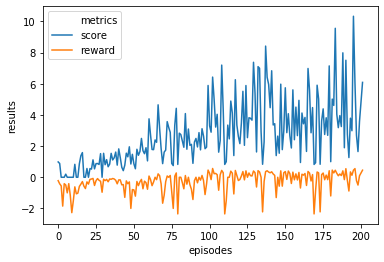

Max Train Score 19 Max Test Score 27
Mean Train Score 2.732995773117866 Mean Test Score 4.63074569187825
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


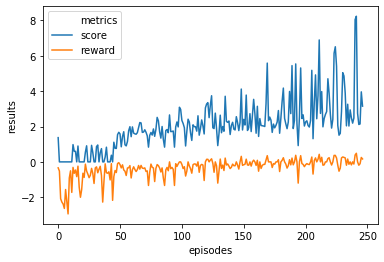

Max Train Score 15 Max Test Score 15
Mean Train Score 2.0359775726335303 Mean Test Score 3.7814338317950353
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


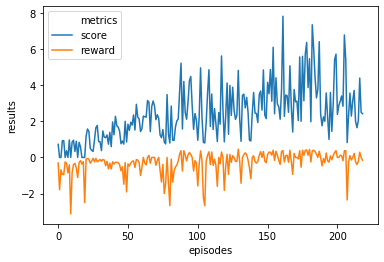

Max Train Score 14 Max Test Score 18
Mean Train Score 2.4209786365557107 Mean Test Score 3.7947879342767066
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


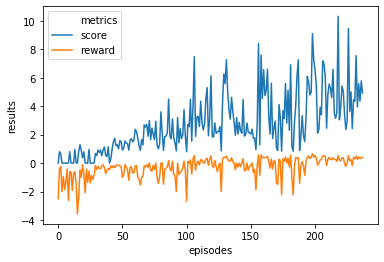

Max Train Score 20 Max Test Score 22
Mean Train Score 2.7444398560920718 Mean Test Score 4.814391060932859
----------------------------------------------------------------------------------------------------
Learning rate max results  7


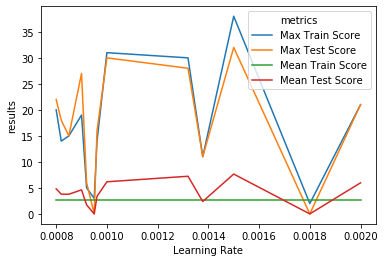

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 120      |
|    ep_rew_mean        | -47      |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.163   |
|    explained_variance | -0.23    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | -8.7e-05 |
|    value_loss         | 4.71e-06 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 180      |
|    ep_rew_mean        | -39.8    |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 2000 

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 72.8      |
|    ep_rew_mean        | -4.8      |
| time/                 |           |
|    fps                | 432       |
|    iterations         | 2000      |
|    time_elapsed       | 23        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.0235   |
|    explained_variance | 0.986     |
|    learning_rate      | 0.001     |
|    n_updates          | 1999      |
|    policy_loss        | -0.000231 |
|    value_loss         | 0.17      |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 88.5      |
|    ep_rew_mean        | 16.6      |
| time/                 |           |
|    fps                | 432       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 541      |
|    ep_rew_mean        | -29.3    |
| time/                 |          |
|    fps                | 445      |
|    iterations         | 3000     |
|    time_elapsed       | 33       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0138  |
|    explained_variance | -2.78    |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | 9.11e-10 |
|    value_loss         | 2.42e-13 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 612      |
|    ep_rew_mean        | -26.2    |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 4000     |
|    time_elapsed       | 44       |
|    total_timesteps    | 20000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 112       |
|    ep_rew_mean        | 40.1      |
| time/                 |           |
|    fps                | 416       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.00142  |
|    explained_variance | -3.26e+11 |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -0.000171 |
|    value_loss         | 1.73      |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.5     |
|    ep_rew_mean        | -40.9    |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


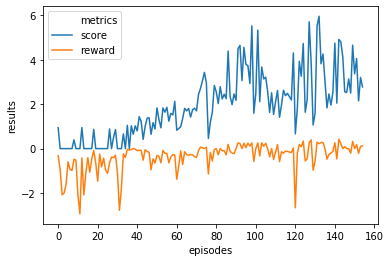

Max Train Score 10 Max Test Score 17
Mean Train Score 1.9420882644343156 Mean Test Score 3.9043458440723375
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


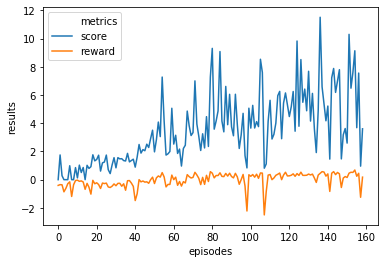

Max Train Score 20 Max Test Score 23
Mean Train Score 3.5087032064987573 Mean Test Score 4.936708271483283
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


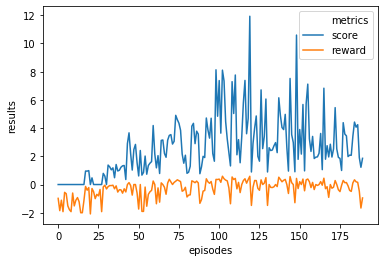

Max Train Score 23 Max Test Score 16
Mean Train Score 2.602425012760194 Mean Test Score 2.863954393662848
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


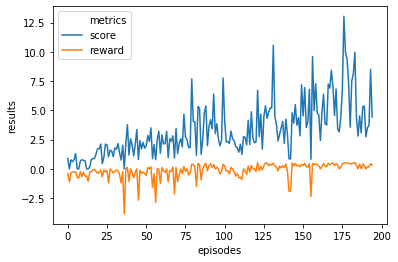

Max Train Score 25 Max Test Score 23
Mean Train Score 3.295789806872893 Mean Test Score 4.40513277004252
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


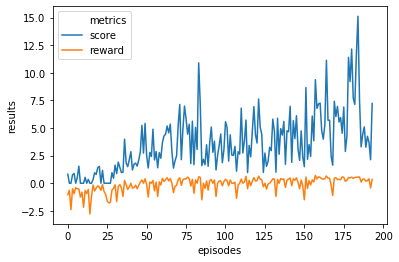

Max Train Score 29 Max Test Score 32
Mean Train Score 3.5829242862528075 Mean Test Score 8.444802750844739
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


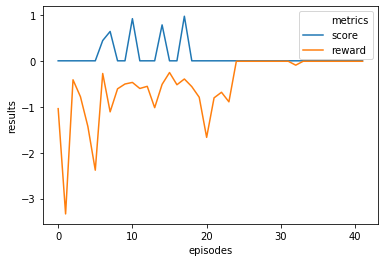

Max Train Score 1 Max Test Score 0
Mean Train Score 0.08929198975741662 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


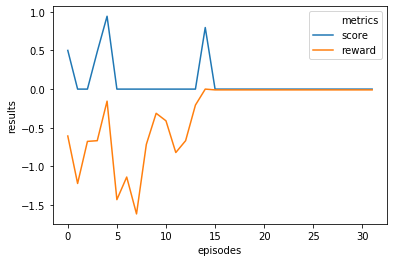

Max Train Score 1 Max Test Score 0
Mean Train Score 0.08502109521114157 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


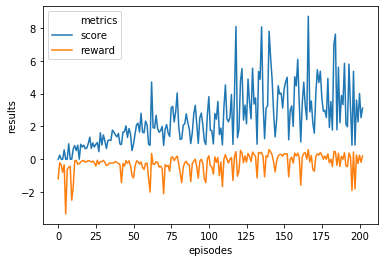

Max Train Score 16 Max Test Score 18
Mean Train Score 2.506641392099408 Mean Test Score 3.745015612630415
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


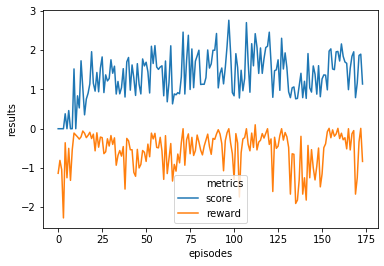

Max Train Score 7 Max Test Score 5
Mean Train Score 1.3631095699221394 Mean Test Score 1.164862504578083
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


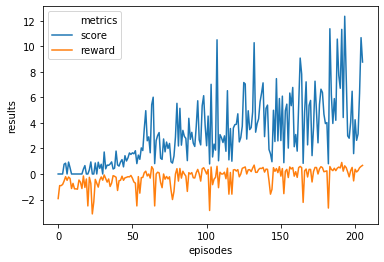

Max Train Score 26 Max Test Score 35
Mean Train Score 3.196218693559884 Mean Test Score 7.361763659122396
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


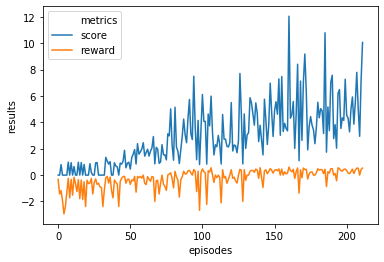

Max Train Score 20 Max Test Score 22
Mean Train Score 2.953914665384688 Mean Test Score 4.669023311190582
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


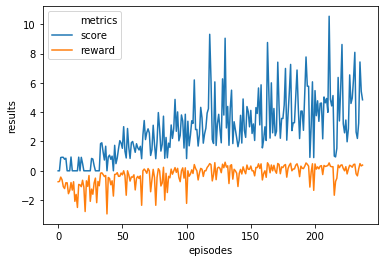

Max Train Score 20 Max Test Score 18
Mean Train Score 2.882144023520805 Mean Test Score 4.415807023359054
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


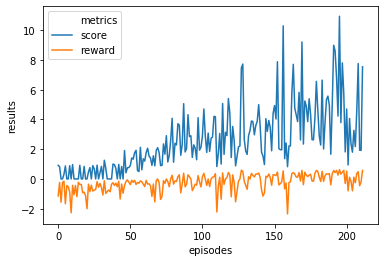

Max Train Score 19 Max Test Score 27
Mean Train Score 2.5952350233166737 Mean Test Score 5.113506679137792
----------------------------------------------------------------------------------------------------
Learning rate max results  8


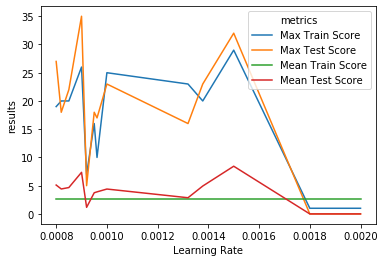

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.3     |
|    ep_rew_mean        | -36.2    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.411   |
|    explained_variance | 0.149    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.143    |
|    value_loss         | 0.355    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 103      |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89.2     |
|    ep_rew_mean        | -20.3    |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.348   |
|    explained_variance | 0.992    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.119    |
|    value_loss         | 0.916    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82.9     |
|    ep_rew_mean        | 7.2      |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99       |
|    ep_rew_mean        | 16.5     |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0176  |
|    explained_variance | 0.267    |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | 0.0309   |
|    value_loss         | 48       |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 136      |
|    ep_rew_mean        | 27.3     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 138       |
|    ep_rew_mean        | 57.6      |
| time/                 |           |
|    fps                | 430       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.000599 |
|    explained_variance | 0.571     |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -5.52e-05 |
|    value_loss         | 1.13      |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89.4     |
|    ep_rew_mean        | -36      |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


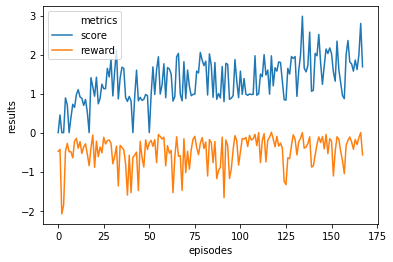

Max Train Score 5 Max Test Score 8
Mean Train Score 1.3233391624493425 Mean Test Score 2.0120561493984543
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


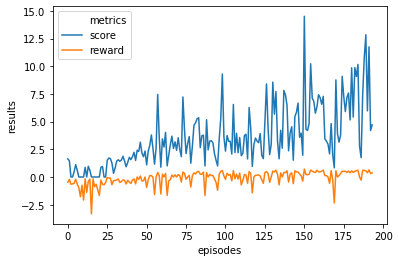

Max Train Score 27 Max Test Score 26
Mean Train Score 3.562756803272026 Mean Test Score 5.6592455851464205
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


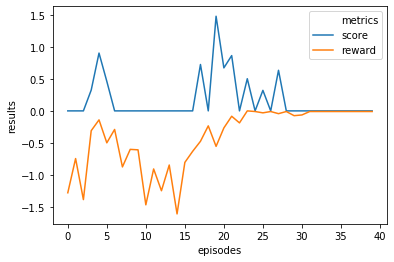

Max Train Score 2 Max Test Score 0
Mean Train Score 0.17248873355112712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


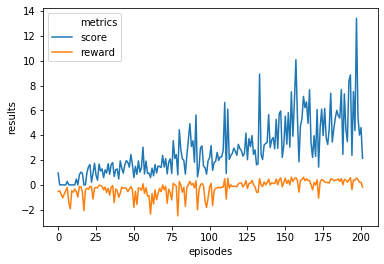

Max Train Score 24 Max Test Score 27
Mean Train Score 2.822226071273387 Mean Test Score 4.926282998272228
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


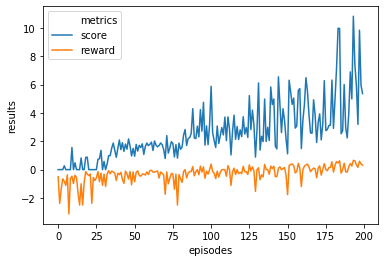

Max Train Score 21 Max Test Score 36
Mean Train Score 2.609247505207095 Mean Test Score 6.006800453821545
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


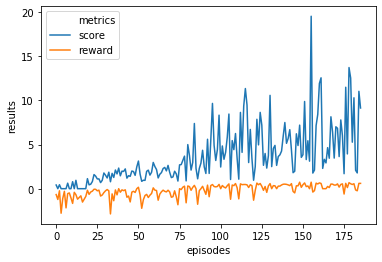

Max Train Score 39 Max Test Score 26
Mean Train Score 3.638867676662442 Mean Test Score 6.86102851840703
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


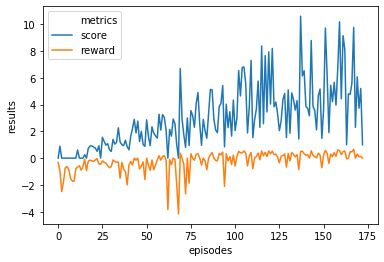

Max Train Score 20 Max Test Score 14
Mean Train Score 2.999314051135735 Mean Test Score 3.442748876184432
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


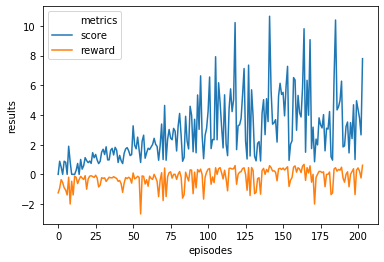

Max Train Score 21 Max Test Score 23
Mean Train Score 2.8916759025533816 Mean Test Score 4.917199110537337
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


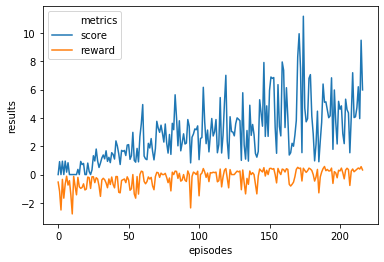

Max Train Score 20 Max Test Score 19
Mean Train Score 2.921812367981413 Mean Test Score 4.816331872381222
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


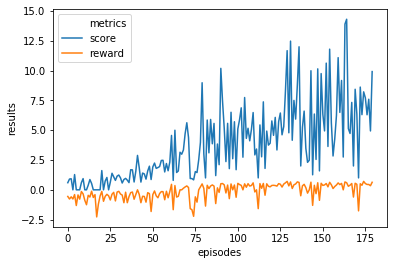

Max Train Score 30 Max Test Score 30
Mean Train Score 3.816158348101749 Mean Test Score 6.161774046933141
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


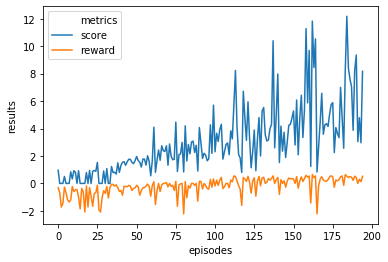

Max Train Score 22 Max Test Score 24
Mean Train Score 3.0114649037106505 Mean Test Score 5.371177936499297
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


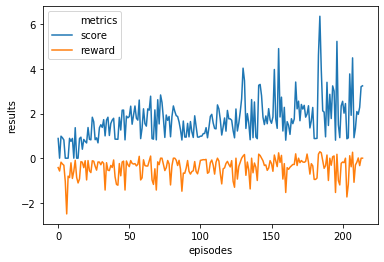

Max Train Score 11 Max Test Score 20
Mean Train Score 1.7138192024362666 Mean Test Score 2.8235308868899787
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


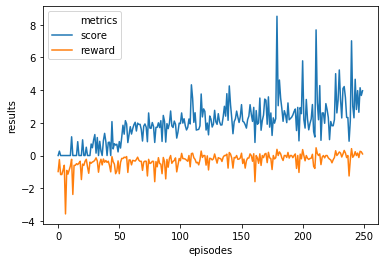

Max Train Score 16 Max Test Score 21
Mean Train Score 1.979997897954961 Mean Test Score 3.7126448840691366
----------------------------------------------------------------------------------------------------
Learning rate max results  9


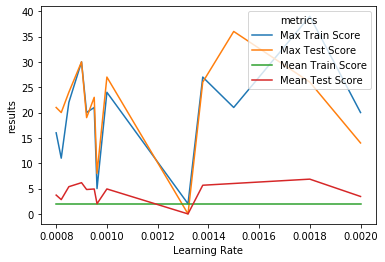

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.9     |
|    ep_rew_mean        | -44.7    |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.86    |
|    explained_variance | -0.441   |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | -0.0299  |
|    value_loss         | 0.000476 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79.4     |
|    ep_rew_mean        | -20.1    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 107      |
|    ep_rew_mean        | -26.5    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.229   |
|    explained_variance | 0.248    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00442 |
|    value_loss         | 0.00206  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 97.5     |
|    ep_rew_mean        | -11.6    |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 100      |
|    ep_rew_mean        | -17      |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 3000     |
|    time_elapsed       | 33       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.00708 |
|    explained_variance | -0.0305  |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | 4.7e-06  |
|    value_loss         | 0.000526 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 101       |
|    ep_rew_mean        | -13.1     |
| time/                 |           |
|    fps                | 437       |
|    iterations         | 4000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 20000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 119      |
|    ep_rew_mean        | 40.5     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00713 |
|    explained_variance | 0.468    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 0.000433 |
|    value_loss         | 12.1     |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 172       |
|    ep_rew_mean        | -45.2     |
| time/                 |           |
|    fps                | 443       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


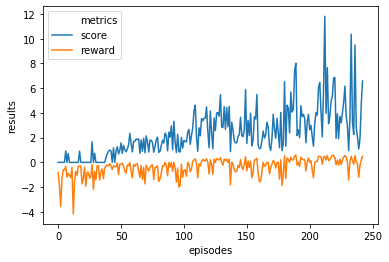

Max Train Score 22 Max Test Score 22
Mean Train Score 2.3478701946479044 Mean Test Score 5.0137495085262165
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


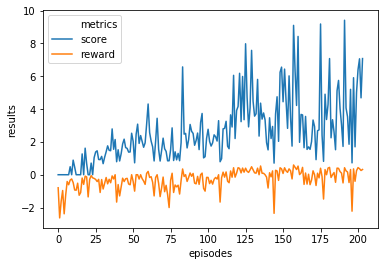

Max Train Score 18 Max Test Score 21
Mean Train Score 2.6258173790431543 Mean Test Score 4.385880819119995
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


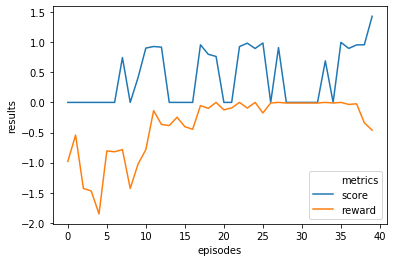

Max Train Score 3 Max Test Score 3
Mean Train Score 0.42624362449611686 Mean Test Score 1.4479778012500966
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


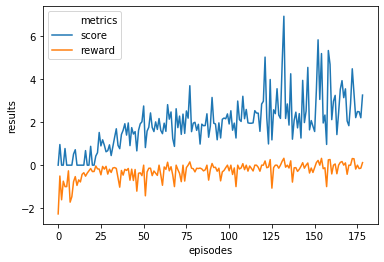

Max Train Score 13 Max Test Score 12
Mean Train Score 1.9533541412893933 Mean Test Score 3.163116971986063
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


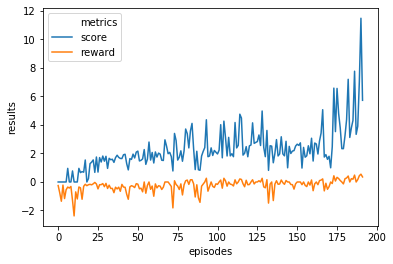

Max Train Score 21 Max Test Score 23
Mean Train Score 2.268020580502443 Mean Test Score 5.5999469826538215
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


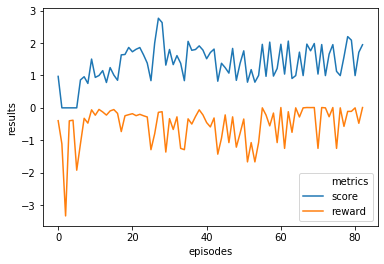

Max Train Score 5 Max Test Score 4
Mean Train Score 1.3648667967112325 Mean Test Score 1.3732711144262486
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


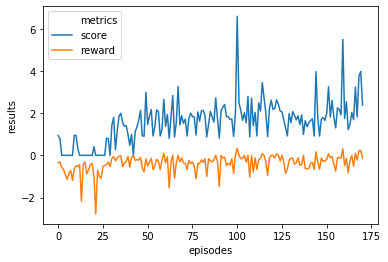

Max Train Score 12 Max Test Score 12
Mean Train Score 1.5720503029994362 Mean Test Score 2.18116828421709
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


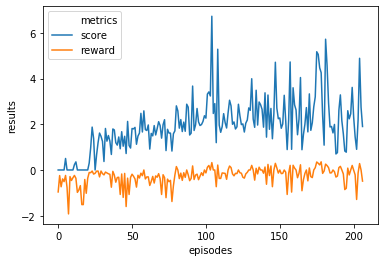

Max Train Score 12 Max Test Score 11
Mean Train Score 1.9445202294352826 Mean Test Score 2.7493590053238943
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


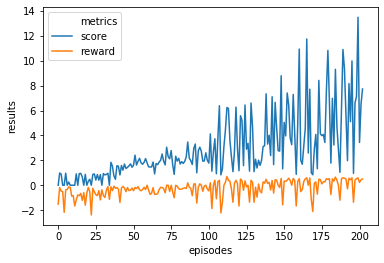

Max Train Score 25 Max Test Score 29
Mean Train Score 2.9338089094781945 Mean Test Score 5.887924100999171
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


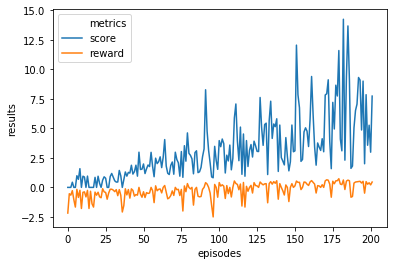

Max Train Score 30 Max Test Score 23
Mean Train Score 3.1694100357567567 Mean Test Score 5.113510227200706
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


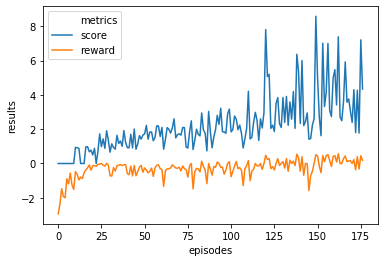

Max Train Score 18 Max Test Score 30
Mean Train Score 2.2200071475706524 Mean Test Score 4.9197855421060614
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


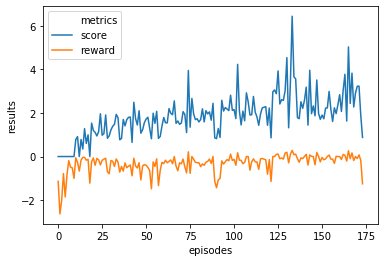

Max Train Score 12 Max Test Score 20
Mean Train Score 1.865384394146104 Mean Test Score 3.557094874591312
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


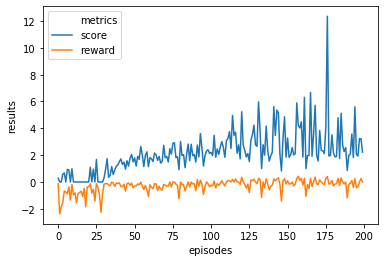

Max Train Score 23 Max Test Score 18
Mean Train Score 2.175583582362003 Mean Test Score 3.428967162484743
----------------------------------------------------------------------------------------------------
Learning rate max results  10


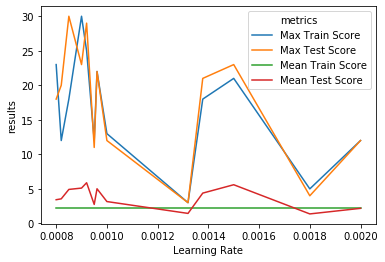

----------------------------------------------------------------------------------------------------


In [99]:
learning_rates=[0.0009610612889534735,0.0013779226379577784,0.0013197979371411934,0.001,0.0015,0.0018,0.002,0.00095,0.00092,0.0009,0.00085,0.00082,0.0008]
for i in range(10):
    results = {}
    for learning_rate in learning_rates:
        # enable_render=True turns on the display
        snake_env = SnakeEnv(440, 440, enable_render=False)
        env = make_vec_env(lambda: snake_env, n_envs=1)

        #gamma = random.uniform(0.95, 1)
        #learning_rate=random.uniform(0.0005,0.0014)
        #print("lr: ", learning_rate)

        model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate,gamma=0.97)#, seed=42)#, gamma=gamma)
        model.learn(total_timesteps=20000, log_interval=1000)

        # Print rewards and scores for each episode
        max_train_score = snake_env.record
        mean_train_score = np.mean(np.array(snake_env.results['score']))
        max_test_score, mean_test_score = evaluate(model)

        results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

    for learning_rate, result in results.items():
        metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

        print("Learning Rate", learning_rate)
        plot_metrics(metrics)    
        print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
        print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
        print("-"*100)
    
    print("Learning rate max results ", i+1)
    plot_max_results(results,'Learning Rate')
    print("-"*100)

#### Result: os resultados sao sempre diferentes mas em media o 0.001 è bom

### Final Result: 0.001 is a good value

# Testando: use_rms_prop (Adam optimizer)

In [103]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    #learning_rate=random.uniform(0.001,0.1)
    learning_rate=random.uniform(0.0002,0.002)
    #learning_rate=1e-3

    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate, seed=42,use_rms_prop=True)#, gamma=gamma, normalize_advantage=True)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)

    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 73.9     |
|    ep_rew_mean        | -16.9    |
| time/                 |          |
|    fps                | 389      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0333  |
|    explained_variance | 0.0925   |
|    learning_rate      | 0.00195  |
|    n_updates          | 999      |
|    policy_loss        | 0.0234   |
|    value_loss         | 21.8     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.7     |
|    ep_rew_mean        | 0.1      |
| time/                 |          |
|    fps                | 372      |
|    iterations         | 2000     |
|    time_elapsed       | 26       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 68.1     |
|    ep_rew_mean        | -10.6    |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.00724 |
|    explained_variance | 0.494    |
|    learning_rate      | 0.00138  |
|    n_updates          | 1999     |
|    policy_loss        | 0.00486  |
|    value_loss         | 29.4     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 92.2      |
|    ep_rew_mean        | 6.4       |
| time/                 |           |
|    fps                | 423       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 104      |
|    ep_rew_mean        | 3        |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0307  |
|    explained_variance | 0.0685   |
|    learning_rate      | 0.00146  |
|    n_updates          | 2999     |
|    policy_loss        | 0.00697  |
|    value_loss         | 1.2      |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 132      |
|    ep_rew_mean        | 11       |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.3     |
|    ep_rew_mean        | 14       |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.127   |
|    explained_variance | -41.2    |
|    learning_rate      | 0.000457 |
|    n_updates          | 3999     |
|    policy_loss        | 0.132    |
|    value_loss         | 64.8     |
------------------------------------


Learning Rate 0.0019499281184388684


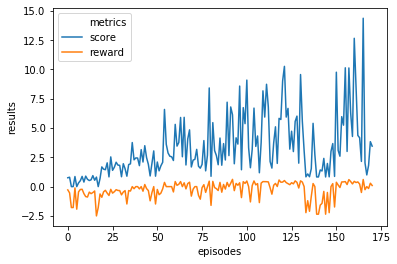

Max Train Score 30 Max Test Score 38
Mean Train Score 3.294718271626995 Mean Test Score 7.605292803175861
----------------------------------------------------------------------------------------------------
Learning Rate 0.0016776242980132462


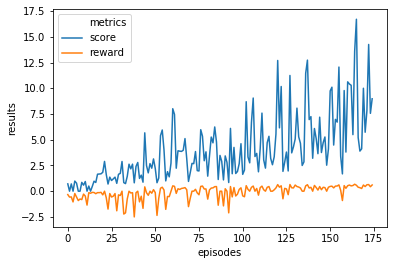

Max Train Score 31 Max Test Score 31
Mean Train Score 3.9834687674657783 Mean Test Score 6.855573309553877
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018961051898434076


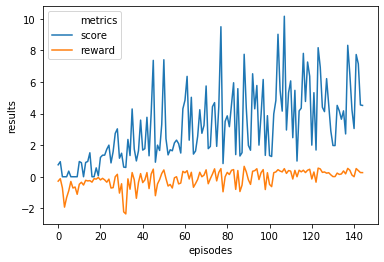

Max Train Score 19 Max Test Score 21
Mean Train Score 3.187641507594468 Mean Test Score 4.8453737419645275
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013766300607263578


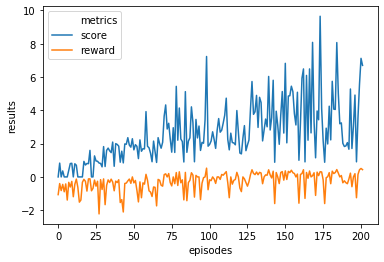

Max Train Score 15 Max Test Score 18
Mean Train Score 2.6185193008833267 Mean Test Score 4.154670082258815
----------------------------------------------------------------------------------------------------
Learning Rate 0.0019014190473246272


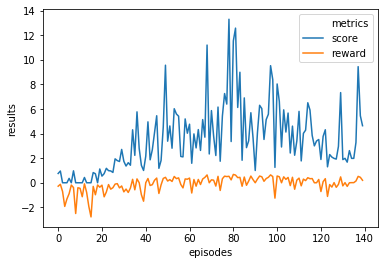

Max Train Score 24 Max Test Score 17
Mean Train Score 3.4854006299201905 Mean Test Score 4.332851776915255
----------------------------------------------------------------------------------------------------
Learning Rate 0.001863217337401785


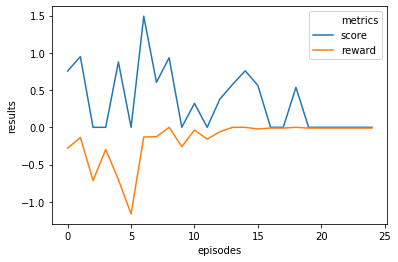

Max Train Score 2 Max Test Score 0
Mean Train Score 0.3497449806993557 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0014623849524624246


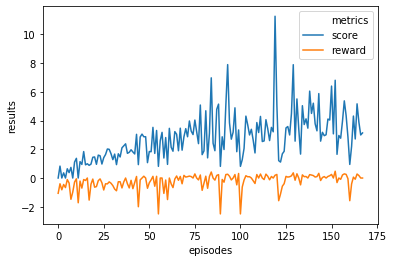

Max Train Score 18 Max Test Score 16
Mean Train Score 2.7719818497217847 Mean Test Score 4.269335158848171
----------------------------------------------------------------------------------------------------
Learning Rate 0.001315524449901961


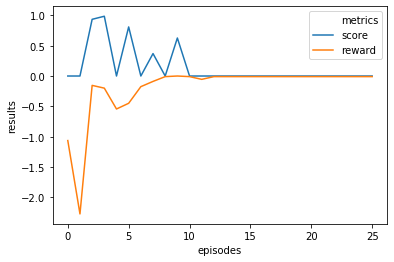

Max Train Score 1 Max Test Score 0
Mean Train Score 0.14324885292793874 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0014180590773612404


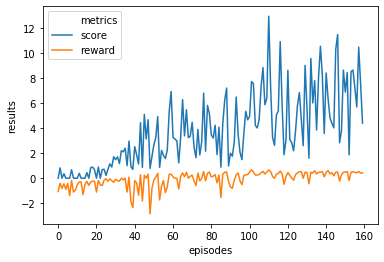

Max Train Score 24 Max Test Score 24
Mean Train Score 3.746920515259346 Mean Test Score 6.268152916421085
----------------------------------------------------------------------------------------------------
Learning Rate 0.000457135520302809


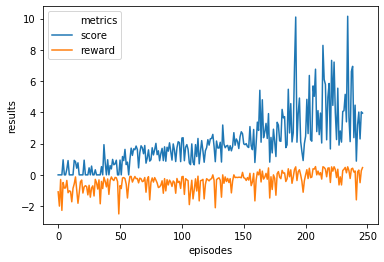

Max Train Score 19 Max Test Score 19
Mean Train Score 2.0813808042892865 Mean Test Score 4.3354526037561545
----------------------------------------------------------------------------------------------------


In [104]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

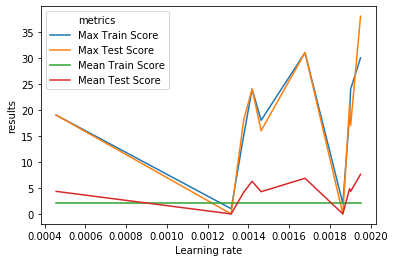

In [105]:
plot_max_results(results,'Learning rate')

#### Result: the range (0.0005,0.00125) is a good range, and seems that Adam Optimization is not so better than the default one

# Testando: n_eval_episode

## n_eval_episode range (1000,10000)

In [106]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #entropy = random.uniform(0, 0.1)
    
    n_eval_episode = random.uniform(1000,10000)
    
    #gamma=0.97 is the best one?
    #leaning_rate=??? see the best result from previous test
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97)#seed=42, gamma=0.97)#, ent_coef=entropy)
    model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | -43      |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.739   |
|    explained_variance | -0.132   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.16     |
|    value_loss         | 0.109    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89       |
|    ep_rew_mean        | -25.4    |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.2     |
|    ep_rew_mean        | -18.2    |
| time/                 |          |
|    fps                | 412      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0667  |
|    explained_variance | -299     |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -47.2    |
|    value_loss         | 519      |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.9     |
|    ep_rew_mean        | -8.5     |
| time/                 |          |
|    fps                | 409      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 138      |
|    ep_rew_mean        | -8.2     |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 3000     |
|    time_elapsed       | 33       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0339  |
|    explained_variance | 0.827    |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00194 |
|    value_loss         | 1.35     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 119       |
|    ep_rew_mean        | 6.4       |
| time/                 |           |
|    fps                | 441       |
|    iterations         | 4000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 20000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 471      |
|    ep_rew_mean        | -31      |
| time/                 |          |
|    fps                | 463      |
|    iterations         | 4000     |
|    time_elapsed       | 43       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0012  |
|    explained_variance | -1.09    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 8.1e-08  |
|    value_loss         | 1.36e-05 |
------------------------------------


n_eval_episode 1060.9063248292437


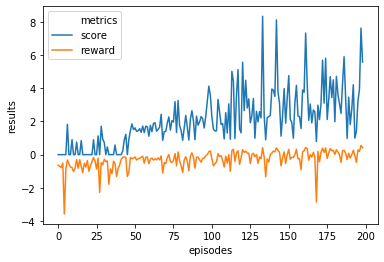

Max Train Score 16 Max Test Score 13
Mean Train Score 2.0898896991626246 Mean Test Score 3.187784148027344
----------------------------------------------------------------------------------------------------
n_eval_episode 4196.250807262621


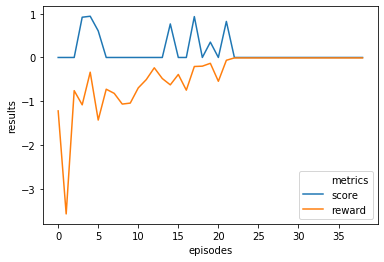

Max Train Score 1 Max Test Score 0
Mean Train Score 0.13688555496004995 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 4682.8968149621305


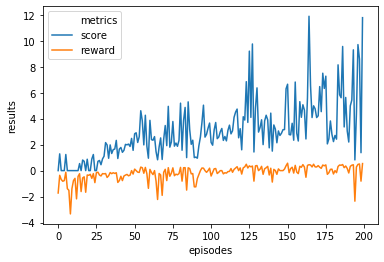

Max Train Score 22 Max Test Score 25
Mean Train Score 3.0261254574493948 Mean Test Score 6.302873806614484
----------------------------------------------------------------------------------------------------
n_eval_episode 5252.870523315611


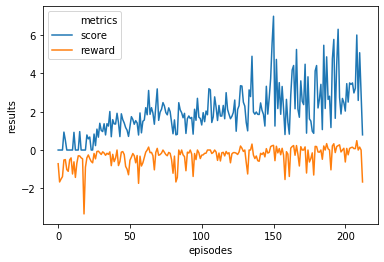

Max Train Score 13 Max Test Score 16
Mean Train Score 1.9980517964541136 Mean Test Score 3.614921331622629
----------------------------------------------------------------------------------------------------
n_eval_episode 5828.077172977617


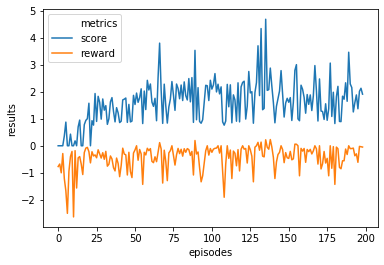

Max Train Score 9 Max Test Score 9
Mean Train Score 1.5972472381079457 Mean Test Score 1.8650293861700171
----------------------------------------------------------------------------------------------------
n_eval_episode 6781.718118639386


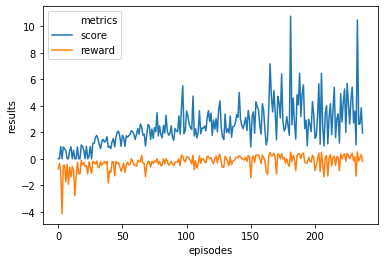

Max Train Score 19 Max Test Score 13
Mean Train Score 2.4585067779554555 Mean Test Score 3.430991544242761
----------------------------------------------------------------------------------------------------
n_eval_episode 1812.2743965976065


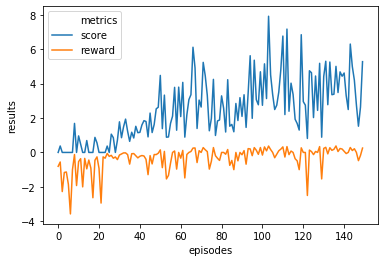

Max Train Score 14 Max Test Score 17
Mean Train Score 2.4512234205179424 Mean Test Score 3.4028229713267706
----------------------------------------------------------------------------------------------------
n_eval_episode 3036.317449727275


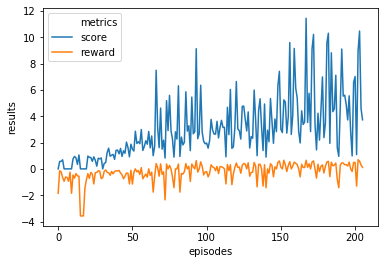

Max Train Score 23 Max Test Score 25
Mean Train Score 3.0425298803543503 Mean Test Score 6.702845912549968
----------------------------------------------------------------------------------------------------
n_eval_episode 4823.976856091731


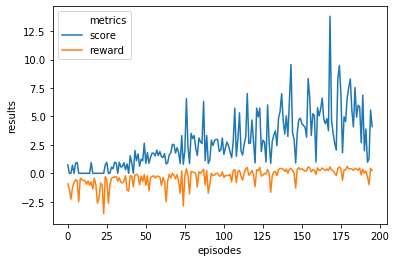

Max Train Score 26 Max Test Score 17
Mean Train Score 2.7827104909327893 Mean Test Score 4.476290751525235
----------------------------------------------------------------------------------------------------
n_eval_episode 6858.1985443895


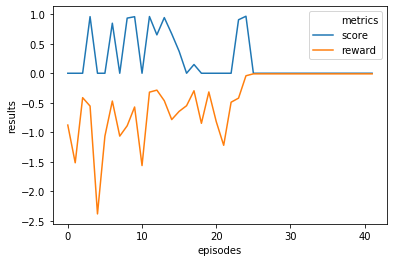

Max Train Score 1 Max Test Score 0
Mean Train Score 0.2215167964678239 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------


In [107]:
for n_eval_episode, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("n_eval_episode", n_eval_episode)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

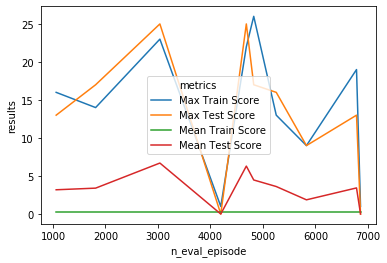

In [108]:
plot_max_results(results,'n_eval_episode')

#### Result: parece bom um n_eval_episodes entre 1000 e 4000

## n_eval_episodes range  (1000,4000)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79.6     |
|    ep_rew_mean        | -34      |
| time/                 |          |
|    fps                | 413      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.505   |
|    explained_variance | -8.42    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.532    |
|    value_loss         | 25.9     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.2     |
|    ep_rew_mean        | -11.2    |
| time/                 |          |
|    fps                | 413      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 96.3      |
|    ep_rew_mean        | -25.3     |
| time/                 |           |
|    fps                | 418       |
|    iterations         | 2000      |
|    time_elapsed       | 23        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.0386   |
|    explained_variance | 0.148     |
|    learning_rate      | 0.001     |
|    n_updates          | 1999      |
|    policy_loss        | -0.000668 |
|    value_loss         | 0.0289    |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 110      |
|    ep_rew_mean        | -16.5    |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 66.5      |
|    ep_rew_mean        | -10.6     |
| time/                 |           |
|    fps                | 420       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.00303  |
|    explained_variance | nan       |
|    learning_rate      | 0.001     |
|    n_updates          | 2999      |
|    policy_loss        | -0.000298 |
|    value_loss         | 0.943     |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 83.8     |
|    ep_rew_mean        | 6.6      |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 131      |
|    ep_rew_mean        | 12.9     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00971 |
|    explained_variance | 0.0686   |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.000351 |
|    value_loss         | 3.58     |
------------------------------------
n_eval_episode 3329.2336424068408


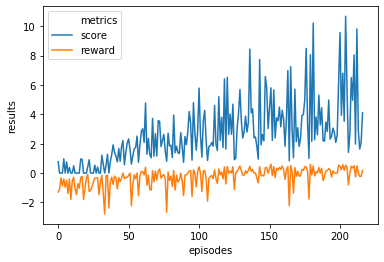

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6590966704709644 Mean Test Score 6.016069928361843
----------------------------------------------------------------------------------------------------
n_eval_episode 1636.5322481386434


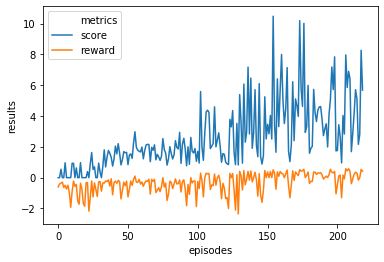

Max Train Score 22 Max Test Score 23
Mean Train Score 2.5851160594865155 Mean Test Score 4.405533605190108
----------------------------------------------------------------------------------------------------
n_eval_episode 3890.753152323753


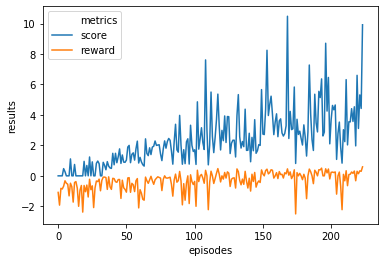

Max Train Score 20 Max Test Score 17
Mean Train Score 2.3828693059209627 Mean Test Score 4.5303758599345825
----------------------------------------------------------------------------------------------------
n_eval_episode 2613.4610605602543


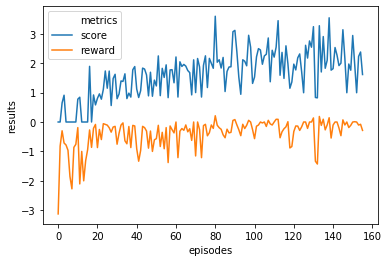

Max Train Score 8 Max Test Score 8
Mean Train Score 1.6312927105438757 Mean Test Score 2.111282063839223
----------------------------------------------------------------------------------------------------
n_eval_episode 3582.0300429238846


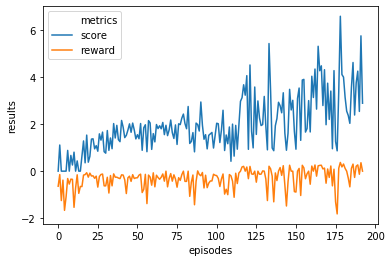

Max Train Score 12 Max Test Score 17
Mean Train Score 1.983417518952317 Mean Test Score 3.477310833086328
----------------------------------------------------------------------------------------------------
n_eval_episode 1816.3399124139871


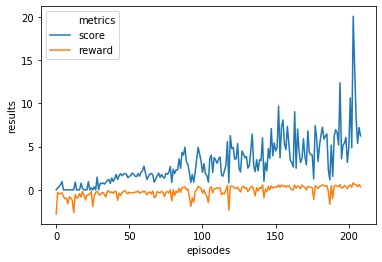

Max Train Score 35 Max Test Score 23
Mean Train Score 3.125927014585303 Mean Test Score 4.750459233488544
----------------------------------------------------------------------------------------------------
n_eval_episode 3074.42333466108


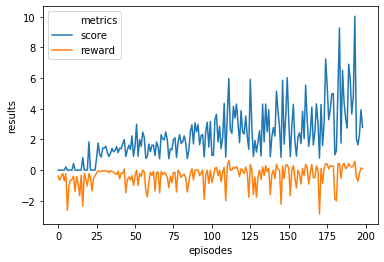

Max Train Score 19 Max Test Score 24
Mean Train Score 2.2379352334883618 Mean Test Score 4.376132578732563
----------------------------------------------------------------------------------------------------
n_eval_episode 3195.5075027451117


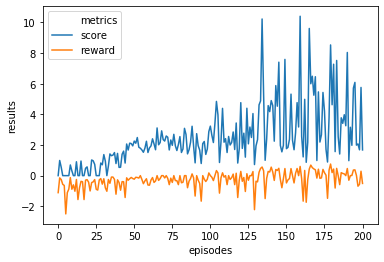

Max Train Score 20 Max Test Score 17
Mean Train Score 2.478074427400732 Mean Test Score 3.2112228855967366
----------------------------------------------------------------------------------------------------
n_eval_episode 3343.4270580829534


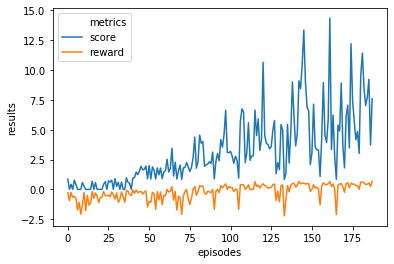

Max Train Score 27 Max Test Score 23
Mean Train Score 3.1855322404121313 Mean Test Score 5.503296718684826
----------------------------------------------------------------------------------------------------
n_eval_episode 3127.068156666829


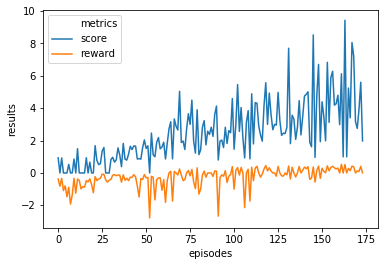

Max Train Score 18 Max Test Score 22
Mean Train Score 2.4705608370556082 Mean Test Score 4.917580481433805
----------------------------------------------------------------------------------------------------


In [109]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #entropy = random.uniform(0, 0.1)
    
    n_eval_episode = random.uniform(1000,4000)
    
    #gamma=0.97 is the best one?
    #leaning_rate=??? see the best result from previous test
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97)#seed=42, gamma=0.97)#, ent_coef=entropy)
    model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)
    
for n_eval_episode, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("n_eval_episode", n_eval_episode)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

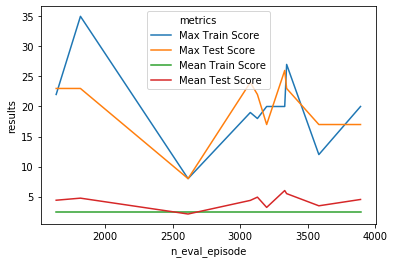

In [110]:
plot_max_results(results,'n_eval_episode')

#### Result: entre 3000 e 3500 è bom, e entre 1000 e 1250

## n_eval_episode ranges (1000,1250),(3000,3500)

In [118]:
results = {}
for i in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #entropy = random.uniform(0, 0.1)
    if i < 5:
        n_eval_episode = random.uniform(1000,1250)
    else:
        n_eval_episode = random.uniform(3000,3500)
    
    #gamma=0.97 is the best one?
    #leaning_rate=??? see the best result from previous test
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97)#seed=42, gamma=0.97)#, ent_coef=entropy)
    model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 65.3     |
|    ep_rew_mean        | -30.1    |
| time/                 |          |
|    fps                | 339      |
|    iterations         | 1000     |
|    time_elapsed       | 14       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0695  |
|    explained_variance | 0.515    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0685   |
|    value_loss         | 27.5     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 77.2     |
|    ep_rew_mean        | 0.1      |
| time/                 |          |
|    fps                | 370      |
|    iterations         | 2000     |
|    time_elapsed       | 26       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 112      |
|    ep_rew_mean        | -21.9    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.521   |
|    explained_variance | 0.935    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.0815  |
|    value_loss         | 0.723    |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 74        |
|    ep_rew_mean        | 1.6       |
| time/                 |           |
|    fps                | 414       |
|    iterations         | 3000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 104      |
|    ep_rew_mean        | -16.2    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0782  |
|    explained_variance | -0.488   |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -8.3e-10 |
|    value_loss         | 1.15e-15 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 134      |
|    ep_rew_mean        | -9.1     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 77.8     |
|    ep_rew_mean        | -8.7     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0215  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | -0.00305 |
|    value_loss         | 1.1      |
------------------------------------


n_eval_episode 1203.1327284748795


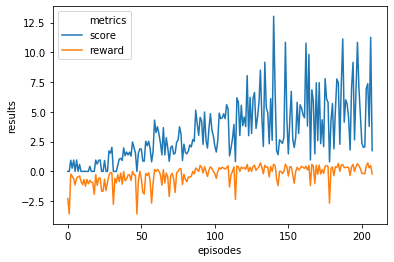

Max Train Score 25 Max Test Score 33
Mean Train Score 3.294925682300151 Mean Test Score 6.162779992456766
----------------------------------------------------------------------------------------------------
n_eval_episode 1233.7473038308488


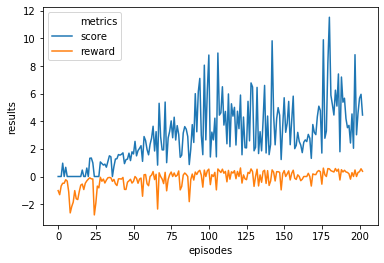

Max Train Score 21 Max Test Score 19
Mean Train Score 3.008742048728395 Mean Test Score 4.500917704704374
----------------------------------------------------------------------------------------------------
n_eval_episode 1197.6791570838268


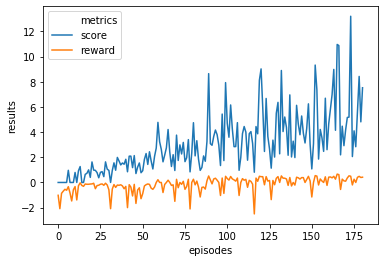

Max Train Score 24 Max Test Score 22
Mean Train Score 3.0480970386978177 Mean Test Score 5.217087790187851
----------------------------------------------------------------------------------------------------
n_eval_episode 1043.625270880599


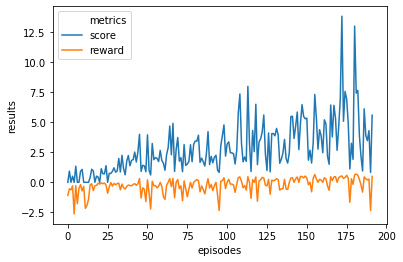

Max Train Score 27 Max Test Score 28
Mean Train Score 2.8101330271386993 Mean Test Score 4.923769738902636
----------------------------------------------------------------------------------------------------
n_eval_episode 1200.3223531027656


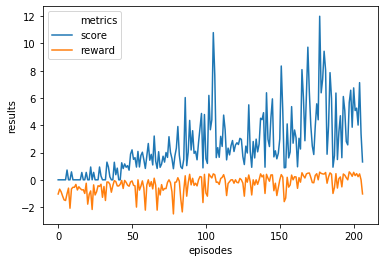

Max Train Score 23 Max Test Score 22
Mean Train Score 2.5708414584886063 Mean Test Score 4.707258649835698
----------------------------------------------------------------------------------------------------
n_eval_episode 3488.615952953791


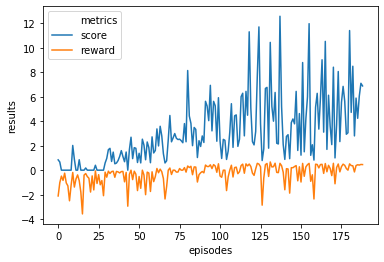

Max Train Score 24 Max Test Score 29
Mean Train Score 3.085143006224579 Mean Test Score 5.962369773307131
----------------------------------------------------------------------------------------------------
n_eval_episode 3452.730941273893


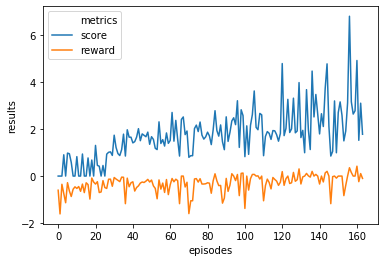

Max Train Score 12 Max Test Score 20
Mean Train Score 1.764636636613316 Mean Test Score 3.5262662623324084
----------------------------------------------------------------------------------------------------
n_eval_episode 3108.9363254735304


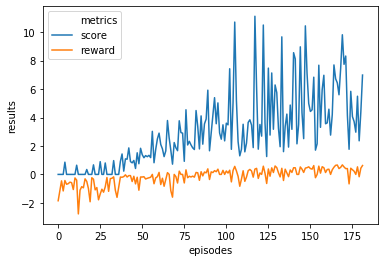

Max Train Score 21 Max Test Score 28
Mean Train Score 2.9767746963975634 Mean Test Score 6.797671326066638
----------------------------------------------------------------------------------------------------
n_eval_episode 3323.8750056461436


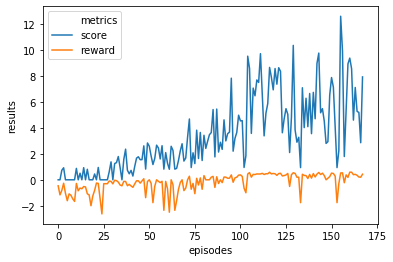

Max Train Score 24 Max Test Score 23
Mean Train Score 3.361990265250689 Mean Test Score 6.668153543366327
----------------------------------------------------------------------------------------------------
n_eval_episode 3199.6813457279045


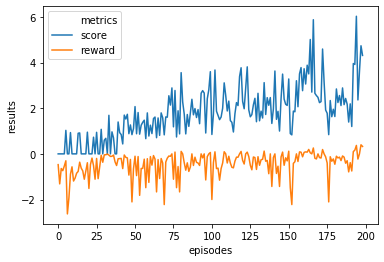

Max Train Score 12 Max Test Score 15
Mean Train Score 1.7851918048149598 Mean Test Score 3.039584063841927
----------------------------------------------------------------------------------------------------


In [119]:
for n_eval_episode, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("n_eval_episode", n_eval_episode)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

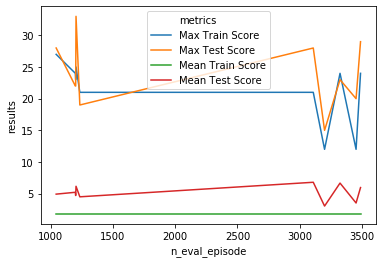

In [120]:
plot_max_results(results,'n_eval_episode')

#### Result: the experimented range continue to be good, the value 1250 seems to be the better one

## n_eval_episode ranges (1000,1250),(3000,3500) 10 times

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 137      |
|    ep_rew_mean        | -41.9    |
| time/                 |          |
|    fps                | 442      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.917   |
|    explained_variance | 0.0746   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.05    |
|    value_loss         | 0.00265  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 98.1     |
|    ep_rew_mean        | -16.4    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

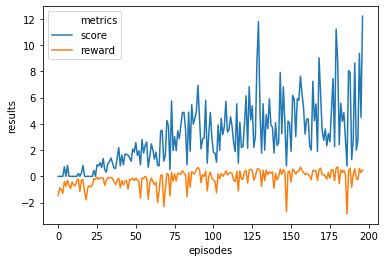

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 72.7     |
|    ep_rew_mean        | -36.3    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.37    |
|    explained_variance | 0.266    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.841    |
|    value_loss         | 1.72     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 79.6      |
|    ep_rew_mean        | -7    

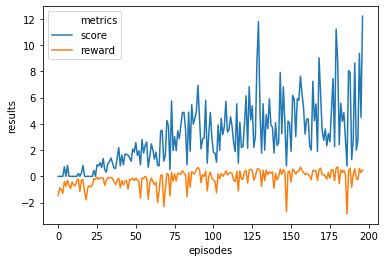

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 1090.4920113624764


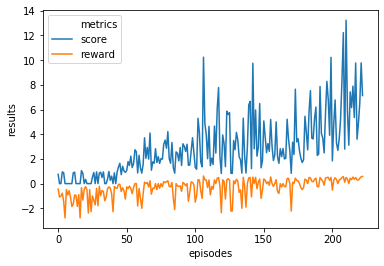

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 135       |
|    ep_rew_mean        | -38.6     |
| time/                 |           |
|    fps                | 432       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.604    |
|    explained_variance | -1.06e+04 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -27.3     |
|    value_loss         | 1.85e+03  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 63.4     |
|    ep_rew_mean   

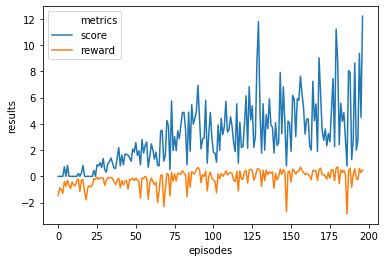

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 1015.7907074876091


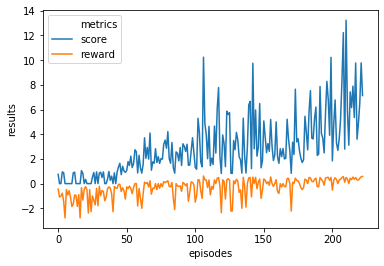

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
n_eval_episode 1015.7907074876091


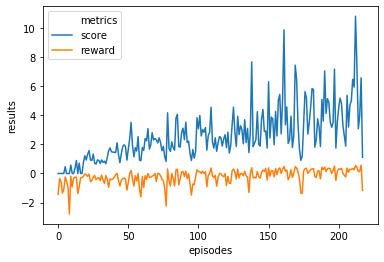

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6078789817733856 Mean Test Score 4.602182038730443
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 142      |
|    ep_rew_mean        | -43.1    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.743   |
|    explained_variance | 0.13     |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00212 |
|    value_loss         | 0.000127 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.6     |
|    ep_rew_mean        | -25.7    

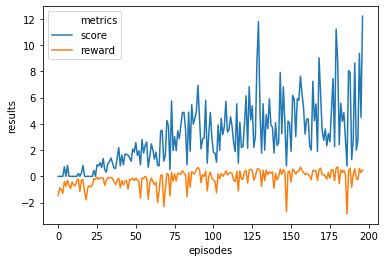

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 1056.7591789207968


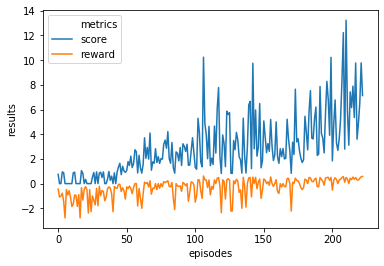

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
n_eval_episode 1056.7591789207968


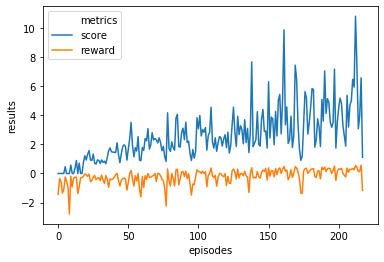

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6078789817733856 Mean Test Score 4.602182038730443
----------------------------------------------------------------------------------------------------
n_eval_episode 1056.7591789207968


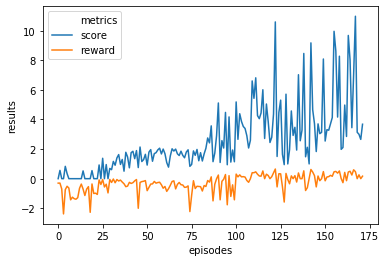

Max Train Score 20 Max Test Score 14
Mean Train Score 2.5429841808500795 Mean Test Score 4.00076510518883
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.5     |
|    ep_rew_mean        | -31.5    |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.37    |
|    explained_variance | -4.11    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0524  |
|    value_loss         | 0.00715  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 62.8     |
|    ep_rew_mean        | -17.3    |

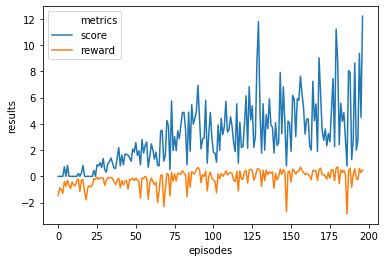

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 1159.3095703653619


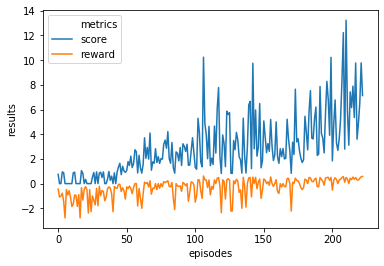

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
n_eval_episode 1159.3095703653619


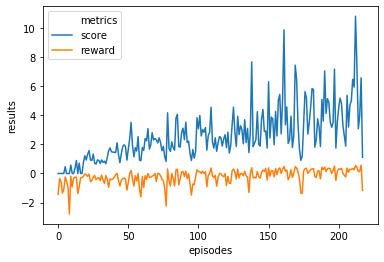

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6078789817733856 Mean Test Score 4.602182038730443
----------------------------------------------------------------------------------------------------
n_eval_episode 1159.3095703653619


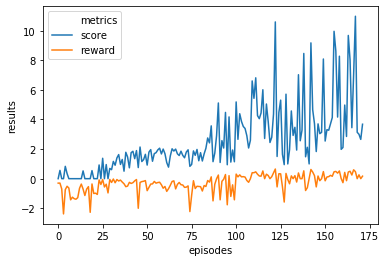

Max Train Score 20 Max Test Score 14
Mean Train Score 2.5429841808500795 Mean Test Score 4.00076510518883
----------------------------------------------------------------------------------------------------
n_eval_episode 1159.3095703653619


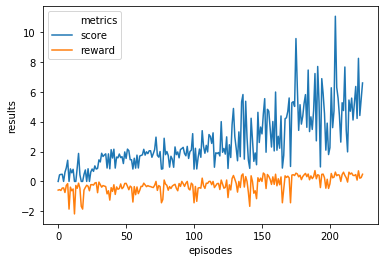

Max Train Score 20 Max Test Score 22
Mean Train Score 2.69040704871148 Mean Test Score 5.481645602742728
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99.7     |
|    ep_rew_mean        | -37.1    |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.574   |
|    explained_variance | 0.395    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.00171  |
|    value_loss         | 0.00282  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 72.9     |
|    ep_rew_mean        | -18.2    |


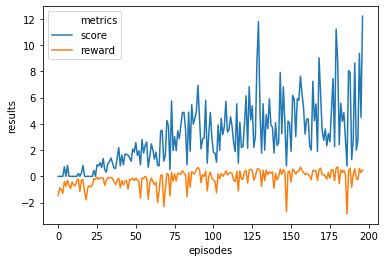

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 3212.4494869337473


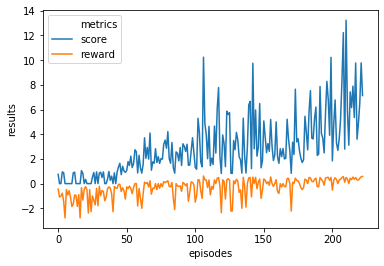

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
n_eval_episode 3212.4494869337473


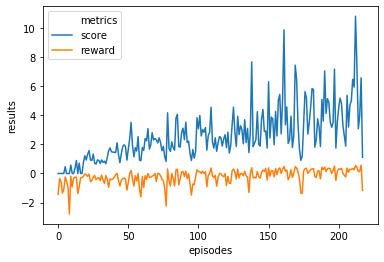

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6078789817733856 Mean Test Score 4.602182038730443
----------------------------------------------------------------------------------------------------
n_eval_episode 3212.4494869337473


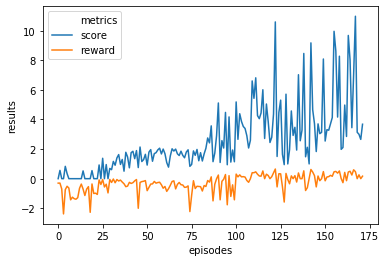

Max Train Score 20 Max Test Score 14
Mean Train Score 2.5429841808500795 Mean Test Score 4.00076510518883
----------------------------------------------------------------------------------------------------
n_eval_episode 3212.4494869337473


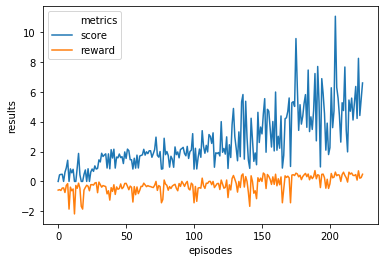

Max Train Score 20 Max Test Score 22
Mean Train Score 2.69040704871148 Mean Test Score 5.481645602742728
----------------------------------------------------------------------------------------------------
n_eval_episode 3212.4494869337473


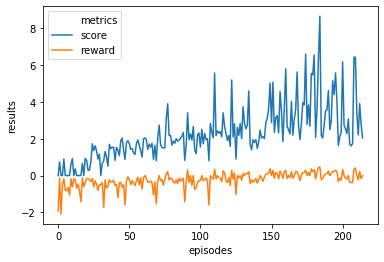

Max Train Score 16 Max Test Score 19
Mean Train Score 2.2681105837937934 Mean Test Score 3.4323082414708224
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.3     |
|    ep_rew_mean        | -27.6    |
| time/                 |          |
|    fps                | 407      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0558  |
|    explained_variance | 0.00844  |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00566 |
|    value_loss         | 0.399    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 63       |
|    ep_rew_mean        | -11.8   

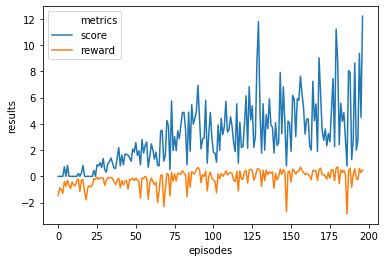

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 3374.2396349337414


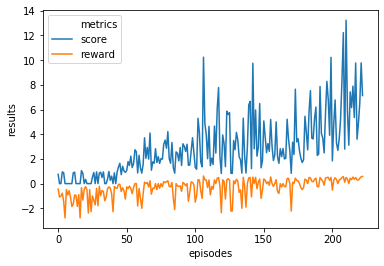

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
n_eval_episode 3374.2396349337414


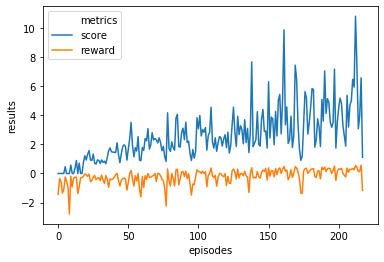

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6078789817733856 Mean Test Score 4.602182038730443
----------------------------------------------------------------------------------------------------
n_eval_episode 3374.2396349337414


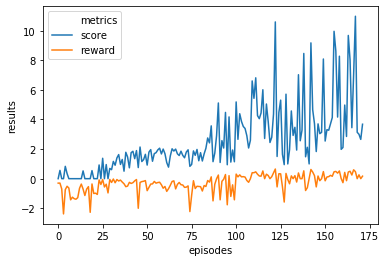

Max Train Score 20 Max Test Score 14
Mean Train Score 2.5429841808500795 Mean Test Score 4.00076510518883
----------------------------------------------------------------------------------------------------
n_eval_episode 3374.2396349337414


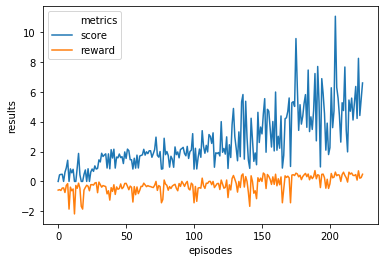

Max Train Score 20 Max Test Score 22
Mean Train Score 2.69040704871148 Mean Test Score 5.481645602742728
----------------------------------------------------------------------------------------------------
n_eval_episode 3374.2396349337414


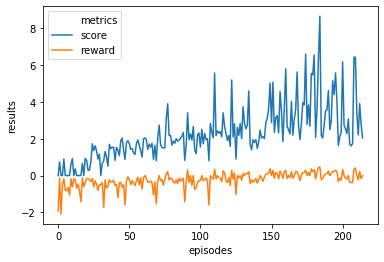

Max Train Score 16 Max Test Score 19
Mean Train Score 2.2681105837937934 Mean Test Score 3.4323082414708224
----------------------------------------------------------------------------------------------------
n_eval_episode 3374.2396349337414


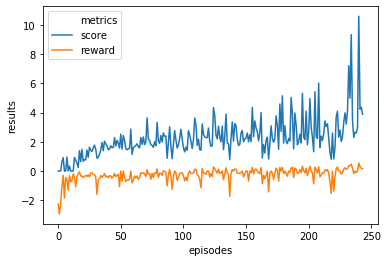

Max Train Score 21 Max Test Score 13
Mean Train Score 2.2604950406078475 Mean Test Score 2.601408172546037
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 105      |
|    ep_rew_mean        | -37.2    |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.694   |
|    explained_variance | -1.48    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0731  |
|    value_loss         | 0.0135   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.4     |
|    ep_rew_mean        | -14.7    

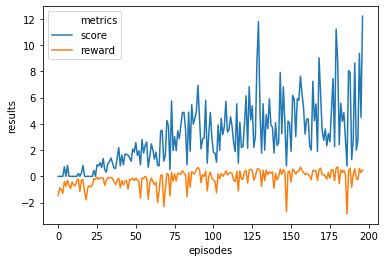

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 3019.7641905096293


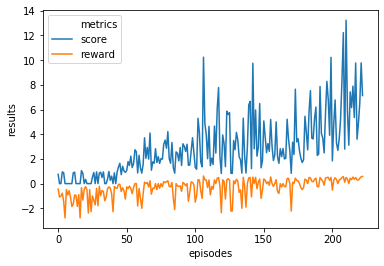

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
n_eval_episode 3019.7641905096293


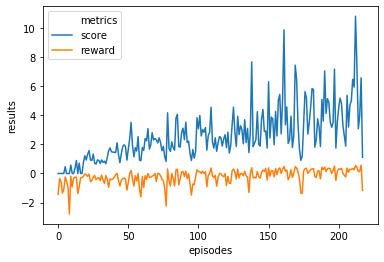

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6078789817733856 Mean Test Score 4.602182038730443
----------------------------------------------------------------------------------------------------
n_eval_episode 3019.7641905096293


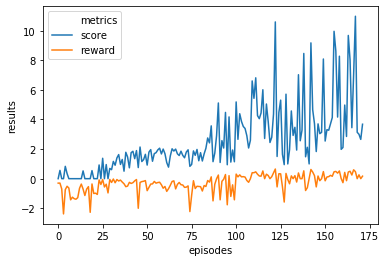

Max Train Score 20 Max Test Score 14
Mean Train Score 2.5429841808500795 Mean Test Score 4.00076510518883
----------------------------------------------------------------------------------------------------
n_eval_episode 3019.7641905096293


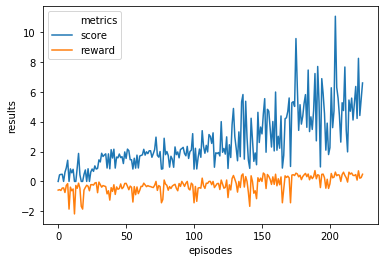

Max Train Score 20 Max Test Score 22
Mean Train Score 2.69040704871148 Mean Test Score 5.481645602742728
----------------------------------------------------------------------------------------------------
n_eval_episode 3019.7641905096293


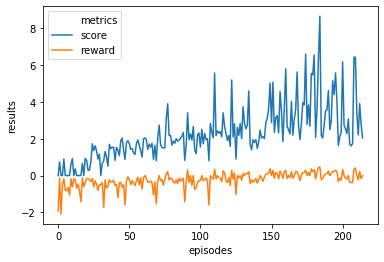

Max Train Score 16 Max Test Score 19
Mean Train Score 2.2681105837937934 Mean Test Score 3.4323082414708224
----------------------------------------------------------------------------------------------------
n_eval_episode 3019.7641905096293


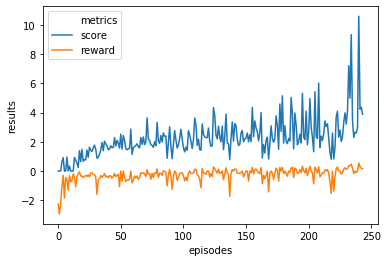

Max Train Score 21 Max Test Score 13
Mean Train Score 2.2604950406078475 Mean Test Score 2.601408172546037
----------------------------------------------------------------------------------------------------
n_eval_episode 3019.7641905096293


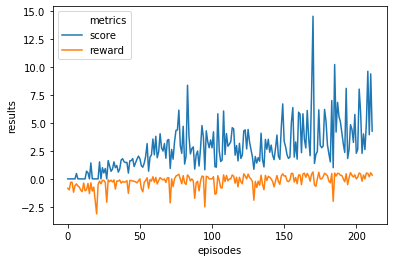

Max Train Score 27 Max Test Score 17
Mean Train Score 2.781035048215727 Mean Test Score 3.753336642155419
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82       |
|    ep_rew_mean        | -34.5    |
| time/                 |          |
|    fps                | 400      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.777   |
|    explained_variance | -13.6    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.138   |
|    value_loss         | 0.0115   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 71.7     |
|    ep_rew_mean        | -13.4    |

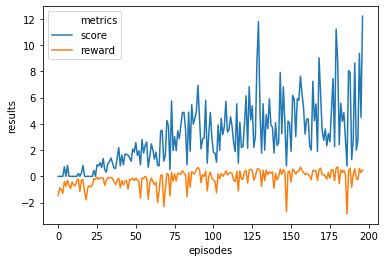

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 3239.9665611808023


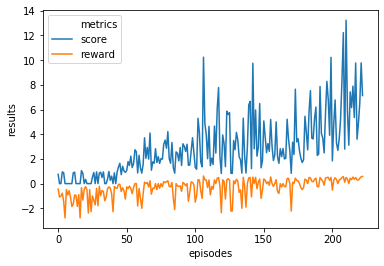

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
n_eval_episode 3239.9665611808023


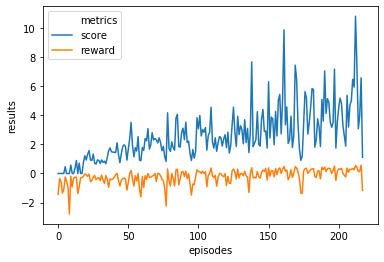

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6078789817733856 Mean Test Score 4.602182038730443
----------------------------------------------------------------------------------------------------
n_eval_episode 3239.9665611808023


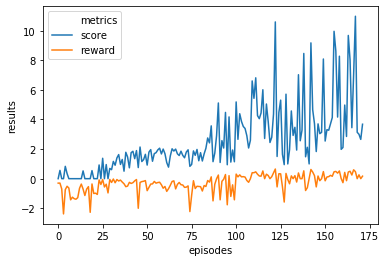

Max Train Score 20 Max Test Score 14
Mean Train Score 2.5429841808500795 Mean Test Score 4.00076510518883
----------------------------------------------------------------------------------------------------
n_eval_episode 3239.9665611808023


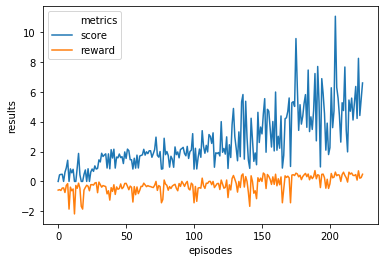

Max Train Score 20 Max Test Score 22
Mean Train Score 2.69040704871148 Mean Test Score 5.481645602742728
----------------------------------------------------------------------------------------------------
n_eval_episode 3239.9665611808023


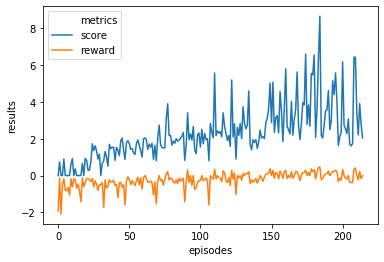

Max Train Score 16 Max Test Score 19
Mean Train Score 2.2681105837937934 Mean Test Score 3.4323082414708224
----------------------------------------------------------------------------------------------------
n_eval_episode 3239.9665611808023


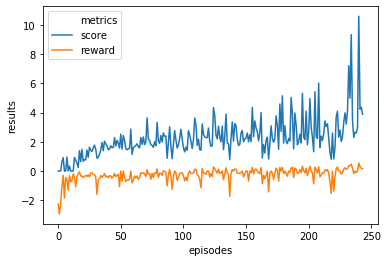

Max Train Score 21 Max Test Score 13
Mean Train Score 2.2604950406078475 Mean Test Score 2.601408172546037
----------------------------------------------------------------------------------------------------
n_eval_episode 3239.9665611808023


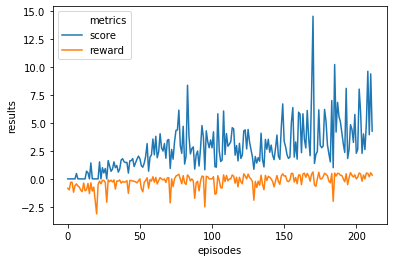

Max Train Score 27 Max Test Score 17
Mean Train Score 2.781035048215727 Mean Test Score 3.753336642155419
----------------------------------------------------------------------------------------------------
n_eval_episode 3239.9665611808023


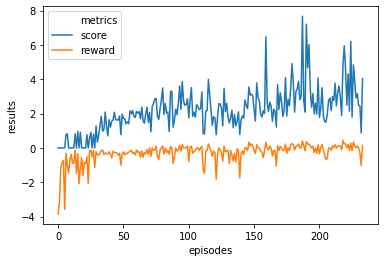

Max Train Score 15 Max Test Score 18
Mean Train Score 2.1721497610510756 Mean Test Score 3.722924062607002
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 104      |
|    ep_rew_mean        | -34.6    |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.668   |
|    explained_variance | -0.295   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.111   |
|    value_loss         | 0.059    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88       |
|    ep_rew_mean        | -15.2    

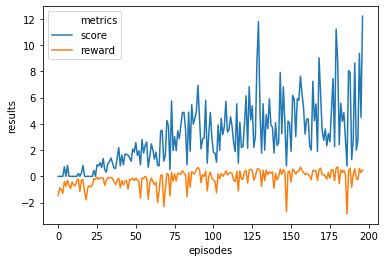

Max Train Score 24 Max Test Score 20
Mean Train Score 3.0717045595725847 Mean Test Score 4.498985135978588
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


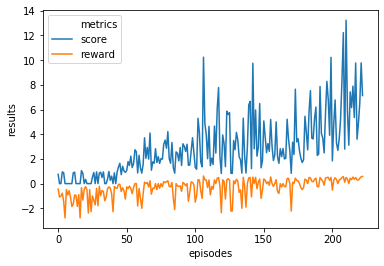

Max Train Score 26 Max Test Score 23
Mean Train Score 2.895809086625324 Mean Test Score 6.171751990144841
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


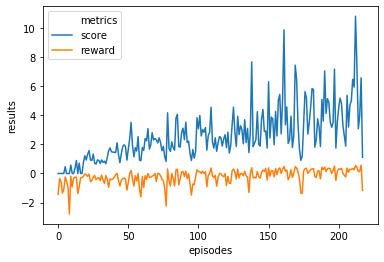

Max Train Score 20 Max Test Score 26
Mean Train Score 2.6078789817733856 Mean Test Score 4.602182038730443
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


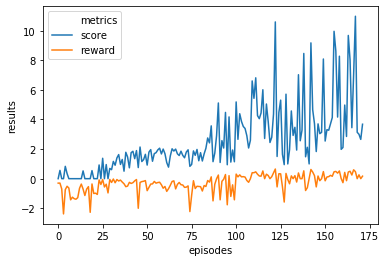

Max Train Score 20 Max Test Score 14
Mean Train Score 2.5429841808500795 Mean Test Score 4.00076510518883
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


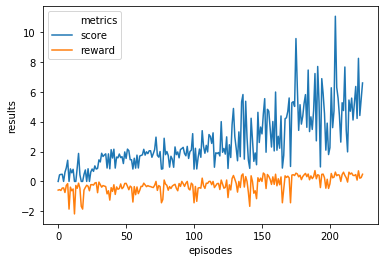

Max Train Score 20 Max Test Score 22
Mean Train Score 2.69040704871148 Mean Test Score 5.481645602742728
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


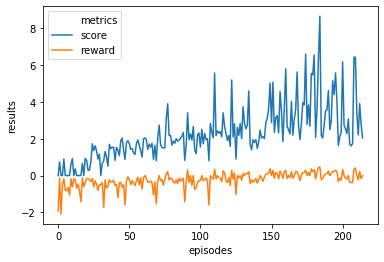

Max Train Score 16 Max Test Score 19
Mean Train Score 2.2681105837937934 Mean Test Score 3.4323082414708224
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


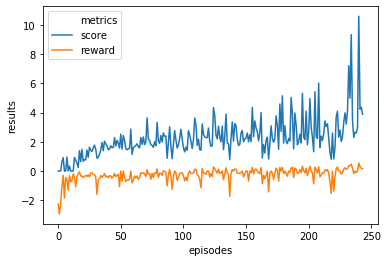

Max Train Score 21 Max Test Score 13
Mean Train Score 2.2604950406078475 Mean Test Score 2.601408172546037
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


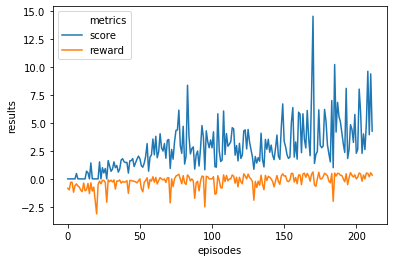

Max Train Score 27 Max Test Score 17
Mean Train Score 2.781035048215727 Mean Test Score 3.753336642155419
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


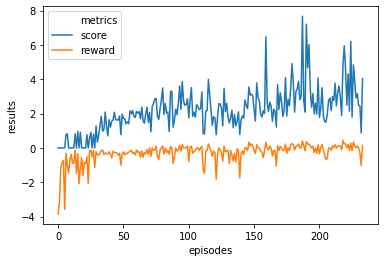

Max Train Score 15 Max Test Score 18
Mean Train Score 2.1721497610510756 Mean Test Score 3.722924062607002
----------------------------------------------------------------------------------------------------
n_eval_episode 3150.5241781426494


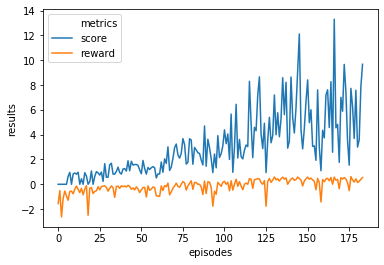

Max Train Score 26 Max Test Score 29
Mean Train Score 3.09329864999431 Mean Test Score 6.266737498294169
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


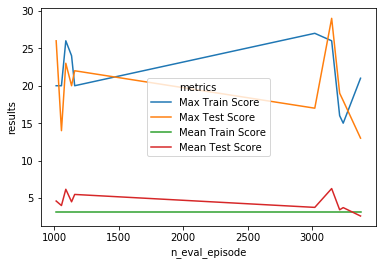

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89       |
|    ep_rew_mean        | -28.9    |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.454   |
|    explained_variance | -249     |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0197   |
|    value_loss         | 17.3     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.6     |
|    ep_rew_mean        | -12.1    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 2000 

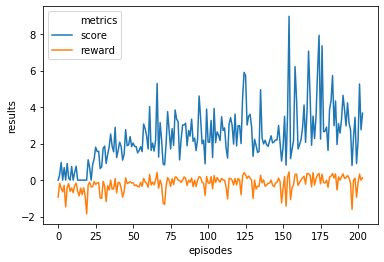

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.1     |
|    ep_rew_mean        | -34.3    |
| time/                 |          |
|    fps                | 351      |
|    iterations         | 1000     |
|    time_elapsed       | 14       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.972   |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.341   |
|    value_loss         | 0.111    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 71.5     |
|    ep_rew_mean        | -18.7    

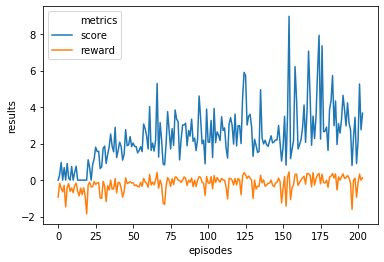

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 1020.3166661822069


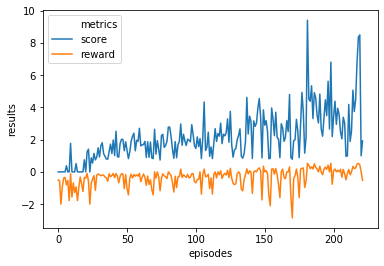

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.6     |
|    ep_rew_mean        | -36.5    |
| time/                 |          |
|    fps                | 363      |
|    iterations         | 1000     |
|    time_elapsed       | 13       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.696   |
|    explained_variance | -171     |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 1.79     |
|    value_loss         | 53.2     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.6     |
|    ep_rew_mean        | -8.1     

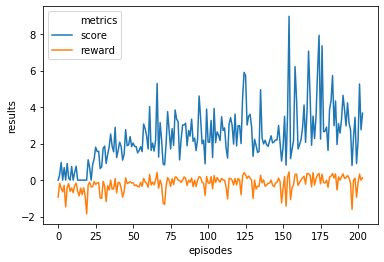

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 1043.7942675073868


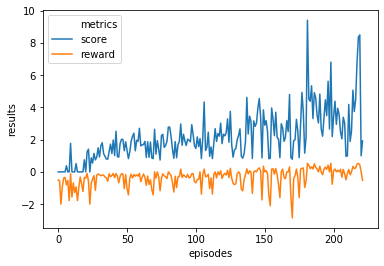

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
n_eval_episode 1043.7942675073868


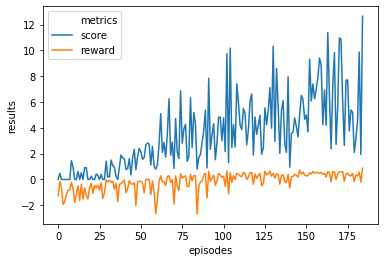

Max Train Score 27 Max Test Score 29
Mean Train Score 3.47561169434561 Mean Test Score 7.1398486625948525
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 130      |
|    ep_rew_mean        | -41.9    |
| time/                 |          |
|    fps                | 316      |
|    iterations         | 1000     |
|    time_elapsed       | 15       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.495   |
|    explained_variance | 0.0585   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0489  |
|    value_loss         | 0.00287  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 93       |
|    ep_rew_mean        | -20.6    |

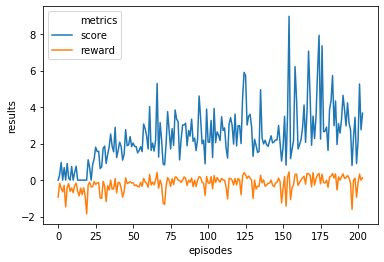

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 1199.3933220258361


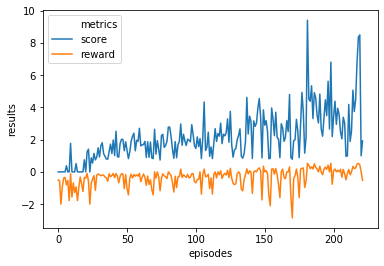

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
n_eval_episode 1199.3933220258361


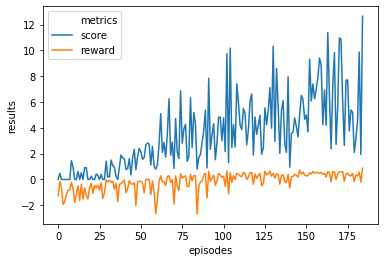

Max Train Score 27 Max Test Score 29
Mean Train Score 3.47561169434561 Mean Test Score 7.1398486625948525
----------------------------------------------------------------------------------------------------
n_eval_episode 1199.3933220258361


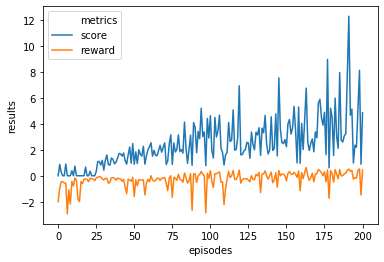

Max Train Score 22 Max Test Score 19
Mean Train Score 2.4479304989050963 Mean Test Score 5.250664032279036
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 214      |
|    ep_rew_mean        | -43.5    |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.38    |
|    explained_variance | -0.183   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00959 |
|    value_loss         | 0.00035  |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 311       |
|    ep_rew_mean        | -40.7 

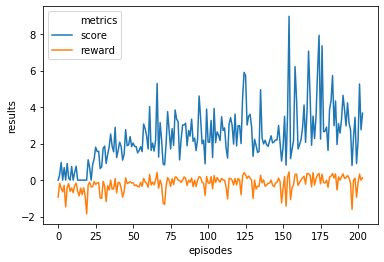

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 1155.682330716459


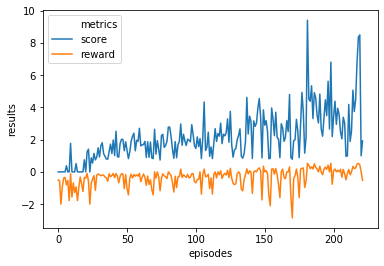

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
n_eval_episode 1155.682330716459


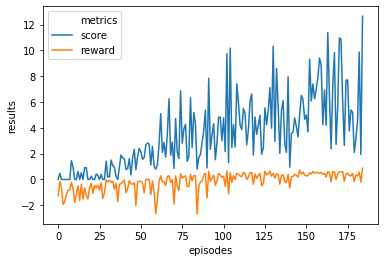

Max Train Score 27 Max Test Score 29
Mean Train Score 3.47561169434561 Mean Test Score 7.1398486625948525
----------------------------------------------------------------------------------------------------
n_eval_episode 1155.682330716459


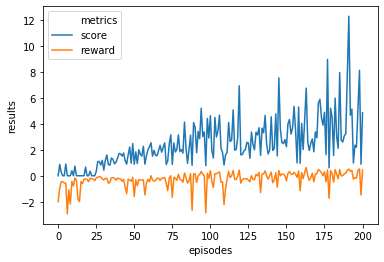

Max Train Score 22 Max Test Score 19
Mean Train Score 2.4479304989050963 Mean Test Score 5.250664032279036
----------------------------------------------------------------------------------------------------
n_eval_episode 1155.682330716459


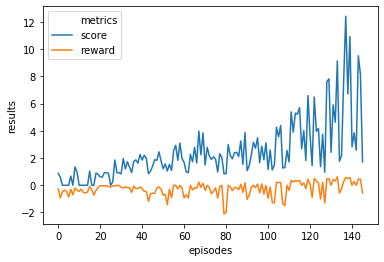

Max Train Score 21 Max Test Score 27
Mean Train Score 2.4273608860205504 Mean Test Score 4.326349789946714
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 174      |
|    ep_rew_mean        | -45      |
| time/                 |          |
|    fps                | 266      |
|    iterations         | 1000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.101   |
|    explained_variance | -2.89    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.000144 |
|    value_loss         | 6.45e-05 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 149      |
|    ep_rew_mean        | -33.7    

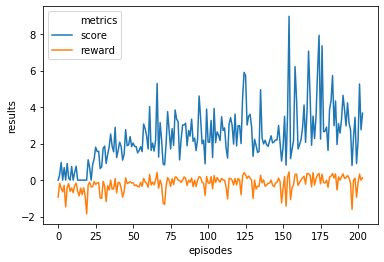

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 3284.1569306356837


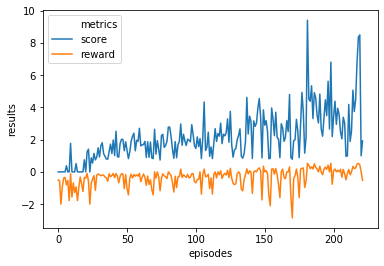

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
n_eval_episode 3284.1569306356837


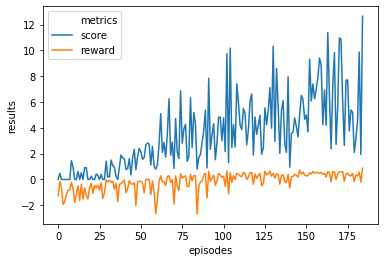

Max Train Score 27 Max Test Score 29
Mean Train Score 3.47561169434561 Mean Test Score 7.1398486625948525
----------------------------------------------------------------------------------------------------
n_eval_episode 3284.1569306356837


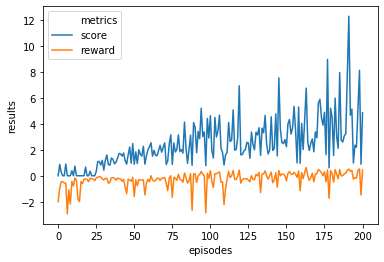

Max Train Score 22 Max Test Score 19
Mean Train Score 2.4479304989050963 Mean Test Score 5.250664032279036
----------------------------------------------------------------------------------------------------
n_eval_episode 3284.1569306356837


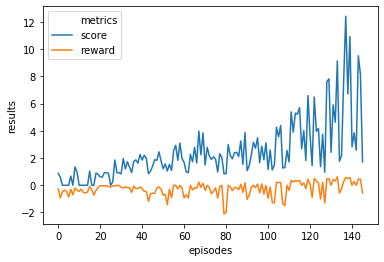

Max Train Score 21 Max Test Score 27
Mean Train Score 2.4273608860205504 Mean Test Score 4.326349789946714
----------------------------------------------------------------------------------------------------
n_eval_episode 3284.1569306356837


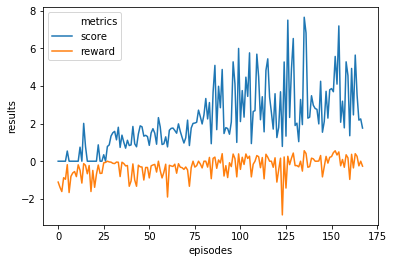

Max Train Score 15 Max Test Score 17
Mean Train Score 2.2006891788018015 Mean Test Score 3.759234260204318
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.2     |
|    ep_rew_mean        | -35.4    |
| time/                 |          |
|    fps                | 350      |
|    iterations         | 1000     |
|    time_elapsed       | 14       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.083   |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00522 |
|    value_loss         | 0.166    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.5     |
|    ep_rew_mean        | -8.2     

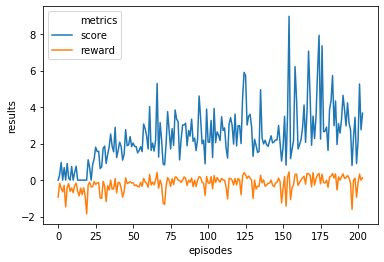

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.882186083909


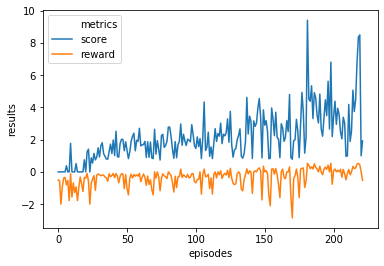

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.882186083909


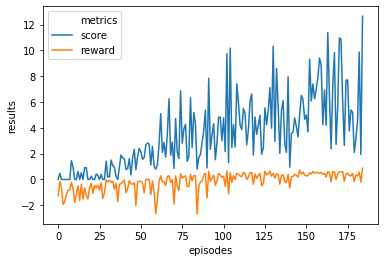

Max Train Score 27 Max Test Score 29
Mean Train Score 3.47561169434561 Mean Test Score 7.1398486625948525
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.882186083909


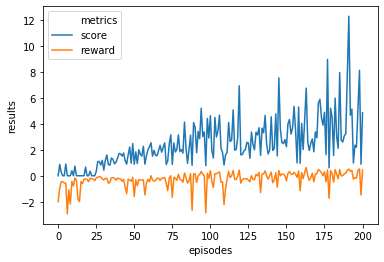

Max Train Score 22 Max Test Score 19
Mean Train Score 2.4479304989050963 Mean Test Score 5.250664032279036
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.882186083909


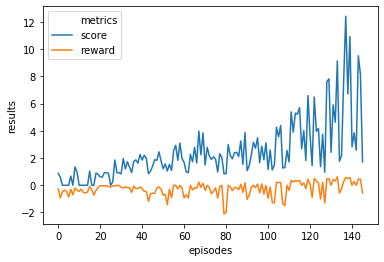

Max Train Score 21 Max Test Score 27
Mean Train Score 2.4273608860205504 Mean Test Score 4.326349789946714
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.882186083909


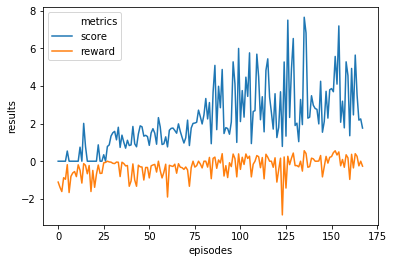

Max Train Score 15 Max Test Score 17
Mean Train Score 2.2006891788018015 Mean Test Score 3.759234260204318
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.882186083909


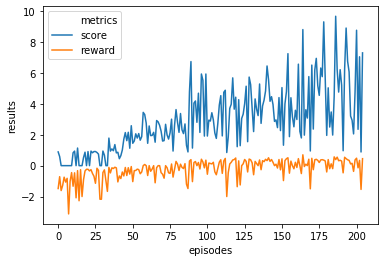

Max Train Score 19 Max Test Score 33
Mean Train Score 2.92864108298673 Mean Test Score 4.981527220794604
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.4     |
|    ep_rew_mean        | -31.9    |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.565   |
|    explained_variance | -3.61    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.033   |
|    value_loss         | 0.00155  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 69.4     |
|    ep_rew_mean        | -2.5     |


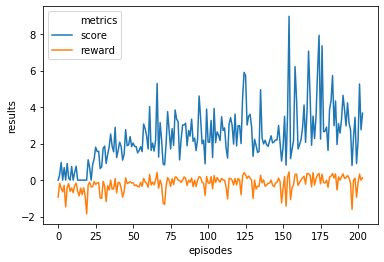

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 3151.9341014624997


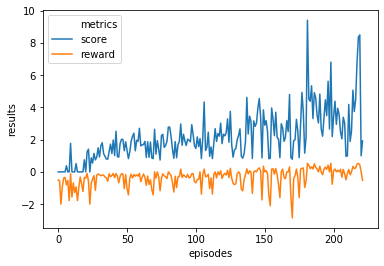

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
n_eval_episode 3151.9341014624997


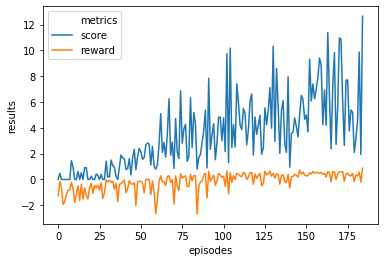

Max Train Score 27 Max Test Score 29
Mean Train Score 3.47561169434561 Mean Test Score 7.1398486625948525
----------------------------------------------------------------------------------------------------
n_eval_episode 3151.9341014624997


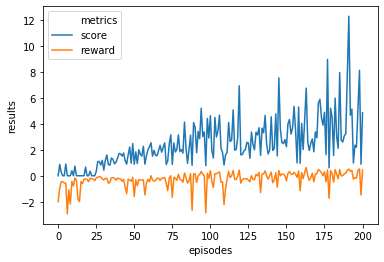

Max Train Score 22 Max Test Score 19
Mean Train Score 2.4479304989050963 Mean Test Score 5.250664032279036
----------------------------------------------------------------------------------------------------
n_eval_episode 3151.9341014624997


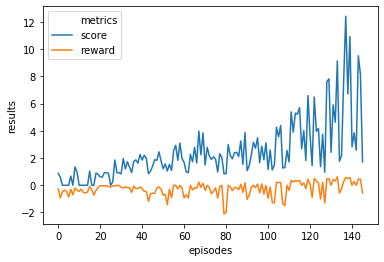

Max Train Score 21 Max Test Score 27
Mean Train Score 2.4273608860205504 Mean Test Score 4.326349789946714
----------------------------------------------------------------------------------------------------
n_eval_episode 3151.9341014624997


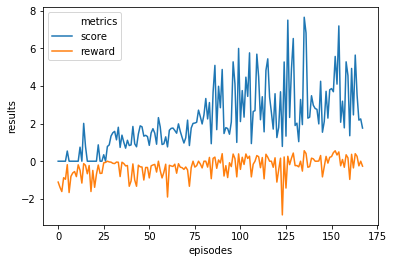

Max Train Score 15 Max Test Score 17
Mean Train Score 2.2006891788018015 Mean Test Score 3.759234260204318
----------------------------------------------------------------------------------------------------
n_eval_episode 3151.9341014624997


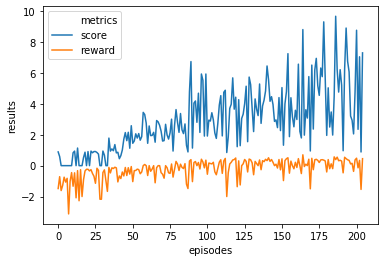

Max Train Score 19 Max Test Score 33
Mean Train Score 2.92864108298673 Mean Test Score 4.981527220794604
----------------------------------------------------------------------------------------------------
n_eval_episode 3151.9341014624997


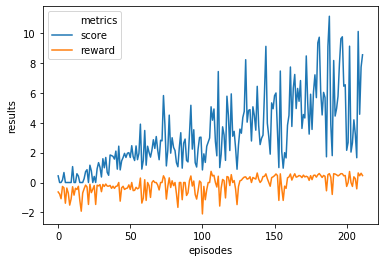

Max Train Score 20 Max Test Score 26
Mean Train Score 3.227325068875285 Mean Test Score 6.089697357321678
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 116       |
|    ep_rew_mean        | -47.3     |
| time/                 |           |
|    fps                | 421       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.277    |
|    explained_variance | -0.0862   |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -3.88e-10 |
|    value_loss         | 8.84e-17  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 135      |
|    ep_rew_mean   

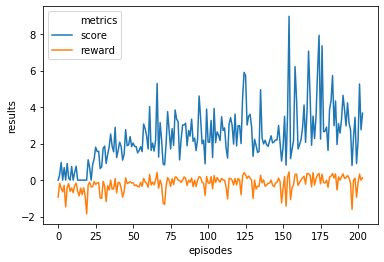

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 3070.742232718645


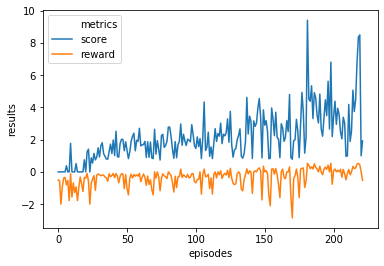

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
n_eval_episode 3070.742232718645


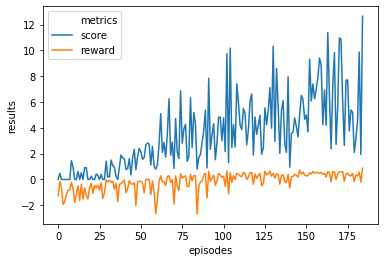

Max Train Score 27 Max Test Score 29
Mean Train Score 3.47561169434561 Mean Test Score 7.1398486625948525
----------------------------------------------------------------------------------------------------
n_eval_episode 3070.742232718645


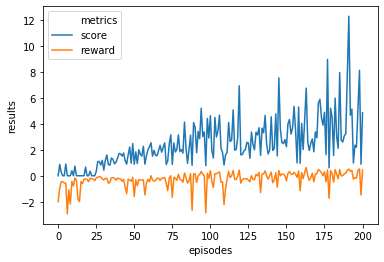

Max Train Score 22 Max Test Score 19
Mean Train Score 2.4479304989050963 Mean Test Score 5.250664032279036
----------------------------------------------------------------------------------------------------
n_eval_episode 3070.742232718645


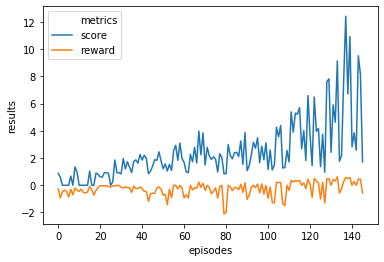

Max Train Score 21 Max Test Score 27
Mean Train Score 2.4273608860205504 Mean Test Score 4.326349789946714
----------------------------------------------------------------------------------------------------
n_eval_episode 3070.742232718645


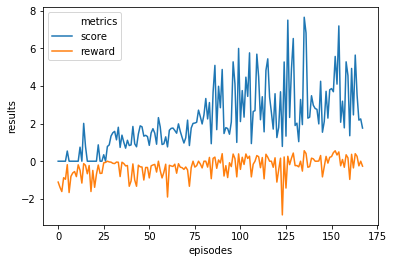

Max Train Score 15 Max Test Score 17
Mean Train Score 2.2006891788018015 Mean Test Score 3.759234260204318
----------------------------------------------------------------------------------------------------
n_eval_episode 3070.742232718645


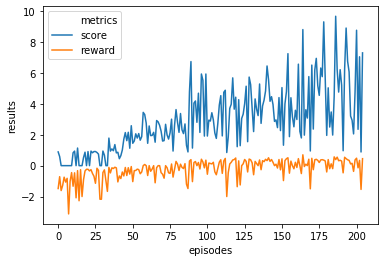

Max Train Score 19 Max Test Score 33
Mean Train Score 2.92864108298673 Mean Test Score 4.981527220794604
----------------------------------------------------------------------------------------------------
n_eval_episode 3070.742232718645


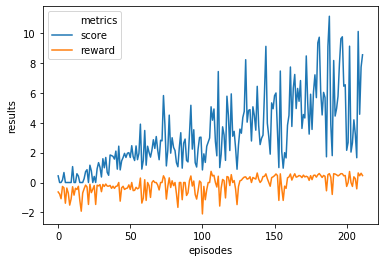

Max Train Score 20 Max Test Score 26
Mean Train Score 3.227325068875285 Mean Test Score 6.089697357321678
----------------------------------------------------------------------------------------------------
n_eval_episode 3070.742232718645


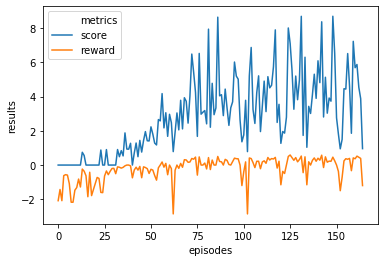

Max Train Score 18 Max Test Score 24
Mean Train Score 2.830130324301946 Mean Test Score 5.493834614539579
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.9     |
|    ep_rew_mean        | -26.1    |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.303   |
|    explained_variance | -0.0547  |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.257   |
|    value_loss         | 0.0282   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 66.7     |
|    ep_rew_mean        | -12.7    |

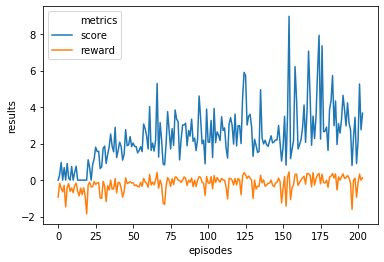

Max Train Score 17 Max Test Score 18
Mean Train Score 2.391958689778887 Mean Test Score 3.5483014347715893
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


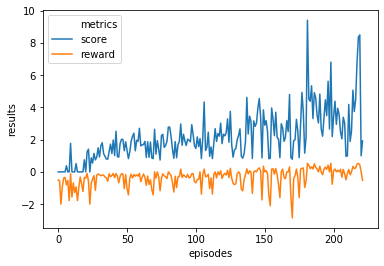

Max Train Score 19 Max Test Score 9
Mean Train Score 2.1533516213862263 Mean Test Score 2.2439950065868577
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


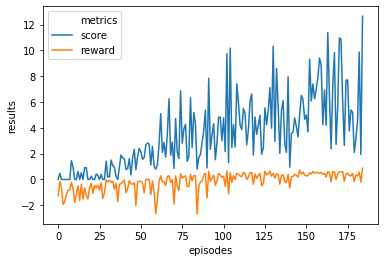

Max Train Score 27 Max Test Score 29
Mean Train Score 3.47561169434561 Mean Test Score 7.1398486625948525
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


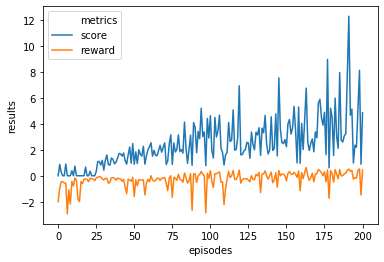

Max Train Score 22 Max Test Score 19
Mean Train Score 2.4479304989050963 Mean Test Score 5.250664032279036
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


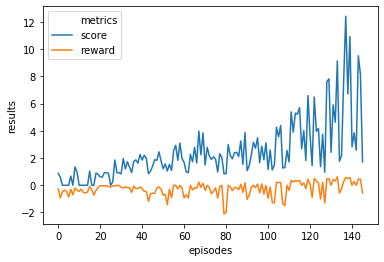

Max Train Score 21 Max Test Score 27
Mean Train Score 2.4273608860205504 Mean Test Score 4.326349789946714
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


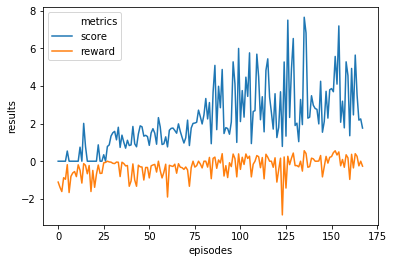

Max Train Score 15 Max Test Score 17
Mean Train Score 2.2006891788018015 Mean Test Score 3.759234260204318
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


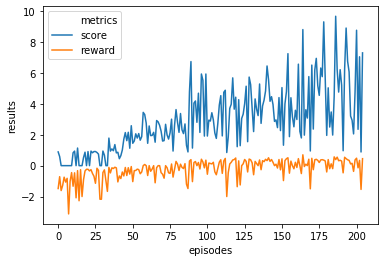

Max Train Score 19 Max Test Score 33
Mean Train Score 2.92864108298673 Mean Test Score 4.981527220794604
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


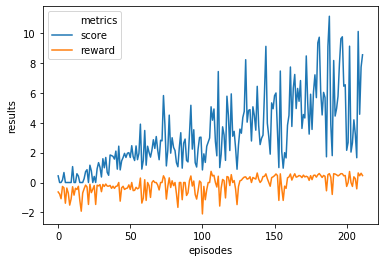

Max Train Score 20 Max Test Score 26
Mean Train Score 3.227325068875285 Mean Test Score 6.089697357321678
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


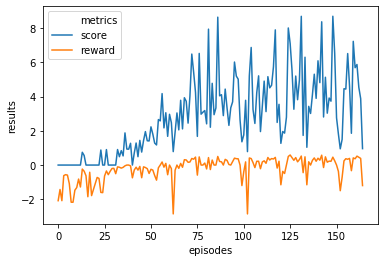

Max Train Score 18 Max Test Score 24
Mean Train Score 2.830130324301946 Mean Test Score 5.493834614539579
----------------------------------------------------------------------------------------------------
n_eval_episode 3166.023011660166


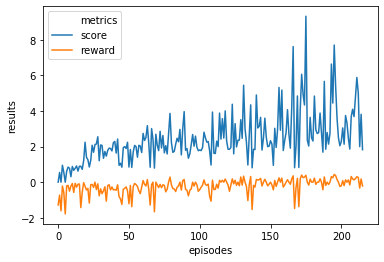

Max Train Score 18 Max Test Score 15
Mean Train Score 2.4454339083376224 Mean Test Score 3.562969181708413
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


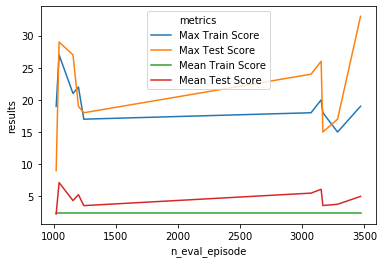

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 148      |
|    ep_rew_mean        | -34.4    |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.207   |
|    explained_variance | -2.37    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00115 |
|    value_loss         | 0.000292 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.5     |
|    ep_rew_mean        | -19      |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 2000 

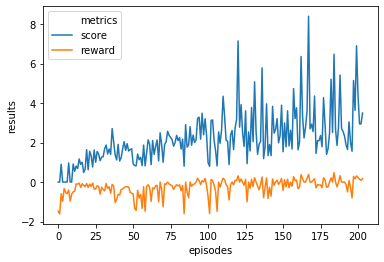

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.4     |
|    ep_rew_mean        | -33.3    |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.775   |
|    explained_variance | -1.41    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.153    |
|    value_loss         | 0.0703   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.8     |
|    ep_rew_mean        | -10      

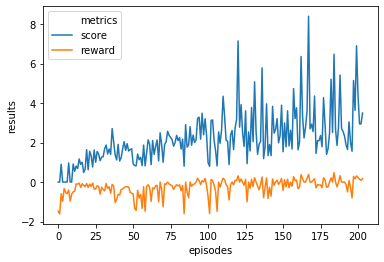

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 1134.5849788006815


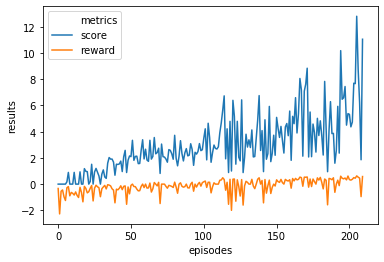

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 116      |
|    ep_rew_mean        | -35.6    |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.777   |
|    explained_variance | -572     |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -20.6    |
|    value_loss         | 2.25e+03 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 78        |
|    ep_rew_mean        | -18.8  

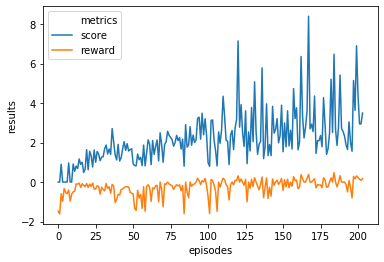

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 1234.1020551841796


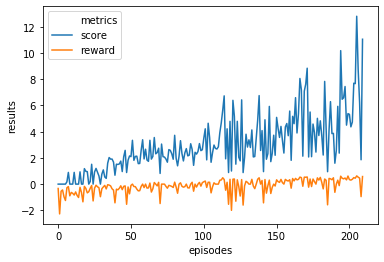

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
n_eval_episode 1234.1020551841796


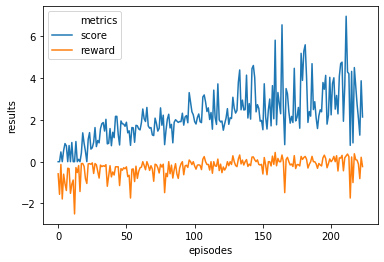

Max Train Score 12 Max Test Score 16
Mean Train Score 2.1923329175057846 Mean Test Score 3.0926366952789217
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 75.2     |
|    ep_rew_mean        | -30.9    |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.715   |
|    explained_variance | 0.0333   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -2.38    |
|    value_loss         | 4.42     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85       |
|    ep_rew_mean        | -10.4   

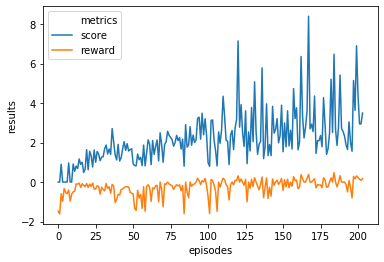

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 1155.9589613125538


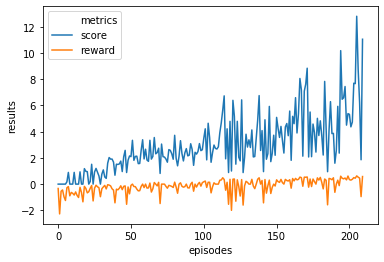

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
n_eval_episode 1155.9589613125538


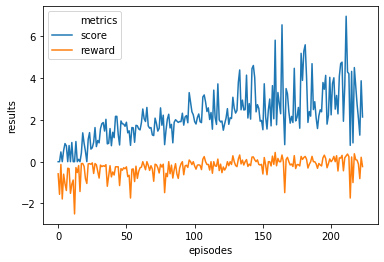

Max Train Score 12 Max Test Score 16
Mean Train Score 2.1923329175057846 Mean Test Score 3.0926366952789217
----------------------------------------------------------------------------------------------------
n_eval_episode 1155.9589613125538


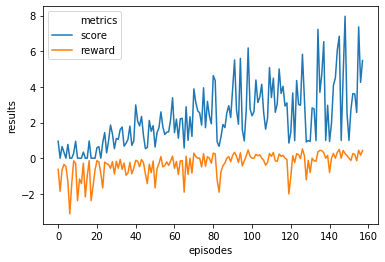

Max Train Score 15 Max Test Score 14
Mean Train Score 2.2719190596728978 Mean Test Score 3.595873841436688
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.3     |
|    ep_rew_mean        | -34.4    |
| time/                 |          |
|    fps                | 435      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.451   |
|    explained_variance | -14.1    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 1.27     |
|    value_loss         | 84.1     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.9     |
|    ep_rew_mean        | -6.4     

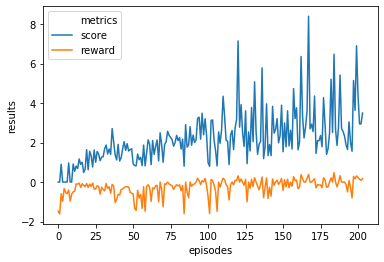

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 1131.3270845917052


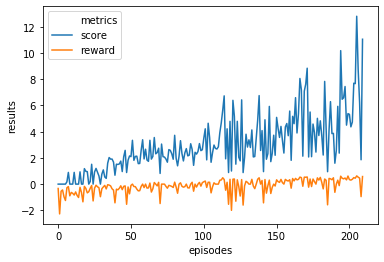

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
n_eval_episode 1131.3270845917052


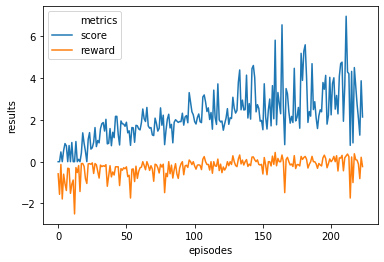

Max Train Score 12 Max Test Score 16
Mean Train Score 2.1923329175057846 Mean Test Score 3.0926366952789217
----------------------------------------------------------------------------------------------------
n_eval_episode 1131.3270845917052


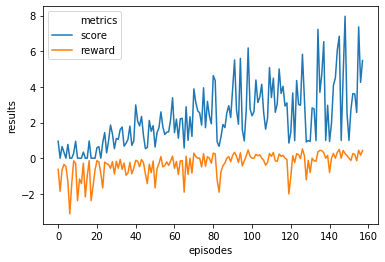

Max Train Score 15 Max Test Score 14
Mean Train Score 2.2719190596728978 Mean Test Score 3.595873841436688
----------------------------------------------------------------------------------------------------
n_eval_episode 1131.3270845917052


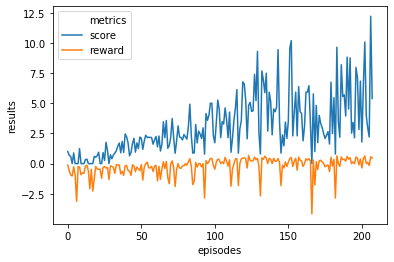

Max Train Score 22 Max Test Score 25
Mean Train Score 3.0583156219728065 Mean Test Score 5.233204478522265
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70       |
|    ep_rew_mean        | -28.9    |
| time/                 |          |
|    fps                | 404      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.243   |
|    explained_variance | 0.848    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.00107  |
|    value_loss         | 3.95     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 66.6      |
|    ep_rew_mean        | -10.5 

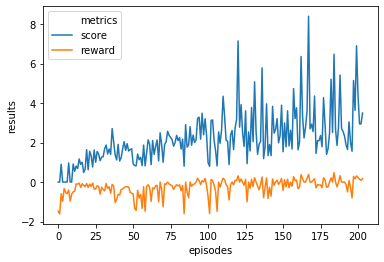

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 3225.4648202121543


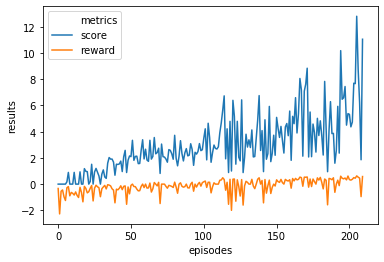

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
n_eval_episode 3225.4648202121543


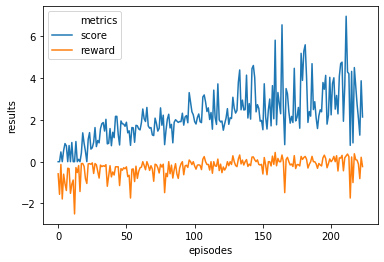

Max Train Score 12 Max Test Score 16
Mean Train Score 2.1923329175057846 Mean Test Score 3.0926366952789217
----------------------------------------------------------------------------------------------------
n_eval_episode 3225.4648202121543


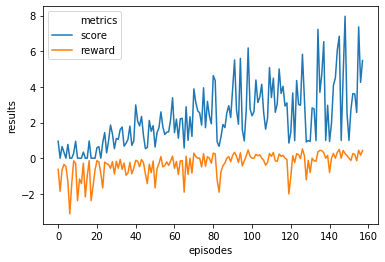

Max Train Score 15 Max Test Score 14
Mean Train Score 2.2719190596728978 Mean Test Score 3.595873841436688
----------------------------------------------------------------------------------------------------
n_eval_episode 3225.4648202121543


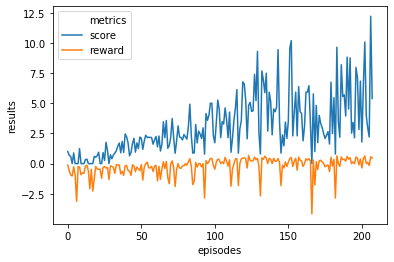

Max Train Score 22 Max Test Score 25
Mean Train Score 3.0583156219728065 Mean Test Score 5.233204478522265
----------------------------------------------------------------------------------------------------
n_eval_episode 3225.4648202121543


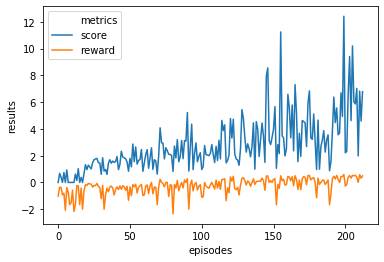

Max Train Score 24 Max Test Score 28
Mean Train Score 2.7473482266848777 Mean Test Score 5.687094107994078
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 78.1      |
|    ep_rew_mean        | -34.3     |
| time/                 |           |
|    fps                | 370       |
|    iterations         | 1000      |
|    time_elapsed       | 13        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.219    |
|    explained_variance | -1.05e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | 0.0795    |
|    value_loss         | 35.5      |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.8     |
|    ep_rew_mean  

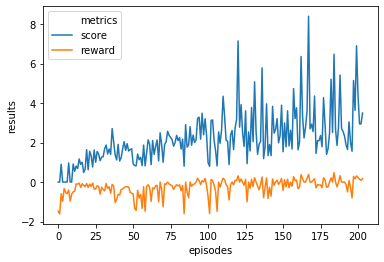

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 3321.8970875797795


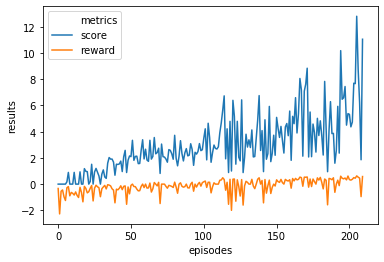

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
n_eval_episode 3321.8970875797795


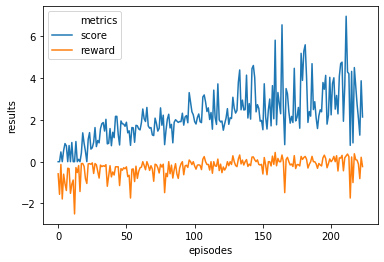

Max Train Score 12 Max Test Score 16
Mean Train Score 2.1923329175057846 Mean Test Score 3.0926366952789217
----------------------------------------------------------------------------------------------------
n_eval_episode 3321.8970875797795


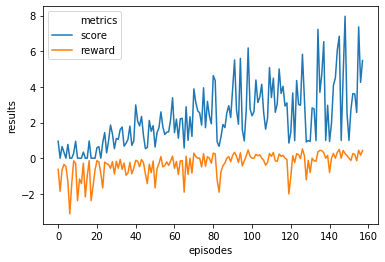

Max Train Score 15 Max Test Score 14
Mean Train Score 2.2719190596728978 Mean Test Score 3.595873841436688
----------------------------------------------------------------------------------------------------
n_eval_episode 3321.8970875797795


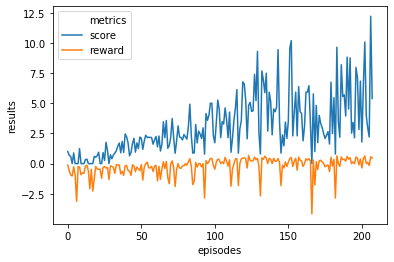

Max Train Score 22 Max Test Score 25
Mean Train Score 3.0583156219728065 Mean Test Score 5.233204478522265
----------------------------------------------------------------------------------------------------
n_eval_episode 3321.8970875797795


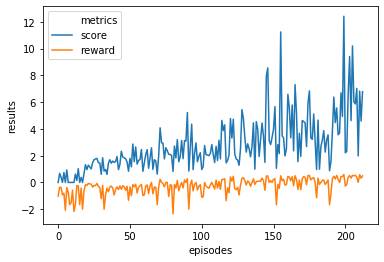

Max Train Score 24 Max Test Score 28
Mean Train Score 2.7473482266848777 Mean Test Score 5.687094107994078
----------------------------------------------------------------------------------------------------
n_eval_episode 3321.8970875797795


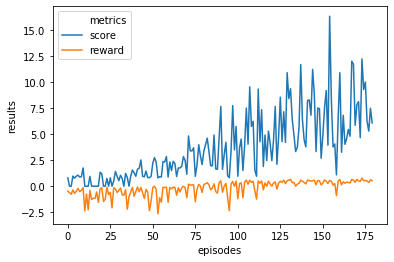

Max Train Score 31 Max Test Score 27
Mean Train Score 3.7080673562004764 Mean Test Score 7.736037133543381
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 132      |
|    ep_rew_mean        | -35.9    |
| time/                 |          |
|    fps                | 402      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.622   |
|    explained_variance | 0.0495   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.153   |
|    value_loss         | 0.00713  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.1     |
|    ep_rew_mean        | -20.9    

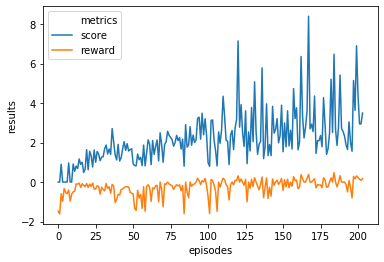

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 3466.5639446674763


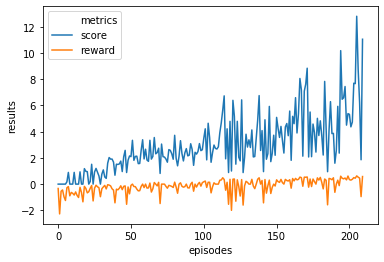

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
n_eval_episode 3466.5639446674763


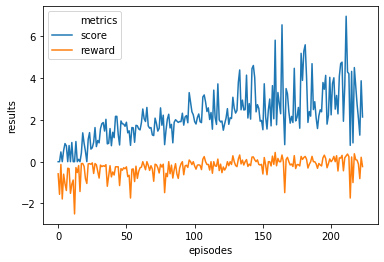

Max Train Score 12 Max Test Score 16
Mean Train Score 2.1923329175057846 Mean Test Score 3.0926366952789217
----------------------------------------------------------------------------------------------------
n_eval_episode 3466.5639446674763


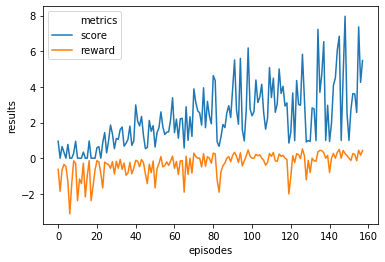

Max Train Score 15 Max Test Score 14
Mean Train Score 2.2719190596728978 Mean Test Score 3.595873841436688
----------------------------------------------------------------------------------------------------
n_eval_episode 3466.5639446674763


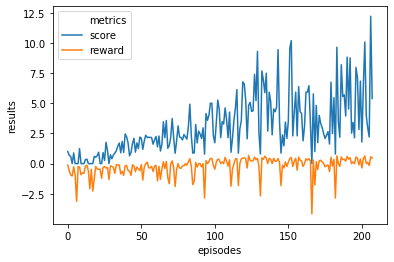

Max Train Score 22 Max Test Score 25
Mean Train Score 3.0583156219728065 Mean Test Score 5.233204478522265
----------------------------------------------------------------------------------------------------
n_eval_episode 3466.5639446674763


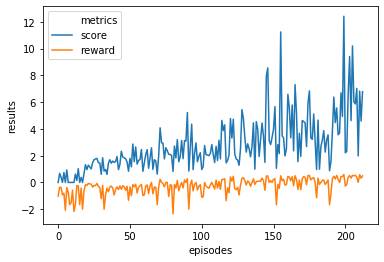

Max Train Score 24 Max Test Score 28
Mean Train Score 2.7473482266848777 Mean Test Score 5.687094107994078
----------------------------------------------------------------------------------------------------
n_eval_episode 3466.5639446674763


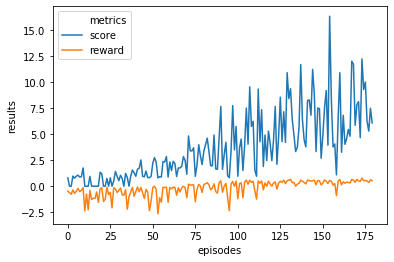

Max Train Score 31 Max Test Score 27
Mean Train Score 3.7080673562004764 Mean Test Score 7.736037133543381
----------------------------------------------------------------------------------------------------
n_eval_episode 3466.5639446674763


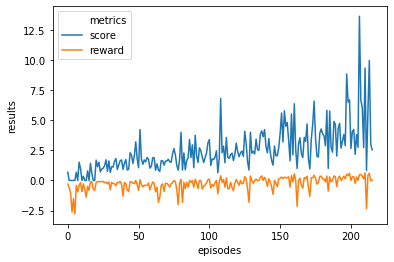

Max Train Score 27 Max Test Score 23
Mean Train Score 2.4929079597886266 Mean Test Score 5.291658633453981
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79       |
|    ep_rew_mean        | -35.7    |
| time/                 |          |
|    fps                | 440      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.501   |
|    explained_variance | -0.87    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0617  |
|    value_loss         | 0.00942  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 72       |
|    ep_rew_mean        | -9.4     

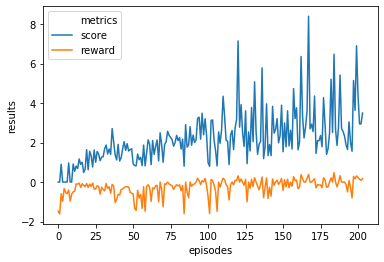

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 3201.4419527026007


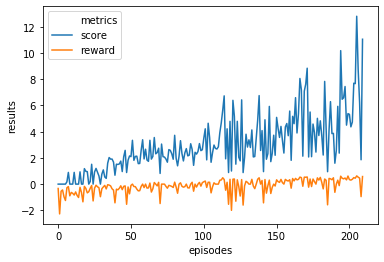

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
n_eval_episode 3201.4419527026007


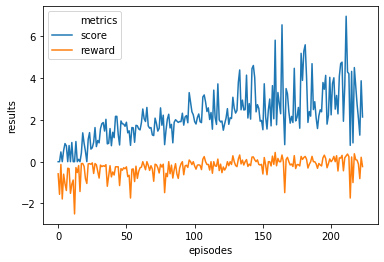

Max Train Score 12 Max Test Score 16
Mean Train Score 2.1923329175057846 Mean Test Score 3.0926366952789217
----------------------------------------------------------------------------------------------------
n_eval_episode 3201.4419527026007


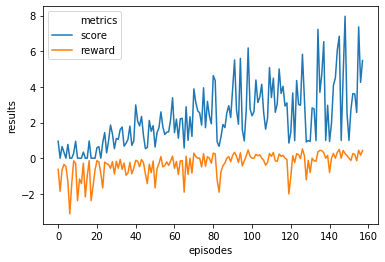

Max Train Score 15 Max Test Score 14
Mean Train Score 2.2719190596728978 Mean Test Score 3.595873841436688
----------------------------------------------------------------------------------------------------
n_eval_episode 3201.4419527026007


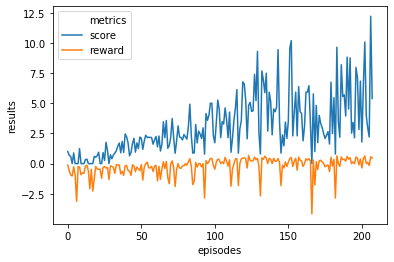

Max Train Score 22 Max Test Score 25
Mean Train Score 3.0583156219728065 Mean Test Score 5.233204478522265
----------------------------------------------------------------------------------------------------
n_eval_episode 3201.4419527026007


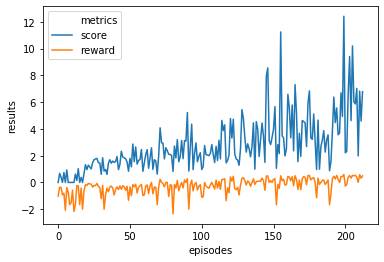

Max Train Score 24 Max Test Score 28
Mean Train Score 2.7473482266848777 Mean Test Score 5.687094107994078
----------------------------------------------------------------------------------------------------
n_eval_episode 3201.4419527026007


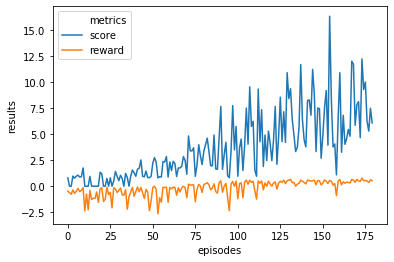

Max Train Score 31 Max Test Score 27
Mean Train Score 3.7080673562004764 Mean Test Score 7.736037133543381
----------------------------------------------------------------------------------------------------
n_eval_episode 3201.4419527026007


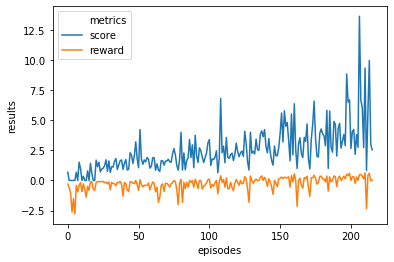

Max Train Score 27 Max Test Score 23
Mean Train Score 2.4929079597886266 Mean Test Score 5.291658633453981
----------------------------------------------------------------------------------------------------
n_eval_episode 3201.4419527026007


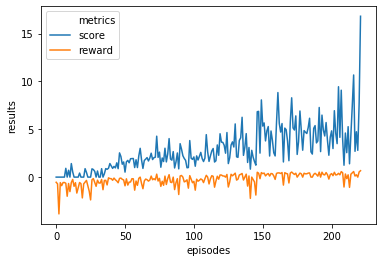

Max Train Score 33 Max Test Score 28
Mean Train Score 2.8336709009811964 Mean Test Score 5.724884622422252
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 107      |
|    ep_rew_mean        | -37      |
| time/                 |          |
|    fps                | 402      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.948   |
|    explained_variance | 0.188    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0444  |
|    value_loss         | 0.0284   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.3     |
|    ep_rew_mean        | -8       

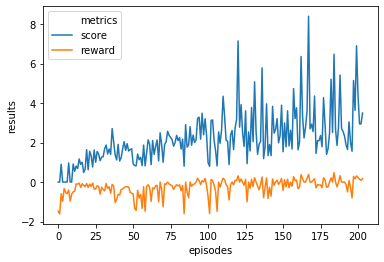

Max Train Score 15 Max Test Score 24
Mean Train Score 2.1948037574380197 Mean Test Score 3.628977010224851
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


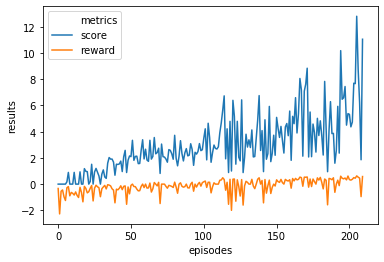

Max Train Score 23 Max Test Score 22
Mean Train Score 2.9944727274194576 Mean Test Score 5.78274108720875
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


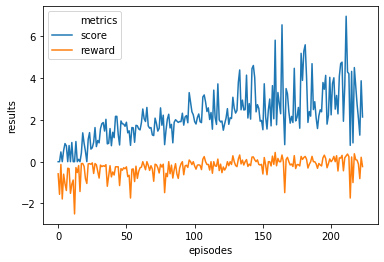

Max Train Score 12 Max Test Score 16
Mean Train Score 2.1923329175057846 Mean Test Score 3.0926366952789217
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


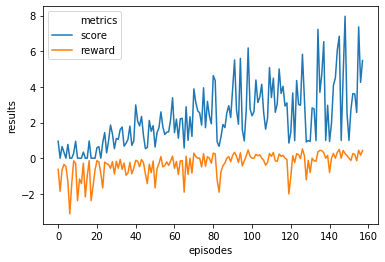

Max Train Score 15 Max Test Score 14
Mean Train Score 2.2719190596728978 Mean Test Score 3.595873841436688
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


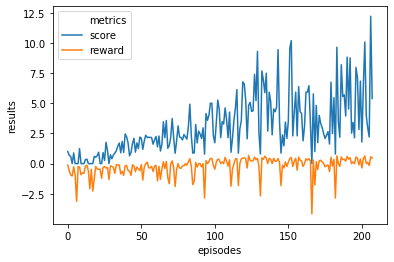

Max Train Score 22 Max Test Score 25
Mean Train Score 3.0583156219728065 Mean Test Score 5.233204478522265
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


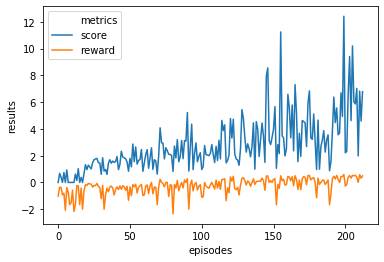

Max Train Score 24 Max Test Score 28
Mean Train Score 2.7473482266848777 Mean Test Score 5.687094107994078
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


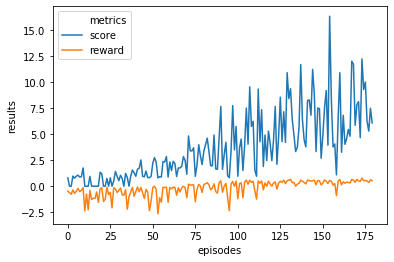

Max Train Score 31 Max Test Score 27
Mean Train Score 3.7080673562004764 Mean Test Score 7.736037133543381
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


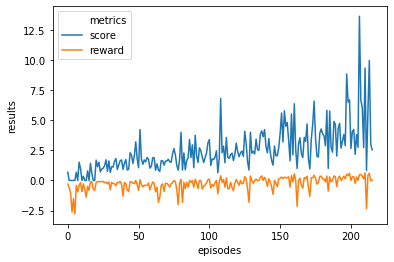

Max Train Score 27 Max Test Score 23
Mean Train Score 2.4929079597886266 Mean Test Score 5.291658633453981
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


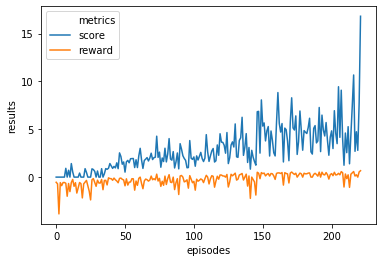

Max Train Score 33 Max Test Score 28
Mean Train Score 2.8336709009811964 Mean Test Score 5.724884622422252
----------------------------------------------------------------------------------------------------
n_eval_episode 3333.8775922049253


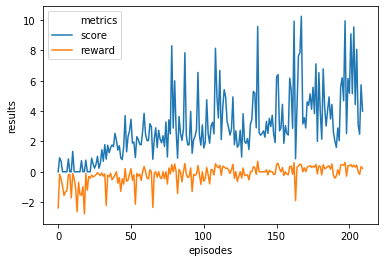

Max Train Score 21 Max Test Score 30
Mean Train Score 2.9656730169671 Mean Test Score 7.077591046137873
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


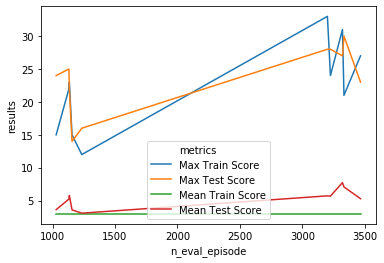

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.5     |
|    ep_rew_mean        | -44      |
| time/                 |          |
|    fps                | 353      |
|    iterations         | 1000     |
|    time_elapsed       | 14       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.517   |
|    explained_variance | -0.0466  |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00383 |
|    value_loss         | 0.000305 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 83       |
|    ep_rew_mean        | -21      |
| time/                 |          |
|    fps                | 384      |
|    iterations         | 2000 

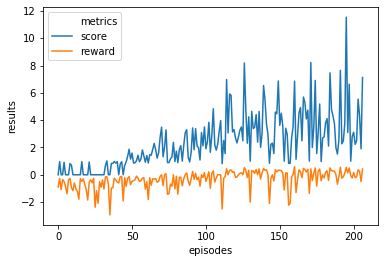

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92       |
|    ep_rew_mean        | -34.8    |
| time/                 |          |
|    fps                | 389      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.571   |
|    explained_variance | -39.6    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0016  |
|    value_loss         | 0.00155  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.2     |
|    ep_rew_mean        | -5.1     |

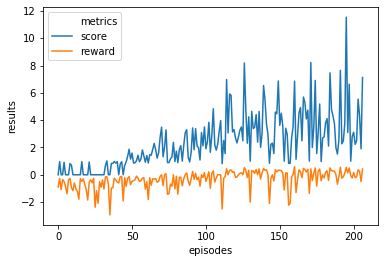

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 1091.2358004056098


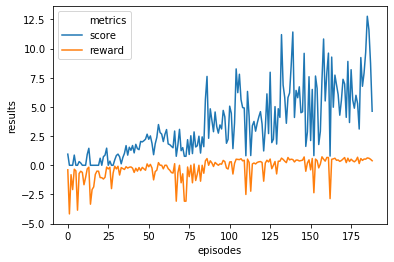

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 137      |
|    ep_rew_mean        | -42.6    |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.07    |
|    explained_variance | -3.88    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.113    |
|    value_loss         | 0.00921  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 96.7     |
|    ep_rew_mean        | -29.3    

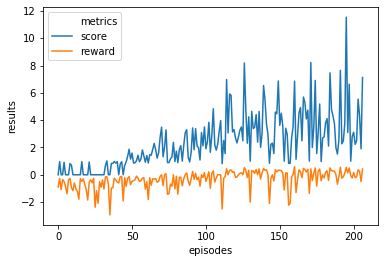

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 1092.0386799036253


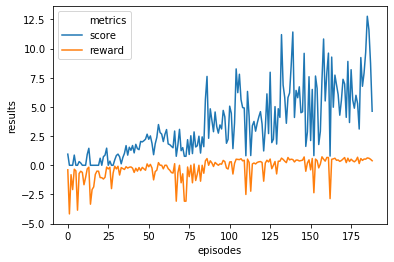

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
n_eval_episode 1092.0386799036253


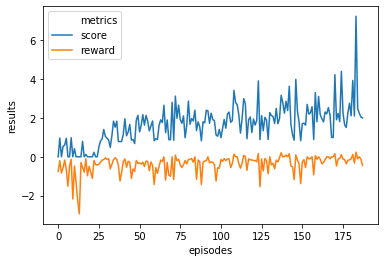

Max Train Score 11 Max Test Score 20
Mean Train Score 1.6706152343643974 Mean Test Score 3.744190495068559
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 117      |
|    ep_rew_mean        | -35      |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.123   |
|    explained_variance | -1.02    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.000196 |
|    value_loss         | 0.0043   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91       |
|    ep_rew_mean        | -18.8    

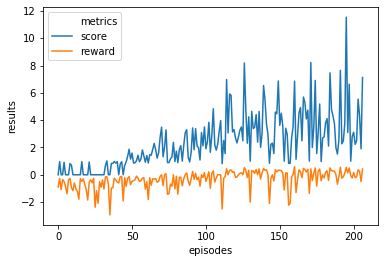

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 1015.3714167530653


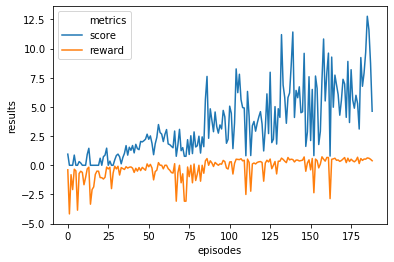

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
n_eval_episode 1015.3714167530653


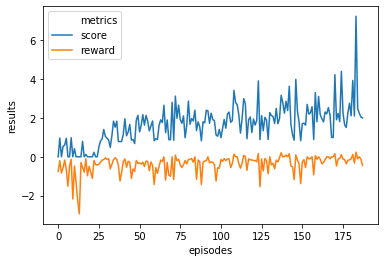

Max Train Score 11 Max Test Score 20
Mean Train Score 1.6706152343643974 Mean Test Score 3.744190495068559
----------------------------------------------------------------------------------------------------
n_eval_episode 1015.3714167530653


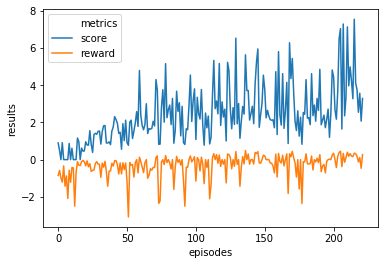

Max Train Score 14 Max Test Score 25
Mean Train Score 2.425244845821359 Mean Test Score 4.854476122924008
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 207       |
|    ep_rew_mean        | -45.8     |
| time/                 |           |
|    fps                | 453       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.195    |
|    explained_variance | -0.0342   |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -3.82e-10 |
|    value_loss         | 3.36e-16  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 156      |
|    ep_rew_mean   

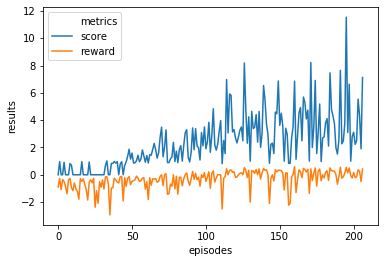

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 1115.1730520527083


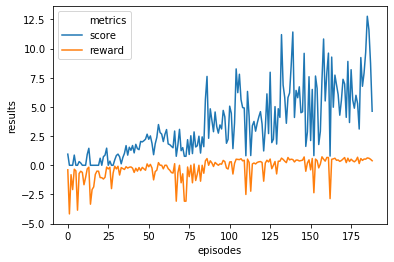

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
n_eval_episode 1115.1730520527083


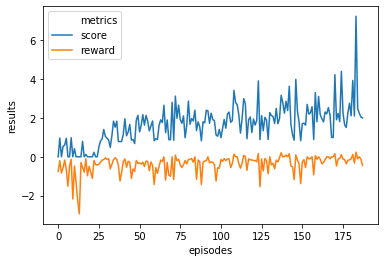

Max Train Score 11 Max Test Score 20
Mean Train Score 1.6706152343643974 Mean Test Score 3.744190495068559
----------------------------------------------------------------------------------------------------
n_eval_episode 1115.1730520527083


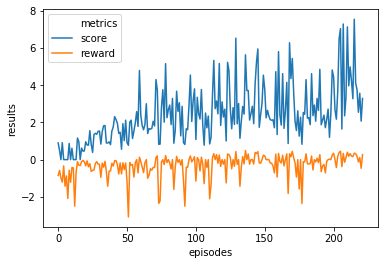

Max Train Score 14 Max Test Score 25
Mean Train Score 2.425244845821359 Mean Test Score 4.854476122924008
----------------------------------------------------------------------------------------------------
n_eval_episode 1115.1730520527083


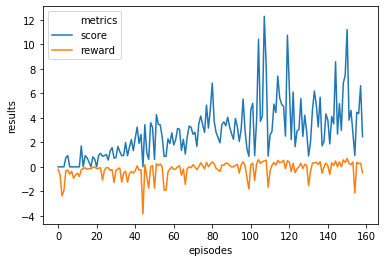

Max Train Score 23 Max Test Score 26
Mean Train Score 2.9152933344439824 Mean Test Score 5.42611150596103
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 78.9     |
|    ep_rew_mean        | -36.3    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.636   |
|    explained_variance | -1.32    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0299   |
|    value_loss         | 0.0165   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82.2     |
|    ep_rew_mean        | -5.9     |

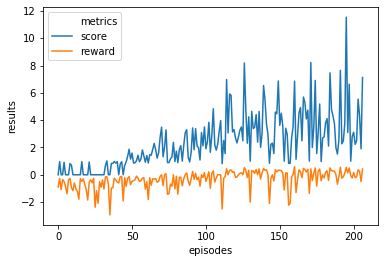

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 3131.210133375544


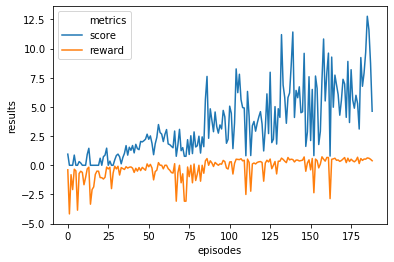

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
n_eval_episode 3131.210133375544


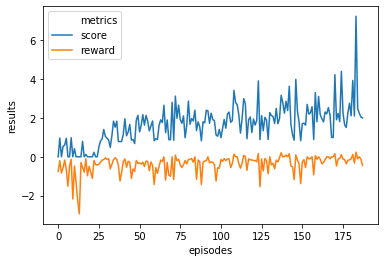

Max Train Score 11 Max Test Score 20
Mean Train Score 1.6706152343643974 Mean Test Score 3.744190495068559
----------------------------------------------------------------------------------------------------
n_eval_episode 3131.210133375544


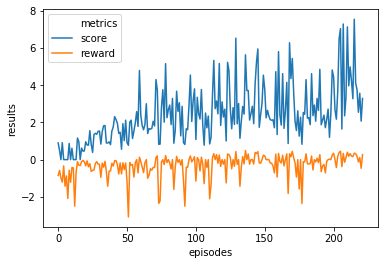

Max Train Score 14 Max Test Score 25
Mean Train Score 2.425244845821359 Mean Test Score 4.854476122924008
----------------------------------------------------------------------------------------------------
n_eval_episode 3131.210133375544


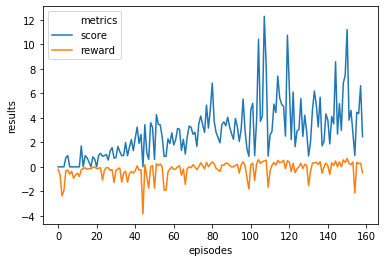

Max Train Score 23 Max Test Score 26
Mean Train Score 2.9152933344439824 Mean Test Score 5.42611150596103
----------------------------------------------------------------------------------------------------
n_eval_episode 3131.210133375544


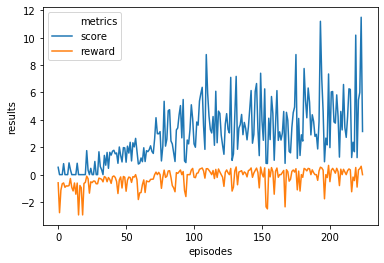

Max Train Score 22 Max Test Score 35
Mean Train Score 2.9201947378887683 Mean Test Score 5.1316549873878055
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 113      |
|    ep_rew_mean        | -29.3    |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.585   |
|    explained_variance | 0.494    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.248    |
|    value_loss         | 0.151    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 94.5     |
|    ep_rew_mean        | -6.2    

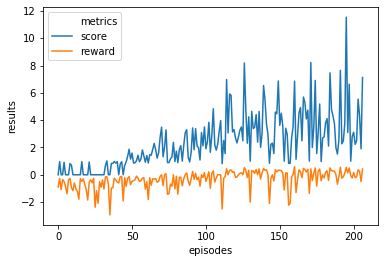

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 3489.157829651854


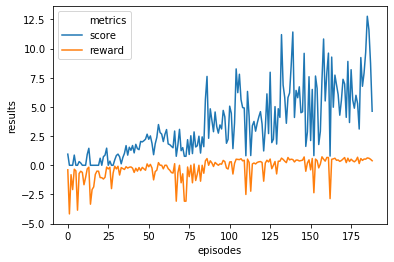

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
n_eval_episode 3489.157829651854


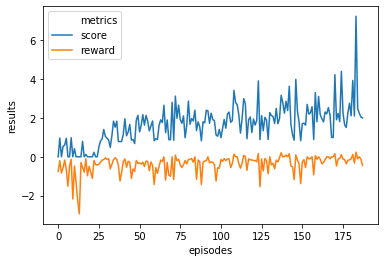

Max Train Score 11 Max Test Score 20
Mean Train Score 1.6706152343643974 Mean Test Score 3.744190495068559
----------------------------------------------------------------------------------------------------
n_eval_episode 3489.157829651854


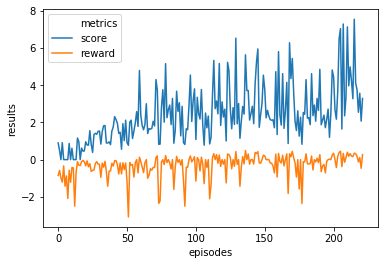

Max Train Score 14 Max Test Score 25
Mean Train Score 2.425244845821359 Mean Test Score 4.854476122924008
----------------------------------------------------------------------------------------------------
n_eval_episode 3489.157829651854


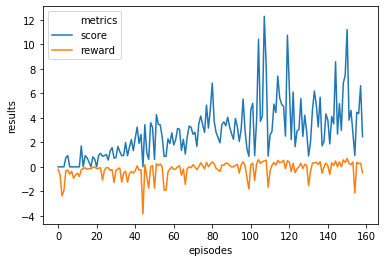

Max Train Score 23 Max Test Score 26
Mean Train Score 2.9152933344439824 Mean Test Score 5.42611150596103
----------------------------------------------------------------------------------------------------
n_eval_episode 3489.157829651854


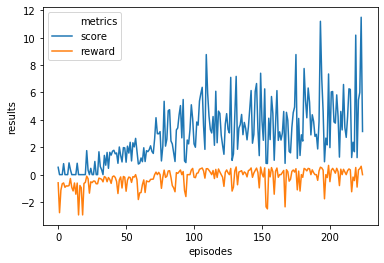

Max Train Score 22 Max Test Score 35
Mean Train Score 2.9201947378887683 Mean Test Score 5.1316549873878055
----------------------------------------------------------------------------------------------------
n_eval_episode 3489.157829651854


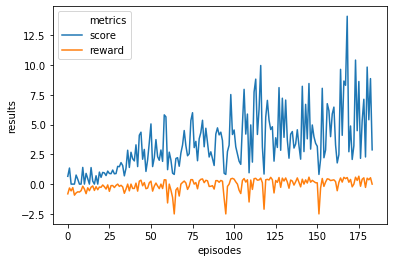

Max Train Score 26 Max Test Score 23
Mean Train Score 3.4176076726988422 Mean Test Score 5.38424370820033
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 103      |
|    ep_rew_mean        | -36      |
| time/                 |          |
|    fps                | 440      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.491   |
|    explained_variance | -0.677   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0276  |
|    value_loss         | 0.00353  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 83.4     |
|    ep_rew_mean        | -5.8     |

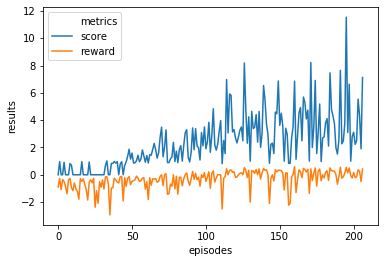

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 3234.378792922492


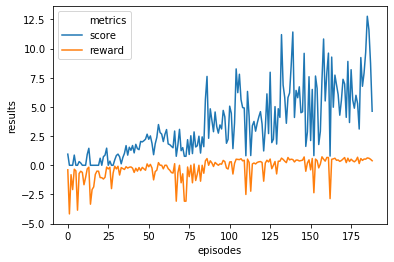

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
n_eval_episode 3234.378792922492


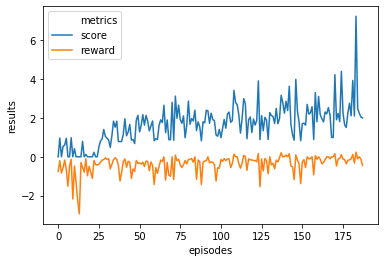

Max Train Score 11 Max Test Score 20
Mean Train Score 1.6706152343643974 Mean Test Score 3.744190495068559
----------------------------------------------------------------------------------------------------
n_eval_episode 3234.378792922492


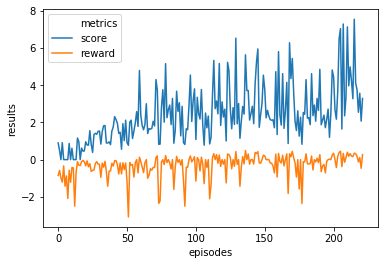

Max Train Score 14 Max Test Score 25
Mean Train Score 2.425244845821359 Mean Test Score 4.854476122924008
----------------------------------------------------------------------------------------------------
n_eval_episode 3234.378792922492


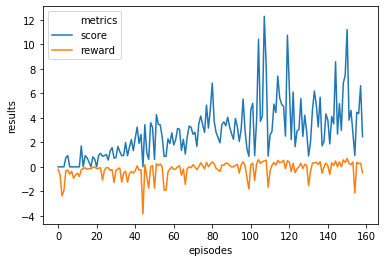

Max Train Score 23 Max Test Score 26
Mean Train Score 2.9152933344439824 Mean Test Score 5.42611150596103
----------------------------------------------------------------------------------------------------
n_eval_episode 3234.378792922492


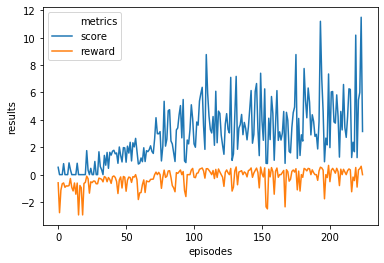

Max Train Score 22 Max Test Score 35
Mean Train Score 2.9201947378887683 Mean Test Score 5.1316549873878055
----------------------------------------------------------------------------------------------------
n_eval_episode 3234.378792922492


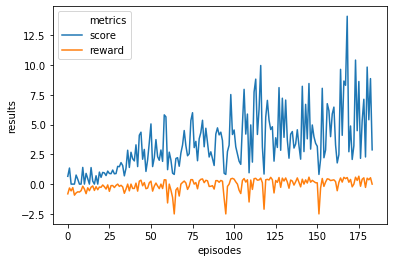

Max Train Score 26 Max Test Score 23
Mean Train Score 3.4176076726988422 Mean Test Score 5.38424370820033
----------------------------------------------------------------------------------------------------
n_eval_episode 3234.378792922492


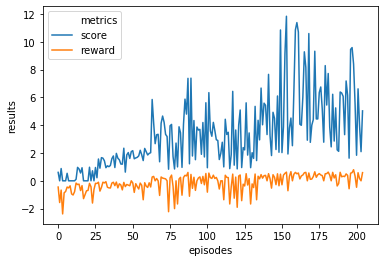

Max Train Score 23 Max Test Score 23
Mean Train Score 3.306183317177606 Mean Test Score 6.275553238872945
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 75.7     |
|    ep_rew_mean        | -33.3    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.477   |
|    explained_variance | 0.331    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.636    |
|    value_loss         | 0.408    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70       |
|    ep_rew_mean        | -14.2    |

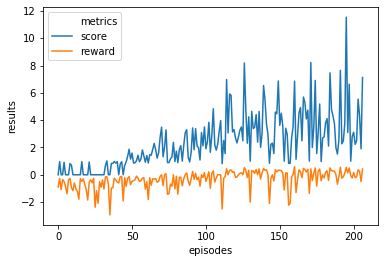

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 3369.290160644582


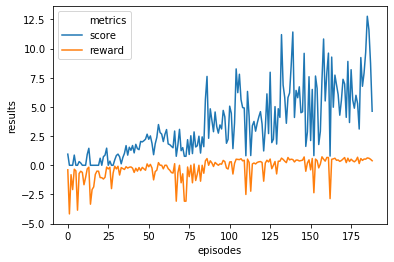

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
n_eval_episode 3369.290160644582


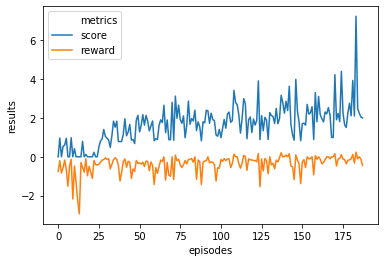

Max Train Score 11 Max Test Score 20
Mean Train Score 1.6706152343643974 Mean Test Score 3.744190495068559
----------------------------------------------------------------------------------------------------
n_eval_episode 3369.290160644582


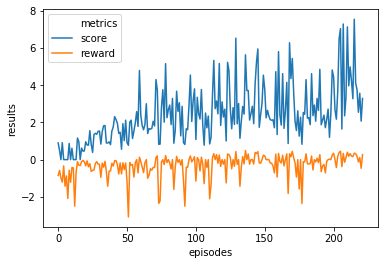

Max Train Score 14 Max Test Score 25
Mean Train Score 2.425244845821359 Mean Test Score 4.854476122924008
----------------------------------------------------------------------------------------------------
n_eval_episode 3369.290160644582


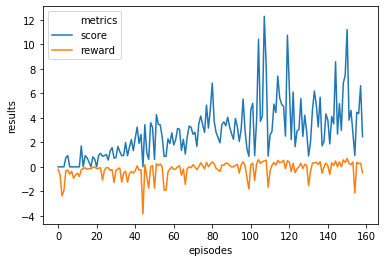

Max Train Score 23 Max Test Score 26
Mean Train Score 2.9152933344439824 Mean Test Score 5.42611150596103
----------------------------------------------------------------------------------------------------
n_eval_episode 3369.290160644582


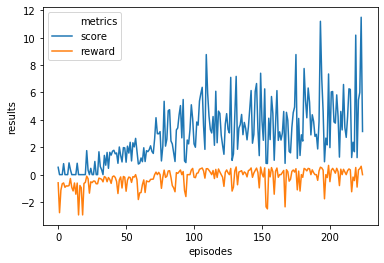

Max Train Score 22 Max Test Score 35
Mean Train Score 2.9201947378887683 Mean Test Score 5.1316549873878055
----------------------------------------------------------------------------------------------------
n_eval_episode 3369.290160644582


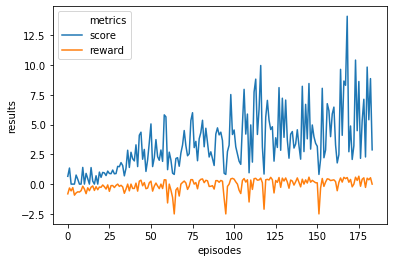

Max Train Score 26 Max Test Score 23
Mean Train Score 3.4176076726988422 Mean Test Score 5.38424370820033
----------------------------------------------------------------------------------------------------
n_eval_episode 3369.290160644582


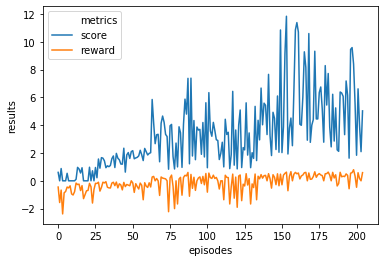

Max Train Score 23 Max Test Score 23
Mean Train Score 3.306183317177606 Mean Test Score 6.275553238872945
----------------------------------------------------------------------------------------------------
n_eval_episode 3369.290160644582


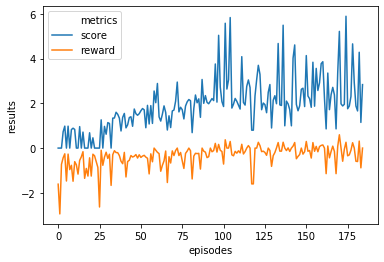

Max Train Score 11 Max Test Score 11
Mean Train Score 1.904985725683232 Mean Test Score 2.6894886612496225
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | -32.2    |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.849   |
|    explained_variance | -0.28    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.113   |
|    value_loss         | 0.0133   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 94.8     |
|    ep_rew_mean        | -8.5     

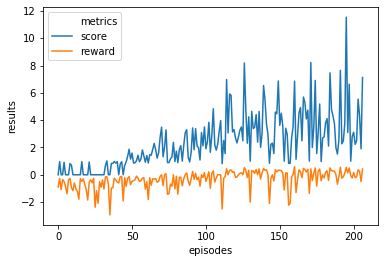

Max Train Score 22 Max Test Score 24
Mean Train Score 2.3725810767015934 Mean Test Score 4.57898183983152
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


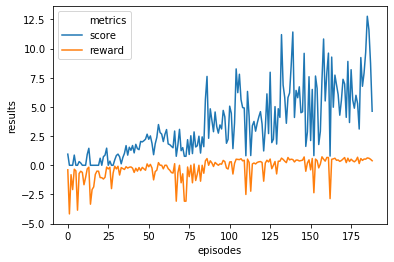

Max Train Score 26 Max Test Score 31
Mean Train Score 3.4819249957943783 Mean Test Score 7.017069966150163
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


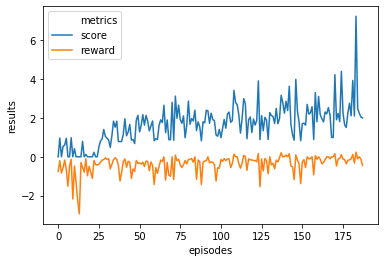

Max Train Score 11 Max Test Score 20
Mean Train Score 1.6706152343643974 Mean Test Score 3.744190495068559
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


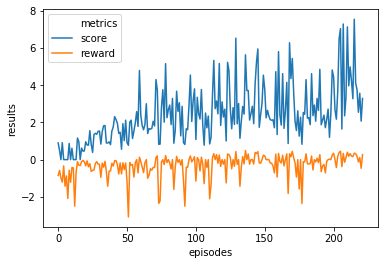

Max Train Score 14 Max Test Score 25
Mean Train Score 2.425244845821359 Mean Test Score 4.854476122924008
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


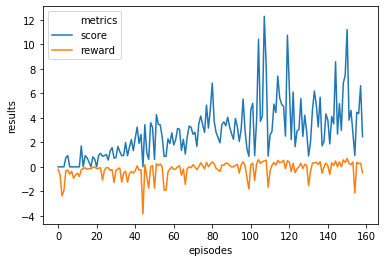

Max Train Score 23 Max Test Score 26
Mean Train Score 2.9152933344439824 Mean Test Score 5.42611150596103
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


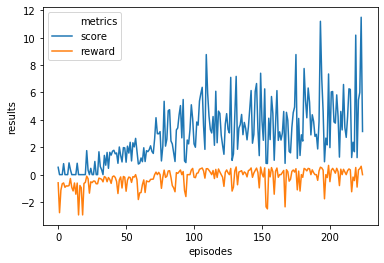

Max Train Score 22 Max Test Score 35
Mean Train Score 2.9201947378887683 Mean Test Score 5.1316549873878055
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


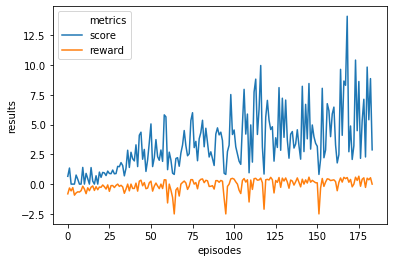

Max Train Score 26 Max Test Score 23
Mean Train Score 3.4176076726988422 Mean Test Score 5.38424370820033
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


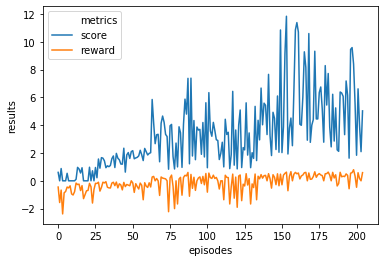

Max Train Score 23 Max Test Score 23
Mean Train Score 3.306183317177606 Mean Test Score 6.275553238872945
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


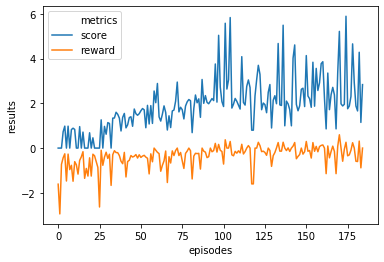

Max Train Score 11 Max Test Score 11
Mean Train Score 1.904985725683232 Mean Test Score 2.6894886612496225
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.358718146592


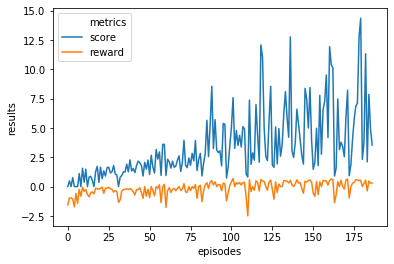

Max Train Score 27 Max Test Score 26
Mean Train Score 3.402391921076875 Mean Test Score 5.21329843428917
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


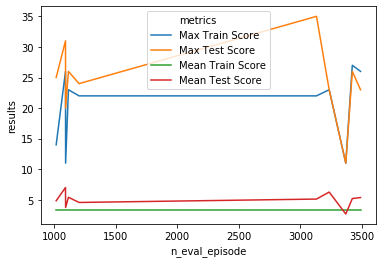

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 94       |
|    ep_rew_mean        | -38.1    |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.378   |
|    explained_variance | -2e+03   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 2.72     |
|    value_loss         | 53       |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.1     |
|    ep_rew_mean        | -11.8    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 2000 

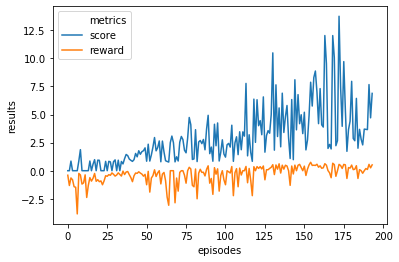

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 180      |
|    ep_rew_mean        | -39.6    |
| time/                 |          |
|    fps                | 464      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.364   |
|    explained_variance | 0.168    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00248 |
|    value_loss         | 0.000812 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 135      |
|    ep_rew_mean        | -31.3    

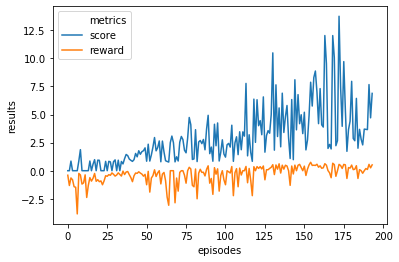

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 1157.6219608527397


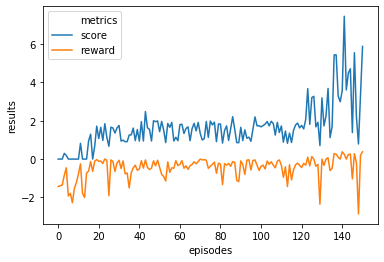

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 73.7     |
|    ep_rew_mean        | -35.1    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.422   |
|    explained_variance | -0.314   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00923 |
|    value_loss         | 0.00681  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 65.9     |
|    ep_rew_mean        | -15.1    |

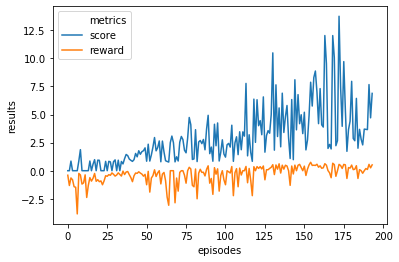

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 1006.277001531253


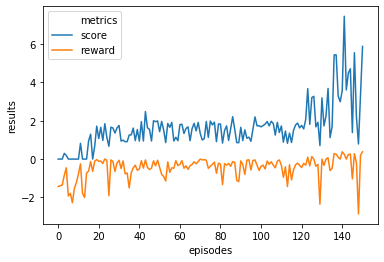

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
n_eval_episode 1006.277001531253


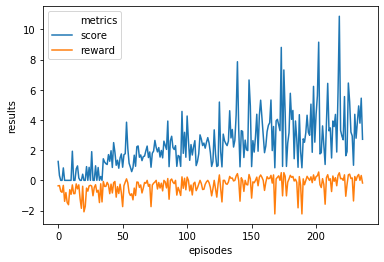

Max Train Score 21 Max Test Score 19
Mean Train Score 2.4025425140714387 Mean Test Score 4.442086174392733
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -28.7    |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.3     |
|    explained_variance | 0.111    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.00454  |
|    value_loss         | 0.0355   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 72.1     |
|    ep_rew_mean        | -3.8     

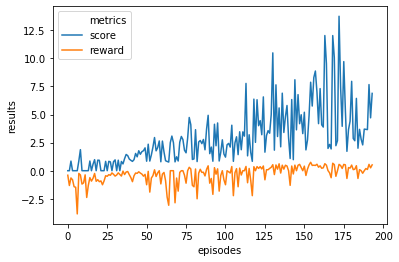

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 1244.2266742433549


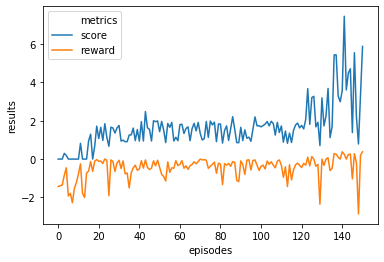

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
n_eval_episode 1244.2266742433549


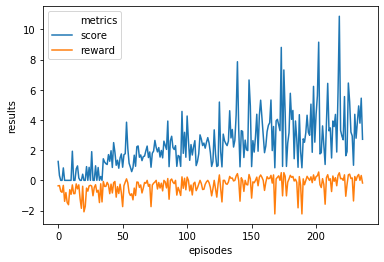

Max Train Score 21 Max Test Score 19
Mean Train Score 2.4025425140714387 Mean Test Score 4.442086174392733
----------------------------------------------------------------------------------------------------
n_eval_episode 1244.2266742433549


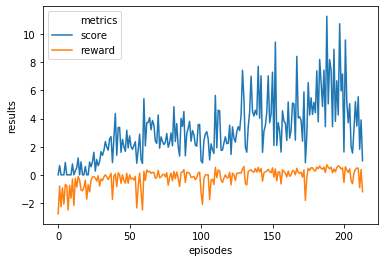

Max Train Score 23 Max Test Score 24
Mean Train Score 3.151000284948272 Mean Test Score 5.489353146353178
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 159      |
|    ep_rew_mean        | -40.3    |
| time/                 |          |
|    fps                | 451      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.57    |
|    explained_variance | 0.18     |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00725 |
|    value_loss         | 0.00567  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.4     |
|    ep_rew_mean        | -18.9    |

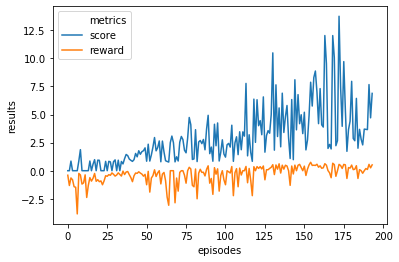

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 1017.5936318779198


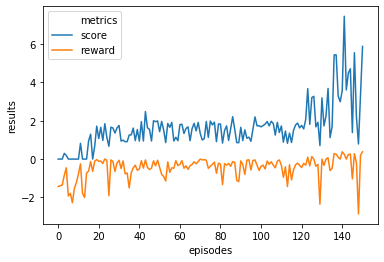

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
n_eval_episode 1017.5936318779198


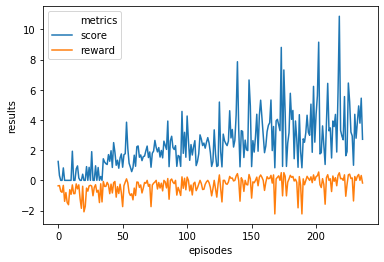

Max Train Score 21 Max Test Score 19
Mean Train Score 2.4025425140714387 Mean Test Score 4.442086174392733
----------------------------------------------------------------------------------------------------
n_eval_episode 1017.5936318779198


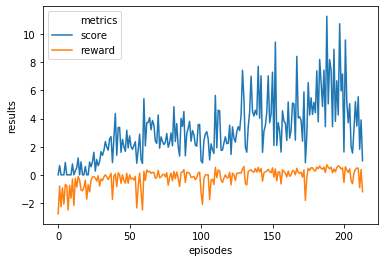

Max Train Score 23 Max Test Score 24
Mean Train Score 3.151000284948272 Mean Test Score 5.489353146353178
----------------------------------------------------------------------------------------------------
n_eval_episode 1017.5936318779198


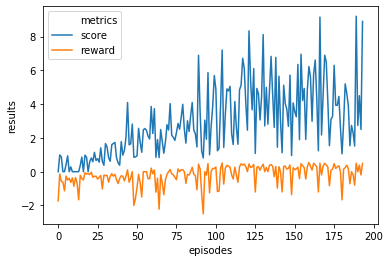

Max Train Score 16 Max Test Score 27
Mean Train Score 2.895326067750347 Mean Test Score 5.217924494729506
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79.5     |
|    ep_rew_mean        | -37.9    |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.47    |
|    explained_variance | 0.161    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.118   |
|    value_loss         | 0.489    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 69.5     |
|    ep_rew_mean        | -12.1    |

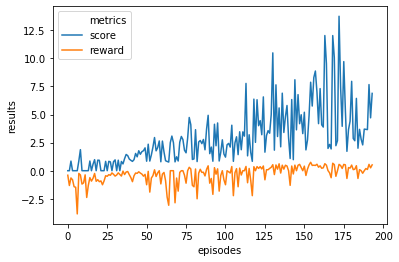

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 3296.063270564627


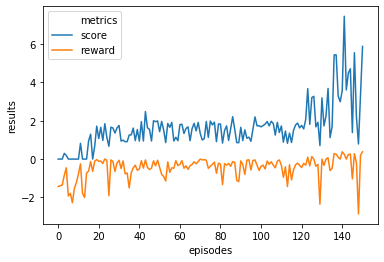

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
n_eval_episode 3296.063270564627


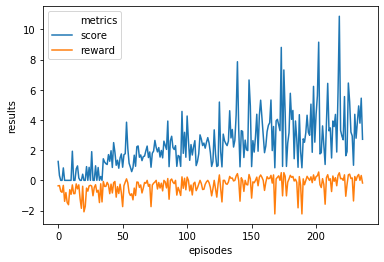

Max Train Score 21 Max Test Score 19
Mean Train Score 2.4025425140714387 Mean Test Score 4.442086174392733
----------------------------------------------------------------------------------------------------
n_eval_episode 3296.063270564627


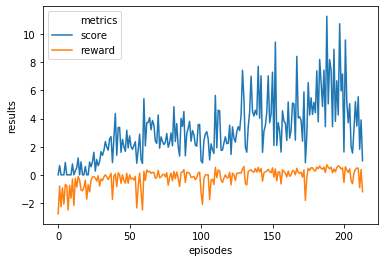

Max Train Score 23 Max Test Score 24
Mean Train Score 3.151000284948272 Mean Test Score 5.489353146353178
----------------------------------------------------------------------------------------------------
n_eval_episode 3296.063270564627


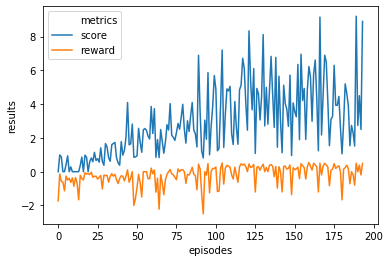

Max Train Score 16 Max Test Score 27
Mean Train Score 2.895326067750347 Mean Test Score 5.217924494729506
----------------------------------------------------------------------------------------------------
n_eval_episode 3296.063270564627


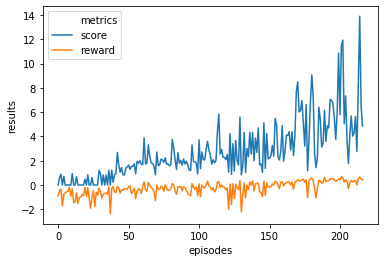

Max Train Score 25 Max Test Score 15
Mean Train Score 2.7467731290738726 Mean Test Score 3.074805421489183
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 135       |
|    ep_rew_mean        | -36.2     |
| time/                 |           |
|    fps                | 452       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.623    |
|    explained_variance | -1.55e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | 1.97      |
|    value_loss         | 37.1      |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 102      |
|    ep_rew_mean  

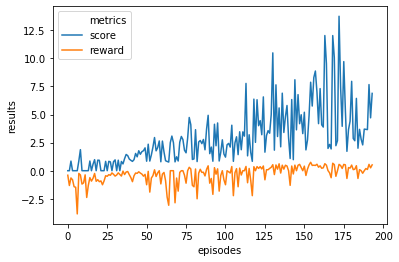

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.3595699796624


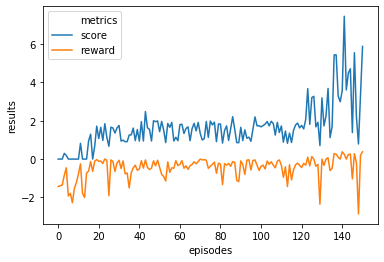

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.3595699796624


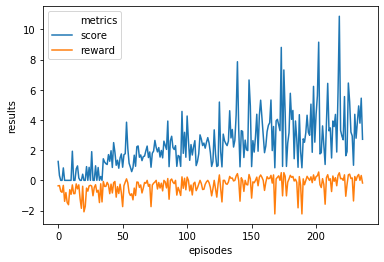

Max Train Score 21 Max Test Score 19
Mean Train Score 2.4025425140714387 Mean Test Score 4.442086174392733
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.3595699796624


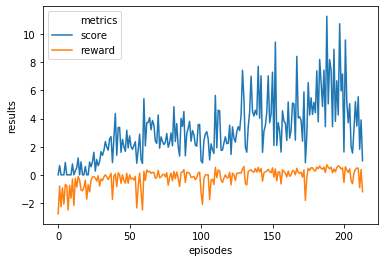

Max Train Score 23 Max Test Score 24
Mean Train Score 3.151000284948272 Mean Test Score 5.489353146353178
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.3595699796624


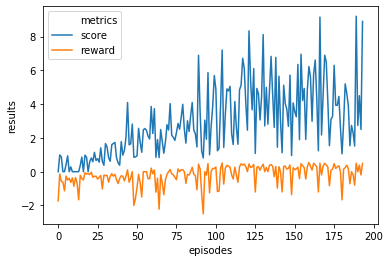

Max Train Score 16 Max Test Score 27
Mean Train Score 2.895326067750347 Mean Test Score 5.217924494729506
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.3595699796624


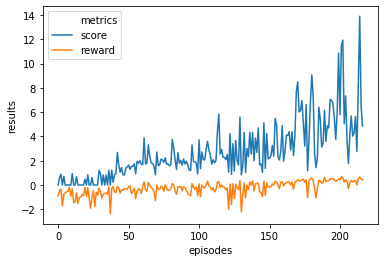

Max Train Score 25 Max Test Score 15
Mean Train Score 2.7467731290738726 Mean Test Score 3.074805421489183
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.3595699796624


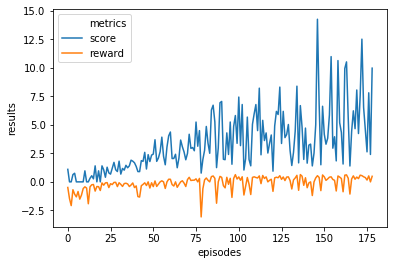

Max Train Score 26 Max Test Score 29
Mean Train Score 3.367471539804531 Mean Test Score 4.814524700808077
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.5     |
|    ep_rew_mean        | -39.1    |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.805   |
|    explained_variance | -0.041   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0398  |
|    value_loss         | 0.00822  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.7     |
|    ep_rew_mean        | -19.6    |

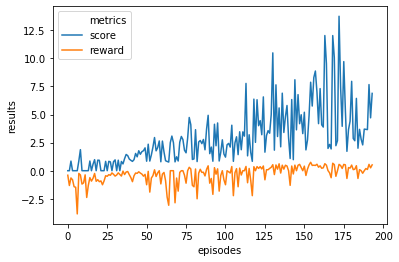

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 3011.326885629262


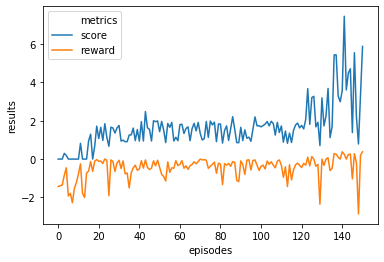

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
n_eval_episode 3011.326885629262


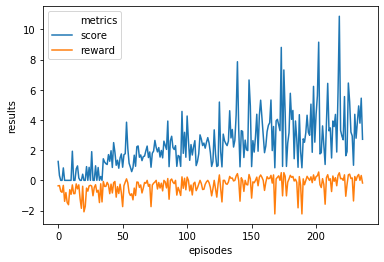

Max Train Score 21 Max Test Score 19
Mean Train Score 2.4025425140714387 Mean Test Score 4.442086174392733
----------------------------------------------------------------------------------------------------
n_eval_episode 3011.326885629262


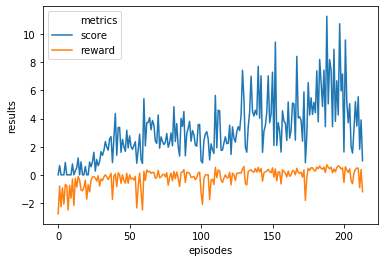

Max Train Score 23 Max Test Score 24
Mean Train Score 3.151000284948272 Mean Test Score 5.489353146353178
----------------------------------------------------------------------------------------------------
n_eval_episode 3011.326885629262


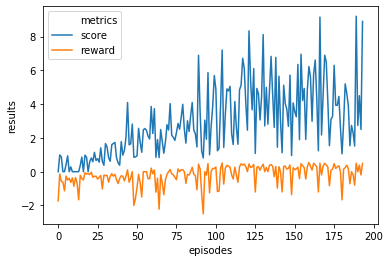

Max Train Score 16 Max Test Score 27
Mean Train Score 2.895326067750347 Mean Test Score 5.217924494729506
----------------------------------------------------------------------------------------------------
n_eval_episode 3011.326885629262


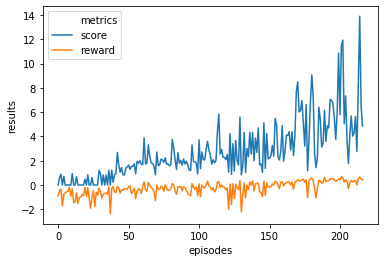

Max Train Score 25 Max Test Score 15
Mean Train Score 2.7467731290738726 Mean Test Score 3.074805421489183
----------------------------------------------------------------------------------------------------
n_eval_episode 3011.326885629262


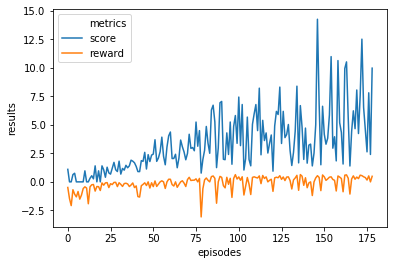

Max Train Score 26 Max Test Score 29
Mean Train Score 3.367471539804531 Mean Test Score 4.814524700808077
----------------------------------------------------------------------------------------------------
n_eval_episode 3011.326885629262


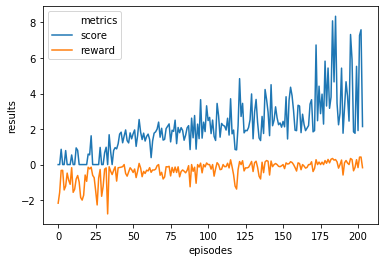

Max Train Score 16 Max Test Score 29
Mean Train Score 2.1477709907104625 Mean Test Score 4.9582332200210475
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99.1     |
|    ep_rew_mean        | -30.6    |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.369   |
|    explained_variance | -0.567   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.175   |
|    value_loss         | 0.0273   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 94.1     |
|    ep_rew_mean        | -6.2    

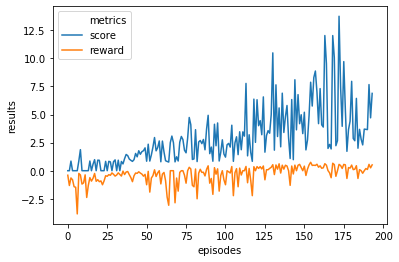

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 3221.1528082267832


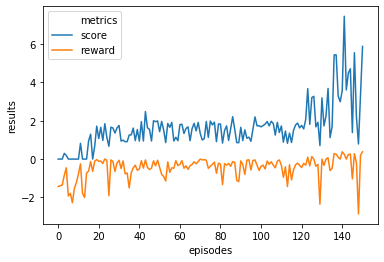

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
n_eval_episode 3221.1528082267832


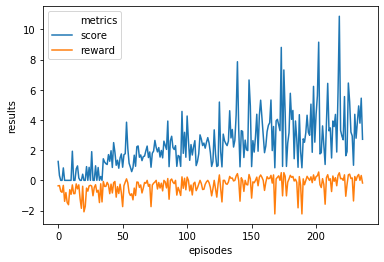

Max Train Score 21 Max Test Score 19
Mean Train Score 2.4025425140714387 Mean Test Score 4.442086174392733
----------------------------------------------------------------------------------------------------
n_eval_episode 3221.1528082267832


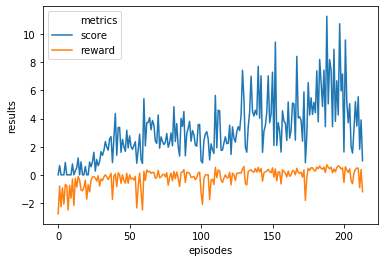

Max Train Score 23 Max Test Score 24
Mean Train Score 3.151000284948272 Mean Test Score 5.489353146353178
----------------------------------------------------------------------------------------------------
n_eval_episode 3221.1528082267832


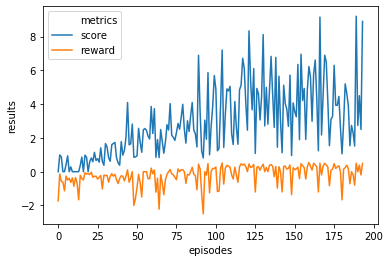

Max Train Score 16 Max Test Score 27
Mean Train Score 2.895326067750347 Mean Test Score 5.217924494729506
----------------------------------------------------------------------------------------------------
n_eval_episode 3221.1528082267832


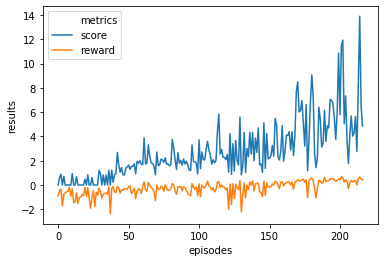

Max Train Score 25 Max Test Score 15
Mean Train Score 2.7467731290738726 Mean Test Score 3.074805421489183
----------------------------------------------------------------------------------------------------
n_eval_episode 3221.1528082267832


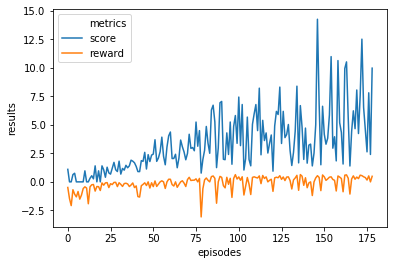

Max Train Score 26 Max Test Score 29
Mean Train Score 3.367471539804531 Mean Test Score 4.814524700808077
----------------------------------------------------------------------------------------------------
n_eval_episode 3221.1528082267832


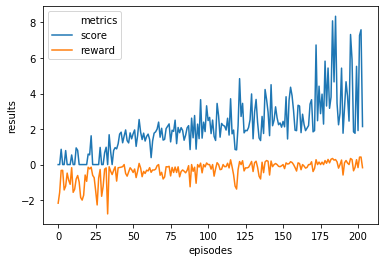

Max Train Score 16 Max Test Score 29
Mean Train Score 2.1477709907104625 Mean Test Score 4.9582332200210475
----------------------------------------------------------------------------------------------------
n_eval_episode 3221.1528082267832


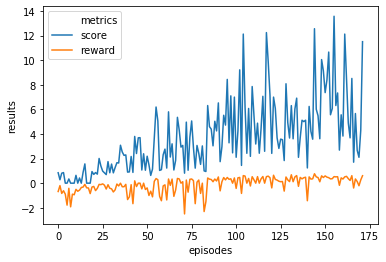

Max Train Score 25 Max Test Score 33
Mean Train Score 3.699940470421613 Mean Test Score 7.905583947233187
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 177       |
|    ep_rew_mean        | -40       |
| time/                 |           |
|    fps                | 387       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.745    |
|    explained_variance | 0.291     |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -0.000174 |
|    value_loss         | 1.37e-05  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 101      |
|    ep_rew_mean   

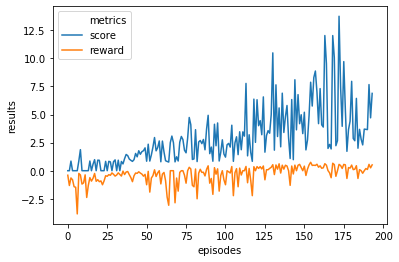

Max Train Score 24 Max Test Score 24
Mean Train Score 2.939269207739231 Mean Test Score 5.1631007659432075
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


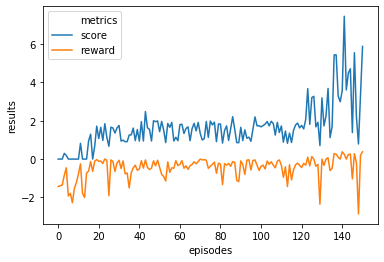

Max Train Score 13 Max Test Score 22
Mean Train Score 1.643282624290816 Mean Test Score 4.059793253955444
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


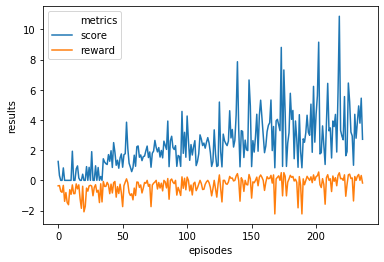

Max Train Score 21 Max Test Score 19
Mean Train Score 2.4025425140714387 Mean Test Score 4.442086174392733
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


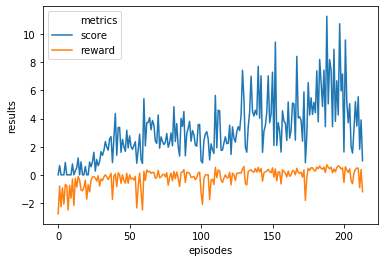

Max Train Score 23 Max Test Score 24
Mean Train Score 3.151000284948272 Mean Test Score 5.489353146353178
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


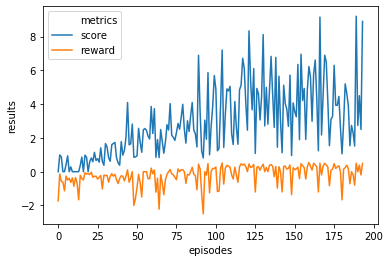

Max Train Score 16 Max Test Score 27
Mean Train Score 2.895326067750347 Mean Test Score 5.217924494729506
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


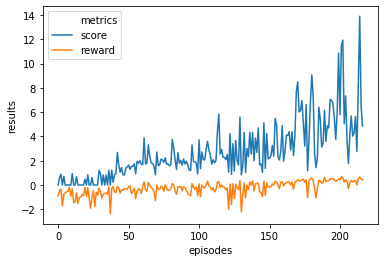

Max Train Score 25 Max Test Score 15
Mean Train Score 2.7467731290738726 Mean Test Score 3.074805421489183
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


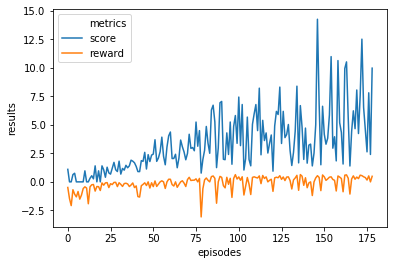

Max Train Score 26 Max Test Score 29
Mean Train Score 3.367471539804531 Mean Test Score 4.814524700808077
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


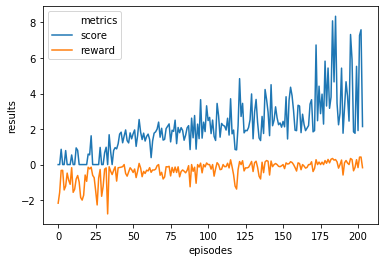

Max Train Score 16 Max Test Score 29
Mean Train Score 2.1477709907104625 Mean Test Score 4.9582332200210475
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


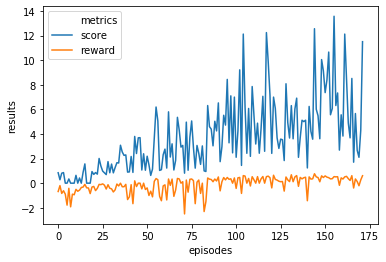

Max Train Score 25 Max Test Score 33
Mean Train Score 3.699940470421613 Mean Test Score 7.905583947233187
----------------------------------------------------------------------------------------------------
n_eval_episode 3023.445544112726


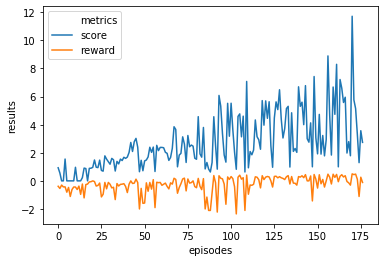

Max Train Score 22 Max Test Score 26
Mean Train Score 2.712675616364449 Mean Test Score 5.035764017056215
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


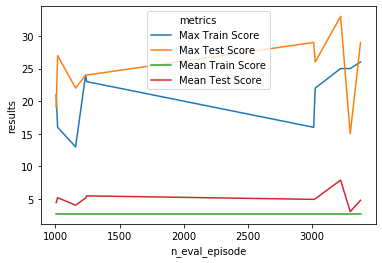

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 97.9      |
|    ep_rew_mean        | -33.1     |
| time/                 |           |
|    fps                | 430       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.459    |
|    explained_variance | -1.27e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -13.6     |
|    value_loss         | 1.44e+03  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 90.7      |
|    ep_rew_mean        | -7.6      |
| time/                 |           |
|    fps                | 411       |
|    ite

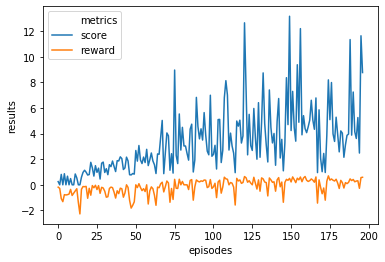

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 103      |
|    ep_rew_mean        | -35.8    |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.142   |
|    explained_variance | -4.28    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.00349  |
|    value_loss         | 0.0132   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 75.8     |
|    ep_rew_mean        | -17.1    |

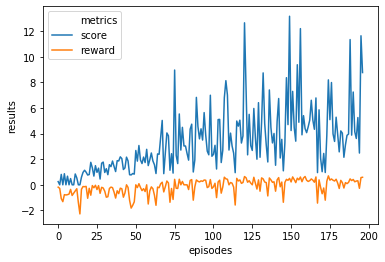

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 1166.7093489825002


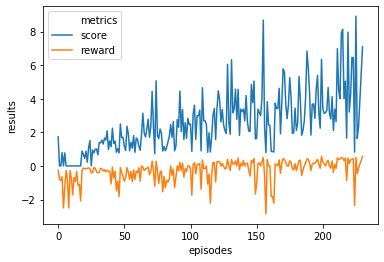

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 113      |
|    ep_rew_mean        | -47.1    |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0302  |
|    explained_variance | -5.16    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -5.8e-09 |
|    value_loss         | 1.26e-12 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 231      |
|    ep_rew_mean        | -43.1    |

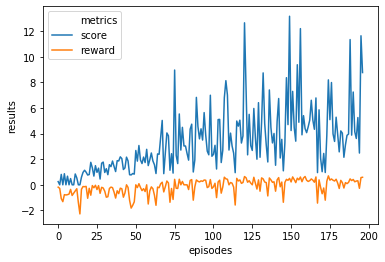

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 1210.5583948432109


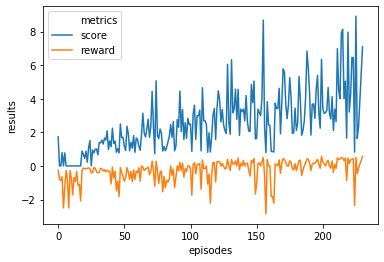

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
n_eval_episode 1210.5583948432109


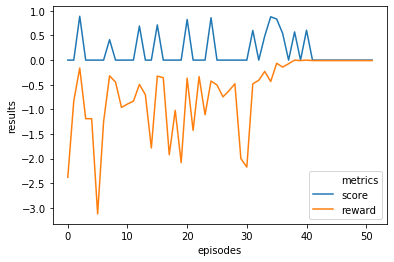

Max Train Score 1 Max Test Score 0
Mean Train Score 0.17174411787074875 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89       |
|    ep_rew_mean        | -30      |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.543   |
|    explained_variance | 0.405    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0655   |
|    value_loss         | 0.0148   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.1     |
|    ep_rew_mean        | -1.9     |
| time/      

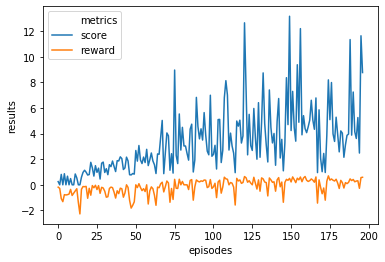

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 1207.1869960076458


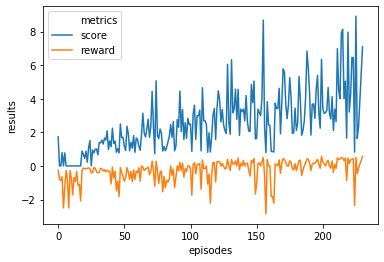

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
n_eval_episode 1207.1869960076458


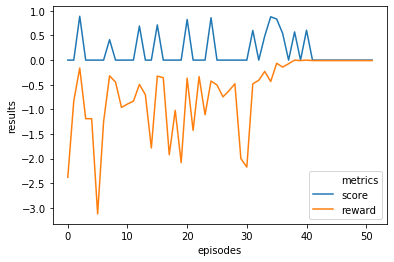

Max Train Score 1 Max Test Score 0
Mean Train Score 0.17174411787074875 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 1207.1869960076458


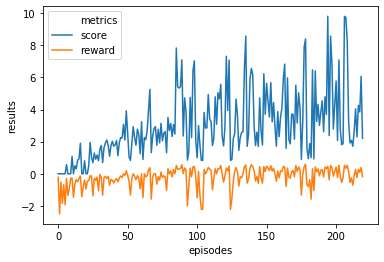

Max Train Score 18 Max Test Score 28
Mean Train Score 3.0038586715770275 Mean Test Score 4.647633119014444
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.7     |
|    ep_rew_mean        | -40.5    |
| time/                 |          |
|    fps                | 401      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.689   |
|    explained_variance | -112     |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 1.96     |
|    value_loss         | 47       |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.7     |
|    ep_rew_mean        | -16.6    

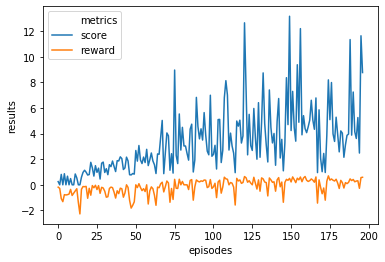

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 1232.336303375394


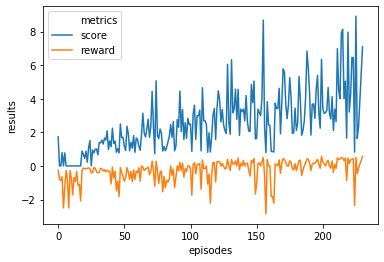

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
n_eval_episode 1232.336303375394


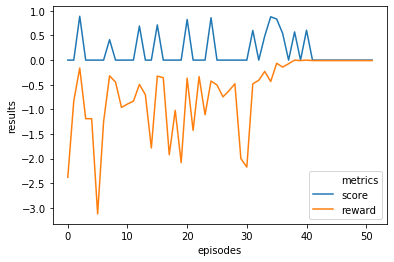

Max Train Score 1 Max Test Score 0
Mean Train Score 0.17174411787074875 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 1232.336303375394


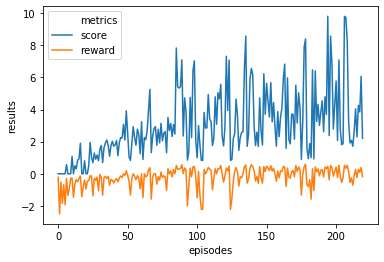

Max Train Score 18 Max Test Score 28
Mean Train Score 3.0038586715770275 Mean Test Score 4.647633119014444
----------------------------------------------------------------------------------------------------
n_eval_episode 1232.336303375394


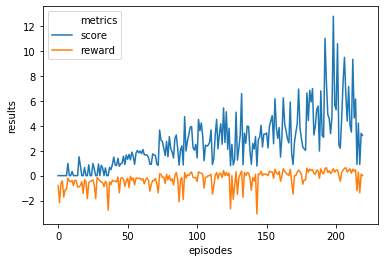

Max Train Score 23 Max Test Score 20
Mean Train Score 2.6822344136489575 Mean Test Score 5.5106085987331515
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 116       |
|    ep_rew_mean        | -36.5     |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.455    |
|    explained_variance | -5.28e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | 0.745     |
|    value_loss         | 17.8      |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85.1     |
|    ep_rew_mean 

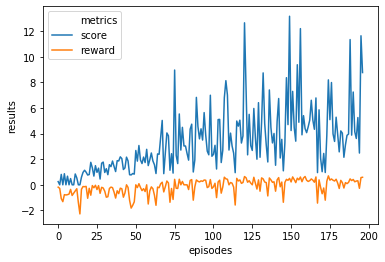

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 3261.1133824744365


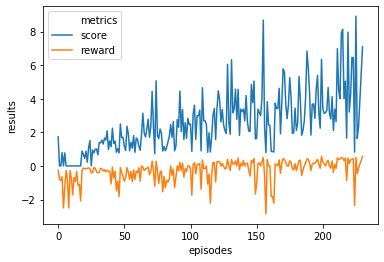

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
n_eval_episode 3261.1133824744365


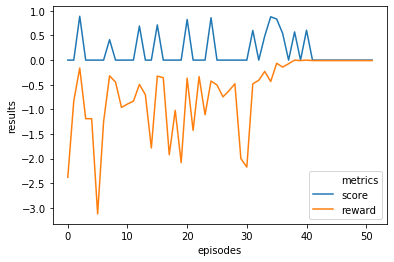

Max Train Score 1 Max Test Score 0
Mean Train Score 0.17174411787074875 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3261.1133824744365


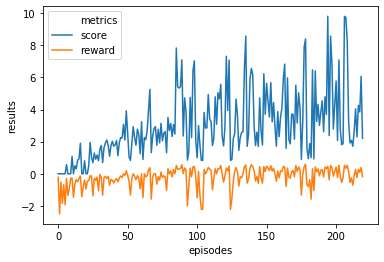

Max Train Score 18 Max Test Score 28
Mean Train Score 3.0038586715770275 Mean Test Score 4.647633119014444
----------------------------------------------------------------------------------------------------
n_eval_episode 3261.1133824744365


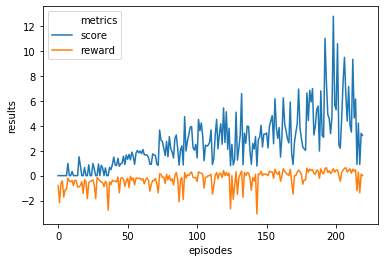

Max Train Score 23 Max Test Score 20
Mean Train Score 2.6822344136489575 Mean Test Score 5.5106085987331515
----------------------------------------------------------------------------------------------------
n_eval_episode 3261.1133824744365


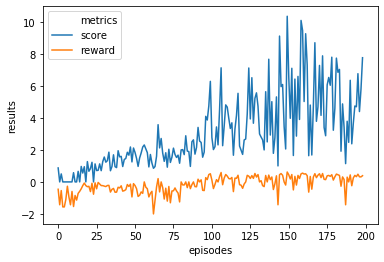

Max Train Score 19 Max Test Score 22
Mean Train Score 3.0311864135464734 Mean Test Score 5.237610642458735
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 189       |
|    ep_rew_mean        | -36.8     |
| time/                 |           |
|    fps                | 444       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.381    |
|    explained_variance | -0.0948   |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -0.000326 |
|    value_loss         | 0.000773  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 200       |
|    ep_rew_mea

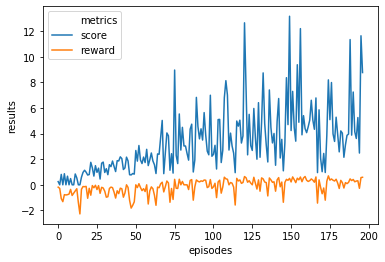

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 3109.7910515589992


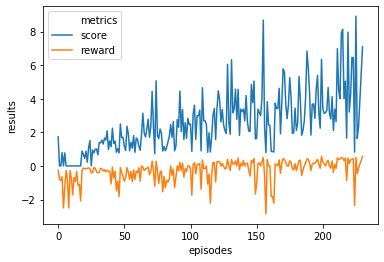

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
n_eval_episode 3109.7910515589992


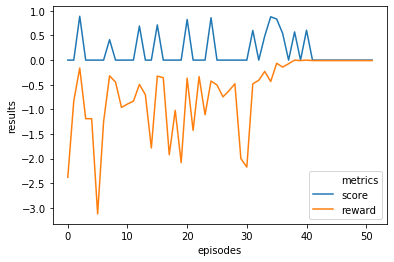

Max Train Score 1 Max Test Score 0
Mean Train Score 0.17174411787074875 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3109.7910515589992


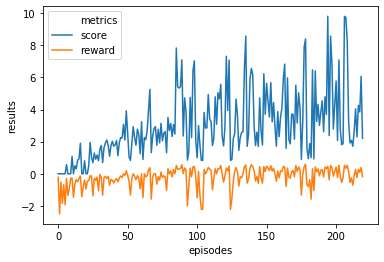

Max Train Score 18 Max Test Score 28
Mean Train Score 3.0038586715770275 Mean Test Score 4.647633119014444
----------------------------------------------------------------------------------------------------
n_eval_episode 3109.7910515589992


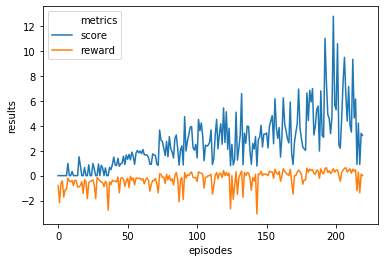

Max Train Score 23 Max Test Score 20
Mean Train Score 2.6822344136489575 Mean Test Score 5.5106085987331515
----------------------------------------------------------------------------------------------------
n_eval_episode 3109.7910515589992


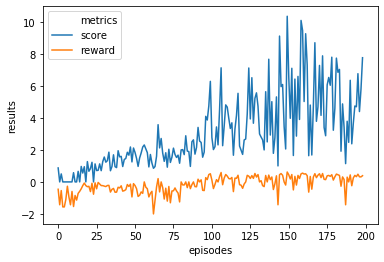

Max Train Score 19 Max Test Score 22
Mean Train Score 3.0311864135464734 Mean Test Score 5.237610642458735
----------------------------------------------------------------------------------------------------
n_eval_episode 3109.7910515589992


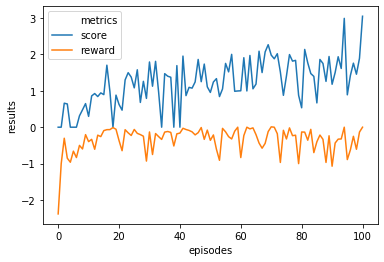

Max Train Score 5 Max Test Score 5
Mean Train Score 1.23617627418939 Mean Test Score 1.6874862896101714
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 190      |
|    ep_rew_mean        | -47.4    |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0191  |
|    explained_variance | -4.38    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 4.29e-06 |
|    value_loss         | 4.2e-06  |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 334       |
|    ep_rew_mean        | -40.7    

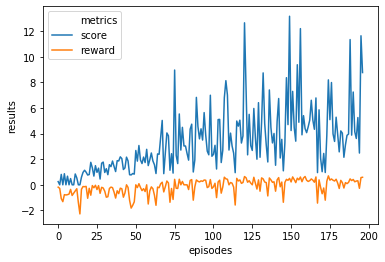

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 3089.5484459124914


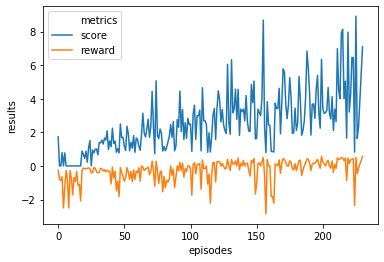

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
n_eval_episode 3089.5484459124914


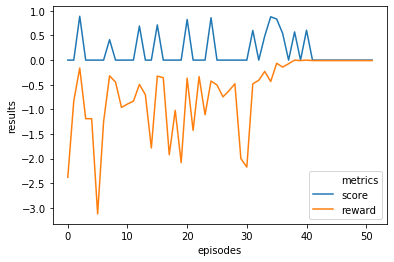

Max Train Score 1 Max Test Score 0
Mean Train Score 0.17174411787074875 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3089.5484459124914


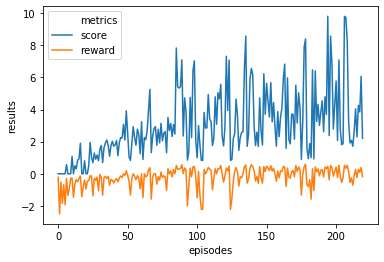

Max Train Score 18 Max Test Score 28
Mean Train Score 3.0038586715770275 Mean Test Score 4.647633119014444
----------------------------------------------------------------------------------------------------
n_eval_episode 3089.5484459124914


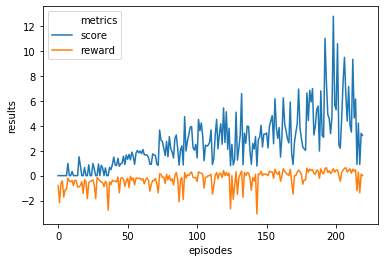

Max Train Score 23 Max Test Score 20
Mean Train Score 2.6822344136489575 Mean Test Score 5.5106085987331515
----------------------------------------------------------------------------------------------------
n_eval_episode 3089.5484459124914


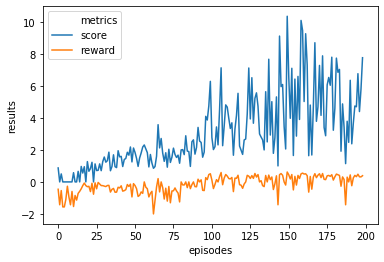

Max Train Score 19 Max Test Score 22
Mean Train Score 3.0311864135464734 Mean Test Score 5.237610642458735
----------------------------------------------------------------------------------------------------
n_eval_episode 3089.5484459124914


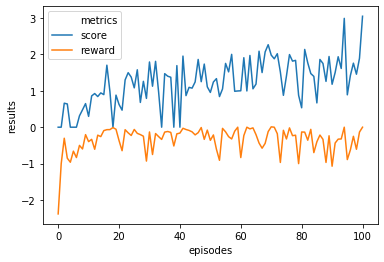

Max Train Score 5 Max Test Score 5
Mean Train Score 1.23617627418939 Mean Test Score 1.6874862896101714
----------------------------------------------------------------------------------------------------
n_eval_episode 3089.5484459124914


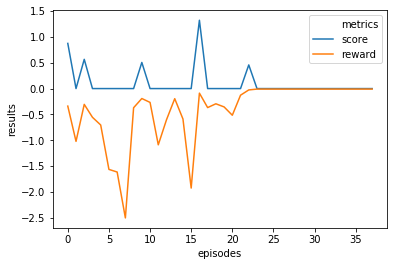

Max Train Score 2 Max Test Score 0
Mean Train Score 0.09789883045079525 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 191      |
|    ep_rew_mean        | -44.4    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.284   |
|    explained_variance | 0.0297   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 5.63e-05 |
|    value_loss         | 4.98e-05 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 231      |
|    ep_rew_mean        | -36.3    |
| time/      

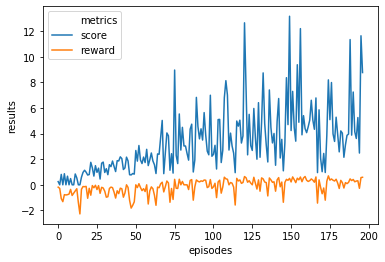

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 3042.434070291848


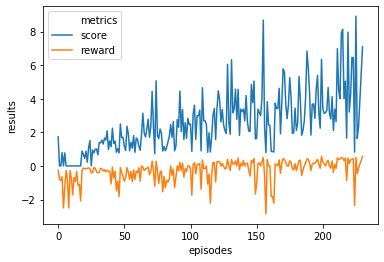

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
n_eval_episode 3042.434070291848


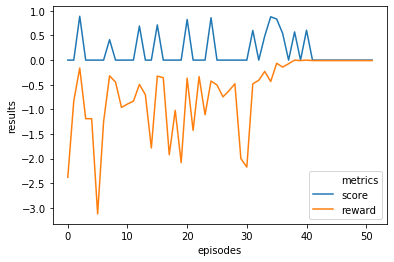

Max Train Score 1 Max Test Score 0
Mean Train Score 0.17174411787074875 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3042.434070291848


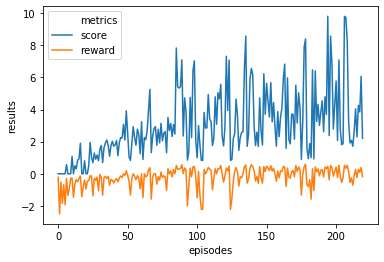

Max Train Score 18 Max Test Score 28
Mean Train Score 3.0038586715770275 Mean Test Score 4.647633119014444
----------------------------------------------------------------------------------------------------
n_eval_episode 3042.434070291848


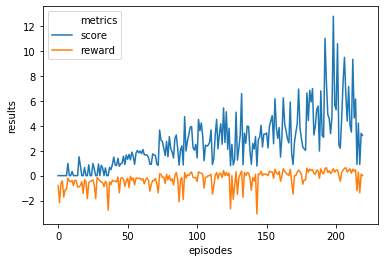

Max Train Score 23 Max Test Score 20
Mean Train Score 2.6822344136489575 Mean Test Score 5.5106085987331515
----------------------------------------------------------------------------------------------------
n_eval_episode 3042.434070291848


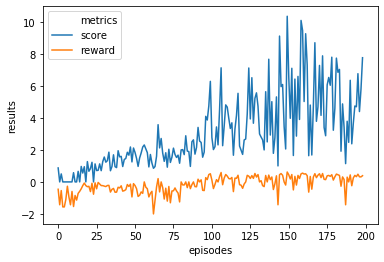

Max Train Score 19 Max Test Score 22
Mean Train Score 3.0311864135464734 Mean Test Score 5.237610642458735
----------------------------------------------------------------------------------------------------
n_eval_episode 3042.434070291848


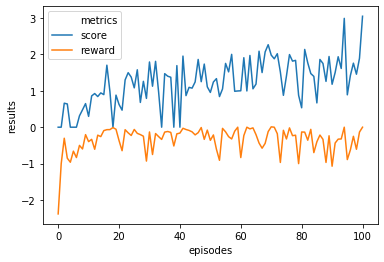

Max Train Score 5 Max Test Score 5
Mean Train Score 1.23617627418939 Mean Test Score 1.6874862896101714
----------------------------------------------------------------------------------------------------
n_eval_episode 3042.434070291848


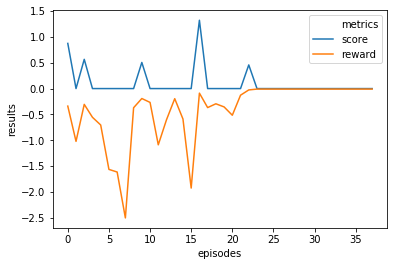

Max Train Score 2 Max Test Score 0
Mean Train Score 0.09789883045079525 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3042.434070291848


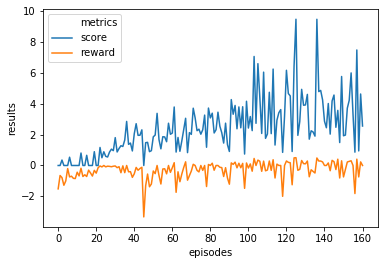

Max Train Score 19 Max Test Score 19
Mean Train Score 2.3955953179954874 Mean Test Score 3.5464872165777273
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 62.2     |
|    ep_rew_mean        | -29.8    |
| time/                 |          |
|    fps                | 404      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.132   |
|    explained_variance | -5.28    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.14     |
|    value_loss         | 29.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.1     |
|    ep_rew_mean        | 0.8     

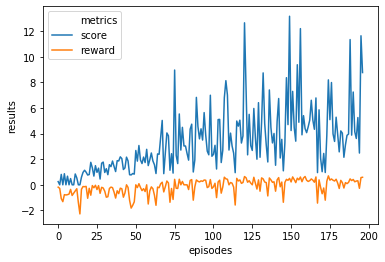

Max Train Score 27 Max Test Score 25
Mean Train Score 3.342080552422855 Mean Test Score 5.576578312116182
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


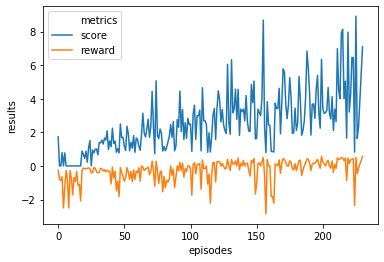

Max Train Score 18 Max Test Score 22
Mean Train Score 2.583468149373853 Mean Test Score 5.105127292179487
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


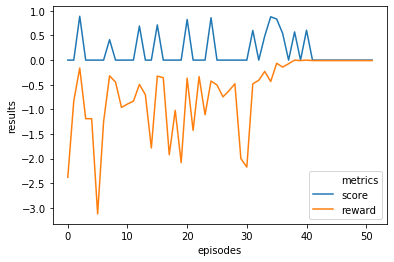

Max Train Score 1 Max Test Score 0
Mean Train Score 0.17174411787074875 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


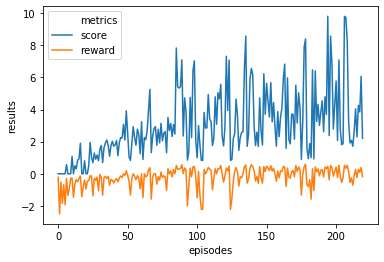

Max Train Score 18 Max Test Score 28
Mean Train Score 3.0038586715770275 Mean Test Score 4.647633119014444
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


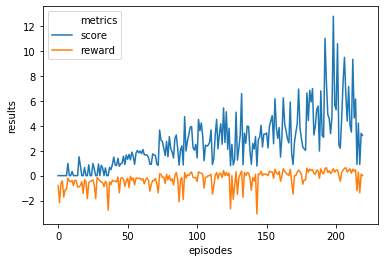

Max Train Score 23 Max Test Score 20
Mean Train Score 2.6822344136489575 Mean Test Score 5.5106085987331515
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


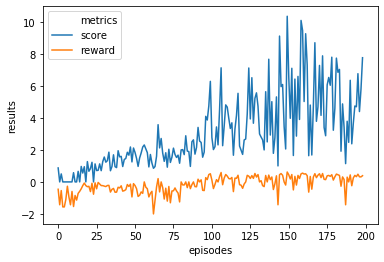

Max Train Score 19 Max Test Score 22
Mean Train Score 3.0311864135464734 Mean Test Score 5.237610642458735
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


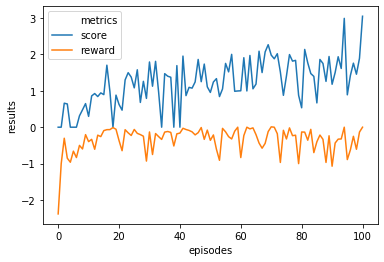

Max Train Score 5 Max Test Score 5
Mean Train Score 1.23617627418939 Mean Test Score 1.6874862896101714
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


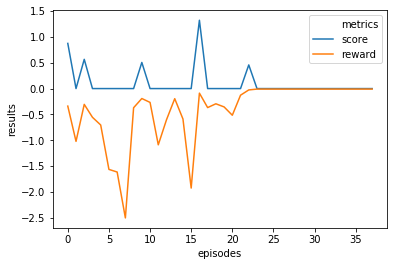

Max Train Score 2 Max Test Score 0
Mean Train Score 0.09789883045079525 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


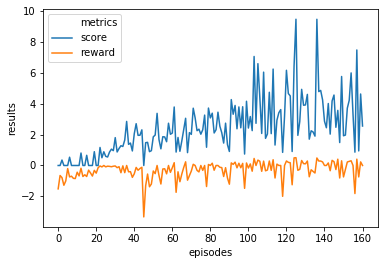

Max Train Score 19 Max Test Score 19
Mean Train Score 2.3955953179954874 Mean Test Score 3.5464872165777273
----------------------------------------------------------------------------------------------------
n_eval_episode 3417.9633639492254


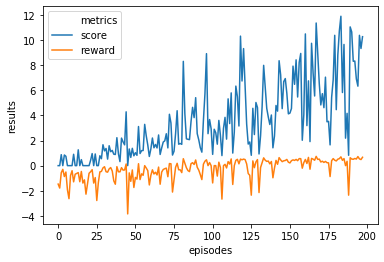

Max Train Score 24 Max Test Score 35
Mean Train Score 3.5373680927779105 Mean Test Score 7.6686618932596735
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


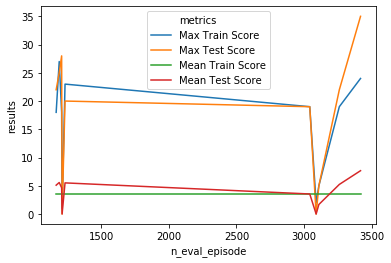

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 156      |
|    ep_rew_mean        | -37.8    |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.615   |
|    explained_variance | -0.018   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0102  |
|    value_loss         | 0.00382  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89.2     |
|    ep_rew_mean        | -20.2    |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 2000 

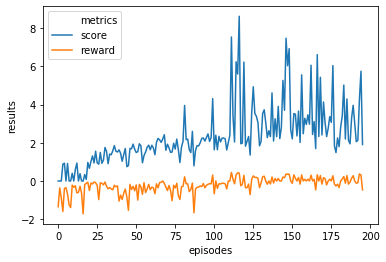

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95       |
|    ep_rew_mean        | -33.5    |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.586   |
|    explained_variance | 0.649    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0129  |
|    value_loss         | 0.00128  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85.3     |
|    ep_rew_mean        | -10.4    

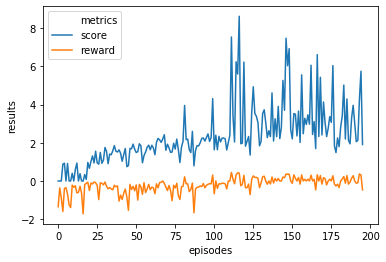

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 1080.7645165016474


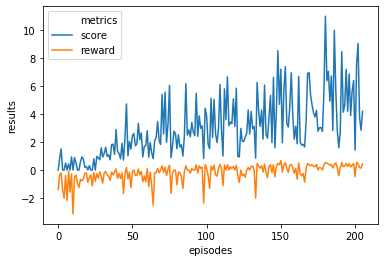

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 97.9      |
|    ep_rew_mean        | -35.9     |
| time/                 |           |
|    fps                | 402       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.417    |
|    explained_variance | -6.81e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -8.56     |
|    value_loss         | 991       |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.2     |
|    ep_rew_mean  

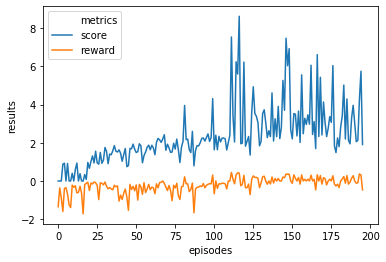

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 1083.8251394422518


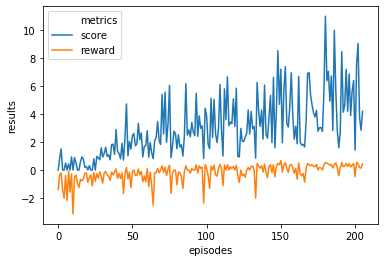

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
n_eval_episode 1083.8251394422518


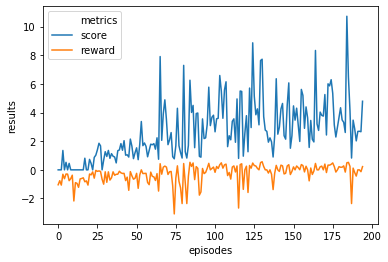

Max Train Score 23 Max Test Score 17
Mean Train Score 2.6934779739737515 Mean Test Score 4.465407556542797
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.6     |
|    ep_rew_mean        | -32.9    |
| time/                 |          |
|    fps                | 405      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.354   |
|    explained_variance | -0.0619  |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -1.92    |
|    value_loss         | 2.24     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 78.2     |
|    ep_rew_mean        | -7.5     

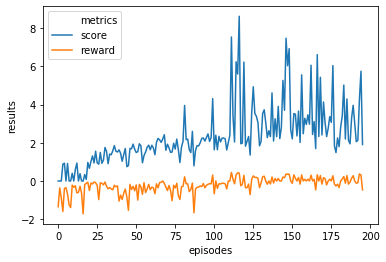

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 1012.104270721325


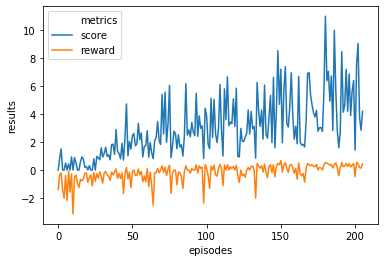

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
n_eval_episode 1012.104270721325


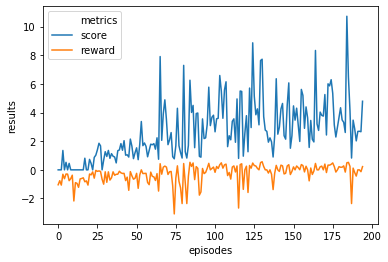

Max Train Score 23 Max Test Score 17
Mean Train Score 2.6934779739737515 Mean Test Score 4.465407556542797
----------------------------------------------------------------------------------------------------
n_eval_episode 1012.104270721325


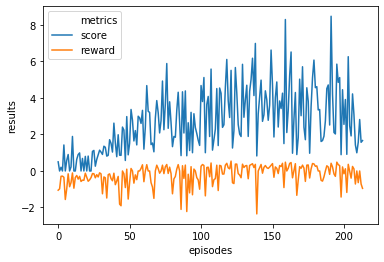

Max Train Score 17 Max Test Score 15
Mean Train Score 2.6918295622893504 Mean Test Score 3.092315248543609
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.2     |
|    ep_rew_mean        | -36.2    |
| time/                 |          |
|    fps                | 387      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.725   |
|    explained_variance | -1.15    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00766 |
|    value_loss         | 0.000543 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 81.8      |
|    ep_rew_mean        | -19.7 

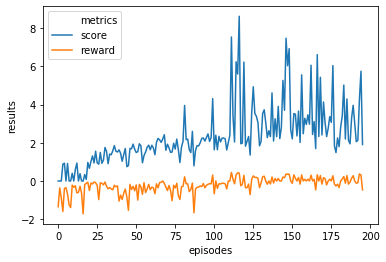

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 1047.4622772334412


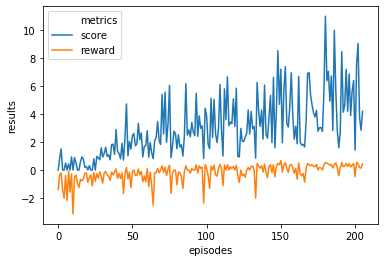

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
n_eval_episode 1047.4622772334412


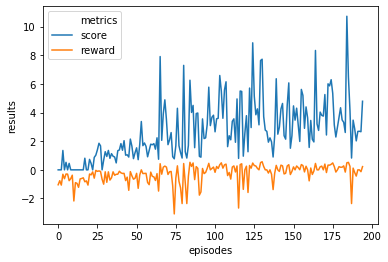

Max Train Score 23 Max Test Score 17
Mean Train Score 2.6934779739737515 Mean Test Score 4.465407556542797
----------------------------------------------------------------------------------------------------
n_eval_episode 1047.4622772334412


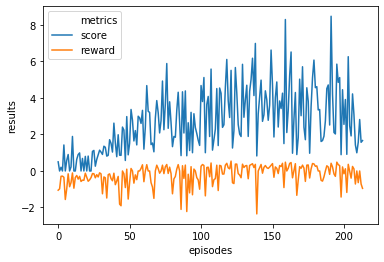

Max Train Score 17 Max Test Score 15
Mean Train Score 2.6918295622893504 Mean Test Score 3.092315248543609
----------------------------------------------------------------------------------------------------
n_eval_episode 1047.4622772334412


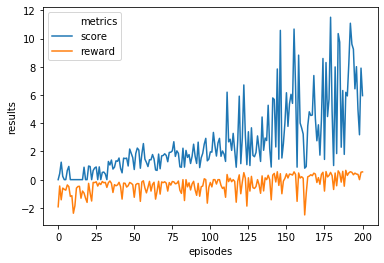

Max Train Score 23 Max Test Score 24
Mean Train Score 2.715285791501699 Mean Test Score 5.034648121133483
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85.7     |
|    ep_rew_mean        | -39      |
| time/                 |          |
|    fps                | 383      |
|    iterations         | 1000     |
|    time_elapsed       | 13       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.683   |
|    explained_variance | -2.1e+03 |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 1.95     |
|    value_loss         | 70.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 72.6     |
|    ep_rew_mean        | -10.6    |

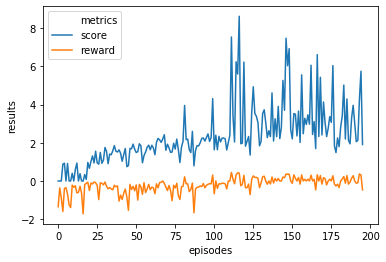

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 3088.251697368064


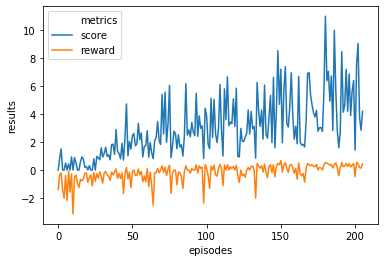

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
n_eval_episode 3088.251697368064


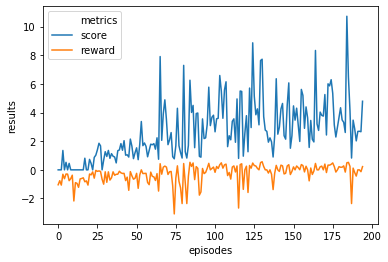

Max Train Score 23 Max Test Score 17
Mean Train Score 2.6934779739737515 Mean Test Score 4.465407556542797
----------------------------------------------------------------------------------------------------
n_eval_episode 3088.251697368064


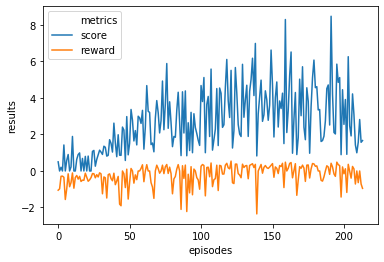

Max Train Score 17 Max Test Score 15
Mean Train Score 2.6918295622893504 Mean Test Score 3.092315248543609
----------------------------------------------------------------------------------------------------
n_eval_episode 3088.251697368064


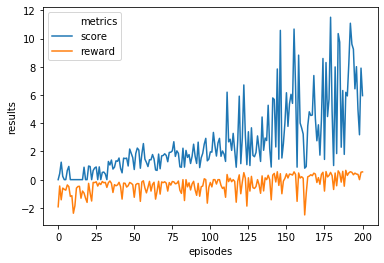

Max Train Score 23 Max Test Score 24
Mean Train Score 2.715285791501699 Mean Test Score 5.034648121133483
----------------------------------------------------------------------------------------------------
n_eval_episode 3088.251697368064


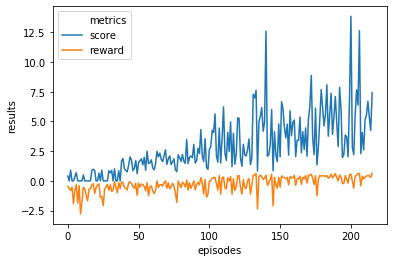

Max Train Score 28 Max Test Score 27
Mean Train Score 2.8947725597041374 Mean Test Score 6.7989431139001
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 253      |
|    ep_rew_mean        | -43.1    |
| time/                 |          |
|    fps                | 454      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0828  |
|    explained_variance | 0.0415   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 1.75e-10 |
|    value_loss         | 1.51e-16 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 431      |
|    ep_rew_mean        | -35.2    |


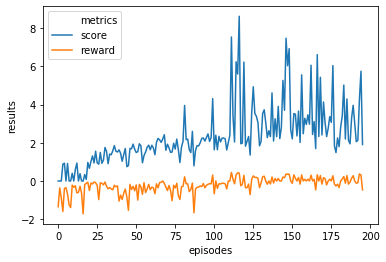

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.836274754953


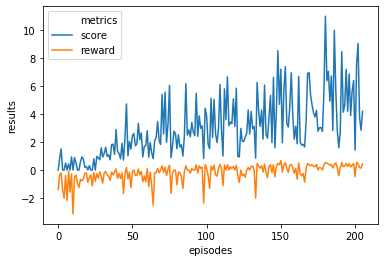

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.836274754953


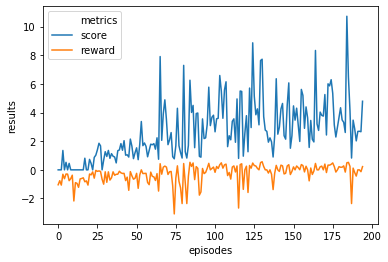

Max Train Score 23 Max Test Score 17
Mean Train Score 2.6934779739737515 Mean Test Score 4.465407556542797
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.836274754953


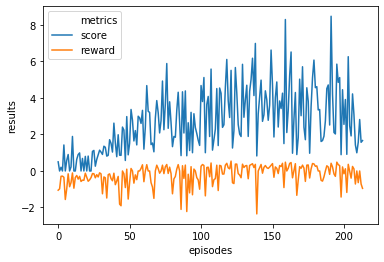

Max Train Score 17 Max Test Score 15
Mean Train Score 2.6918295622893504 Mean Test Score 3.092315248543609
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.836274754953


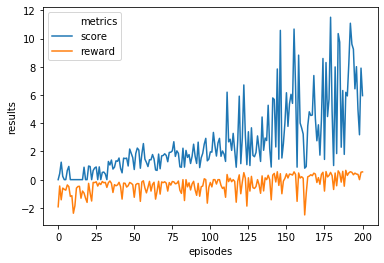

Max Train Score 23 Max Test Score 24
Mean Train Score 2.715285791501699 Mean Test Score 5.034648121133483
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.836274754953


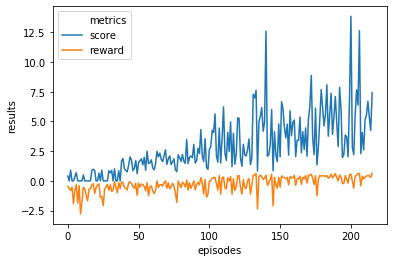

Max Train Score 28 Max Test Score 27
Mean Train Score 2.8947725597041374 Mean Test Score 6.7989431139001
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.836274754953


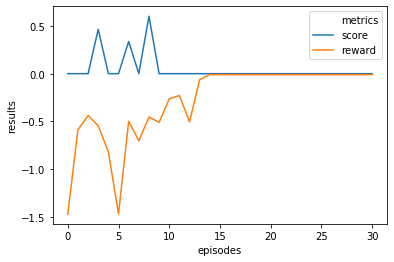

Max Train Score 1 Max Test Score 0
Mean Train Score 0.045339553288072945 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 73.4     |
|    ep_rew_mean        | -28.7    |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.134   |
|    explained_variance | 0.979    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00602 |
|    value_loss         | 0.478    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 69.9     |
|    ep_rew_mean        | -2.1     |
| time/     

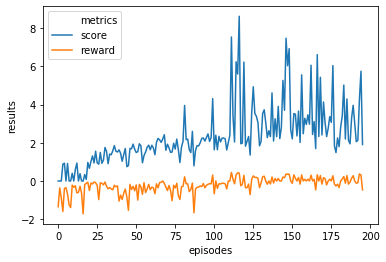

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 3357.952458634492


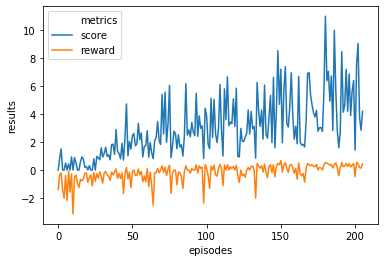

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
n_eval_episode 3357.952458634492


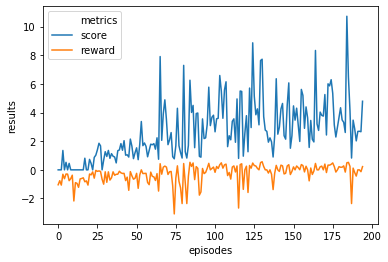

Max Train Score 23 Max Test Score 17
Mean Train Score 2.6934779739737515 Mean Test Score 4.465407556542797
----------------------------------------------------------------------------------------------------
n_eval_episode 3357.952458634492


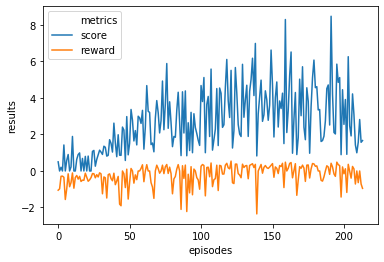

Max Train Score 17 Max Test Score 15
Mean Train Score 2.6918295622893504 Mean Test Score 3.092315248543609
----------------------------------------------------------------------------------------------------
n_eval_episode 3357.952458634492


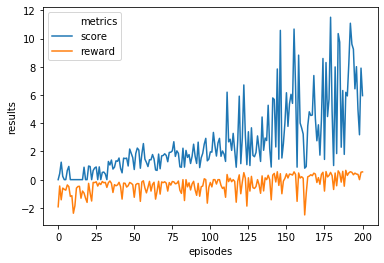

Max Train Score 23 Max Test Score 24
Mean Train Score 2.715285791501699 Mean Test Score 5.034648121133483
----------------------------------------------------------------------------------------------------
n_eval_episode 3357.952458634492


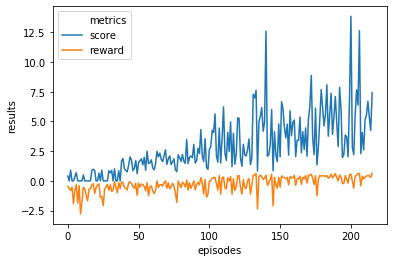

Max Train Score 28 Max Test Score 27
Mean Train Score 2.8947725597041374 Mean Test Score 6.7989431139001
----------------------------------------------------------------------------------------------------
n_eval_episode 3357.952458634492


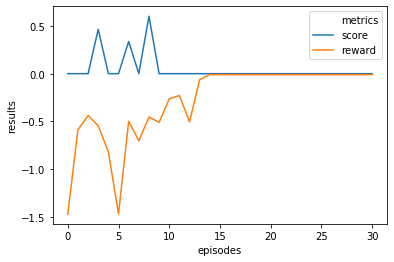

Max Train Score 1 Max Test Score 0
Mean Train Score 0.045339553288072945 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3357.952458634492


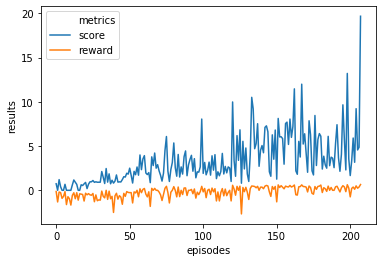

Max Train Score 43 Max Test Score 29
Mean Train Score 3.317304628900143 Mean Test Score 6.630167959179508
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 68.4      |
|    ep_rew_mean        | -32.5     |
| time/                 |           |
|    fps                | 367       |
|    iterations         | 1000      |
|    time_elapsed       | 13        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.43     |
|    explained_variance | -5.34e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -20.1     |
|    value_loss         | 1.44e+03  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.9     |
|    ep_rew_mean   

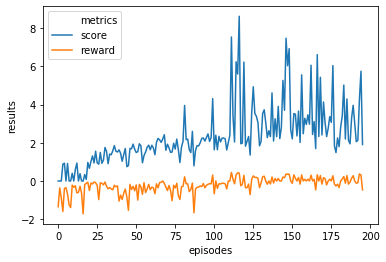

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 3354.60903960637


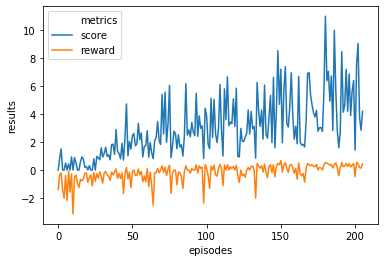

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
n_eval_episode 3354.60903960637


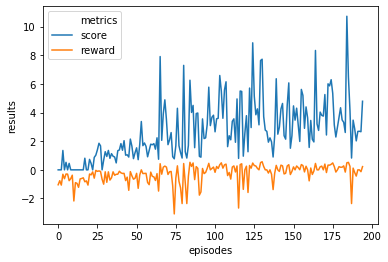

Max Train Score 23 Max Test Score 17
Mean Train Score 2.6934779739737515 Mean Test Score 4.465407556542797
----------------------------------------------------------------------------------------------------
n_eval_episode 3354.60903960637


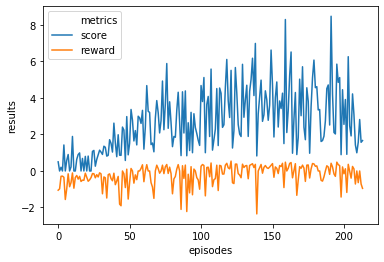

Max Train Score 17 Max Test Score 15
Mean Train Score 2.6918295622893504 Mean Test Score 3.092315248543609
----------------------------------------------------------------------------------------------------
n_eval_episode 3354.60903960637


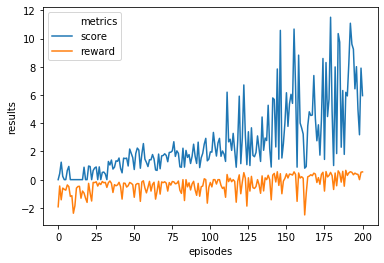

Max Train Score 23 Max Test Score 24
Mean Train Score 2.715285791501699 Mean Test Score 5.034648121133483
----------------------------------------------------------------------------------------------------
n_eval_episode 3354.60903960637


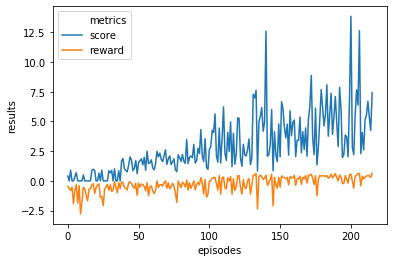

Max Train Score 28 Max Test Score 27
Mean Train Score 2.8947725597041374 Mean Test Score 6.7989431139001
----------------------------------------------------------------------------------------------------
n_eval_episode 3354.60903960637


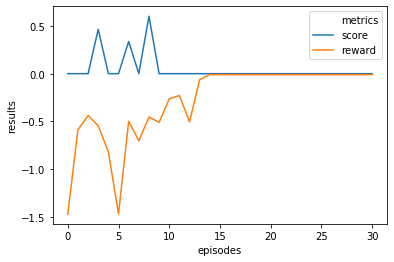

Max Train Score 1 Max Test Score 0
Mean Train Score 0.045339553288072945 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3354.60903960637


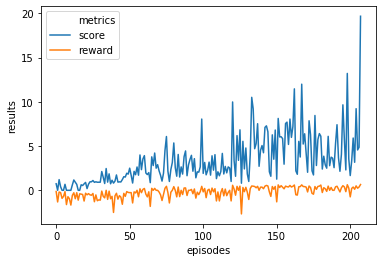

Max Train Score 43 Max Test Score 29
Mean Train Score 3.317304628900143 Mean Test Score 6.630167959179508
----------------------------------------------------------------------------------------------------
n_eval_episode 3354.60903960637


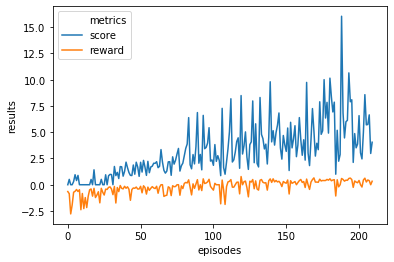

Max Train Score 31 Max Test Score 33
Mean Train Score 3.229631415829329 Mean Test Score 6.560500281636485
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 118       |
|    ep_rew_mean        | -43.9     |
| time/                 |           |
|    fps                | 429       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.233    |
|    explained_variance | -0.315    |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -0.000543 |
|    value_loss         | 9.42e-05  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99       |
|    ep_rew_mean   

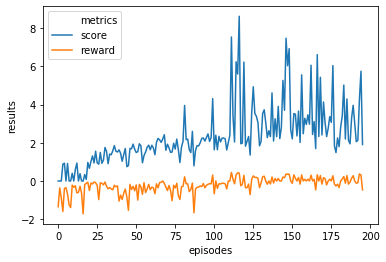

Max Train Score 15 Max Test Score 18
Mean Train Score 2.3409589395464967 Mean Test Score 3.459352675493239
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


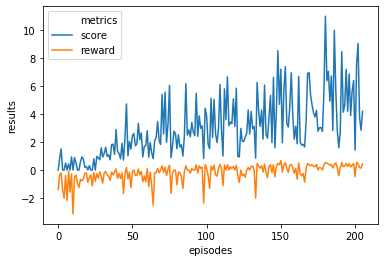

Max Train Score 21 Max Test Score 21
Mean Train Score 2.9859444277440983 Mean Test Score 5.867319549960362
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


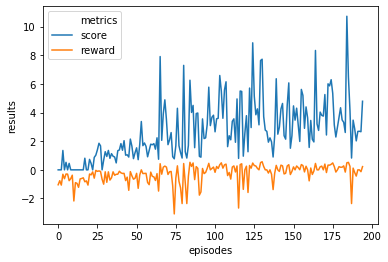

Max Train Score 23 Max Test Score 17
Mean Train Score 2.6934779739737515 Mean Test Score 4.465407556542797
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


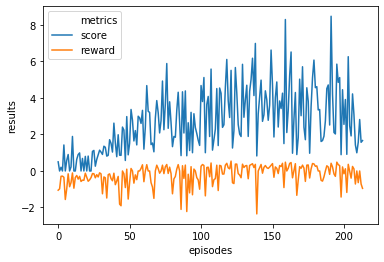

Max Train Score 17 Max Test Score 15
Mean Train Score 2.6918295622893504 Mean Test Score 3.092315248543609
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


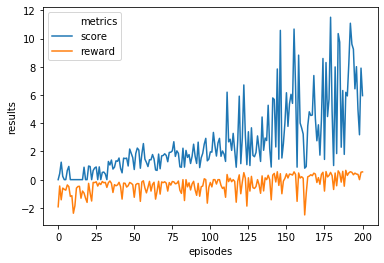

Max Train Score 23 Max Test Score 24
Mean Train Score 2.715285791501699 Mean Test Score 5.034648121133483
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


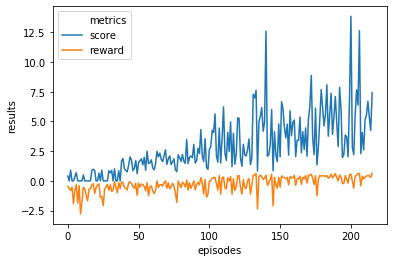

Max Train Score 28 Max Test Score 27
Mean Train Score 2.8947725597041374 Mean Test Score 6.7989431139001
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


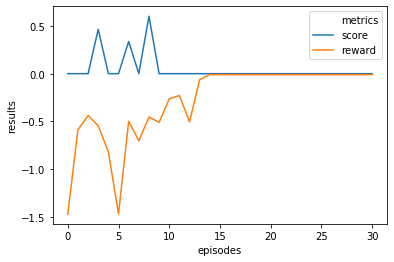

Max Train Score 1 Max Test Score 0
Mean Train Score 0.045339553288072945 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


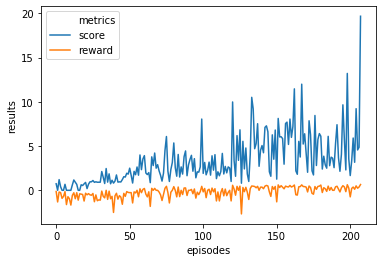

Max Train Score 43 Max Test Score 29
Mean Train Score 3.317304628900143 Mean Test Score 6.630167959179508
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


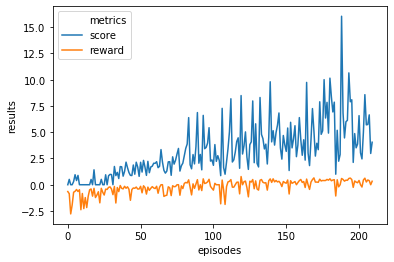

Max Train Score 31 Max Test Score 33
Mean Train Score 3.229631415829329 Mean Test Score 6.560500281636485
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.760592736563


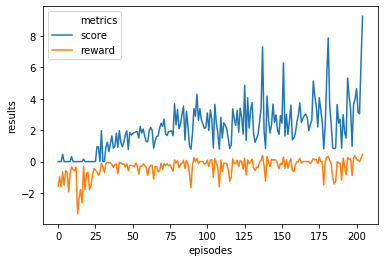

Max Train Score 19 Max Test Score 13
Mean Train Score 2.104054961057933 Mean Test Score 3.5549842175399284
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


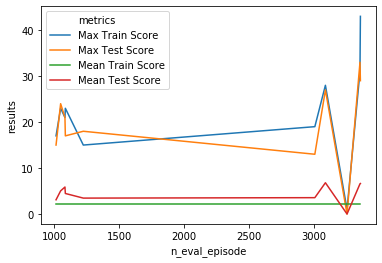

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79.6     |
|    ep_rew_mean        | -38.1    |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.543   |
|    explained_variance | -10.9    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0366   |
|    value_loss         | 23.3     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70.6     |
|    ep_rew_mean        | -10.4    |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 2000 

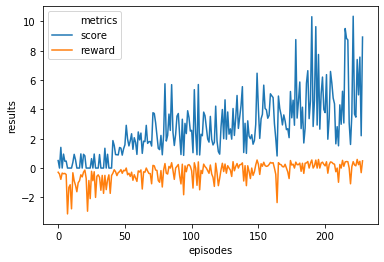

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 217       |
|    ep_rew_mean        | -43.6     |
| time/                 |           |
|    fps                | 452       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.266    |
|    explained_variance | -1.06e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -0.0529   |
|    value_loss         | 0.00863   |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 159      |
|    ep_rew_mean   

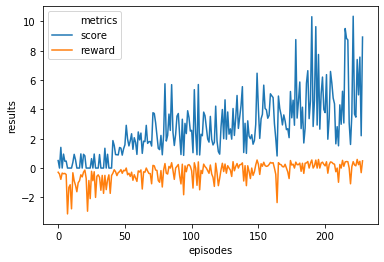

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 1071.4980810669285


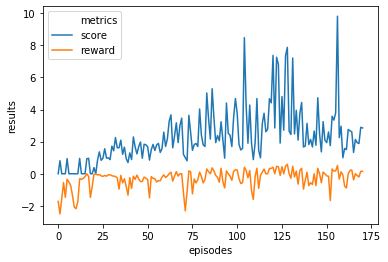

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86       |
|    ep_rew_mean        | -30.9    |
| time/                 |          |
|    fps                | 440      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.331   |
|    explained_variance | -220     |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.185    |
|    value_loss         | 17.8     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.8     |
|    ep_rew_mean        | -12.7    |

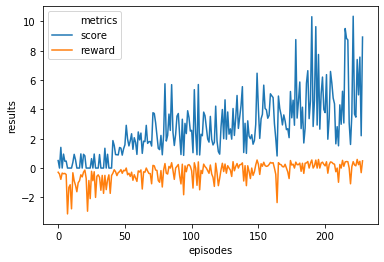

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 1239.861841073639


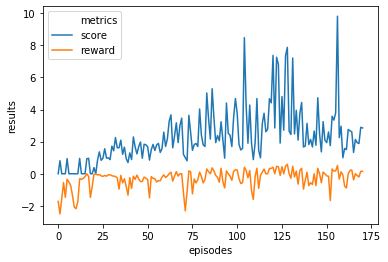

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
n_eval_episode 1239.861841073639


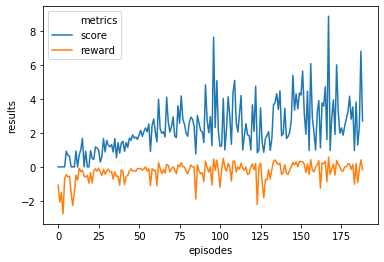

Max Train Score 18 Max Test Score 18
Mean Train Score 2.269361259953778 Mean Test Score 3.7414661477482234
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.7     |
|    ep_rew_mean        | -32      |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.205   |
|    explained_variance | -5.92    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0184   |
|    value_loss         | 10.2     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 71.5     |
|    ep_rew_mean        | -12.6    

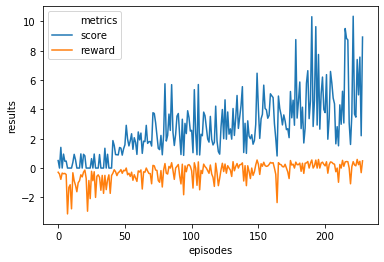

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 1239.6056419257552


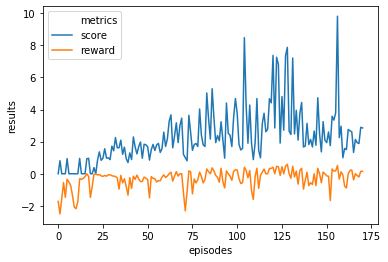

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
n_eval_episode 1239.6056419257552


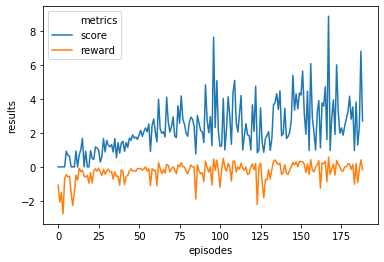

Max Train Score 18 Max Test Score 18
Mean Train Score 2.269361259953778 Mean Test Score 3.7414661477482234
----------------------------------------------------------------------------------------------------
n_eval_episode 1239.6056419257552


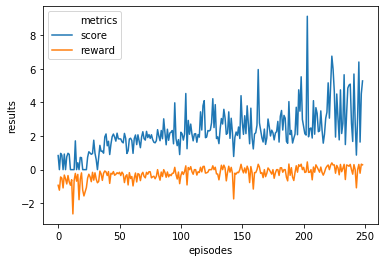

Max Train Score 19 Max Test Score 17
Mean Train Score 2.2597999641880433 Mean Test Score 3.5318512965397004
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 113      |
|    ep_rew_mean        | -43.5    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.98    |
|    explained_variance | -0.027   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.048    |
|    value_loss         | 0.00634  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 96.5     |
|    ep_rew_mean        | -18.3   

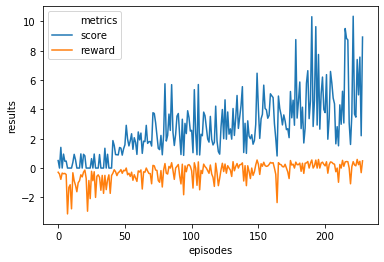

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 1099.2351653483931


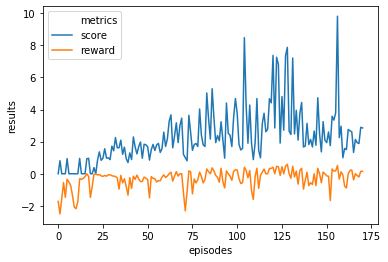

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
n_eval_episode 1099.2351653483931


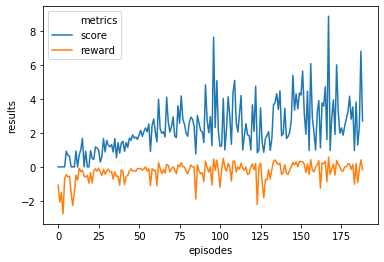

Max Train Score 18 Max Test Score 18
Mean Train Score 2.269361259953778 Mean Test Score 3.7414661477482234
----------------------------------------------------------------------------------------------------
n_eval_episode 1099.2351653483931


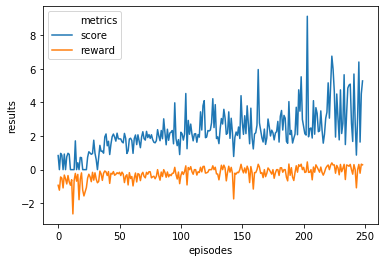

Max Train Score 19 Max Test Score 17
Mean Train Score 2.2597999641880433 Mean Test Score 3.5318512965397004
----------------------------------------------------------------------------------------------------
n_eval_episode 1099.2351653483931


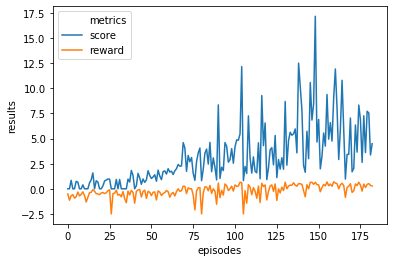

Max Train Score 36 Max Test Score 29
Mean Train Score 3.139398519594281 Mean Test Score 7.118689472204748
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 78.6     |
|    ep_rew_mean        | -37.8    |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.789   |
|    explained_variance | -1.16    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 6.5e-05  |
|    value_loss         | 0.00164  |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 84.4      |
|    ep_rew_mean        | -26    

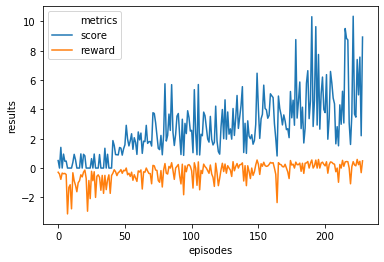

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.9614415641163


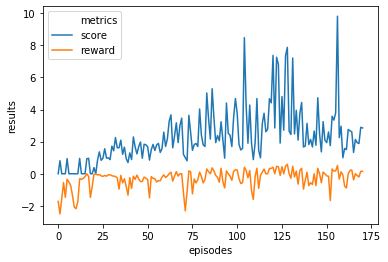

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.9614415641163


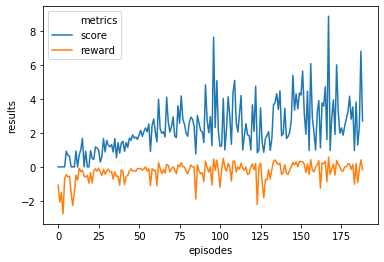

Max Train Score 18 Max Test Score 18
Mean Train Score 2.269361259953778 Mean Test Score 3.7414661477482234
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.9614415641163


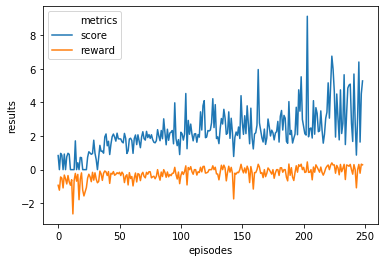

Max Train Score 19 Max Test Score 17
Mean Train Score 2.2597999641880433 Mean Test Score 3.5318512965397004
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.9614415641163


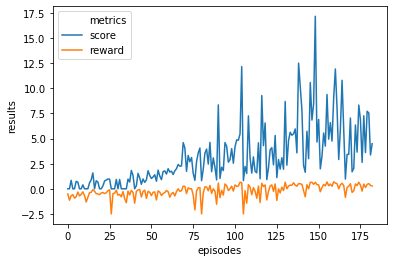

Max Train Score 36 Max Test Score 29
Mean Train Score 3.139398519594281 Mean Test Score 7.118689472204748
----------------------------------------------------------------------------------------------------
n_eval_episode 3006.9614415641163


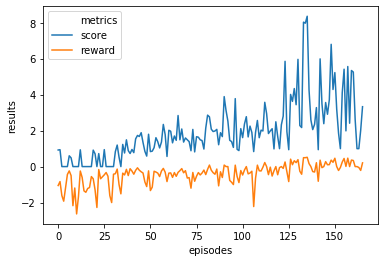

Max Train Score 17 Max Test Score 12
Mean Train Score 1.9291926970092663 Mean Test Score 3.136368578423463
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 136      |
|    ep_rew_mean        | -42.8    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.851   |
|    explained_variance | 0.279    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0249   |
|    value_loss         | 0.00104  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 98.6     |
|    ep_rew_mean        | -19.7    

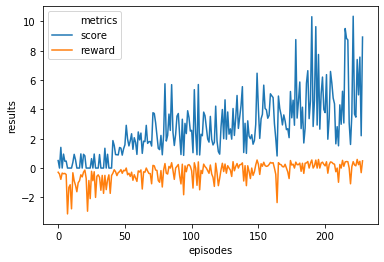

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 3336.1190137735725


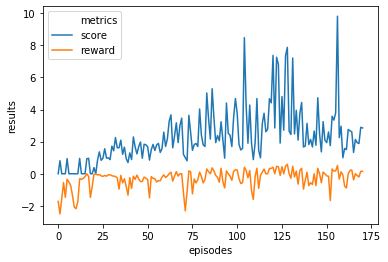

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
n_eval_episode 3336.1190137735725


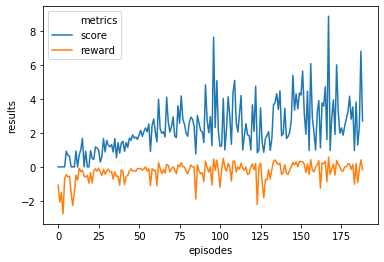

Max Train Score 18 Max Test Score 18
Mean Train Score 2.269361259953778 Mean Test Score 3.7414661477482234
----------------------------------------------------------------------------------------------------
n_eval_episode 3336.1190137735725


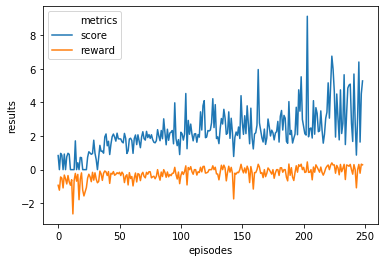

Max Train Score 19 Max Test Score 17
Mean Train Score 2.2597999641880433 Mean Test Score 3.5318512965397004
----------------------------------------------------------------------------------------------------
n_eval_episode 3336.1190137735725


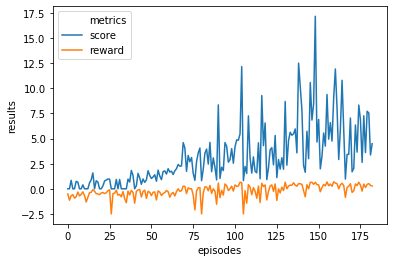

Max Train Score 36 Max Test Score 29
Mean Train Score 3.139398519594281 Mean Test Score 7.118689472204748
----------------------------------------------------------------------------------------------------
n_eval_episode 3336.1190137735725


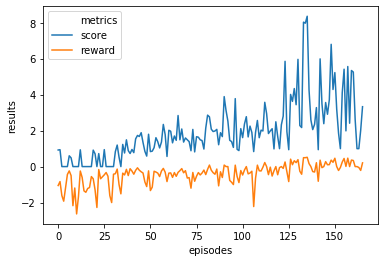

Max Train Score 17 Max Test Score 12
Mean Train Score 1.9291926970092663 Mean Test Score 3.136368578423463
----------------------------------------------------------------------------------------------------
n_eval_episode 3336.1190137735725


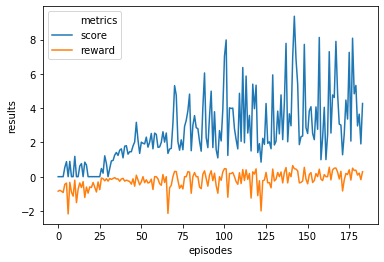

Max Train Score 17 Max Test Score 18
Mean Train Score 2.6386455665444903 Mean Test Score 4.435852334152385
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 71.4     |
|    ep_rew_mean        | -34.3    |
| time/                 |          |
|    fps                | 401      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.824   |
|    explained_variance | -46.3    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -55.2    |
|    value_loss         | 2.3e+03  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70       |
|    ep_rew_mean        | -11.2    

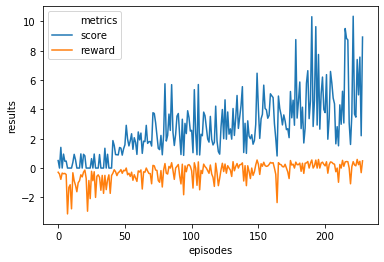

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 3005.609620291315


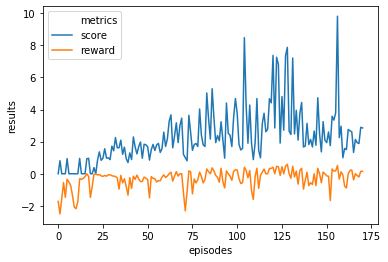

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
n_eval_episode 3005.609620291315


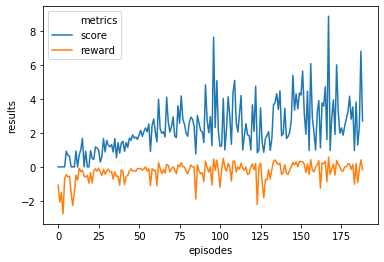

Max Train Score 18 Max Test Score 18
Mean Train Score 2.269361259953778 Mean Test Score 3.7414661477482234
----------------------------------------------------------------------------------------------------
n_eval_episode 3005.609620291315


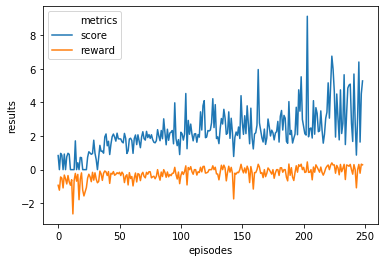

Max Train Score 19 Max Test Score 17
Mean Train Score 2.2597999641880433 Mean Test Score 3.5318512965397004
----------------------------------------------------------------------------------------------------
n_eval_episode 3005.609620291315


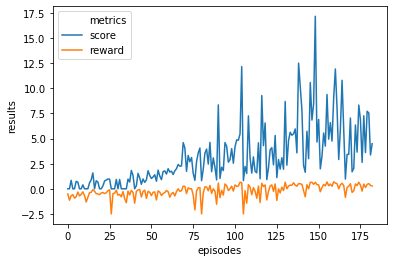

Max Train Score 36 Max Test Score 29
Mean Train Score 3.139398519594281 Mean Test Score 7.118689472204748
----------------------------------------------------------------------------------------------------
n_eval_episode 3005.609620291315


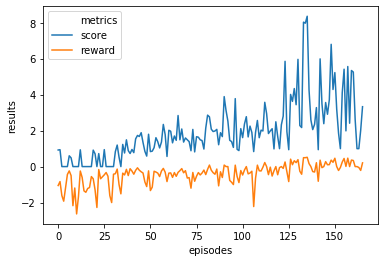

Max Train Score 17 Max Test Score 12
Mean Train Score 1.9291926970092663 Mean Test Score 3.136368578423463
----------------------------------------------------------------------------------------------------
n_eval_episode 3005.609620291315


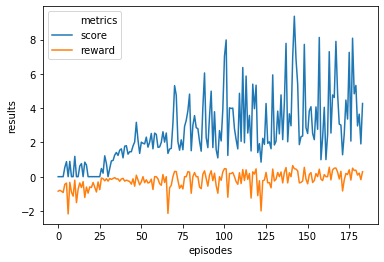

Max Train Score 17 Max Test Score 18
Mean Train Score 2.6386455665444903 Mean Test Score 4.435852334152385
----------------------------------------------------------------------------------------------------
n_eval_episode 3005.609620291315


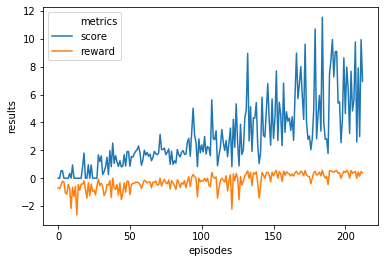

Max Train Score 23 Max Test Score 25
Mean Train Score 2.983847925255096 Mean Test Score 5.681800249789588
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 82.5      |
|    ep_rew_mean        | -38       |
| time/                 |           |
|    fps                | 435       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.632    |
|    explained_variance | -1.43e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | 2.11      |
|    value_loss         | 57.7      |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 65.4     |
|    ep_rew_mean   

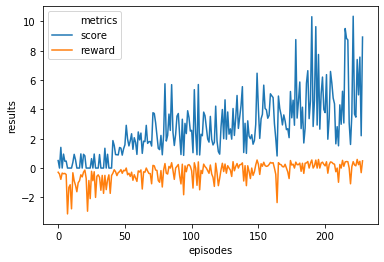

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 3332.683808244383


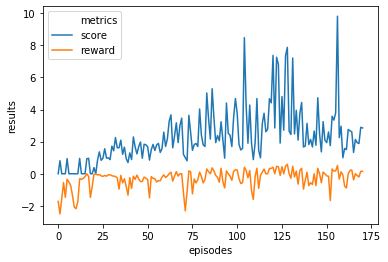

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
n_eval_episode 3332.683808244383


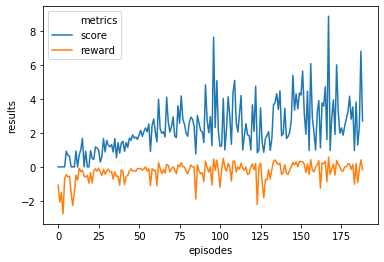

Max Train Score 18 Max Test Score 18
Mean Train Score 2.269361259953778 Mean Test Score 3.7414661477482234
----------------------------------------------------------------------------------------------------
n_eval_episode 3332.683808244383


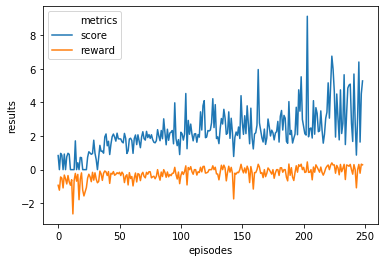

Max Train Score 19 Max Test Score 17
Mean Train Score 2.2597999641880433 Mean Test Score 3.5318512965397004
----------------------------------------------------------------------------------------------------
n_eval_episode 3332.683808244383


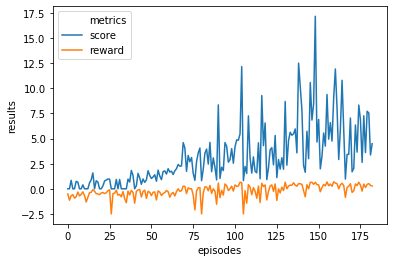

Max Train Score 36 Max Test Score 29
Mean Train Score 3.139398519594281 Mean Test Score 7.118689472204748
----------------------------------------------------------------------------------------------------
n_eval_episode 3332.683808244383


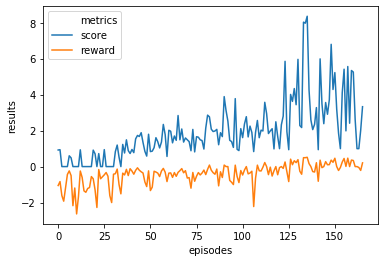

Max Train Score 17 Max Test Score 12
Mean Train Score 1.9291926970092663 Mean Test Score 3.136368578423463
----------------------------------------------------------------------------------------------------
n_eval_episode 3332.683808244383


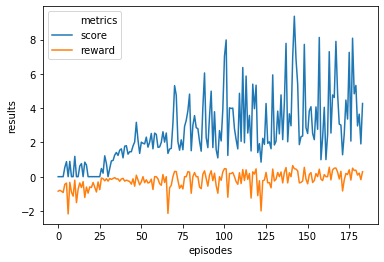

Max Train Score 17 Max Test Score 18
Mean Train Score 2.6386455665444903 Mean Test Score 4.435852334152385
----------------------------------------------------------------------------------------------------
n_eval_episode 3332.683808244383


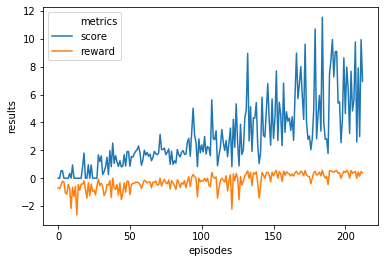

Max Train Score 23 Max Test Score 25
Mean Train Score 2.983847925255096 Mean Test Score 5.681800249789588
----------------------------------------------------------------------------------------------------
n_eval_episode 3332.683808244383


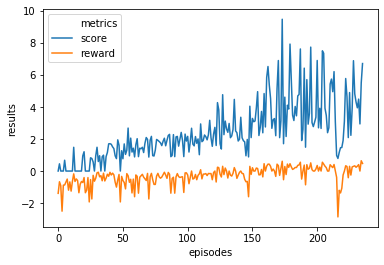

Max Train Score 18 Max Test Score 25
Mean Train Score 2.4194368025339563 Mean Test Score 4.752378764171612
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.8     |
|    ep_rew_mean        | -36.1    |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.635   |
|    explained_variance | -0.338   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0924  |
|    value_loss         | 0.014    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79.1     |
|    ep_rew_mean        | -16.9    

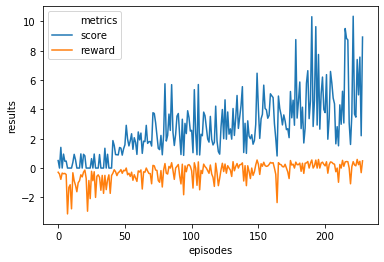

Max Train Score 19 Max Test Score 23
Mean Train Score 2.769495705715005 Mean Test Score 4.443704770337317
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


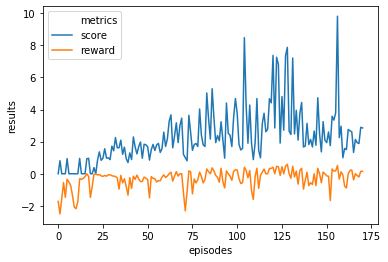

Max Train Score 19 Max Test Score 14
Mean Train Score 2.284853677060311 Mean Test Score 3.178848686299948
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


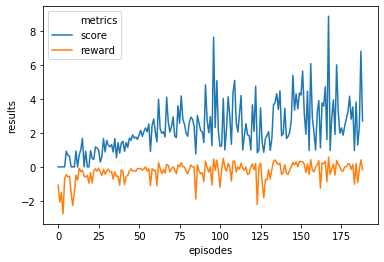

Max Train Score 18 Max Test Score 18
Mean Train Score 2.269361259953778 Mean Test Score 3.7414661477482234
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


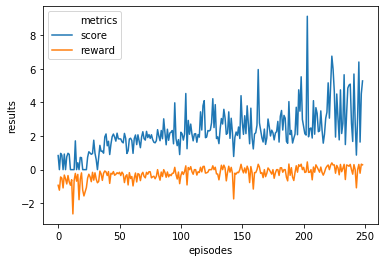

Max Train Score 19 Max Test Score 17
Mean Train Score 2.2597999641880433 Mean Test Score 3.5318512965397004
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


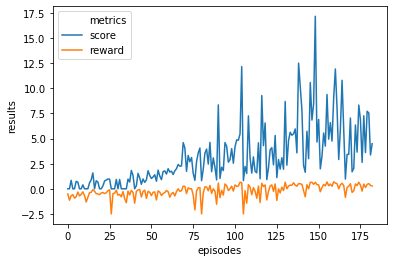

Max Train Score 36 Max Test Score 29
Mean Train Score 3.139398519594281 Mean Test Score 7.118689472204748
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


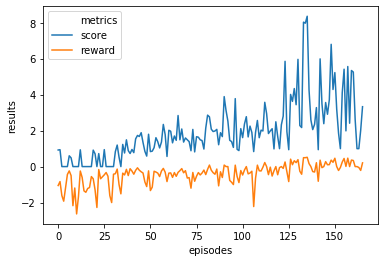

Max Train Score 17 Max Test Score 12
Mean Train Score 1.9291926970092663 Mean Test Score 3.136368578423463
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


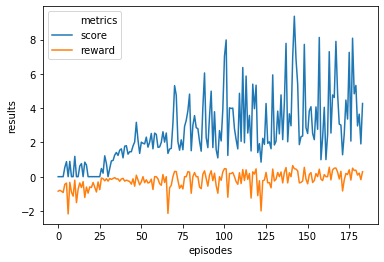

Max Train Score 17 Max Test Score 18
Mean Train Score 2.6386455665444903 Mean Test Score 4.435852334152385
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


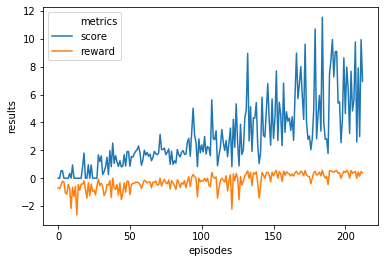

Max Train Score 23 Max Test Score 25
Mean Train Score 2.983847925255096 Mean Test Score 5.681800249789588
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


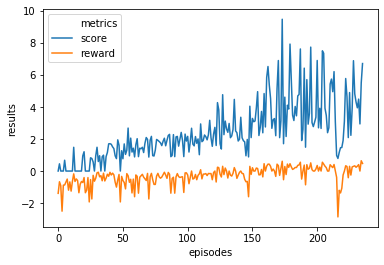

Max Train Score 18 Max Test Score 25
Mean Train Score 2.4194368025339563 Mean Test Score 4.752378764171612
----------------------------------------------------------------------------------------------------
n_eval_episode 3422.1861604372552


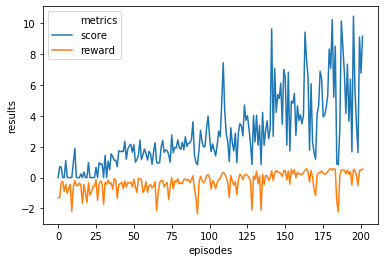

Max Train Score 20 Max Test Score 26
Mean Train Score 2.819534238655537 Mean Test Score 6.251270200012399
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


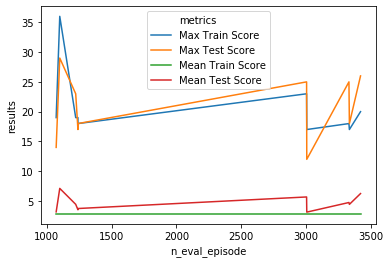

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 93.7     |
|    ep_rew_mean        | -37.5    |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.903   |
|    explained_variance | -0.098   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.101   |
|    value_loss         | 0.00791  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.8     |
|    ep_rew_mean        | -13.6    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000 

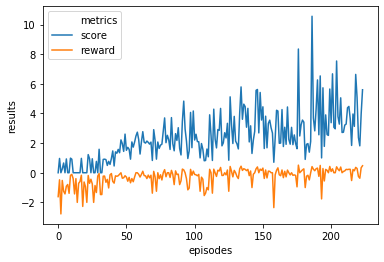

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 104      |
|    ep_rew_mean        | -25.6    |
| time/                 |          |
|    fps                | 402      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.265   |
|    explained_variance | -206     |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.812    |
|    value_loss         | 42.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 60.8     |
|    ep_rew_mean        | -13.6    

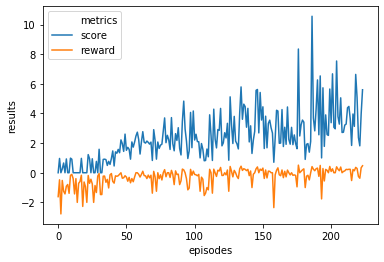

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 1006.5751968449466


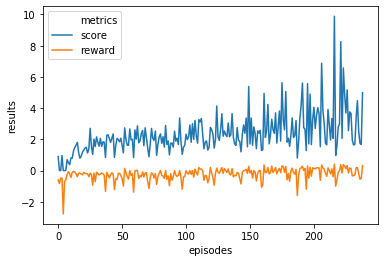

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 161      |
|    ep_rew_mean        | -44      |
| time/                 |          |
|    fps                | 447      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.787   |
|    explained_variance | -0.223   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.00894  |
|    value_loss         | 0.000216 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 118       |
|    ep_rew_mean        | -29.5

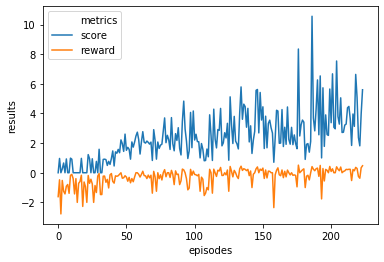

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 1223.620299368521


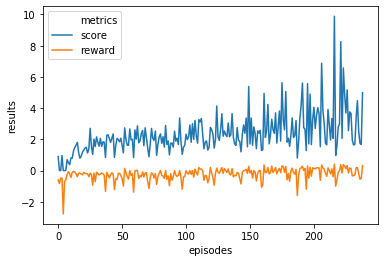

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
n_eval_episode 1223.620299368521


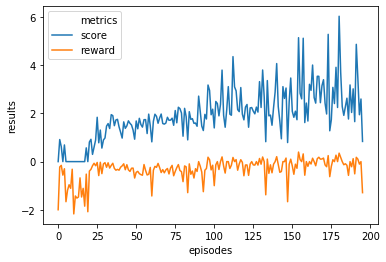

Max Train Score 10 Max Test Score 9
Mean Train Score 1.9302316530996544 Mean Test Score 1.975453187543379
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.5     |
|    ep_rew_mean        | -32.2    |
| time/                 |          |
|    fps                | 409      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.69    |
|    explained_variance | -0.92    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0286  |
|    value_loss         | 0.00869  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.7     |
|    ep_rew_mean        | -6.4     |

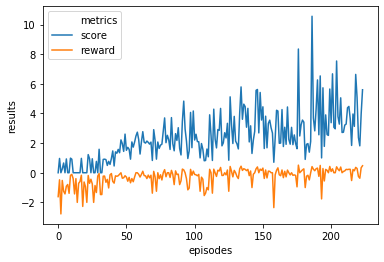

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 1209.1407346910983


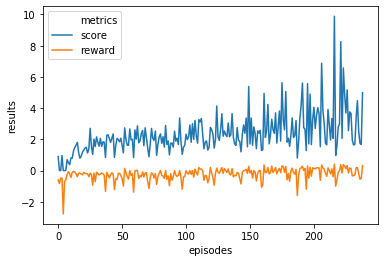

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
n_eval_episode 1209.1407346910983


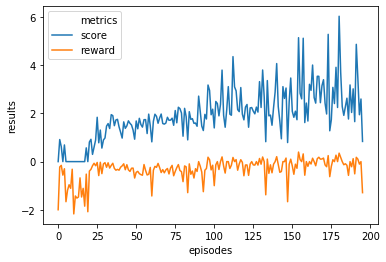

Max Train Score 10 Max Test Score 9
Mean Train Score 1.9302316530996544 Mean Test Score 1.975453187543379
----------------------------------------------------------------------------------------------------
n_eval_episode 1209.1407346910983


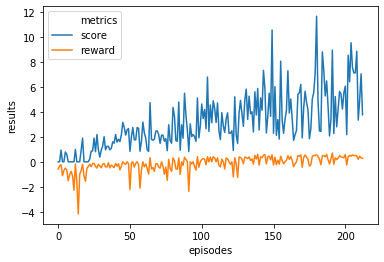

Max Train Score 21 Max Test Score 32
Mean Train Score 3.144385219071956 Mean Test Score 5.870901543914776
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79.1     |
|    ep_rew_mean        | -36.7    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.615   |
|    explained_variance | -0.637   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.148   |
|    value_loss         | 0.0524   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.2     |
|    ep_rew_mean        | -9.7     |

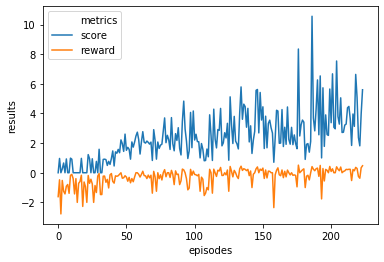

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 1036.8381619074592


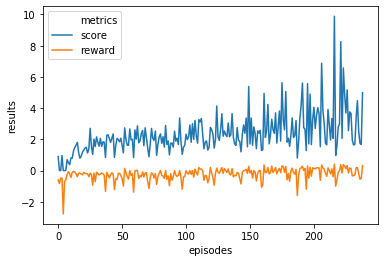

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
n_eval_episode 1036.8381619074592


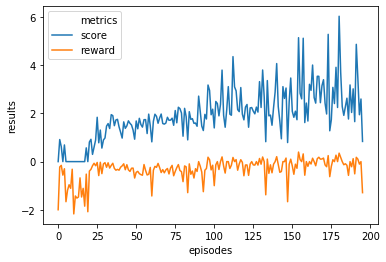

Max Train Score 10 Max Test Score 9
Mean Train Score 1.9302316530996544 Mean Test Score 1.975453187543379
----------------------------------------------------------------------------------------------------
n_eval_episode 1036.8381619074592


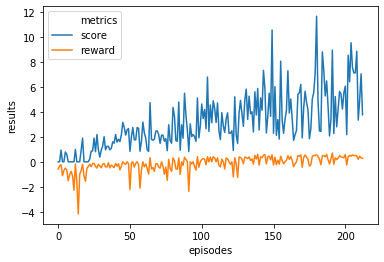

Max Train Score 21 Max Test Score 32
Mean Train Score 3.144385219071956 Mean Test Score 5.870901543914776
----------------------------------------------------------------------------------------------------
n_eval_episode 1036.8381619074592


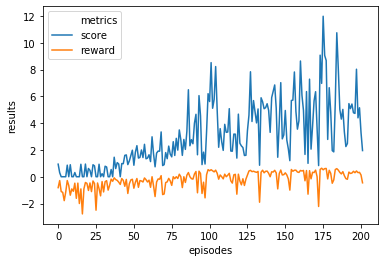

Max Train Score 23 Max Test Score 22
Mean Train Score 3.0335732060741494 Mean Test Score 4.178188076222591
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 212       |
|    ep_rew_mean        | -45.7     |
| time/                 |           |
|    fps                | 451       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.279    |
|    explained_variance | -9.14e+03 |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | 0.276     |
|    value_loss         | 38.2      |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 338       |
|    ep_rew_mea

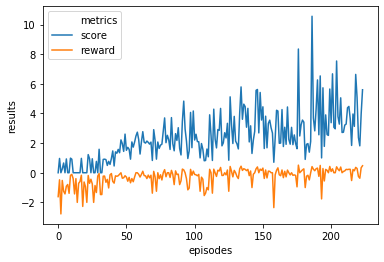

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 3392.857308075575


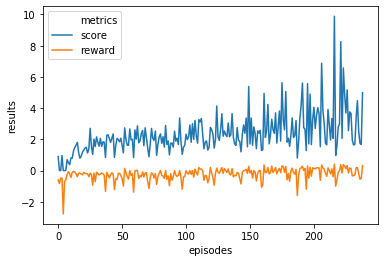

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
n_eval_episode 3392.857308075575


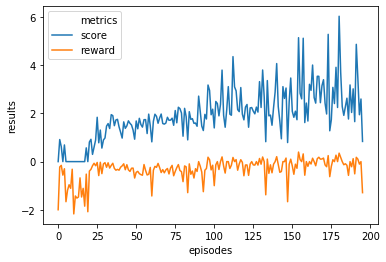

Max Train Score 10 Max Test Score 9
Mean Train Score 1.9302316530996544 Mean Test Score 1.975453187543379
----------------------------------------------------------------------------------------------------
n_eval_episode 3392.857308075575


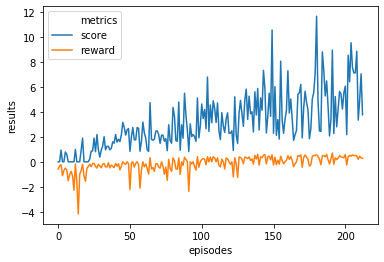

Max Train Score 21 Max Test Score 32
Mean Train Score 3.144385219071956 Mean Test Score 5.870901543914776
----------------------------------------------------------------------------------------------------
n_eval_episode 3392.857308075575


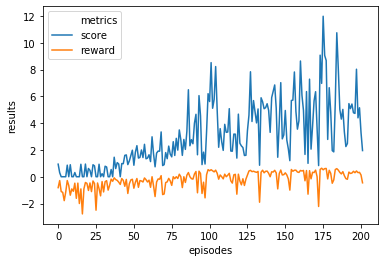

Max Train Score 23 Max Test Score 22
Mean Train Score 3.0335732060741494 Mean Test Score 4.178188076222591
----------------------------------------------------------------------------------------------------
n_eval_episode 3392.857308075575


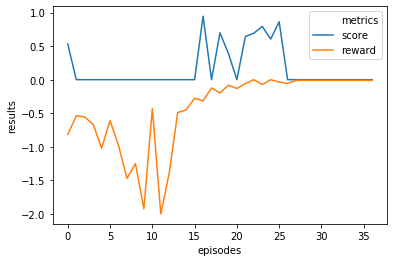

Max Train Score 1 Max Test Score 0
Mean Train Score 0.16642624046974597 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70.6     |
|    ep_rew_mean        | -37.3    |
| time/                 |          |
|    fps                | 397      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.374   |
|    explained_variance | 0.361    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.861    |
|    value_loss         | 0.414    |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 89.4      |
|    ep_rew_mean        | -27.8     |
| time/  

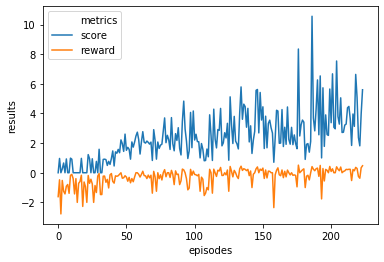

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 3370.764933087445


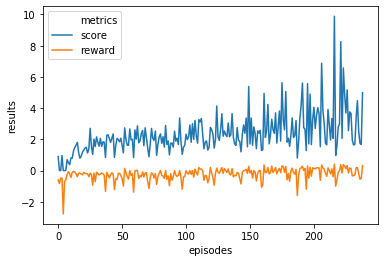

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
n_eval_episode 3370.764933087445


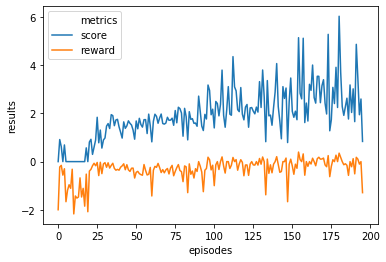

Max Train Score 10 Max Test Score 9
Mean Train Score 1.9302316530996544 Mean Test Score 1.975453187543379
----------------------------------------------------------------------------------------------------
n_eval_episode 3370.764933087445


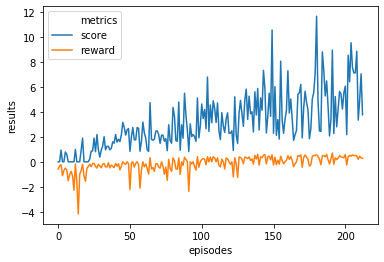

Max Train Score 21 Max Test Score 32
Mean Train Score 3.144385219071956 Mean Test Score 5.870901543914776
----------------------------------------------------------------------------------------------------
n_eval_episode 3370.764933087445


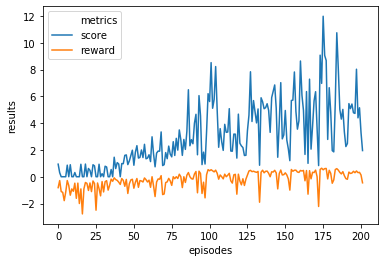

Max Train Score 23 Max Test Score 22
Mean Train Score 3.0335732060741494 Mean Test Score 4.178188076222591
----------------------------------------------------------------------------------------------------
n_eval_episode 3370.764933087445


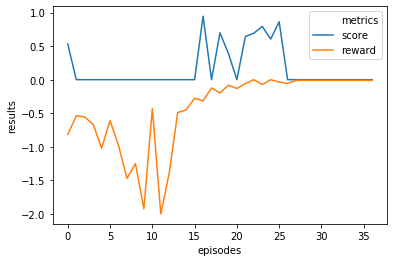

Max Train Score 1 Max Test Score 0
Mean Train Score 0.16642624046974597 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3370.764933087445


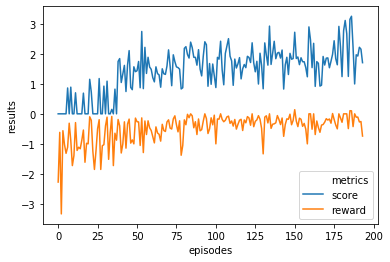

Max Train Score 7 Max Test Score 5
Mean Train Score 1.441734032176288 Mean Test Score 1.7691497293509373
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 151      |
|    ep_rew_mean        | -44.1    |
| time/                 |          |
|    fps                | 450      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.675   |
|    explained_variance | 0.000223 |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0122  |
|    value_loss         | 0.000201 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 116      |
|    ep_rew_mean        | -23.3    |


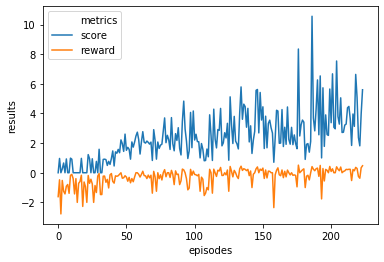

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 3159.068068500154


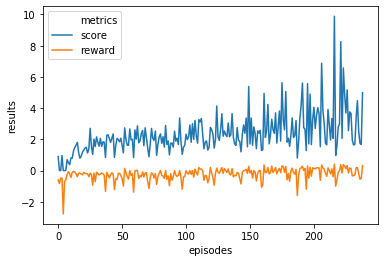

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
n_eval_episode 3159.068068500154


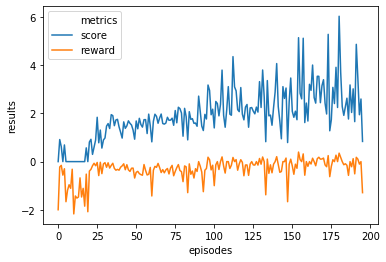

Max Train Score 10 Max Test Score 9
Mean Train Score 1.9302316530996544 Mean Test Score 1.975453187543379
----------------------------------------------------------------------------------------------------
n_eval_episode 3159.068068500154


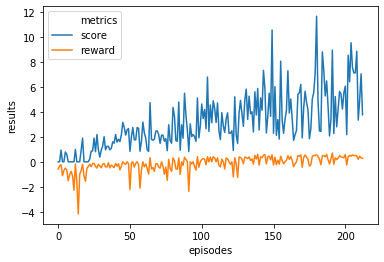

Max Train Score 21 Max Test Score 32
Mean Train Score 3.144385219071956 Mean Test Score 5.870901543914776
----------------------------------------------------------------------------------------------------
n_eval_episode 3159.068068500154


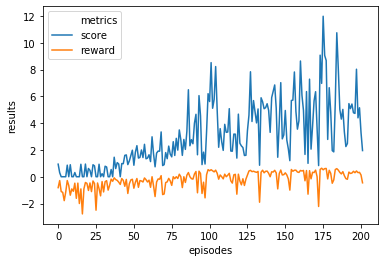

Max Train Score 23 Max Test Score 22
Mean Train Score 3.0335732060741494 Mean Test Score 4.178188076222591
----------------------------------------------------------------------------------------------------
n_eval_episode 3159.068068500154


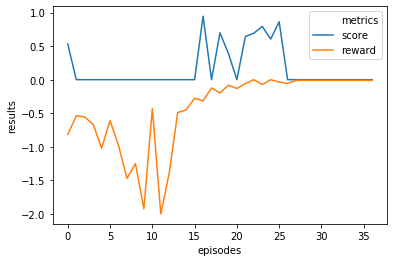

Max Train Score 1 Max Test Score 0
Mean Train Score 0.16642624046974597 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3159.068068500154


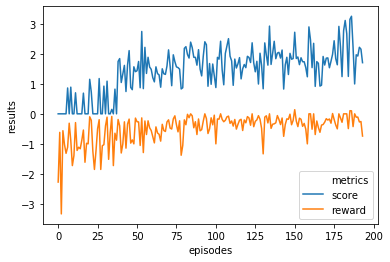

Max Train Score 7 Max Test Score 5
Mean Train Score 1.441734032176288 Mean Test Score 1.7691497293509373
----------------------------------------------------------------------------------------------------
n_eval_episode 3159.068068500154


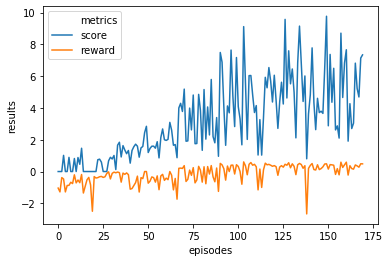

Max Train Score 20 Max Test Score 27
Mean Train Score 3.1532422925769703 Mean Test Score 6.166468303421955
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 120      |
|    ep_rew_mean        | -40      |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.431   |
|    explained_variance | -27.9    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 9.21     |
|    value_loss         | 87.2     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 94.8     |
|    ep_rew_mean        | -17.6    

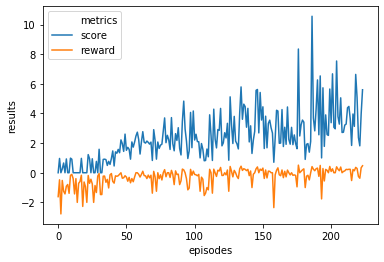

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 3185.2351157816997


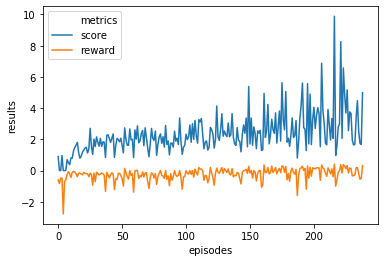

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
n_eval_episode 3185.2351157816997


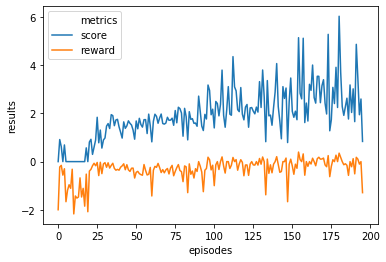

Max Train Score 10 Max Test Score 9
Mean Train Score 1.9302316530996544 Mean Test Score 1.975453187543379
----------------------------------------------------------------------------------------------------
n_eval_episode 3185.2351157816997


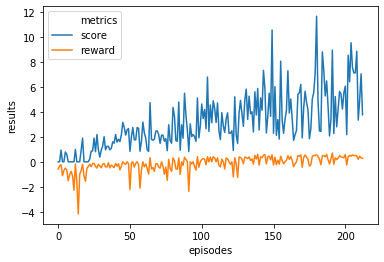

Max Train Score 21 Max Test Score 32
Mean Train Score 3.144385219071956 Mean Test Score 5.870901543914776
----------------------------------------------------------------------------------------------------
n_eval_episode 3185.2351157816997


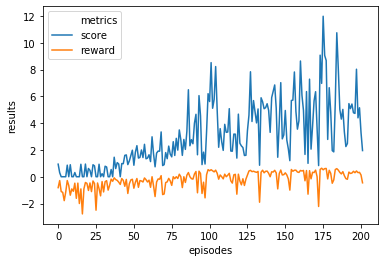

Max Train Score 23 Max Test Score 22
Mean Train Score 3.0335732060741494 Mean Test Score 4.178188076222591
----------------------------------------------------------------------------------------------------
n_eval_episode 3185.2351157816997


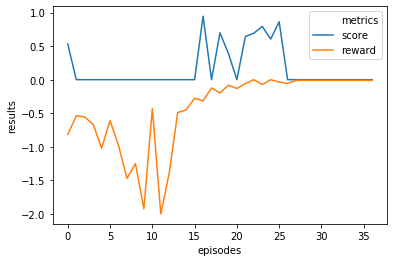

Max Train Score 1 Max Test Score 0
Mean Train Score 0.16642624046974597 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3185.2351157816997


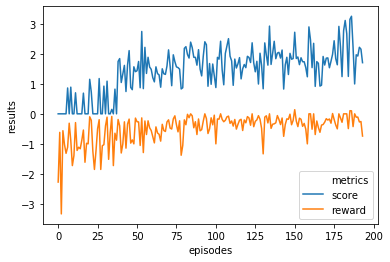

Max Train Score 7 Max Test Score 5
Mean Train Score 1.441734032176288 Mean Test Score 1.7691497293509373
----------------------------------------------------------------------------------------------------
n_eval_episode 3185.2351157816997


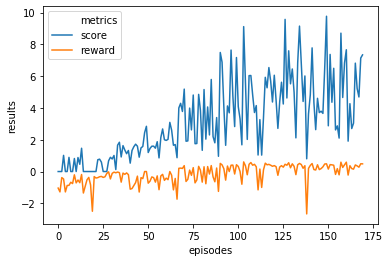

Max Train Score 20 Max Test Score 27
Mean Train Score 3.1532422925769703 Mean Test Score 6.166468303421955
----------------------------------------------------------------------------------------------------
n_eval_episode 3185.2351157816997


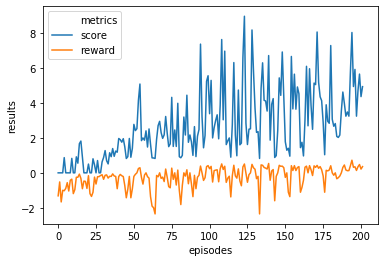

Max Train Score 17 Max Test Score 20
Mean Train Score 2.6805792975770117 Mean Test Score 4.844840307258988
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 103      |
|    ep_rew_mean        | -36.2    |
| time/                 |          |
|    fps                | 447      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.44    |
|    explained_variance | -1.09    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0724  |
|    value_loss         | 0.00498  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 83.7     |
|    ep_rew_mean        | -8       

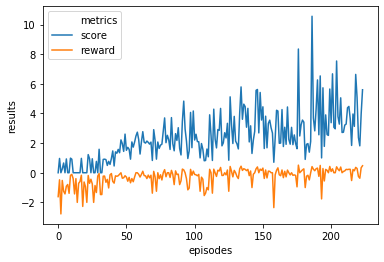

Max Train Score 21 Max Test Score 24
Mean Train Score 2.3990948679778605 Mean Test Score 5.065162659300011
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


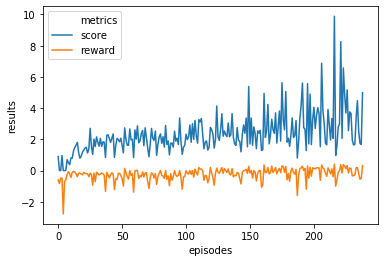

Max Train Score 19 Max Test Score 14
Mean Train Score 2.3296773731392455 Mean Test Score 2.8867783078688394
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


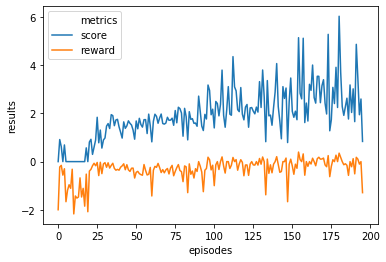

Max Train Score 10 Max Test Score 9
Mean Train Score 1.9302316530996544 Mean Test Score 1.975453187543379
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


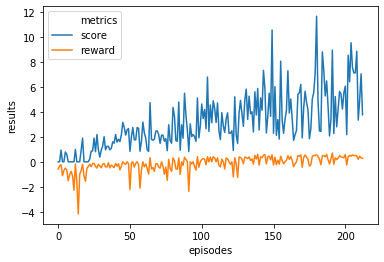

Max Train Score 21 Max Test Score 32
Mean Train Score 3.144385219071956 Mean Test Score 5.870901543914776
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


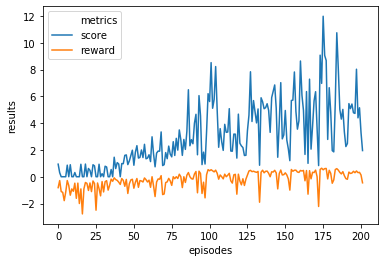

Max Train Score 23 Max Test Score 22
Mean Train Score 3.0335732060741494 Mean Test Score 4.178188076222591
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


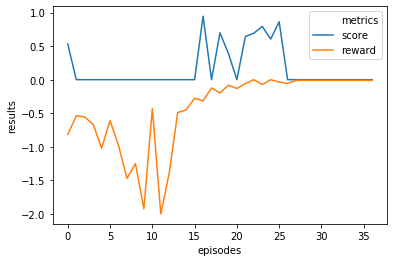

Max Train Score 1 Max Test Score 0
Mean Train Score 0.16642624046974597 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


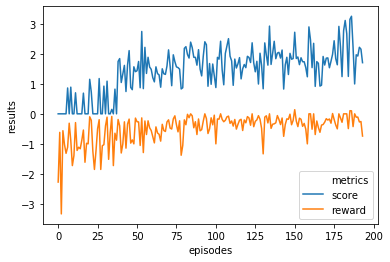

Max Train Score 7 Max Test Score 5
Mean Train Score 1.441734032176288 Mean Test Score 1.7691497293509373
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


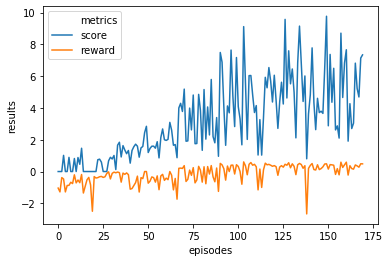

Max Train Score 20 Max Test Score 27
Mean Train Score 3.1532422925769703 Mean Test Score 6.166468303421955
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


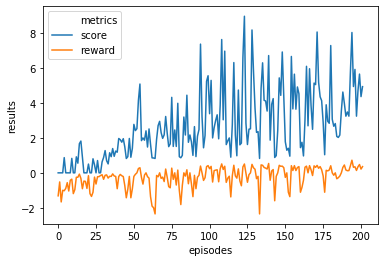

Max Train Score 17 Max Test Score 20
Mean Train Score 2.6805792975770117 Mean Test Score 4.844840307258988
----------------------------------------------------------------------------------------------------
n_eval_episode 3203.8489245278024


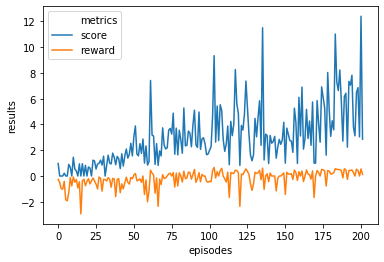

Max Train Score 23 Max Test Score 26
Mean Train Score 2.9975039313846192 Mean Test Score 5.140908701993732
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


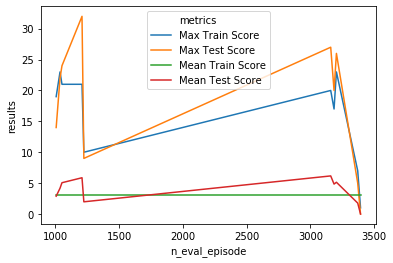

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.8     |
|    ep_rew_mean        | -29.5    |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.321   |
|    explained_variance | 0.0518   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.127   |
|    value_loss         | 0.325    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -3.3     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 2000 

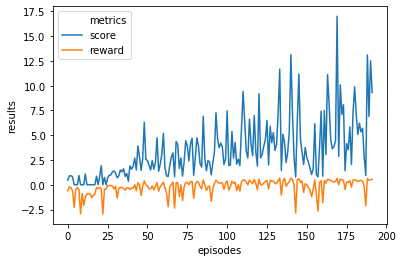

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 203      |
|    ep_rew_mean        | -42.9    |
| time/                 |          |
|    fps                | 457      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.632   |
|    explained_variance | 0.452    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.00222  |
|    value_loss         | 2.89e-05 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 303      |
|    ep_rew_mean        | -41      |

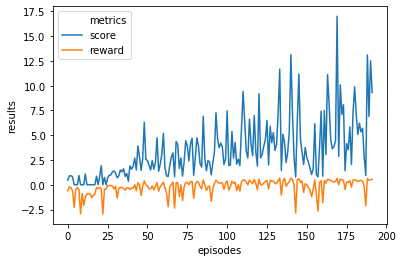

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 1207.1573103471926


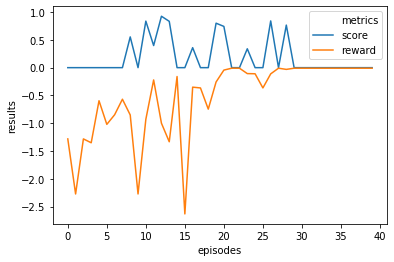

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 73.8     |
|    ep_rew_mean        | -31.9    |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.266   |
|    explained_variance | -0.895   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.341   |
|    value_loss         | 0.126    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 65.5     |
|    ep_rew_mean        | -9.3    

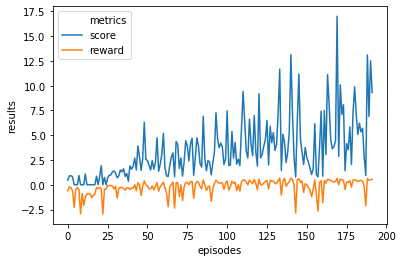

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 1193.2595106686158


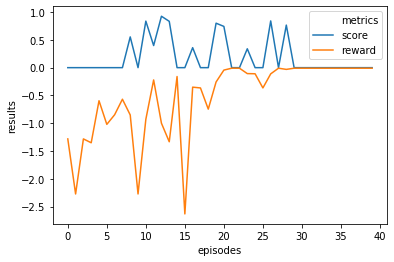

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
n_eval_episode 1193.2595106686158


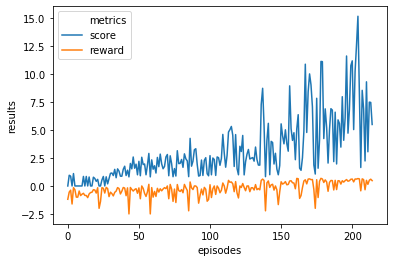

Max Train Score 29 Max Test Score 25
Mean Train Score 3.148007266864704 Mean Test Score 6.9850816385172445
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 163      |
|    ep_rew_mean        | -43.8    |
| time/                 |          |
|    fps                | 450      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.136   |
|    explained_variance | -0.735   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 1.74e-05 |
|    value_loss         | 4.79e-07 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 287      |
|    ep_rew_mean        | -40      

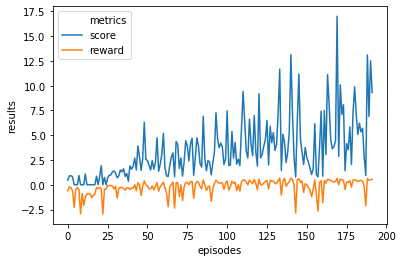

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 1194.097835175302


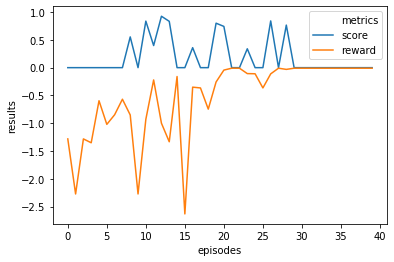

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
n_eval_episode 1194.097835175302


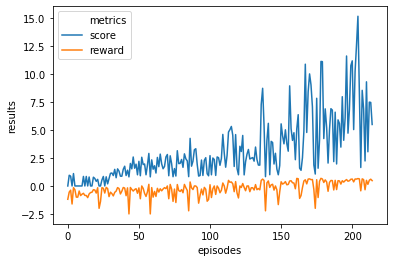

Max Train Score 29 Max Test Score 25
Mean Train Score 3.148007266864704 Mean Test Score 6.9850816385172445
----------------------------------------------------------------------------------------------------
n_eval_episode 1194.097835175302


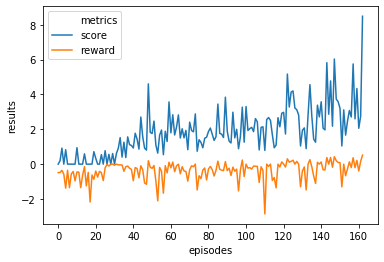

Max Train Score 16 Max Test Score 16
Mean Train Score 1.8487621002549988 Mean Test Score 3.7101510965811135
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.2     |
|    ep_rew_mean        | -42.6    |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.8     |
|    explained_variance | 0.307    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0255  |
|    value_loss         | 0.00125  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89.3     |
|    ep_rew_mean        | -22.8   

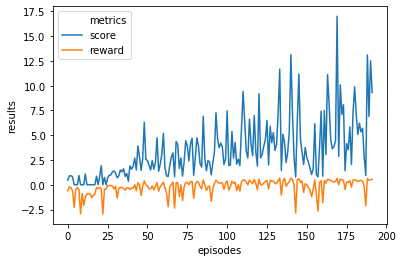

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 1055.0079023697044


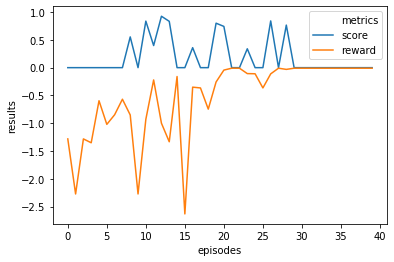

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
n_eval_episode 1055.0079023697044


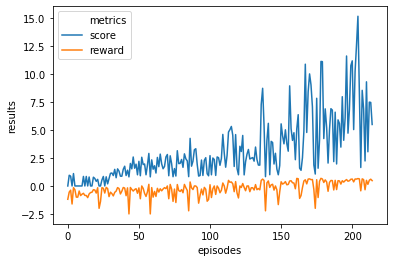

Max Train Score 29 Max Test Score 25
Mean Train Score 3.148007266864704 Mean Test Score 6.9850816385172445
----------------------------------------------------------------------------------------------------
n_eval_episode 1055.0079023697044


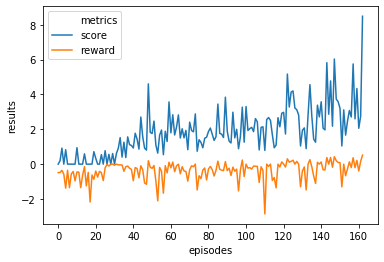

Max Train Score 16 Max Test Score 16
Mean Train Score 1.8487621002549988 Mean Test Score 3.7101510965811135
----------------------------------------------------------------------------------------------------
n_eval_episode 1055.0079023697044


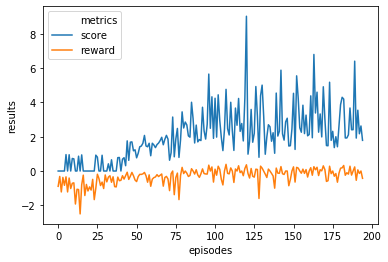

Max Train Score 16 Max Test Score 21
Mean Train Score 2.0500015228527135 Mean Test Score 3.473726909904601
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 145      |
|    ep_rew_mean        | -39.7    |
| time/                 |          |
|    fps                | 417      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.469   |
|    explained_variance | -0.171   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0335   |
|    value_loss         | 0.00999  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95       |
|    ep_rew_mean        | -24.1    

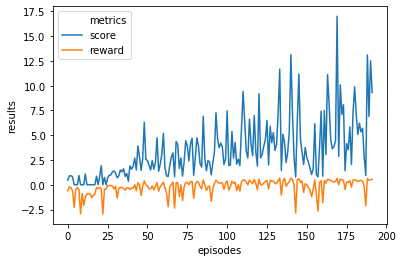

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 3179.18064153539


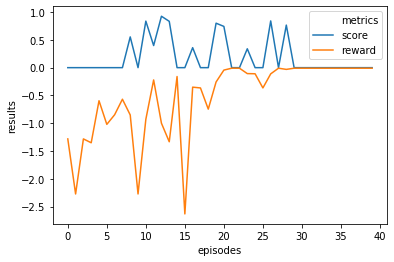

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
n_eval_episode 3179.18064153539


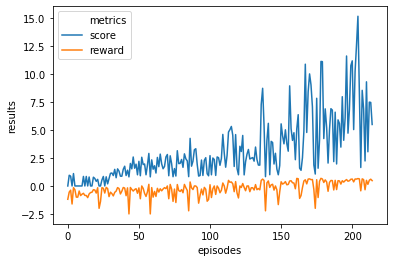

Max Train Score 29 Max Test Score 25
Mean Train Score 3.148007266864704 Mean Test Score 6.9850816385172445
----------------------------------------------------------------------------------------------------
n_eval_episode 3179.18064153539


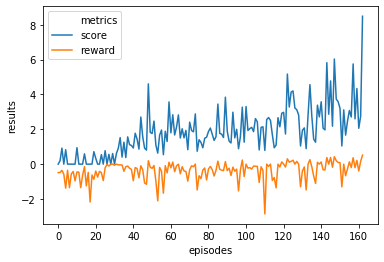

Max Train Score 16 Max Test Score 16
Mean Train Score 1.8487621002549988 Mean Test Score 3.7101510965811135
----------------------------------------------------------------------------------------------------
n_eval_episode 3179.18064153539


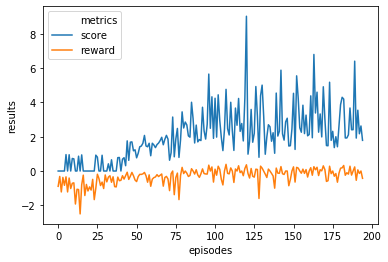

Max Train Score 16 Max Test Score 21
Mean Train Score 2.0500015228527135 Mean Test Score 3.473726909904601
----------------------------------------------------------------------------------------------------
n_eval_episode 3179.18064153539


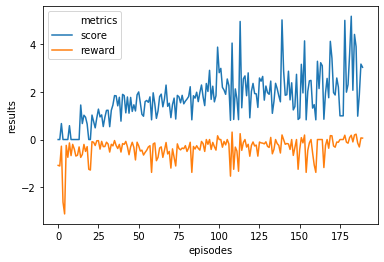

Max Train Score 10 Max Test Score 16
Mean Train Score 1.7484625302018117 Mean Test Score 2.876910936677322
----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 184       |
|    ep_rew_mean        | -43.1     |
| time/                 |           |
|    fps                | 429       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.103    |
|    explained_variance | -1.07     |
|    learning_rate      | 0.001     |
|    n_updates          | 999       |
|    policy_loss        | -2.47e-06 |
|    value_loss         | 1.99e-07  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 285      |
|    ep_rew_mean  

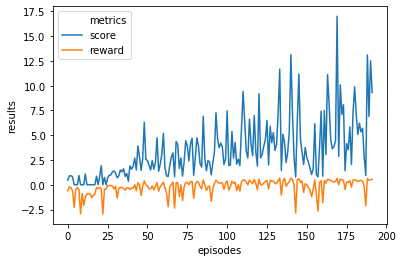

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.126779937209


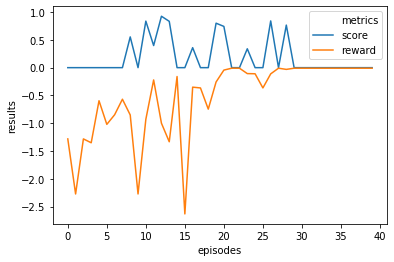

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.126779937209


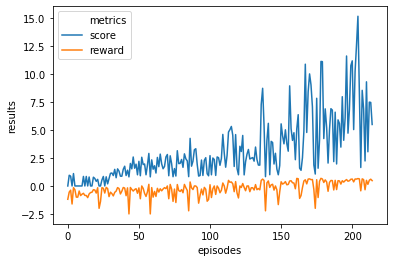

Max Train Score 29 Max Test Score 25
Mean Train Score 3.148007266864704 Mean Test Score 6.9850816385172445
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.126779937209


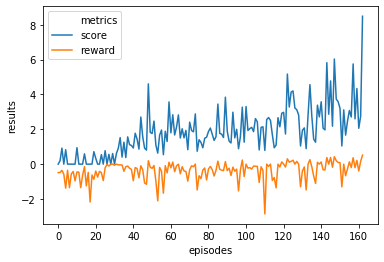

Max Train Score 16 Max Test Score 16
Mean Train Score 1.8487621002549988 Mean Test Score 3.7101510965811135
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.126779937209


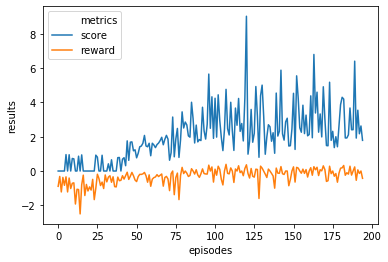

Max Train Score 16 Max Test Score 21
Mean Train Score 2.0500015228527135 Mean Test Score 3.473726909904601
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.126779937209


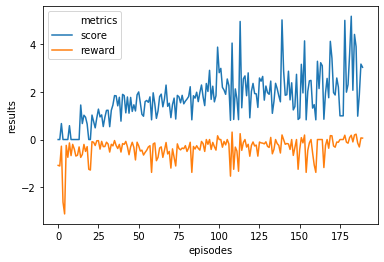

Max Train Score 10 Max Test Score 16
Mean Train Score 1.7484625302018117 Mean Test Score 2.876910936677322
----------------------------------------------------------------------------------------------------
n_eval_episode 3254.126779937209


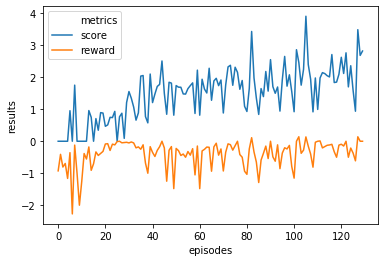

Max Train Score 8 Max Test Score 8
Mean Train Score 1.4868894501325947 Mean Test Score 1.9404708746687533
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 132      |
|    ep_rew_mean        | -38.6    |
| time/                 |          |
|    fps                | 453      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.617   |
|    explained_variance | -0.296   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.026   |
|    value_loss         | 0.00268  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 93.6     |
|    ep_rew_mean        | -14.9    |

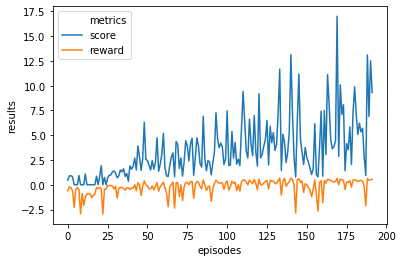

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.57928993393


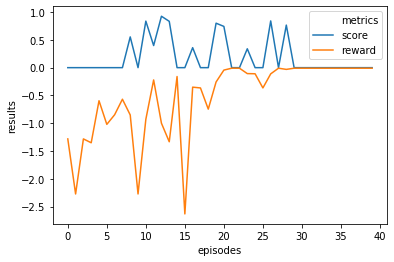

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.57928993393


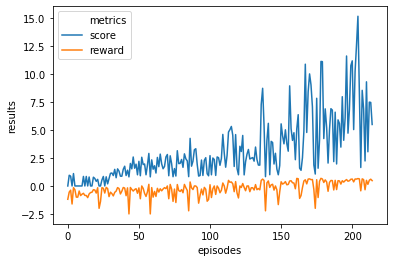

Max Train Score 29 Max Test Score 25
Mean Train Score 3.148007266864704 Mean Test Score 6.9850816385172445
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.57928993393


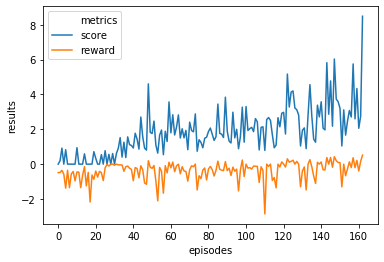

Max Train Score 16 Max Test Score 16
Mean Train Score 1.8487621002549988 Mean Test Score 3.7101510965811135
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.57928993393


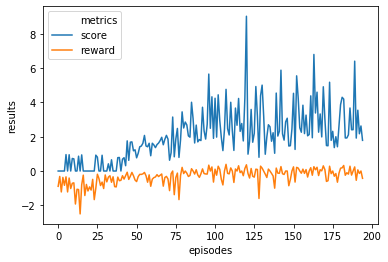

Max Train Score 16 Max Test Score 21
Mean Train Score 2.0500015228527135 Mean Test Score 3.473726909904601
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.57928993393


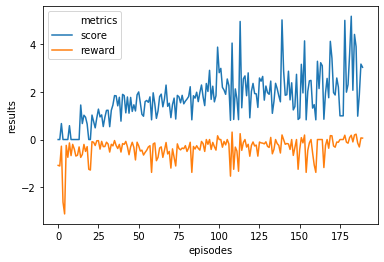

Max Train Score 10 Max Test Score 16
Mean Train Score 1.7484625302018117 Mean Test Score 2.876910936677322
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.57928993393


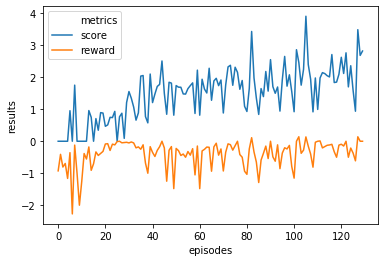

Max Train Score 8 Max Test Score 8
Mean Train Score 1.4868894501325947 Mean Test Score 1.9404708746687533
----------------------------------------------------------------------------------------------------
n_eval_episode 3376.57928993393


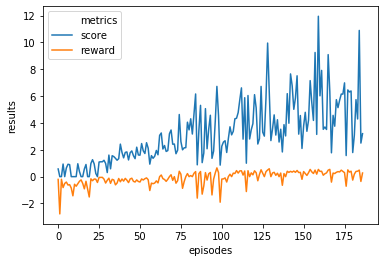

Max Train Score 23 Max Test Score 22
Mean Train Score 3.1610043392350327 Mean Test Score 5.5680192115742715
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 110      |
|    ep_rew_mean        | -40.9    |
| time/                 |          |
|    fps                | 454      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.647   |
|    explained_variance | -4.37    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0128   |
|    value_loss         | 0.000498 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.5     |
|    ep_rew_mean        | -26.7   

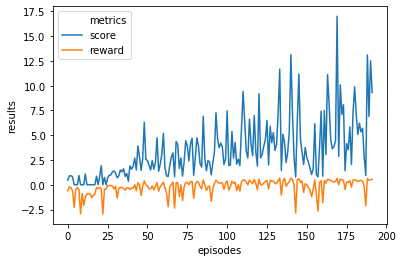

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 3047.267751528514


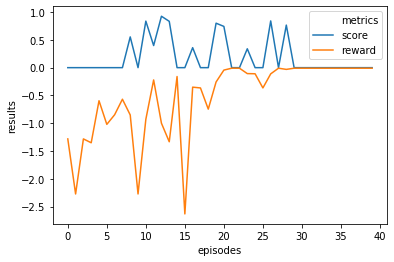

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
n_eval_episode 3047.267751528514


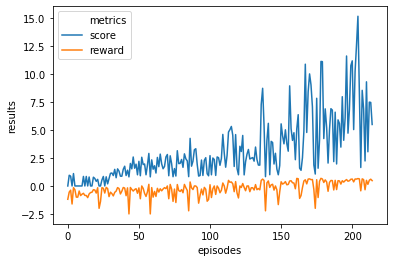

Max Train Score 29 Max Test Score 25
Mean Train Score 3.148007266864704 Mean Test Score 6.9850816385172445
----------------------------------------------------------------------------------------------------
n_eval_episode 3047.267751528514


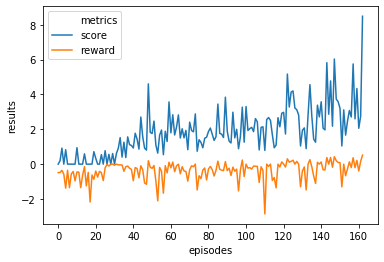

Max Train Score 16 Max Test Score 16
Mean Train Score 1.8487621002549988 Mean Test Score 3.7101510965811135
----------------------------------------------------------------------------------------------------
n_eval_episode 3047.267751528514


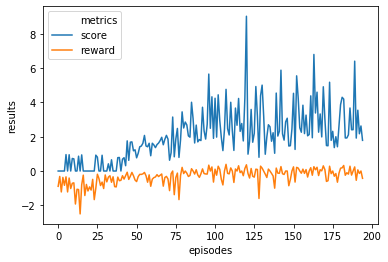

Max Train Score 16 Max Test Score 21
Mean Train Score 2.0500015228527135 Mean Test Score 3.473726909904601
----------------------------------------------------------------------------------------------------
n_eval_episode 3047.267751528514


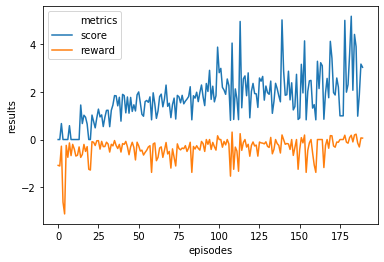

Max Train Score 10 Max Test Score 16
Mean Train Score 1.7484625302018117 Mean Test Score 2.876910936677322
----------------------------------------------------------------------------------------------------
n_eval_episode 3047.267751528514


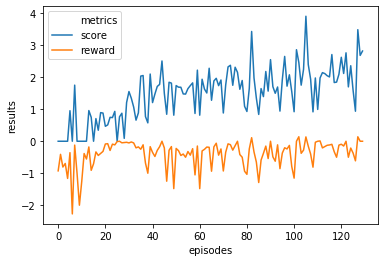

Max Train Score 8 Max Test Score 8
Mean Train Score 1.4868894501325947 Mean Test Score 1.9404708746687533
----------------------------------------------------------------------------------------------------
n_eval_episode 3047.267751528514


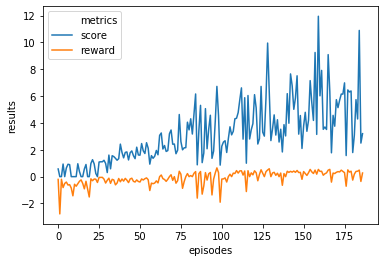

Max Train Score 23 Max Test Score 22
Mean Train Score 3.1610043392350327 Mean Test Score 5.5680192115742715
----------------------------------------------------------------------------------------------------
n_eval_episode 3047.267751528514


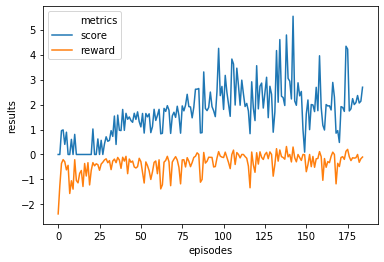

Max Train Score 11 Max Test Score 12
Mean Train Score 1.7071388040448774 Mean Test Score 2.5345628757321763
----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 141      |
|    ep_rew_mean        | -39.4    |
| time/                 |          |
|    fps                | 456      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.521   |
|    explained_variance | -5.52    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00519 |
|    value_loss         | 0.000503 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 96.4     |
|    ep_rew_mean        | -17     

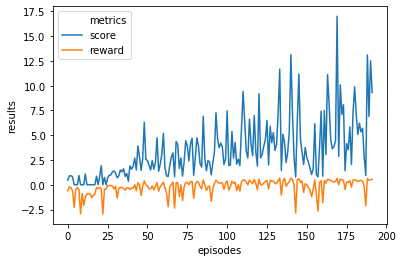

Max Train Score 32 Max Test Score 32
Mean Train Score 3.442267329302876 Mean Test Score 5.875420473124118
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


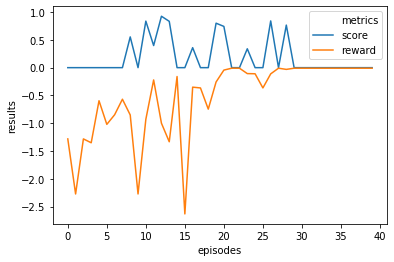

Max Train Score 1 Max Test Score 1
Mean Train Score 0.18485364137215352 Mean Test Score 0.05727199908456345
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


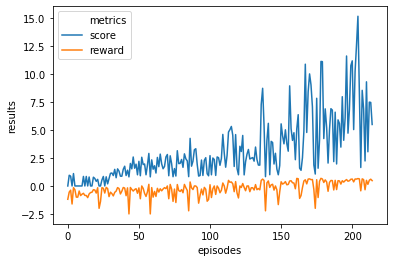

Max Train Score 29 Max Test Score 25
Mean Train Score 3.148007266864704 Mean Test Score 6.9850816385172445
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


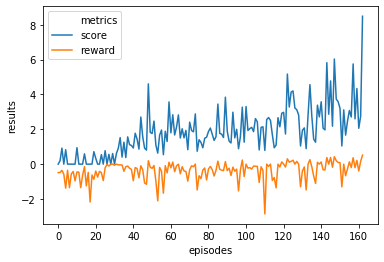

Max Train Score 16 Max Test Score 16
Mean Train Score 1.8487621002549988 Mean Test Score 3.7101510965811135
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


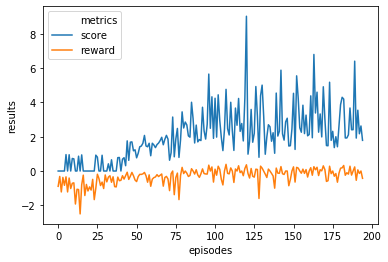

Max Train Score 16 Max Test Score 21
Mean Train Score 2.0500015228527135 Mean Test Score 3.473726909904601
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


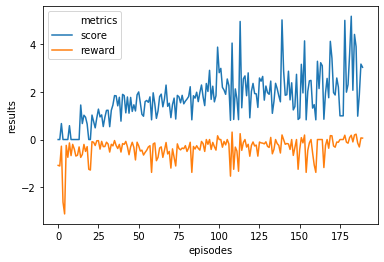

Max Train Score 10 Max Test Score 16
Mean Train Score 1.7484625302018117 Mean Test Score 2.876910936677322
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


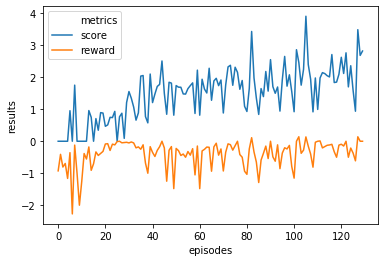

Max Train Score 8 Max Test Score 8
Mean Train Score 1.4868894501325947 Mean Test Score 1.9404708746687533
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


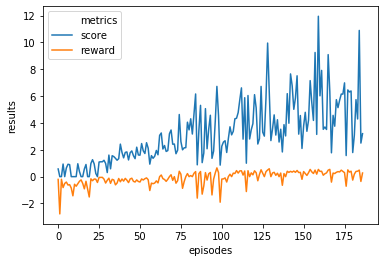

Max Train Score 23 Max Test Score 22
Mean Train Score 3.1610043392350327 Mean Test Score 5.5680192115742715
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


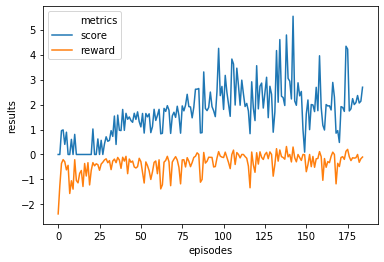

Max Train Score 11 Max Test Score 12
Mean Train Score 1.7071388040448774 Mean Test Score 2.5345628757321763
----------------------------------------------------------------------------------------------------
n_eval_episode 3097.5182206898644


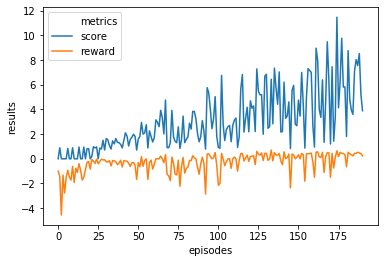

Max Train Score 23 Max Test Score 23
Mean Train Score 3.0295619613641414 Mean Test Score 5.586446467631146
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


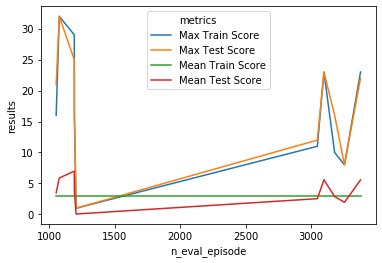

----------------------------------------------------------------------------------------------------


In [121]:
for i in range(10):    
    results = {}
    for i in range(10):
        # enable_render=True turns on the display
        snake_env = SnakeEnv(440, 440, enable_render=False)
        env = make_vec_env(lambda: snake_env, n_envs=1)

        #entropy = random.uniform(0, 0.1)
        if i < 5:
            n_eval_episode = random.uniform(1000,1250)
        else:
            n_eval_episode = random.uniform(3000,3500)

        #gamma=0.97 is the best one?
        #leaning_rate=??? see the best result from previous test
        model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97)#seed=42, gamma=0.97)#, ent_coef=entropy)
        model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

        # Print rewards and scores for each episode
        max_train_score = snake_env.record
        mean_train_score = np.mean(np.array(snake_env.results['score']))
        max_test_score, mean_test_score = evaluate(model)

        results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

        for learning_rate, result in results.items():
            metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

            print("n_eval_episode", n_eval_episode)
            plot_metrics(metrics)    
            print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
            print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
            print("-"*100)
    
    print("n_eval_episode max results ", i+1)
    plot_max_results(results,'n_eval_episode')
    print("-"*100)

#### Result: N/A

# Testing Seed

## Seed=42

### Learning Rate

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 442       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 452      |
|    iterations         | 2000     |
|    time_elapsed       | 22       |
|    total_timesteps    | 10000    |
| tr

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 456       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 460       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 341      |
|    iterations         | 4000     |
|    time_elapsed       | 58       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 365       |
|    iterations         | 1000      |
|    time_elapsed       | 13        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


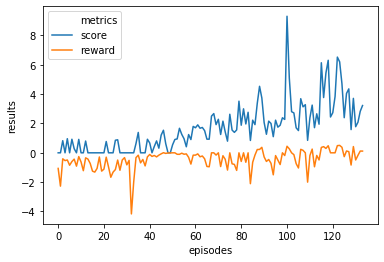

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


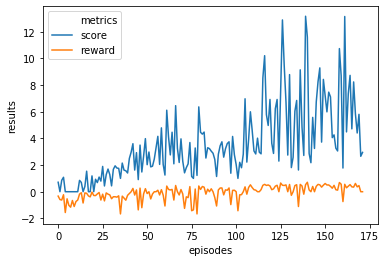

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


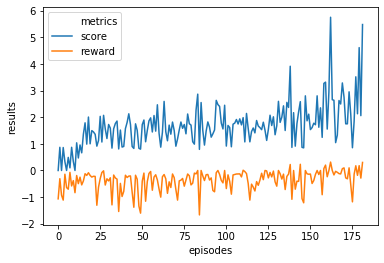

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


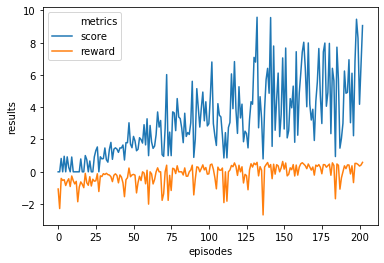

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


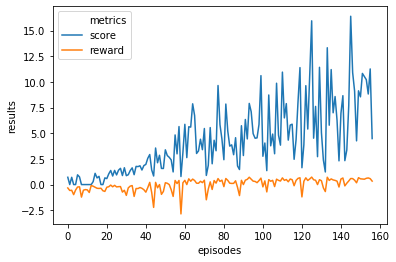

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


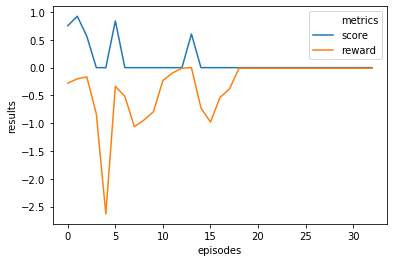

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


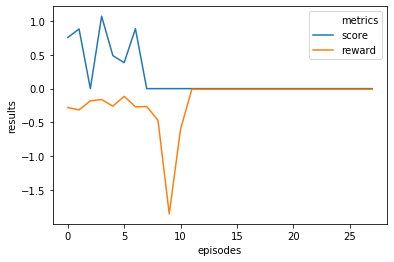

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


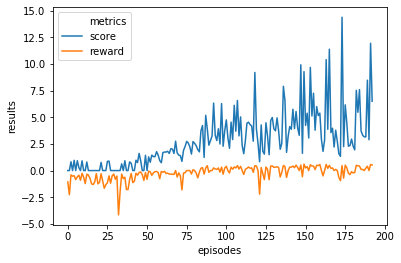

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


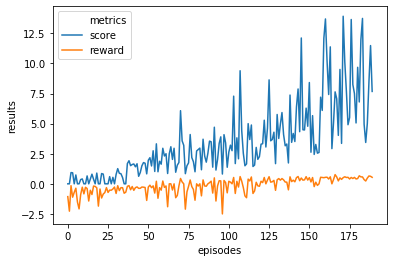

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


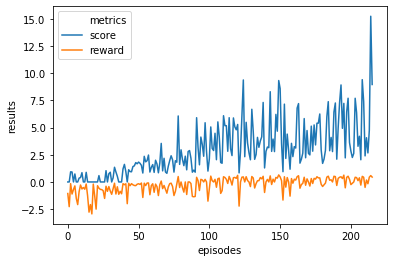

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


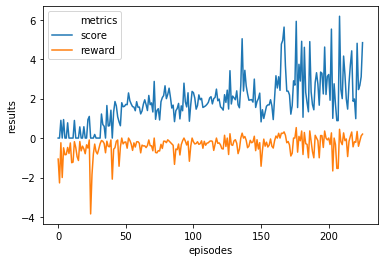

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


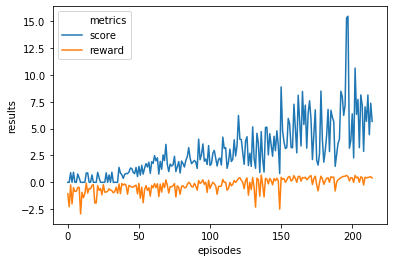

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


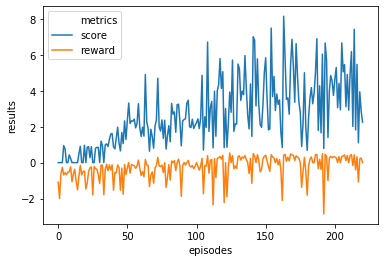

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  1


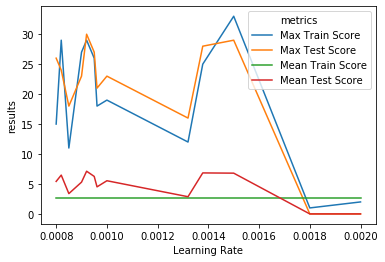

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 442       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 436      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 406      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 402       |
|    iterations         | 3000      |
|    time_elapsed       | 37        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 405       |
|    iterations         | 4000      |
|    time_elapsed       | 49        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 370      |
|    iterations         | 4000     |
|    time_elapsed       | 54       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 390       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


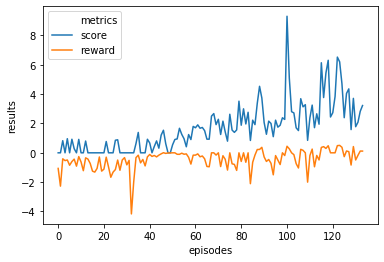

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


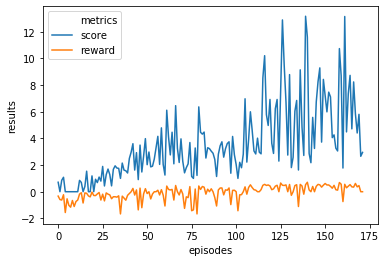

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


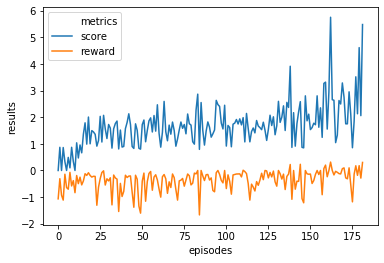

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


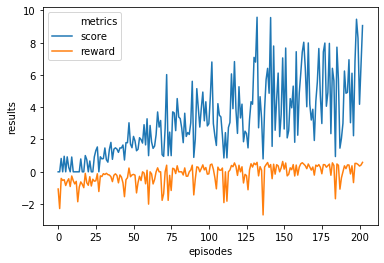

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


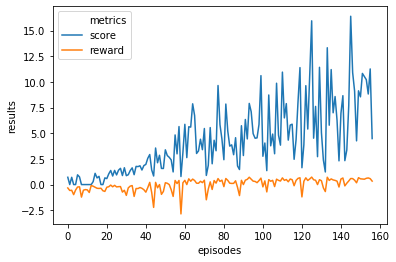

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


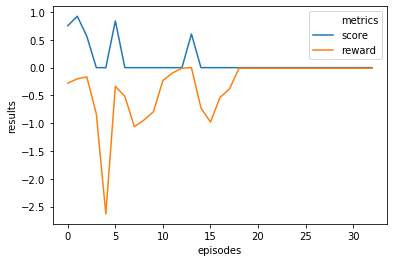

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


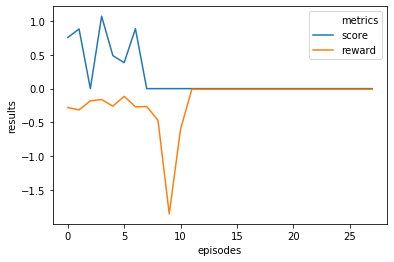

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


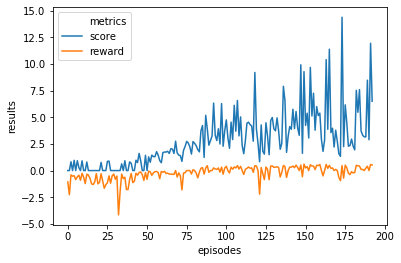

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


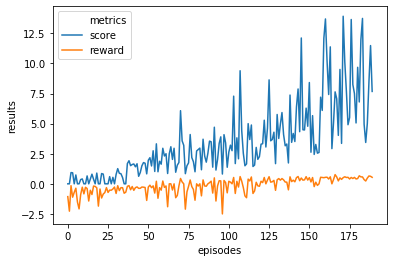

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


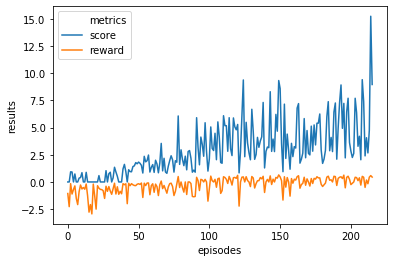

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


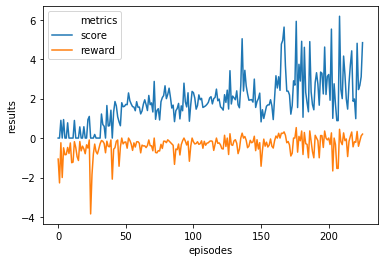

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


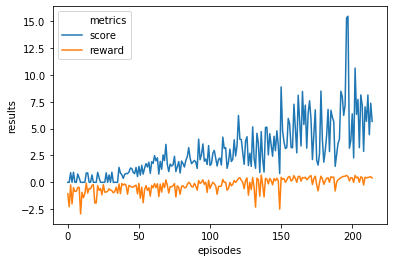

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


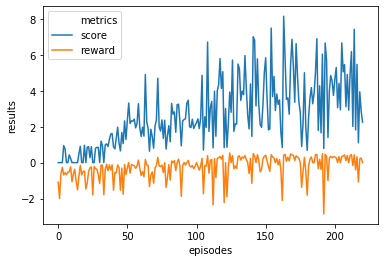

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  2


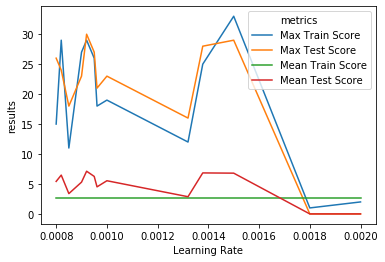

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 1000      |
|    time_elapsed       | 14        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 364      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 431       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 420       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 404       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/    

In [ ]:
learning_rates=[0.0009610612889534735,0.0013779226379577784,0.0013197979371411934,0.001,0.0015,0.0018,0.002,0.00095,0.00092,0.0009,0.00085,0.00082,0.0008]
for i in range(10):
    results = {}
    for learning_rate in learning_rates:
        # enable_render=True turns on the display
        snake_env = SnakeEnv(440, 440, enable_render=False)
        env = make_vec_env(lambda: snake_env, n_envs=1)

        #gamma = random.uniform(0.95, 1)
        #learning_rate=random.uniform(0.0005,0.0014)
        #print("lr: ", learning_rate)

        model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate,gamma=0.97, seed=42)
        model.learn(total_timesteps=20000, log_interval=1000)

        # Print rewards and scores for each episode
        max_train_score = snake_env.record
        mean_train_score = np.mean(np.array(snake_env.results['score']))
        max_test_score, mean_test_score = evaluate(model)

        results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

    for learning_rate, result in results.items():
        metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

        print("Learning Rate", learning_rate)
        plot_metrics(metrics)    
        print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
        print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
        print("-"*100)
    
    print("Learning rate max results ", i+1)
    plot_max_results(results,'Learning Rate')
    print("-"*100)

### n_eval_episode

In [ ]:
for i in range(10):    
    results = {}
    for i in range(10):
        # enable_render=True turns on the display
        snake_env = SnakeEnv(440, 440, enable_render=False)
        env = make_vec_env(lambda: snake_env, n_envs=1)

        #entropy = random.uniform(0, 0.1)
        if i < 5:
            n_eval_episode = random.uniform(1000,1250)
        else:
            n_eval_episode = random.uniform(3000,3500)

        #gamma=0.97 is the best one?
        #leaning_rate=??? see the best result from previous test
        model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97,seed=42, gamma=0.97)#, ent_coef=entropy)
        model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

        # Print rewards and scores for each episode
        max_train_score = snake_env.record
        mean_train_score = np.mean(np.array(snake_env.results['score']))
        max_test_score, mean_test_score = evaluate(model)

        results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

        for learning_rate, result in results.items():
            metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

            print("n_eval_episode", n_eval_episode)
            plot_metrics(metrics)    
            print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
            print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
            print("-"*100)
    
    print("n_eval_episode max results ", i+1)
    plot_max_results(results,'n_eval_episode')
    print("-"*100)